In [1]:
#from thllib import flylib as flb
from matplotlib import pyplot as plt
import numpy as np
import scipy
#from thllib import util
import figurefirst as fifi
import scipy.signal
import local_project_functions as lpf
from IPython.display import SVG,display
import networkx as nx


import flylib as flb
#from thllib import flylib as flb
import flylib as flb
from matplotlib import pyplot as plt
import numpy as np
import scipy
from flylib import util
import figurefirst as fifi
import scipy.signal
import local_project_functions as lpf
from IPython.display import SVG,display
import pandas as pd
import networkx as nx

from scipy.stats import norm
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt

/home/imager/.local/lib/python2.7/site-packages/pandas/core/computation/__init__.py:18: UserWarning: The installed version of numexpr 2.4.3 is not supported in pandas and will be not be used
The minimum supported version is 2.4.6

  ver=ver, min_ver=_MIN_NUMEXPR_VERSION), UserWarning)


In [ ]:
#1706 fix again/ unbag


In [2]:

fly_nums = range(1707, 1709) + range(1711, 1714) + range (1715, 1719) + range(1719, 1722) + range(1722, 1727) + range(1729, 1730)# +   range(1731, 1732)## last one are the newest trials -- 
#figure out whats wrong with kine cam?
multi_fly_df = util.construct_multi_fly_df(fly_nums)


Making dataframe for fly number 1707
Making dataframe for fly number 1708
Making dataframe for fly number 1711
Making dataframe for fly number 1712
Making dataframe for fly number 1713
Making dataframe for fly number 1715
Making dataframe for fly number 1716
Making dataframe for fly number 1717
Making dataframe for fly number 1718
Making dataframe for fly number 1719
Making dataframe for fly number 1720
Making dataframe for fly number 1721
Making dataframe for fly number 1722
Making dataframe for fly number 1723
Making dataframe for fly number 1724
Making dataframe for fly number 1725
Making dataframe for fly number 1726
Making dataframe for fly number 1729


#adapted for trouble shooting
fly_nums = range(1706, 1709) + range(1711, 1714) + range (1715, 1719) + range(1719, 1722) + range(1722, 1727)  + range(1729, 1730)# +   range(1731, 1732)## last one are the newest trials -- 
#figure out whats wrong with kine cam?
multi_fly_df = util.construct_multi_fly_df(fly_nums)


In [3]:
print(multi_fly_df.columns.values)
print(np.unique(multi_fly_df['stimulus']))

idx = (multi_fly_df['stimulus']=='cl_blocks, g_x=-1, g_y=0, b_x=-8, b_y=0, ch=True')& \
        ((multi_fly_df['amp_diff']>0.1)&(multi_fly_df['amp_diff']<0.104))


['t' 'stimulus' 'amp_diff' 'left_amp' 'right_amp' 'fly_num' 'wbf'
 'experimental_condition' 'pr_left' 'tpd_left' 'nm_left' 'iii1_left'
 'iii3_left' 'i2_left' 'hg2_left' 'hg3_left' 'hg1_left' 'i1_left'
 'bkg_left' 'b1_left' 'b2_left' 'b3_left' 'iii24_left' 'hg4_left'
 'pr_right' 'tpd_right' 'nm_right' 'iii1_right' 'iii3_right' 'i2_right'
 'hg2_right' 'hg3_right' 'hg1_right' 'i1_right' 'bkg_right' 'b1_right'
 'b2_right' 'b3_right' 'iii24_right' 'hg4_right']
['exc_cl_starfield, g_x = 1, g_y=0, b_x =0, b_y = 0, ch=0'
 'pitch_down_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'pitch_up_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'pretrial_stripe_fix'
 'roll_clockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'roll_counterclockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'trials_ended' 'yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'yaw_right, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']


In [4]:
multi_fly_df['l_plus_r'] = multi_fly_df['left_amp'] + multi_fly_df['right_amp']
all_stim_df = multi_fly_df


In [2]:
def rad_to_deg (rad):
    r_deg = np.rad2deg(((rad)/10) *2*np.pi)
    return r_deg

In [3]:
def key_to_key(inkey):
    """map the input key from the cov_mtrx_triang_layout.svg into a set of keys 
    (a tuple of tuples) that can be used to construct signals from the fly data"""
    try:
        k1 = {'R':'right','L':'left'}[inkey[0]]
    except KeyError:
        if inkey[0] == 'w':
            return ('common','wb_freq')
        else:
            return
    k2 = inkey[1:]
    return (k1,k2)

In [4]:
multi_fly_df.columns

NameError: name 'multi_fly_df' is not defined

In [9]:
fly_1 = multi_fly_df[multi_fly_df.fly_num == 1707]

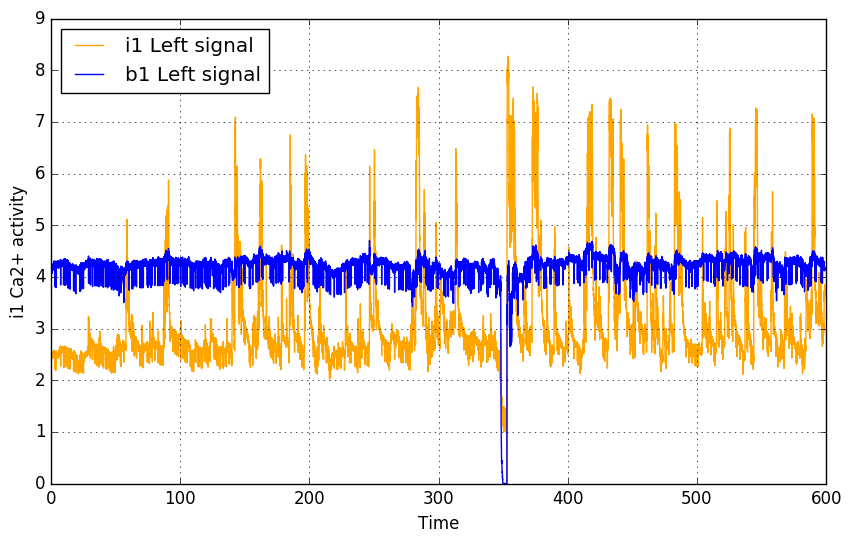

In [15]:
plt.rc('font', size=12)
fig, ax = plt.subplots(figsize=(10, 6))

# Specify how our lines should look
ax.plot(fly_1.t, fly_1.i1_left, color='orange', label='i1 Left signal')
ax.plot(fly_1.t, fly_1.b1_left, color='blue', label='b1 Left signal')

# Same as above
ax.set_xlabel('Time')
ax.set_ylabel('i1 Ca2+ activity')
#ax.set_title('Buoy Wind Data')
ax.grid(True)
ax.legend(loc='upper left')
plt.show()

In [17]:
fly_1_filt = scipy.signal.medfilt(fly_1, 1)

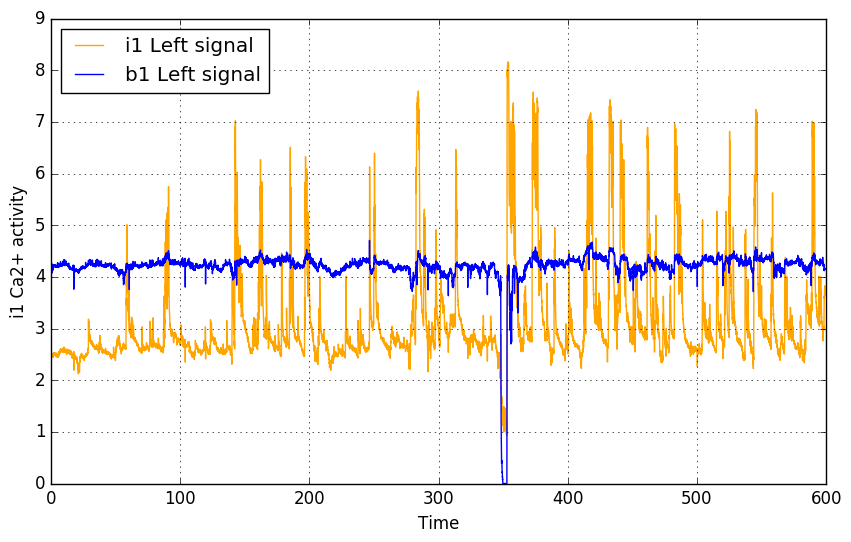

In [21]:
plt.rc('font', size=12)
fig, ax = plt.subplots(figsize=(10, 6))

# Specify how our lines should look
ax.plot(fly_1.t, scipy.signal.medfilt(fly_1.i1_left, 3), color='orange', label='i1 Left signal')
ax.plot(fly_1.t, scipy.signal.medfilt(fly_1.b1_left, 3), color='blue', label='b1 Left signal')

# Same as above
ax.set_xlabel('Time')
ax.set_ylabel('i1 Ca2+ activity')
#ax.set_title('Buoy Wind Data')
ax.grid(True)
ax.legend(loc='upper left')
plt.show()

In [23]:
fly_1.head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg3_right,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r
0,0.000000,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.0,condition=pretrial_closed_loop;gain=-1,3.582547,1.336457,...,1.480827,3.754273,3.131666,64.550541,4.697534,0.713340,8.354779,0.720611,2.341727,2.043045
1,0.020001,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.576736,1.311181,...,1.439339,3.849180,3.117085,64.436127,4.700037,0.748072,8.309710,0.802093,2.184724,2.043045
2,0.040001,pretrial_stripe_fix,0.236093,1.145623,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.568635,1.378078,...,1.518692,3.702847,3.095646,64.417751,4.696293,0.740069,8.170878,0.905711,2.098715,2.055153
3,0.060002,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.559858,1.349561,...,1.501053,3.820137,3.125351,64.688720,4.729937,0.740743,8.323539,0.855599,2.365836,2.043045
4,0.080003,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.606757,1.422741,...,1.535892,3.756560,3.130834,64.728243,4.683257,0.723501,8.133951,0.751606,2.437355,2.043045


In [28]:
columns = multi_fly_df.columns
columns[1]

'stimulus'

In [30]:
def median_filter_all_columns(dataframe):
    df = pd.DataFrame()
    columns = dataframe.columns
    for column in columns:
        df[column]=signal.medfilt(dataframe.column, 3)
    return(df)

In [ ]:

def normd_1p_per(fly_num, muscle):
        df=multi_fly_df.loc[multi_fly_df['fly_num']==fly_num]
        a = len(df[muscle])
        m = df[muscle]
        #a_5p = a*5/100.
        #a_5pr = round(a_5p)
        #minimums_5p = arr.argsort()[:a_5pr]
        #maximums_5p = arr.argsort()[:-a_5pr]
        #minimums_5p = np.argpartition(df, a_5pr)
        print("1st percentile:   ", np.percentile(m, 1.0))
        muscle_min = np.percentile(m, 1.0)
        print("99th percentile:   ", np.percentile(m, 99.0))
        muscle_max = np.percentile(m, 99.0)

        normalized = (m-muscle_min)/(muscle_max-muscle_min)
        return normalized

In [ ]:
yaw_left = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
yaw_right = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'yaw_right, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_up = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'pitch_up_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_down = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'pitch_down_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_cw = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'roll_clockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_ccw = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'roll_counterclockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']



In [ ]:
def creat_dfs(stim, measured_kine):   #'amp_diff'  vs 'l_plus_r'  #WBF

    y2 = stim.index.tolist()
    #y_der = (np.asarray(y)).diff()

    slope = np.gradient(np.asarray(y2))
    slope = slope.flatten()
    new_trial_inds =np.argwhere(slope>1.)
    new_trial_inds
    new_trial_inds_shifted = new_trial_inds -1
    len(new_trial_inds)

    new_trial_inds = new_trial_inds.flatten()
    new_trial_inds_shifted = new_trial_inds_shifted.flatten()

    counter = 0
    stim['trial'] = ""
    for trial_ind in new_trial_inds_shifted: 
        if counter == 0:
            stim['trial'][0:trial_ind] = counter
        else: 
            stim['trial'][new_trial_inds_shifted[counter-1]: trial_ind] = counter
        counter += 1

    #d = pd.DataFrame()
    main_df_yaw_right = pd.DataFrame()
    dfe_yaw_right= pd.DataFrame()
    counter = 0
    for trial_in in new_trial_inds: 
        d = stim.loc[(stim['trial']==counter)] #, ignore_index=True
        #print(d) ###
        #d = d.reset_index(drop=True)
        e = d[measured_kine]
        #e = d['amp_diff']
        #e = e.reset_index()
        #e = pd.Series(e)
        ee = e.tolist()
        #print(len(ee)) ##should be 550  ###

        #ee = pd.Series(ee)
        if len(ee)> 2:
            if len(ee) == 500:
                main_df_yaw_right[counter] = ee
            if len(ee) >= 500:
                main_df_yaw_right[counter] = ee[0:500]
            else:
                for i in range(500-len(ee)):
                    ee.append(0)
                main_df_yaw_right[counter] = ee
            #dfe = pd.concat([dfe, ee], ignore_index=True)#, ignore_index=True, axis=1)#d['amp_diff'] #, ignore_index=True


        counter +=1

    #df_big_force['impact force (mN)'].iloc[3]
    #df.loc[42, :]
    #df.loc[date & trial & ID, :].iloc[0]

    from scipy import stats

    #stats.sem(main_df, axis =1)
    mean_WBA_yaw_right = np.mean(main_df_yaw_right, axis =1)  #mean
    #sameple_yaw_1 = main_df_yaw_right[0]
    #sameple_yaw_2 = main_df_yaw_right[2]
    #sameple_yaw_3 = main_df_yaw_right[4]
    #sameple_yaw_4 = main_df_yaw_right[8]
    #sameple_yaw_9 = main_df_yaw_right[12]
    #sameple_yaw_11 = main_df_yaw_right[18]
    #error = main_df.stack().std()  
    error_yaw_right = main_df_yaw_right.std(axis = 1, skipna = True)
    #print(error)
    inds = np.arange(0, 500)
    time =inds/50.
    return((mean_WBA_yaw_right, error_yaw_right))

In [ ]:
np.median(strided_app(data, window_len,1),axis=1)

In [8]:
def averaged_fly_WSA(stim, measured_kine):   #'amp_diff'  vs 'l_plus_r'  #WBF

    y2 = stim.index.tolist()
    #y_der = (np.asarray(y)).diff()

    slope = np.gradient(np.asarray(y2))
    slope = slope.flatten()
    new_trial_inds =np.argwhere(slope>1.)
    new_trial_inds
    new_trial_inds_shifted = new_trial_inds -1
    len(new_trial_inds)

    new_trial_inds = new_trial_inds.flatten()
    new_trial_inds_shifted = new_trial_inds_shifted.flatten()

    counter = 0
    stim['trial'] = ""
    for trial_ind in new_trial_inds_shifted: 
        if counter == 0:
            stim['trial'][0:trial_ind] = counter
        else: 
            stim['trial'][new_trial_inds_shifted[counter-1]: trial_ind] = counter
        counter += 1

    #d = pd.DataFrame()
    main_df_yaw_right = pd.DataFrame()
    dfe_yaw_right= pd.DataFrame()
    counter = 0
    for trial_in in new_trial_inds: 
        d = stim.loc[(stim['trial']==counter)] #, ignore_index=True
        #print(d) ###
        #d = d.reset_index(drop=True)
        e = d[measured_kine]
        #e = d['amp_diff']
        #e = e.reset_index()
        #e = pd.Series(e)
        ee = e.tolist()
        #print(len(ee)) ##should be 550  ###

        #ee = pd.Series(ee)
        if len(ee)> 2:
            if len(ee) == 500:
                main_df_yaw_right[counter] = ee
            if len(ee) >= 500:
                main_df_yaw_right[counter] = ee[0:500]
            else:
                for i in range(500-len(ee)):
                    ee.append(0)
                main_df_yaw_right[counter] = ee
            #dfe = pd.concat([dfe, ee], ignore_index=True)#, ignore_index=True, axis=1)#d['amp_diff'] #, ignore_index=True


        counter +=1

    #df_big_force['impact force (mN)'].iloc[3]
    #df.loc[42, :]
    #df.loc[date & trial & ID, :].iloc[0]

    from scipy import stats

    #stats.sem(main_df, axis =1)
    mean_WBA_yaw_right = np.mean(main_df_yaw_right, axis =1)  #mean
    #sameple_yaw_1 = main_df_yaw_right[0]
    #sameple_yaw_2 = main_df_yaw_right[2]
    #sameple_yaw_3 = main_df_yaw_right[4]
    #sameple_yaw_4 = main_df_yaw_right[8]
    #sameple_yaw_9 = main_df_yaw_right[12]
    #sameple_yaw_11 = main_df_yaw_right[18]
    #error = main_df.stack().std()  
    error_yaw_right = main_df_yaw_right.std(axis = 1, skipna = True)
    #print(error)
    inds = np.arange(0, 500)
    time =inds/50.
    return((mean_WBA_yaw_right, error_yaw_right))

In [8]:
def averaged_fly_WSA(stim, measured_kine):   #'amp_diff'  vs 'l_plus_r'  #WBF

    y2 = stim.index.tolist()
    #y_der = (np.asarray(y)).diff()

    slope = np.gradient(np.asarray(y2))
    slope = slope.flatten()
    new_trial_inds =np.argwhere(slope>1.)
    new_trial_inds
    new_trial_inds_shifted = new_trial_inds -1
    len(new_trial_inds)

    new_trial_inds = new_trial_inds.flatten()
    new_trial_inds_shifted = new_trial_inds_shifted.flatten()

    counter = 0
    stim['trial'] = ""
    for trial_ind in new_trial_inds_shifted: 
        if counter == 0:
            stim['trial'][0:trial_ind] = counter
        else: 
            stim['trial'][new_trial_inds_shifted[counter-1]: trial_ind] = counter
        counter += 1

    #d = pd.DataFrame()
    main_df_yaw_right = pd.DataFrame()
    dfe_yaw_right= pd.DataFrame()
    counter = 0
    for trial_in in new_trial_inds: 
        d = stim.loc[(stim['trial']==counter)] #, ignore_index=True
        print(d) ###
        #d = d.reset_index(drop=True)
        e = d[measured_kine]
        #e = d['amp_diff']
        #e = e.reset_index()
        #e = pd.Series(e)
        ee = e.tolist()
        print(len(ee)) ##should be 550  ###

        #ee = pd.Series(ee)
        if len(ee)> 2:
            if len(ee) == 500:
                main_df_yaw_right[counter] = ee
            if len(ee) >= 500:
                main_df_yaw_right[counter] = ee[0:500]
            else:
                for i in range(500-len(ee)):
                    ee.append(0)
                main_df_yaw_right[counter] = ee
            #dfe = pd.concat([dfe, ee], ignore_index=True)#, ignore_index=True, axis=1)#d['amp_diff'] #, ignore_index=True


        counter +=1

    #df_big_force['impact force (mN)'].iloc[3]
    #df.loc[42, :]
    #df.loc[date & trial & ID, :].iloc[0]

    from scipy import stats

    #stats.sem(main_df, axis =1)
    mean_WBA_yaw_right = np.mean(main_df_yaw_right, axis =1)  #mean
    #sameple_yaw_1 = main_df_yaw_right[0]
    #sameple_yaw_2 = main_df_yaw_right[2]
    #sameple_yaw_3 = main_df_yaw_right[4]
    #sameple_yaw_4 = main_df_yaw_right[8]
    #sameple_yaw_9 = main_df_yaw_right[12]
    #sameple_yaw_11 = main_df_yaw_right[18]
    #error = main_df.stack().std()  
    error_yaw_right = main_df_yaw_right.std(axis = 1, skipna = True)
    #print(error)
    inds = np.arange(0, 500)
    time =inds/50.
    return((mean_WBA_yaw_right, error_yaw_right))

In [9]:
print(multi_fly_df.columns.values)
print(np.unique(multi_fly_df['stimulus']))


# double_filtered_df = multi_fly_df.loc[idx]
# print(double_filtered_df)

['t' 'stimulus' 'amp_diff' 'left_amp' 'right_amp' 'fly_num' 'wbf'
 'experimental_condition' 'pr_left' 'tpd_left' 'nm_left' 'iii1_left'
 'iii3_left' 'i2_left' 'hg2_left' 'hg3_left' 'hg1_left' 'i1_left'
 'bkg_left' 'b1_left' 'b2_left' 'b3_left' 'iii24_left' 'hg4_left'
 'pr_right' 'tpd_right' 'nm_right' 'iii1_right' 'iii3_right' 'i2_right'
 'hg2_right' 'hg3_right' 'hg1_right' 'i1_right' 'bkg_right' 'b1_right'
 'b2_right' 'b3_right' 'iii24_right' 'hg4_right' 'l_plus_r']
['exc_cl_starfield, g_x = 1, g_y=0, b_x =0, b_y = 0, ch=0'
 'pitch_down_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'pitch_up_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'pretrial_stripe_fix'
 'roll_clockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'roll_counterclockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'trials_ended' 'yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0'
 'yaw_right, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']


In [10]:
#print(filtered_df[key+'_right'])

#flynumbers = list(range(1389,1402))
#flynumbers = list(range(1548,1549))
#flylist = [flb.NetFly(fnum,rootpath='/media/imager/FlyDataD/FlyDB/') for fnum in flynumbers]
#l = [fly.open_signals() for fly in flylist]
#fly = flylist[4]
#fly.open_signals()
fly = flb.NetFly(1540)
fly.open_signals()

general_sorted_keys = sorted(fly.ca_cam_left_model_fits.keys())
#print(sorted(fly.ca_cam_left_model_fits.keys()))

sorted_keys = []

for key in general_sorted_keys:
    key2= key+'_right'
    key3= key+'_left'
    sorted_keys.append(key2)
    sorted_keys.append(key3)
    
print(sorted_keys)

['b1_right', 'b1_left', 'b2_right', 'b2_left', 'b3_right', 'b3_left', 'bkg_right', 'bkg_left', 'hg1_right', 'hg1_left', 'hg2_right', 'hg2_left', 'hg3_right', 'hg3_left', 'hg4_right', 'hg4_left', 'i1_right', 'i1_left', 'i2_right', 'i2_left', 'iii1_right', 'iii1_left', 'iii24_right', 'iii24_left', 'iii3_right', 'iii3_left', 'nm_right', 'nm_left', 'pr_right', 'pr_left', 'tpd_right', 'tpd_left']


In [11]:


cull_list = [('left', 'bkg'),('right', 'bkg'),
            ('left', 'iii24'),('right', 'iii24'),
            ('left', 'nm'),('right', 'nm'),
            ('left', 'pr'),('right', 'pr'),
            ('left', 'tpd'),('right', 'tpd')]

#[sorted_keys.remove(cull) for cull in cull_list]

for cull in cull_list:
    sorted_keys.remove(cull[1]+'_'+cull[0])



In [130]:
df=multi_fly_df.loc[multi_fly_df['fly_num']==1711]
print len(df['i1_right'])

print len(df['b1_right'])

df=multi_fly_df.loc[multi_fly_df['fly_num']==1715]
print len(df['i1_right'])

print len(df['b1_right'])

59150
59150
59300
59300


In [31]:
    
#Normalized Data
#normalized = (x-min(x))/(max(x)-min(x))

def normd_5_per(fly_num, muscle):
        df=multi_fly_df.loc[multi_fly_df['fly_num']==fly_num]
        a = len(df[muscle])
        m = df[muscle]
        #a_5p = a*5/100.
        #a_5pr = round(a_5p)
        #minimums_5p = arr.argsort()[:a_5pr]
        #maximums_5p = arr.argsort()[:-a_5pr]
        #minimums_5p = np.argpartition(df, a_5pr)
        print("5th percentile:   ", np.percentile(m, 5))
        muscle_min = np.percentile(m, 5)
        print("95th percentile:   ", np.percentile(m, 75))
        muscle_max = np.percentile(m, 95)

        normalized = (m-muscle_min)/(muscle_max-muscle_min)
        return normalized

In [12]:

def normd_1p5_per(fly_num, muscle):
        df=multi_fly_df.loc[multi_fly_df['fly_num']==fly_num]
        a = len(df[muscle])
        m = df[muscle]
        #a_5p = a*5/100.
        #a_5pr = round(a_5p)
        #minimums_5p = arr.argsort()[:a_5pr]
        #maximums_5p = arr.argsort()[:-a_5pr]
        #minimums_5p = np.argpartition(df, a_5pr)
        print("1.5th percentile:   ", np.percentile(m, 1.5))
        muscle_min = np.percentile(m, 1.5)
        print("98.5th percentile:   ", np.percentile(m, 98.5))
        muscle_max = np.percentile(m, 98.5)

        normalized = (m-muscle_min)/(muscle_max-muscle_min)
        return normalized

In [132]:
normalized = normd_1p5_per(1707, 'b1_right')

('1.5th percentile:   ', 3.7348858460161902)
('98.5th percentile:   ', 4.825759188605641)


In [12]:
    
#Normalized Data
#normalized = (x-min(x))/(max(x)-min(x))

def normd(muscle_data):
        xno = muscle_data
        normalized = (xno-min(xno))/(max(xno)-min(xno))
        return normalized

In [7]:
def min_max_tonic_range(data):
    data = data
    # best fit of data
    (mu, sigma) = norm.fit(data)

    # the histogram of the data
    n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.75)

    # add a 'best fit' line
    y = mlab.normpdf( bins, mu, sigma)
    #l = plt.plot(bins, y, 'r--', linewidth=2)

    mmin = mu - (2*sigma)
    mmax = mu + (2*sigma)
    
    return (mu, sigma, mmin, mmax)


In [8]:
def normd_mods(muscle_data):
        mu, sigma, mmin, mmax = min_max_tonic_range(muscle_data)
        xno = muscle_data
        normalized = (xno-mmin)/(max(xno)-mmin)
        return normalized

In [13]:
normed_multi_fly_df = pd.DataFrame()

for flynum in fly_nums:
    df=multi_fly_df.loc[multi_fly_df['fly_num']==flynum]
    for key in sorted_keys: 
        a = normd(df[key])
        df[key] = a
    normed_multi_fly_df = normed_multi_fly_df.append(df)

/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [ ]:
normed_multi_fly_df = pd.DataFrame()

for flynum in fly_nums:
    df=multi_fly_df.loc[multi_fly_df['fly_num']==flynum]
    for key in sorted_keys: 
        a = normd_mods(df[key])
        df[key] = a
    normed_multi_fly_df = normed_multi_fly_df.append(df)

In [13]:
normed_multi_fly_df = pd.DataFrame()

for flynum in fly_nums:
    df=multi_fly_df.loc[multi_fly_df['fly_num']==flynum]
    for key in sorted_keys: 
        a = normd_1p5_per(flynum, key)
        df[key] = a
    normed_multi_fly_df = normed_multi_fly_df.append(df)

('1.5th percentile:   ', 3.7348858460161902)
('98.5th percentile:   ', 4.825759188605641)
('1.5th percentile:   ', 3.6952601266674439)
('98.5th percentile:   ', 4.5005921058917471)
('1.5th percentile:   ', 0.030036026389566477)
('98.5th percentile:   ', 1.0210159341881631)
('1.5th percentile:   ', 0.44807406221038582)
('98.5th percentile:   ', 1.250587673068144)


/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


('1.5th percentile:   ', 5.2712885709292463)
('98.5th percentile:   ', 9.7174967823249467)
('1.5th percentile:   ', 4.6393842225231632)
('98.5th percentile:   ', 7.5411732182768461)
('1.5th percentile:   ', 3.3237170793648936)
('98.5th percentile:   ', 15.245676750964314)
('1.5th percentile:   ', 3.3725635979218849)
('98.5th percentile:   ', 11.249248390722641)
('1.5th percentile:   ', 19.434223902029412)
('98.5th percentile:   ', 45.351472103677452)
('1.5th percentile:   ', 14.510751981527967)
('98.5th percentile:   ', 26.004162471411647)
('1.5th percentile:   ', 0.69674460349728817)
('98.5th percentile:   ', 3.4659480596550449)
('1.5th percentile:   ', 0.0)
('98.5th percentile:   ', 0.28378324423025625)
('1.5th percentile:   ', 0.0)
('98.5th percentile:   ', 3.4883121058250643)
('1.5th percentile:   ', 0.0)
('98.5th percentile:   ', 0.30277542394328483)
('1.5th percentile:   ', 2.5147108713158666)
('98.5th percentile:   ', 8.8413016067701982)
('1.5th percentile:   ', 2.26917673455980

In [134]:
df.head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg3_right,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r
973550,0.000000,pretrial_stripe_fix,-0.188255,0.970698,1.158953,1729,195.0,condition=pretrial_closed_loop;gain=-1,5.037177,1.434099,...,0.0,0.030562,0.068547,58.235385,0.356130,0.306105,0.393509,0.0,0.0,2.129651
973551,0.020000,pretrial_stripe_fix,-0.211787,0.970698,1.182485,1729,194.0,condition=pretrial_closed_loop;gain=-1,4.975830,1.408980,...,0.0,0.030791,0.066130,58.247495,0.373657,0.289072,0.403379,0.0,0.0,2.153183
973552,0.040001,pretrial_stripe_fix,-0.211787,0.970698,1.182485,1729,194.0,condition=pretrial_closed_loop;gain=-1,5.032273,1.502398,...,0.0,0.027954,0.062124,57.915781,0.315612,0.280289,0.348103,0.0,0.0,2.153183
973553,0.060001,pretrial_stripe_fix,-0.135308,1.017762,1.153070,1729,194.0,condition=pretrial_closed_loop;gain=-1,5.139033,1.592373,...,0.0,0.043884,0.075095,59.308799,0.505972,0.321286,0.436637,0.0,0.0,2.170831
973554,0.080002,pretrial_stripe_fix,-0.182372,0.964815,1.147187,1729,193.5,condition=pretrial_closed_loop;gain=-1,4.849062,1.428584,...,0.0,0.034131,0.064263,58.003224,0.326459,0.284929,0.373878,0.0,0.0,2.112002


In [135]:
normed_multi_fly_df.head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg3_right,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r
0,0.000000,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.0,condition=pretrial_closed_loop;gain=-1,3.582547,1.336457,...,0.283144,0.036115,0.097518,64.550541,0.882456,0.689524,0.693510,0.720611,0.671307,2.043045
1,0.020001,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.576736,1.311181,...,0.268162,0.044075,0.095213,64.436127,0.884751,0.724572,0.683374,0.802093,0.626298,2.043045
2,0.040001,pretrial_stripe_fix,0.236093,1.145623,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.568635,1.378078,...,0.296817,0.031801,0.091824,64.417751,0.881318,0.716496,0.652149,0.905711,0.601642,2.055153
3,0.060002,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.559858,1.349561,...,0.290448,0.041639,0.096520,64.688720,0.912160,0.717176,0.686484,0.855599,0.678218,2.043045
4,0.080003,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.606757,1.422741,...,0.303028,0.036306,0.097386,64.728243,0.869369,0.699777,0.643844,0.751606,0.698720,2.043045


       
graphs = {}
    centered_mtrx = state_mtrx - np.mean(state_mtrx,axis = 1)[:,None]
    std_mtrx = centered_mtrx/np.std(centered_mtrx,axis = 1)[:,None]
    cor_mtrx = np.dot(std_mtrx,std_mtrx.T)
    G = nx.Graph()
    for i,lbl1 in enumerate(sorted_keys):
        for j,lbl2 in enumerate(sorted_keys):
            G.add_edge(lbl1,lbl2,weight = cor_mtrx[i,j])
    graphs[int(flynum)] = G

edges = G.edges
c_ex = layout.pathspecs['excitatory'].mplkwargs()['edgecolor']
c_in = layout.pathspecs['inhibitory'].mplkwargs()['edgecolor']
colors = [{True:c_ex,False:c_in}[G[e[0]][e[1]]['weight']>0.] for e in edges]

In [62]:
multi_fly_df.head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg3_right,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r
0,0.000000,pretrial_stripe_fix,0.139235,0.939798,0.800563,1706,214.0,condition=pretrial_closed_loop;gain=-1,4.571946,1.491414,...,0.0,3.828224,2.385128,52.770800,3.479168,0.262396,5.933876,0.306789,2.824595,1.740361
1,0.020000,pretrial_stripe_fix,0.157396,0.933744,0.776349,1706,214.0,condition=pretrial_closed_loop;gain=-1,4.664477,1.574465,...,0.0,3.981724,2.436680,53.675583,3.579196,0.283829,6.072957,0.405268,3.070222,1.710093
2,0.040001,pretrial_stripe_fix,0.157396,0.927691,0.770295,1706,214.0,condition=pretrial_closed_loop;gain=-1,4.618111,1.586186,...,0.0,3.817812,2.375776,52.496064,3.496466,0.247891,5.962103,0.496774,2.775119,1.697986
3,0.060001,pretrial_stripe_fix,0.157396,0.939798,0.782402,1706,214.0,condition=pretrial_closed_loop;gain=-1,4.586780,1.496374,...,0.0,3.717019,2.344355,52.445010,3.468740,0.256312,6.021583,0.499345,2.914766,1.722200
4,0.080001,pretrial_stripe_fix,0.145288,0.927691,0.782402,1706,214.0,condition=pretrial_closed_loop;gain=-1,4.619746,1.460535,...,0.0,3.876640,2.395799,52.481228,3.473287,0.258830,6.113495,0.273425,3.082952,1.710093


In [63]:
multi_fly_df.to_csv('multi_fly_csv_for_manuscript.csv', index=False) 

In [4]:
multi_fly_df = pd.DataFrame()

In [5]:
multi_fly_df.to_csv('multi_fly_csv_for_manuscript.csv', index=False) 

In [14]:
yaw_left = multi_fly_df.loc[multi_fly_df['stimulus']== 'yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
yaw_right = multi_fly_df.loc[multi_fly_df['stimulus']== 'yaw_right, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_up = multi_fly_df.loc[multi_fly_df['stimulus']== 'pitch_up_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_down = multi_fly_df.loc[multi_fly_df['stimulus']== 'pitch_down_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_cw = multi_fly_df.loc[multi_fly_df['stimulus']== 'roll_clockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_ccw = multi_fly_df.loc[multi_fly_df['stimulus']== 'roll_counterclockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']




In [53]:
yaw_left = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
yaw_right = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'yaw_right, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_up = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'pitch_up_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_down = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'pitch_down_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_cw = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'roll_clockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_ccw = normed_multi_fly_df.loc[normed_multi_fly_df['stimulus']== 'roll_counterclockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']




In [51]:
normed_multi_fly_df.isnull().values.any()

True

In [52]:
normed_multi_fly_df = normed_multi_fly_df.fillna(0)

In [137]:
multi_fly_df.head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg3_right,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r
0,0.000000,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.0,condition=pretrial_closed_loop;gain=-1,3.582547,1.336457,...,1.480827,3.754273,3.131666,64.550541,4.697534,0.713340,8.354779,0.720611,2.341727,2.043045
1,0.020001,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.576736,1.311181,...,1.439339,3.849180,3.117085,64.436127,4.700037,0.748072,8.309710,0.802093,2.184724,2.043045
2,0.040001,pretrial_stripe_fix,0.236093,1.145623,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.568635,1.378078,...,1.518692,3.702847,3.095646,64.417751,4.696293,0.740069,8.170878,0.905711,2.098715,2.055153
3,0.060002,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.559858,1.349561,...,1.501053,3.820137,3.125351,64.688720,4.729937,0.740743,8.323539,0.855599,2.365836,2.043045
4,0.080003,pretrial_stripe_fix,0.223986,1.133516,0.90953,1707,227.5,condition=pretrial_closed_loop;gain=-1,3.606757,1.422741,...,1.535892,3.756560,3.130834,64.728243,4.683257,0.723501,8.133951,0.751606,2.437355,2.043045


In [19]:
fly_1_yaw_left = yaw_left.loc[yaw_left['fly_num']== 1706]

In [67]:
test = fly_1_yaw_left.loc[fly_1_yaw_left['experimental_condition'] == 'condition=test']
baseline = fly_1_yaw_left.loc[fly_1_yaw_left['experimental_condition'] == 'condition=baseline']

In [68]:
test.head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r,trial
3757,75.141262,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.108966,0.933744,1.042710,1706,212.0,condition=test,3.682186,1.945086,...,0.353248,0.357624,55.563887,0.842619,0.188506,0.938215,0.000000,0.438378,1.976455,0
3758,75.161262,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.102912,0.939798,1.042710,1706,212.0,condition=test,3.650834,1.949993,...,0.351640,0.348779,55.134743,0.853171,0.189209,0.945084,0.095474,0.401566,1.982508,0
3759,75.181262,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.102912,0.939798,1.042710,1706,212.5,condition=test,3.764945,1.924268,...,0.359761,0.368912,56.475153,0.888891,0.189803,0.971617,0.000000,0.417024,1.982508,0
3760,75.201263,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.102912,0.939798,1.042710,1706,212.5,condition=test,3.637731,1.906812,...,0.340218,0.347153,54.744333,0.847204,0.193177,0.939551,0.065154,0.410488,1.982508,0
3761,75.221263,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.108966,0.951905,1.060871,1706,212.5,condition=test,3.685370,1.882278,...,0.333425,0.347510,54.877299,0.849423,0.198935,0.938721,0.028766,0.402817,2.012777,0


In [78]:
test[0:352].head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r,trial
3757,75.141262,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.108966,0.933744,1.042710,1706,212.0,condition=test,3.682186,1.945086,...,0.353248,0.357624,55.563887,0.842619,0.188506,0.938215,0.000000,0.438378,1.976455,0
3758,75.161262,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.102912,0.939798,1.042710,1706,212.0,condition=test,3.650834,1.949993,...,0.351640,0.348779,55.134743,0.853171,0.189209,0.945084,0.095474,0.401566,1.982508,0
3759,75.181262,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.102912,0.939798,1.042710,1706,212.5,condition=test,3.764945,1.924268,...,0.359761,0.368912,56.475153,0.888891,0.189803,0.971617,0.000000,0.417024,1.982508,0
3760,75.201263,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.102912,0.939798,1.042710,1706,212.5,condition=test,3.637731,1.906812,...,0.340218,0.347153,54.744333,0.847204,0.193177,0.939551,0.065154,0.410488,1.982508,0
3761,75.221263,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.108966,0.951905,1.060871,1706,212.5,condition=test,3.685370,1.882278,...,0.333425,0.347510,54.877299,0.849423,0.198935,0.938721,0.028766,0.402817,2.012777,0


In [79]:
baseline[0:150].head()

,t,stimulus,amp_diff,left_amp,right_amp,fly_num,wbf,experimental_condition,pr_left,tpd_left,...,hg1_right,i1_right,bkg_right,b1_right,b2_right,b3_right,iii24_right,hg4_right,l_plus_r,trial
3607,72.141211,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.272415,0.818724,1.091140,1706,197.5,condition=baseline,4.721363,1.391106,...,0.330208,0.340875,55.250580,0.766301,0.124632,0.626929,0.0,0.438716,1.909864,0
3608,72.161212,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.242147,0.836885,1.079033,1706,197.5,condition=baseline,4.804122,1.379618,...,0.345132,0.340955,55.483034,0.772763,0.098098,0.709076,0.0,0.532594,1.915918,0
3609,72.181212,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.211879,0.861100,1.072979,1706,198.0,condition=baseline,4.858492,1.590599,...,0.335399,0.345426,55.191954,0.760498,0.087696,0.746589,0.0,0.468939,1.934079,0
3610,72.201212,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.169503,0.855047,1.024549,1706,198.5,condition=baseline,4.875616,1.650490,...,0.320102,0.347067,55.019368,0.770955,0.077613,0.771246,0.0,0.468419,1.879596,0
3611,72.221213,"yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0",-0.193718,0.855047,1.048764,1706,199.0,condition=baseline,4.829250,1.569298,...,0.328517,0.345738,54.892260,0.766912,0.070701,0.790454,0.0,0.505620,1.903811,0


In [15]:
###Kinematics



yaw_right_mean, yaw_right_error = averaged_fly_WSA(yaw_right, 'amp_diff')
yaw_left_mean, yaw_left_error = averaged_fly_WSA(yaw_left, 'amp_diff')
pitch_up_mean, pitch_up_error = averaged_fly_WSA(pitch_up, 'l_plus_r')
pitch_down_mean, pitch_down_error = averaged_fly_WSA(pitch_down, 'l_plus_r')
roll_cw_mean, roll_cw_error = averaged_fly_WSA(roll_cw, 'amp_diff')
roll_ccw_mean, roll_ccw_error = averaged_fly_WSA(roll_ccw, 'amp_diff')

yaw_right_mean_wbf, yaw_right_error_wbf = averaged_fly_WSA(yaw_right, 'wbf')
yaw_left_mean_wbf, yaw_left_error_wbf = averaged_fly_WSA(yaw_left, 'wbf')
pitch_up_mean_wbf, pitch_up_error_wbf = averaged_fly_WSA(pitch_up, 'wbf')
pitch_down_mean_wbf, pitch_down_error_wbf = averaged_fly_WSA(pitch_down, 'wbf')
roll_cw_mean_wbf, roll_cw_error_wbf = averaged_fly_WSA(roll_cw, 'wbf')
roll_ccw_mean_wbf, roll_ccw_error_wbf = averaged_fly_WSA(roll_ccw, 'wbf')

/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/pandas/core/series.py:767: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  self._set_with(key, value)
/home/imager/.local/lib/python2.7/site-packages/i

In [ ]:
### plot relationship to one another --> make huge DF

In [17]:
###Basalares


yaw_right_b1r, yaw_right_error_b1r = averaged_fly_WSA(yaw_right, 'b1_right')
yaw_left_b1r, yaw_left_error_b1r = averaged_fly_WSA(yaw_left, 'b1_right')
pitch_up_b1r, pitch_up_error_b1r = averaged_fly_WSA(pitch_up, 'b1_right')
pitch_down_b1r, pitch_down_error_b1r = averaged_fly_WSA(pitch_down, 'b1_right')
roll_cw_b1r, roll_cw_error_b1r = averaged_fly_WSA(roll_cw, 'b1_right')
roll_ccw_b1r, roll_ccw_error_b1r = averaged_fly_WSA(roll_ccw, 'b1_right')

yaw_right_b1l, yaw_right_error_b1l = averaged_fly_WSA(yaw_right, 'b1_left')
yaw_left_b1l, yaw_left_error_b1l = averaged_fly_WSA(yaw_left, 'b1_left')
pitch_up_b1l, pitch_up_error_b1l = averaged_fly_WSA(pitch_up, 'b1_left')
pitch_down_b1l, pitch_down_error_b1l = averaged_fly_WSA(pitch_down, 'b1_left')
roll_cw_b1l, roll_cw_error_b1l = averaged_fly_WSA(roll_cw, 'b1_left')
roll_ccw_b1l, roll_ccw_error_b1l = averaged_fly_WSA(roll_ccw, 'b1_left')

yaw_right_b2r, yaw_right_error_b2r = averaged_fly_WSA(yaw_right, 'b2_right')
yaw_left_b2r, yaw_left_error_b2r = averaged_fly_WSA(yaw_left, 'b2_right')
pitch_up_b2r, pitch_up_error_b2r = averaged_fly_WSA(pitch_up, 'b2_right')
pitch_down_b2r, pitch_down_error_b2r = averaged_fly_WSA(pitch_down, 'b2_right')
roll_cw_b2r, roll_cw_error_b2r = averaged_fly_WSA(roll_cw, 'b2_right')
roll_ccw_b2r, roll_ccw_error_b2r = averaged_fly_WSA(roll_ccw, 'b2_right')

yaw_right_b2l, yaw_right_error_b2l = averaged_fly_WSA(yaw_right, 'b2_left')
yaw_left_b2l, yaw_left_error_b2l = averaged_fly_WSA(yaw_left, 'b2_left')
pitch_up_b2l, pitch_up_error_b2l = averaged_fly_WSA(pitch_up, 'b2_left')
pitch_down_b2l, pitch_down_error_b2l = averaged_fly_WSA(pitch_down, 'b2_left')
roll_cw_b2l, roll_cw_error_b2l = averaged_fly_WSA(roll_cw, 'b2_left')
roll_ccw_b2l, roll_ccw_error_b2l = averaged_fly_WSA(roll_ccw, 'b2_left')

yaw_right_b3r, yaw_right_error_b3r = averaged_fly_WSA(yaw_right, 'b3_right')
yaw_left_b3r, yaw_left_error_b3r = averaged_fly_WSA(yaw_left, 'b3_right')
pitch_up_b3r, pitch_up_error_b3r = averaged_fly_WSA(pitch_up, 'b3_right')
pitch_down_b3r, pitch_down_error_b3r = averaged_fly_WSA(pitch_down, 'b3_right')
roll_cw_b3r, roll_cw_error_b3r = averaged_fly_WSA(roll_cw, 'b3_right')
roll_ccw_b3r, roll_ccw_error_b3r = averaged_fly_WSA(roll_ccw, 'b3_right')

yaw_right_b3l, yaw_right_error_b3l = averaged_fly_WSA(yaw_right, 'b3_left')
yaw_left_b3l, yaw_left_error_b3l = averaged_fly_WSA(yaw_left, 'b3_left')
pitch_up_b3l, pitch_up_error_b3l = averaged_fly_WSA(pitch_up, 'b3_left')
pitch_down_b3l, pitch_down_error_b3l = averaged_fly_WSA(pitch_down, 'b3_left')
roll_cw_b3l, roll_cw_error_b3l = averaged_fly_WSA(roll_cw, 'b3_left')
roll_ccw_b3l, roll_ccw_error_b3l = averaged_fly_WSA(roll_ccw, 'b3_left')


/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:22: Settin

In [18]:
print('done with basalares')

done with basalares


In [19]:
### First axillary 



yaw_right_i1r, yaw_right_error_i1r = averaged_fly_WSA(yaw_right, 'i1_right')
yaw_left_i1r, yaw_left_error_i1r = averaged_fly_WSA(yaw_left, 'i1_right')
pitch_up_i1r, pitch_up_error_i1r = averaged_fly_WSA(pitch_up, 'i1_right')
pitch_down_i1r, pitch_down_error_i1r = averaged_fly_WSA(pitch_down, 'i1_right')
roll_cw_i1r, roll_cw_error_i1r = averaged_fly_WSA(roll_cw, 'i1_right')
roll_ccw_i1r, roll_ccw_error_i1r = averaged_fly_WSA(roll_ccw, 'i1_right')

yaw_right_i1l, yaw_right_error_i1l = averaged_fly_WSA(yaw_right, 'i1_left')
yaw_left_i1l, yaw_left_error_i1l = averaged_fly_WSA(yaw_left, 'i1_left')
pitch_up_i1l, pitch_up_error_i1l = averaged_fly_WSA(pitch_up, 'i1_left')
pitch_down_i1l, pitch_down_error_i1l = averaged_fly_WSA(pitch_down, 'i1_left')
roll_cw_i1l, roll_cw_error_i1l = averaged_fly_WSA(roll_cw, 'i1_left')
roll_ccw_i1l, roll_ccw_error_i1l = averaged_fly_WSA(roll_ccw, 'i1_left')

yaw_right_i2r, yaw_right_error_i2r = averaged_fly_WSA(yaw_right, 'i2_right')
yaw_left_i2r, yaw_left_error_i2r = averaged_fly_WSA(yaw_left, 'i2_right')
pitch_up_i2r, pitch_up_error_i2r = averaged_fly_WSA(pitch_up, 'i2_right')
pitch_down_i2r, pitch_down_error_i2r = averaged_fly_WSA(pitch_down, 'i2_right')
roll_cw_i2r, roll_cw_error_i2r = averaged_fly_WSA(roll_cw, 'i2_right')
roll_ccw_i2r, roll_ccw_error_i2r = averaged_fly_WSA(roll_ccw, 'i2_right')

yaw_right_i2l, yaw_right_error_i2l = averaged_fly_WSA(yaw_right, 'i2_left')
yaw_left_i2l, yaw_left_error_i2l = averaged_fly_WSA(yaw_left, 'i2_left')
pitch_up_i2l, pitch_up_error_i2l = averaged_fly_WSA(pitch_up, 'i2_left')
pitch_down_i2l, pitch_down_error_i2l = averaged_fly_WSA(pitch_down, 'i2_left')
roll_cw_i2l, roll_cw_error_i2l = averaged_fly_WSA(roll_cw, 'i2_left')
roll_ccw_i2l, roll_ccw_error_i2l = averaged_fly_WSA(roll_ccw, 'i2_left')

/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:22: Settin

In [20]:
### Third axillary 


yaw_right_iii1r, yaw_right_error_iii1r = averaged_fly_WSA(yaw_right, 'iii1_right')
yaw_left_iii1r, yaw_left_error_iii1r = averaged_fly_WSA(yaw_left, 'iii1_right')
pitch_up_iii1r, pitch_up_error_iii1r = averaged_fly_WSA(pitch_up, 'iii1_right')
pitch_down_iii1r, pitch_down_error_iii1r = averaged_fly_WSA(pitch_down, 'iii1_right')
roll_cw_iii1r, roll_cw_error_iii1r = averaged_fly_WSA(roll_cw, 'iii1_right')
roll_ccw_iii1r, roll_ccw_error_iii1r = averaged_fly_WSA(roll_ccw, 'iii1_right')

yaw_right_iii1l, yaw_right_error_iii1l = averaged_fly_WSA(yaw_right, 'iii1_left')
yaw_left_iii1l, yaw_left_error_iii1l = averaged_fly_WSA(yaw_left, 'iii1_left')
pitch_up_iii1l, pitch_up_error_iii1l = averaged_fly_WSA(pitch_up, 'iii1_left')
pitch_down_iii1l, pitch_down_error_iii1l = averaged_fly_WSA(pitch_down, 'iii1_left')
roll_cw_iii1l, roll_cw_error_iii1l = averaged_fly_WSA(roll_cw, 'iii1_left')
roll_ccw_iii1l, roll_ccw_error_iii1l = averaged_fly_WSA(roll_ccw, 'iii1_left')


yaw_right_iii3r, yaw_right_error_iii3r = averaged_fly_WSA(yaw_right, 'iii3_right')
yaw_left_iii3r, yaw_left_error_iii3r = averaged_fly_WSA(yaw_left, 'iii3_right')
pitch_up_iii3r, pitch_up_error_iii3r = averaged_fly_WSA(pitch_up, 'iii3_right')
pitch_down_iii3r, pitch_down_error_iii3r = averaged_fly_WSA(pitch_down, 'iii3_right')
roll_cw_iii3r, roll_cw_error_iii3r = averaged_fly_WSA(roll_cw, 'iii3_right')
roll_ccw_iii3r, roll_ccw_error_iii3r = averaged_fly_WSA(roll_ccw, 'iii3_right')

yaw_right_iii3l, yaw_right_error_iii3l = averaged_fly_WSA(yaw_right, 'iii3_left')
yaw_left_iii3l, yaw_left_error_iii3l = averaged_fly_WSA(yaw_left, 'iii3_left')
pitch_up_iii3l, pitch_up_error_iii3l = averaged_fly_WSA(pitch_up, 'iii3_left')
pitch_down_iii3l, pitch_down_error_iii3l = averaged_fly_WSA(pitch_down, 'iii3_left')
roll_cw_iii3l, roll_cw_error_iii3l = averaged_fly_WSA(roll_cw, 'iii3_left')
roll_ccw_iii3l, roll_ccw_error_iii3l = averaged_fly_WSA(roll_ccw, 'iii3_left')


/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:22: Settin

In [54]:
##### Hgs



yaw_right_hg1r, yaw_right_error_hg1r = averaged_fly_WSA(yaw_right, 'hg1_right')
yaw_left_hg1r, yaw_left_error_hg1r = averaged_fly_WSA(yaw_left, 'hg1_right')
pitch_up_hg1r, pitch_up_error_hg1r = averaged_fly_WSA(pitch_up, 'hg1_right')
pitch_down_hg1r, pitch_down_error_hg1r = averaged_fly_WSA(pitch_down, 'hg1_right')
roll_cw_hg1r, roll_cw_error_hg1r = averaged_fly_WSA(roll_cw, 'hg1_right')
roll_ccw_hg1r, roll_ccw_error_hg1r = averaged_fly_WSA(roll_ccw, 'hg1_right')

yaw_right_hg1l, yaw_right_error_hg1l = averaged_fly_WSA(yaw_right, 'hg1_left')
yaw_left_hg1l, yaw_left_error_hg1l = averaged_fly_WSA(yaw_left, 'hg1_left')
pitch_up_hg1l, pitch_up_error_hg1l = averaged_fly_WSA(pitch_up, 'hg1_left')
pitch_down_hg1l, pitch_down_error_hg1l = averaged_fly_WSA(pitch_down, 'hg1_left')
roll_cw_hg1l, roll_cw_error_hg1l = averaged_fly_WSA(roll_cw, 'hg1_left')
roll_ccw_hg1l, roll_ccw_error_hg1l = averaged_fly_WSA(roll_ccw, 'hg1_left')

yaw_right_hg2r, yaw_right_error_hg2r = averaged_fly_WSA(yaw_right, 'hg2_right')
yaw_left_hg2r, yaw_left_error_hg2r = averaged_fly_WSA(yaw_left, 'hg2_right')
pitch_up_hg2r, pitch_up_error_hg2r = averaged_fly_WSA(pitch_up, 'hg2_right')
pitch_down_hg2r, pitch_down_error_hg2r = averaged_fly_WSA(pitch_down, 'hg2_right')
roll_cw_hg2r, roll_cw_error_hg2r = averaged_fly_WSA(roll_cw, 'hg2_right')
roll_ccw_hg2r, roll_ccw_error_hg2r = averaged_fly_WSA(roll_ccw, 'hg2_right')

yaw_right_hg2l, yaw_right_error_hg2l = averaged_fly_WSA(yaw_right, 'hg2_left')
yaw_left_hg2l, yaw_left_error_hg2l = averaged_fly_WSA(yaw_left, 'hg2_left')
pitch_up_hg2l, pitch_up_error_hg2l = averaged_fly_WSA(pitch_up, 'hg2_left')
pitch_down_hg2l, pitch_down_error_hg2l = averaged_fly_WSA(pitch_down, 'hg2_left')
roll_cw_hg2l, roll_cw_error_hg2l = averaged_fly_WSA(roll_cw, 'hg2_left')
roll_ccw_hg2l, roll_ccw_error_hg2l = averaged_fly_WSA(roll_ccw, 'hg2_left')

yaw_right_hg3r, yaw_right_error_hg3r = averaged_fly_WSA(yaw_right, 'hg3_right')
yaw_left_hg3r, yaw_left_error_hg3r = averaged_fly_WSA(yaw_left, 'hg3_right')
pitch_up_hg3r, pitch_up_error_hg3r = averaged_fly_WSA(pitch_up, 'hg3_right')
pitch_down_hg3r, pitch_down_error_hg3r = averaged_fly_WSA(pitch_down, 'hg3_right')
roll_cw_hg3r, roll_cw_error_hg3r = averaged_fly_WSA(roll_cw, 'hg3_right')
roll_ccw_hg3r, roll_ccw_error_hg3r = averaged_fly_WSA(roll_ccw, 'hg3_right')

yaw_right_hg3l, yaw_right_error_hg3l = averaged_fly_WSA(yaw_right, 'hg3_left')
yaw_left_hg3l, yaw_left_error_hg3l = averaged_fly_WSA(yaw_left, 'hg3_left')
pitch_up_hg3l, pitch_up_error_hg3l = averaged_fly_WSA(pitch_up, 'hg3_left')
pitch_down_hg3l, pitch_down_error_hg3l = averaged_fly_WSA(pitch_down, 'hg3_left')
roll_cw_hg3l, roll_cw_error_hg3l = averaged_fly_WSA(roll_cw, 'hg3_left')
roll_ccw_hg3l, roll_ccw_error_hg3l = averaged_fly_WSA(roll_ccw, 'hg3_left')



yaw_right_hg4r, yaw_right_error_hg4r = averaged_fly_WSA(yaw_right, 'hg4_right')
yaw_left_hg4r, yaw_left_error_hg4r = averaged_fly_WSA(yaw_left, 'hg4_right')
pitch_up_hg4r, pitch_up_error_hg4r = averaged_fly_WSA(pitch_up, 'hg4_right')
pitch_down_hg4r, pitch_down_error_hg4r = averaged_fly_WSA(pitch_down, 'hg4_right')
roll_cw_hg4r, roll_cw_error_hg4r = averaged_fly_WSA(roll_cw, 'hg4_right')
roll_ccw_hg4r, roll_ccw_error_hg4r = averaged_fly_WSA(roll_ccw, 'hg4_right')

yaw_right_hg4l, yaw_right_error_hg4l = averaged_fly_WSA(yaw_right, 'hg4_left')
yaw_left_hg4l, yaw_left_error_hg4l = averaged_fly_WSA(yaw_left, 'hg4_left')
pitch_up_hg4l, pitch_up_error_hg4l = averaged_fly_WSA(pitch_up, 'hg4_left')
pitch_down_hg4l, pitch_down_error_hg4l = averaged_fly_WSA(pitch_down, 'hg4_left')
roll_cw_hg4l, roll_cw_error_hg4l = averaged_fly_WSA(roll_cw, 'hg4_left')
roll_ccw_hg4l, roll_ccw_error_hg4l = averaged_fly_WSA(roll_ccw, 'hg4_left')

/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:22: Settin

In [43]:
#format for the figure first entries: yaw_l_lmr_lb2

print ('done with hgs')

done with hgs


In [ ]:
### Construct DF of all the traces for the experimental trials

def rad_to_deg (rad):
    r_deg = np.rad2deg(((rad)/10) *2*np.pi)
    return r_deg


fly = flylist[1]
#snum = 5
snum = 3

#df.loc[df['Value'].idxmax()]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

b2 = fly.normed_signals['left', 'b2']

#x = b2

#Normalized Data
normalized = (x-min(x))/(max(x)-min(x))

def normd (muscle_data):
    x = muscle_data
    normalized = (x-min(x))/(max(x)-min(x))
    return normalized

b1 = fly.normed_signals['left', 'b1']
np.mean(fly.normed_signals['left', 'b1'])

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

plt.hist(b1, bins=20)
plt.ylabel('No of times')
plt.show()

b1_norm = normd(fly.normed_signals['left', 'b1'])

plt.hist(b1_norm, bins=20)
plt.ylabel('No of times')
plt.show()

In [22]:
df = pd.DataFrame()

df['mean'] = yaw_right_mean
df['mean_er'] = yaw_right_error

df['mean_WBF'] = yaw_right_mean_wbf
df['WBF_er'] = yaw_right_error_wbf

df['b1_l'] = yaw_right_b1l
df['b2_l'] = yaw_right_b2l
df['b3_l'] = yaw_right_b3l
df['i1_l'] = yaw_right_i1l
df['i2_l'] = yaw_right_i2l
df['iii1_l'] = yaw_right_iii1l
df['iii3_l'] = yaw_right_iii3l
df['hg1_l'] = yaw_right_hg1l
df['hg2_l'] = yaw_right_hg2l
df['hg3_l'] = yaw_right_hg3l
df['hg4_l'] = yaw_right_hg4l

df['b1_r'] = yaw_right_b1r
df['b2_r'] = yaw_right_b2r
df['b3_r'] = yaw_right_b3r
df['i1_r'] = yaw_right_i1r
df['i2_r'] = yaw_right_i2r
df['iii1_r'] = yaw_right_iii1r
df['iii3_r'] = yaw_right_iii3r
df['hg1_r'] = yaw_right_hg1r
df['hg2_r'] = yaw_right_hg2r
df['hg3_r'] = yaw_right_hg3r
df['hg4_r'] = yaw_right_hg4r

yaw_right_df = df
yaw_right_df.to_csv('yaw_right_df_nrm_1p5_new_unmix.csv', index=False) 

In [23]:
df = pd.DataFrame()

df['mean'] = yaw_right_mean
df['mean_er'] = yaw_right_error

df['mean_WBF'] = yaw_right_mean_wbf
df['WBF_er'] = yaw_right_error_wbf

df['b1_l'] = yaw_right_error_b1l
df['b2_l'] = yaw_right_error_b2l
df['b3_l'] = yaw_right_error_b3l
df['i1_l'] = yaw_right_error_i1l
df['i2_l'] = yaw_right_error_i2l
df['iii1_l'] = yaw_right_error_iii1l
df['iii3_l'] = yaw_right_error_iii3l
df['hg1_l'] = yaw_right_error_hg1l
df['hg2_l'] = yaw_right_error_hg2l
df['hg3_l'] = yaw_right_error_hg3l
df['hg4_l'] = yaw_right_error_hg4l

df['b1_r'] = yaw_right_error_b1r
df['b2_r'] = yaw_right_error_b2r
df['b3_r'] = yaw_right_error_b3r
df['i1_r'] = yaw_right_error_i1r
df['i2_r'] = yaw_right_error_i2r
df['iii1_r'] = yaw_right_error_iii1r
df['iii3_r'] = yaw_right_error_iii3r
df['hg1_r'] = yaw_right_error_hg1r
df['hg2_r'] = yaw_right_error_hg2r
df['hg3_r'] = yaw_right_error_hg3r
df['hg4_r'] = yaw_right_error_hg4r

yaw_right_df_er = df
yaw_right_df_er.to_csv('yaw_right_df_nrm_1p5_er_new_unmix.csv', index=False) 

In [24]:
df = pd.DataFrame()

df['mean'] = yaw_left_mean
df['mean_er'] = yaw_left_error

df['mean_WBF'] = yaw_left_mean_wbf
df['WBF_er'] = yaw_left_error_wbf

df['b1_l'] = yaw_left_b1l
df['b2_l'] = yaw_left_b2l
df['b3_l'] = yaw_left_b3l
df['i1_l'] = yaw_left_i1l
df['i2_l'] = yaw_left_i2l
df['iii1_l'] = yaw_left_iii1l
df['iii3_l'] = yaw_left_iii3l
df['hg1_l'] = yaw_left_hg1l
df['hg2_l'] = yaw_left_hg2l
df['hg3_l'] = yaw_left_hg3l
df['hg4_l'] = yaw_left_hg4l

df['b1_r'] = yaw_left_b1r
df['b2_r'] = yaw_left_b2r
df['b3_r'] = yaw_left_b3r
df['i1_r'] = yaw_left_i1r
df['i2_r'] = yaw_left_i2r
df['iii1_r'] = yaw_left_iii1r
df['iii3_r'] = yaw_left_iii3r
df['hg1_r'] = yaw_left_hg1r
df['hg2_r'] = yaw_left_hg2r
df['hg3_r'] = yaw_left_hg3r
df['hg4_r'] = yaw_left_hg4r

yaw_left_df = df
yaw_left_df.to_csv('yaw_left_df_nrm_1p5_new_unmix.csv', index=False) 

In [25]:
df = pd.DataFrame()

df['mean'] = yaw_left_mean
df['mean_er'] = yaw_left_error

df['mean_WBF'] = yaw_left_mean_wbf
df['WBF_er'] = yaw_left_error_wbf

df['b1_l'] = yaw_left_error_b1l
df['b2_l'] = yaw_left_error_b2l
df['b3_l'] = yaw_left_error_b3l
df['i1_l'] = yaw_left_error_i1l
df['i2_l'] = yaw_left_error_i2l
df['iii1_l'] = yaw_left_error_iii1l
df['iii3_l'] = yaw_left_error_iii3l
df['hg1_l'] = yaw_left_error_hg1l
df['hg2_l'] = yaw_left_error_hg2l
df['hg3_l'] = yaw_left_error_hg3l
df['hg4_l'] = yaw_left_error_hg4l

df['b1_r'] = yaw_left_error_b1r
df['b2_r'] = yaw_left_error_b2r
df['b3_r'] = yaw_left_error_b3r
df['i1_r'] = yaw_left_error_i1r
df['i2_r'] = yaw_left_error_i2r
df['iii1_r'] = yaw_left_error_iii1r
df['iii3_r'] = yaw_left_error_iii3r
df['hg1_r'] = yaw_left_error_hg1r
df['hg2_r'] = yaw_left_error_hg2r
df['hg3_r'] = yaw_left_error_hg3r
df['hg4_r'] = yaw_left_error_hg4r

yaw_left_df_er = df
yaw_left_df_er.to_csv('yaw_left_df_nrm_1p5_er_new_unmix.csv', index=False) 

In [26]:
df = pd.DataFrame()

df['mean'] = pitch_up_mean
df['mean_er'] = pitch_up_error

df['mean_WBF'] = pitch_up_mean_wbf
df['WBF_er'] = pitch_up_error_wbf

df['b1_l'] = pitch_up_b1l
df['b2_l'] = pitch_up_b2l
df['b3_l'] = pitch_up_b3l
df['i1_l'] = pitch_up_i1l
df['i2_l'] = pitch_up_i2l
df['iii1_l'] = pitch_up_iii1l
df['iii3_l'] = pitch_up_iii3l
df['hg1_l'] = pitch_up_hg1l
df['hg2_l'] = pitch_up_hg2l
df['hg3_l'] = pitch_up_hg3l
df['hg4_l'] = pitch_up_hg4l

df['b1_r'] = pitch_up_b1r
df['b2_r'] = pitch_up_b2r
df['b3_r'] = pitch_up_b3r
df['i1_r'] = pitch_up_i1r
df['i2_r'] = pitch_up_i2r
df['iii1_r'] = pitch_up_iii1r
df['iii3_r'] = pitch_up_iii3r
df['hg1_r'] = pitch_up_hg1r
df['hg2_r'] = pitch_up_hg2r
df['hg3_r'] = pitch_up_hg3r
df['hg4_r'] = pitch_up_hg4r

pitch_up_df = df
pitch_up_df.to_csv('pitch_up_df_nrm_1p5_new_unmix.csv', index=False) 

In [27]:
df = pd.DataFrame()

df['mean'] = pitch_up_mean
df['mean_er'] = pitch_up_error

df['mean_WBF'] = pitch_up_mean_wbf
df['WBF_er'] = pitch_up_error_wbf

df['b1_l'] = pitch_up_error_b1l
df['b2_l'] = pitch_up_error_b2l
df['b3_l'] = pitch_up_error_b3l
df['i1_l'] = pitch_up_error_i1l
df['i2_l'] = pitch_up_error_i2l
df['iii1_l'] = pitch_up_error_iii1l
df['iii3_l'] = pitch_up_error_iii3l
df['hg1_l'] = pitch_up_error_hg1l
df['hg2_l'] = pitch_up_error_hg2l
df['hg3_l'] = pitch_up_error_hg3l
df['hg4_l'] = pitch_up_error_hg4l

df['b1_r'] = pitch_up_error_b1r
df['b2_r'] = pitch_up_error_b2r
df['b3_r'] = pitch_up_error_b3r
df['i1_r'] = pitch_up_error_i1r
df['i2_r'] = pitch_up_error_i2r
df['iii1_r'] = pitch_up_error_iii1r
df['iii3_r'] = pitch_up_error_iii3r
df['hg1_r'] = pitch_up_error_hg1r
df['hg2_r'] = pitch_up_error_hg2r
df['hg3_r'] = pitch_up_error_hg3r
df['hg4_r'] = pitch_up_error_hg4r

pitch_up_df_er = df
pitch_up_df_er.to_csv('pitch_up_df_nrm_1p5_er_new_unmix.csv', index=False) 

In [28]:
df = pd.DataFrame()

df['mean'] = pitch_down_mean
df['mean_er'] = pitch_down_error

df['mean_WBF'] = pitch_down_mean_wbf
df['WBF_er'] = pitch_down_error_wbf

df['b1_l'] = pitch_down_b1l
df['b2_l'] = pitch_down_b2l
df['b3_l'] = pitch_down_b3l
df['i1_l'] = pitch_down_i1l
df['i2_l'] = pitch_down_i2l
df['iii1_l'] = pitch_down_iii1l
df['iii3_l'] = pitch_down_iii3l
df['hg1_l'] = pitch_down_hg1l
df['hg2_l'] = pitch_down_hg2l
df['hg3_l'] = pitch_down_hg3l
df['hg4_l'] = pitch_down_hg4l

df['b1_r'] = pitch_down_b1r
df['b2_r'] = pitch_down_b2r
df['b3_r'] = pitch_down_b3r
df['i1_r'] = pitch_down_i1r
df['i2_r'] = pitch_down_i2r
df['iii1_r'] = pitch_down_iii1r
df['iii3_r'] = pitch_down_iii3r
df['hg1_r'] = pitch_down_hg1r
df['hg2_r'] = pitch_down_hg2r
df['hg3_r'] = pitch_down_hg3r
df['hg4_r'] = pitch_down_hg4r

pitch_down_df = df
pitch_down_df.to_csv('pitch_down_df_nrm_1p5_new_unmix.csv', index=False) 

In [29]:
df = pd.DataFrame()

df['mean'] = pitch_down_mean
df['mean_er'] = pitch_down_error

df['mean_WBF'] = pitch_down_mean_wbf
df['WBF_er'] = pitch_down_error_wbf

df['b1_l'] = pitch_down_error_b1l
df['b2_l'] = pitch_down_error_b2l
df['b3_l'] = pitch_down_error_b3l
df['i1_l'] = pitch_down_error_i1l
df['i2_l'] = pitch_down_error_i2l
df['iii1_l'] = pitch_down_error_iii1l
df['iii3_l'] = pitch_down_error_iii3l
df['hg1_l'] = pitch_down_error_hg1l
df['hg2_l'] = pitch_down_error_hg2l
df['hg3_l'] = pitch_down_error_hg3l
df['hg4_l'] = pitch_down_error_hg4l

df['b1_r'] = pitch_down_error_b1r
df['b2_r'] = pitch_down_error_b2r
df['b3_r'] = pitch_down_error_b3r
df['i1_r'] = pitch_down_error_i1r
df['i2_r'] = pitch_down_error_i2r
df['iii1_r'] = pitch_down_error_iii1r
df['iii3_r'] = pitch_down_error_iii3r
df['hg1_r'] = pitch_down_error_hg1r
df['hg2_r'] = pitch_down_error_hg2r
df['hg3_r'] = pitch_down_error_hg3r
df['hg4_r'] = pitch_down_error_hg4r

pitch_down_df_er = df
pitch_down_df_er.to_csv('pitch_down_df_nrm_1p5_er_new_unmix.csv', index=False) 

In [30]:
df = pd.DataFrame()

df['mean'] = roll_cw_mean
df['mean_er'] = roll_cw_error

df['mean_WBF'] = roll_cw_mean_wbf
df['WBF_er'] = roll_cw_error_wbf

df['b1_l'] = roll_cw_b1l
df['b2_l'] = roll_cw_b2l
df['b3_l'] = roll_cw_b3l
df['i1_l'] = roll_cw_i1l
df['i2_l'] = roll_cw_i2l
df['iii1_l'] = roll_cw_iii1l
df['iii3_l'] = roll_cw_iii3l
df['hg1_l'] = roll_cw_hg1l
df['hg2_l'] = roll_cw_hg2l
df['hg3_l'] = roll_cw_hg3l
df['hg4_l'] = roll_cw_hg4l

df['b1_r'] = roll_cw_b1r
df['b2_r'] = roll_cw_b2r
df['b3_r'] = roll_cw_b3r
df['i1_r'] = roll_cw_i1r
df['i2_r'] = roll_cw_i2r
df['iii1_r'] = roll_cw_iii1r
df['iii3_r'] = roll_cw_iii3r
df['hg1_r'] = roll_cw_hg1r
df['hg2_r'] = roll_cw_hg2r
df['hg3_r'] = roll_cw_hg3r
df['hg4_r'] = roll_cw_hg4r

roll_cw_df = df
roll_cw_df.to_csv('roll_cw_df_nrm_1p5_new_unmix.csv', index=False) 

In [31]:
df = pd.DataFrame()

df['mean'] = roll_cw_mean
df['mean_er'] = roll_cw_error

df['mean_WBF'] = roll_cw_mean_wbf
df['WBF_er'] = roll_cw_error_wbf

df['b1_l'] = roll_cw_error_b1l
df['b2_l'] = roll_cw_error_b2l
df['b3_l'] = roll_cw_error_b3l
df['i1_l'] = roll_cw_error_i1l
df['i2_l'] = roll_cw_error_i2l
df['iii1_l'] = roll_cw_error_iii1l
df['iii3_l'] = roll_cw_error_iii3l
df['hg1_l'] = roll_cw_error_hg1l
df['hg2_l'] = roll_cw_error_hg2l
df['hg3_l'] = roll_cw_error_hg3l
df['hg4_l'] = roll_cw_error_hg4l

df['b1_r'] = roll_cw_error_b1r
df['b2_r'] = roll_cw_error_b2r
df['b3_r'] = roll_cw_error_b3r
df['i1_r'] = roll_cw_error_i1r
df['i2_r'] = roll_cw_error_i2r
df['iii1_r'] = roll_cw_error_iii1r
df['iii3_r'] = roll_cw_error_iii3r
df['hg1_r'] = roll_cw_error_hg1r
df['hg2_r'] = roll_cw_error_hg2r
df['hg3_r'] = roll_cw_error_hg3r
df['hg4_r'] = roll_cw_error_hg4r

roll_cw_df_er = df
roll_cw_df_er.to_csv('roll_cw_df_nrm_1p5_er_new_unmix.csv', index=False) 

In [32]:
df = pd.DataFrame()

df['mean'] = roll_ccw_mean
df['mean_er'] = roll_ccw_error

df['mean_WBF'] = roll_ccw_mean_wbf
df['WBF_er'] = roll_ccw_error_wbf

df['b1_l'] = roll_ccw_b1l
df['b2_l'] = roll_ccw_b2l
df['b3_l'] = roll_ccw_b3l
df['i1_l'] = roll_ccw_i1l
df['i2_l'] = roll_ccw_i2l
df['iii1_l'] = roll_ccw_iii1l
df['iii3_l'] = roll_ccw_iii3l
df['hg1_l'] = roll_ccw_hg1l
df['hg2_l'] = roll_ccw_hg2l
df['hg3_l'] = roll_ccw_hg3l
df['hg4_l'] = roll_ccw_hg4l

df['b1_r'] = roll_ccw_b1r
df['b2_r'] = roll_ccw_b2r
df['b3_r'] = roll_ccw_b3r
df['i1_r'] = roll_ccw_i1r
df['i2_r'] = roll_ccw_i2r
df['iii1_r'] = roll_ccw_iii1r
df['iii3_r'] = roll_ccw_iii3r
df['hg1_r'] = roll_ccw_hg1r
df['hg2_r'] = roll_ccw_hg2r
df['hg3_r'] = roll_ccw_hg3r
df['hg4_r'] = roll_ccw_hg4r

roll_ccw_df = df
roll_ccw_df.to_csv('roll_ccw_df_nrm_1p5_new_unmix.csv', index=False) 

In [33]:
df = pd.DataFrame()

df['mean'] = roll_ccw_mean
df['mean_er'] = roll_ccw_error

df['mean_WBF'] = roll_ccw_mean_wbf
df['WBF_er'] = roll_ccw_error_wbf

df['b1_l'] = roll_ccw_error_b1l
df['b2_l'] = roll_ccw_error_b2l
df['b3_l'] = roll_ccw_error_b3l
df['i1_l'] = roll_ccw_error_i1l
df['i2_l'] = roll_ccw_error_i2l
df['iii1_l'] = roll_ccw_error_iii1l
df['iii3_l'] = roll_ccw_error_iii3l
df['hg1_l'] = roll_ccw_error_hg1l
df['hg2_l'] = roll_ccw_error_hg2l
df['hg3_l'] = roll_ccw_error_hg3l
df['hg4_l'] = roll_ccw_error_hg4l

df['b1_r'] = roll_ccw_error_b1r
df['b2_r'] = roll_ccw_error_b2r
df['b3_r'] = roll_ccw_error_b3r
df['i1_r'] = roll_ccw_error_i1r
df['i2_r'] = roll_ccw_error_i2r
df['iii1_r'] = roll_ccw_error_iii1r
df['iii3_r'] = roll_ccw_error_iii3r
df['hg1_r'] = roll_ccw_error_hg1r
df['hg2_r'] = roll_ccw_error_hg2r
df['hg3_r'] = roll_ccw_error_hg3r
df['hg4_r'] = roll_ccw_error_hg4r

roll_ccw_df_er = df
roll_ccw_df_er.to_csv('roll_ccw_df_nrm_1p5_er_new_unmix.csv', index=False) 

In [37]:
### import normd function --- norm the signals first
### add left and right separately wings indepenede
## with normalization show averaged values of muscles etc....


In [38]:
yaw_left_df = pd.read_csv('yaw_left_df_nrm_v2_timing_adj.csv')
yaw_right_df = pd.read_csv('yaw_right_df_nrm_v2_timing_adj.csv')
pitch_up_df = pd.read_csv('pitch_up_df_nrm_v2_timing_adj.csv')
pitch_down_df = pd.read_csv('pitch_down_df_nrm_v2_timing_adj.csv')
roll_cw_df = pd.read_csv('roll_cw_df_nrm_v2_timing_adj.csv')
roll_ccw_df = pd.read_csv('roll_ccw_df_nrm_v2_timing_adj.csv')

In [ ]:
### plot single value averages and total averages 


In [10]:
yaw_left_df = pd.read_csv('yaw_left_df.csv')
yaw_right_df = pd.read_csv('yaw_right_df.csv')
pitch_up_df = pd.read_csv('pitch_up_df.csv')
pitch_down_df = pd.read_csv('pitch_down_df.csv')
roll_cw_df = pd.read_csv('roll_cw_df.csv')
roll_ccw_df = pd.read_csv('roll_ccw_df.csv')

In [69]:
yaw_left_df = pd.read_csv('yaw_left_df_nrm_5.csv')
yaw_right_df = pd.read_csv('yaw_right_df_nrm_5.csv')
pitch_up_df = pd.read_csv('pitch_up_df_nrm_5.csv')
pitch_down_df = pd.read_csv('pitch_down_df_nrm_5.csv')
roll_cw_df = pd.read_csv('roll_cw_df_nrm_5.csv')
roll_ccw_df = pd.read_csv('roll_ccw_df_nrm_5.csv')

In [7]:
yaw_left_df = pd.read_csv('yaw_left_df_nrm_1p5.csv')
yaw_right_df = pd.read_csv('yaw_right_df_nrm_1p5.csv')
pitch_up_df = pd.read_csv('pitch_up_df_nrm_1p5.csv')
pitch_down_df = pd.read_csv('pitch_down_df_nrm_1p5.csv')
roll_cw_df = pd.read_csv('roll_cw_df_nrm_1p5.csv')
roll_ccw_df = pd.read_csv('roll_ccw_df_nrm_1p5.csv')

In [5]:
yaw_left_er_df = pd.read_csv('yaw_left_df_nrm_1p5.csv')
yaw_right_er_df = pd.read_csv('yaw_right_df_nrm_1p5.csv')
pitch_up_er_df = pd.read_csv('pitch_up_df_nrm_1p5.csv')  
pitch_down_er_df = pd.read_csv('pitch_down_df_nrm_1p5.csv') 
roll_cw_er_df = pd.read_csv('roll_cw_df_nrm_1p5.csv') 
roll_ccw_er_df = pd.read_csv('roll_ccw_df_nrm_1p5.csv') 

In [34]:
yaw_left_er_df = pd.read_csv('yaw_left_df_nrm_1p5_new_unmix.csv')
yaw_right_er_df = pd.read_csv('yaw_right_df_nrm_1p5_new_unmix.csv')
pitch_up_er_df = pd.read_csv('pitch_up_df_nrm_1p5_new_unmix.csv')  
pitch_down_er_df = pd.read_csv('pitch_down_df_nrm_1p5_new_unmix.csv') 
roll_cw_er_df = pd.read_csv('roll_cw_df_nrm_1p5_new_unmix.csv') 
roll_ccw_er_df = pd.read_csv('roll_ccw_df_nrm_1p5_new_unmix.csv') 

In [35]:
yaw_left_df = pd.read_csv('yaw_left_df_nrm_1p5_new_unmix.csv')
yaw_right_df = pd.read_csv('yaw_right_df_nrm_1p5_new_unmix.csv')
pitch_up_df = pd.read_csv('pitch_up_df_nrm_1p5_new_unmix.csv')
pitch_down_df = pd.read_csv('pitch_down_df_nrm_1p5_new_unmix.csv')
roll_cw_df = pd.read_csv('roll_cw_df_nrm_1p5_new_unmix.csv')
roll_ccw_df = pd.read_csv('roll_ccw_df_nrm_1p5_new_unmix.csv')

In [ ]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_9.svg',make_mplfigures = True)


times = np.arange(500)*0.02
colors = times[150:350]




layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean']),clip_on = False,color = 'k')

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean']),clip_on = False,color = 'k')

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean']),clip_on = False,color = 'k')

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'],clip_on = False,color = 'r')


layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean']),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean']),clip_on = False,color = 'k')

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'],clip_on = False,color = 'r')



layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean']),clip_on = False,color = 'k')

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'],clip_on = False,color = 'r')




fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v10_timing_adj.svg')
plt.close('all')
display(SVG('figure_07_v10_timing_adj.svg'))



In [113]:
##

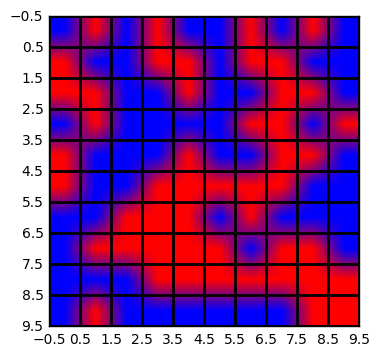

In [42]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np

data = np.random.rand(10, 10) * 20


# create discrete colormap
cmap = colors.ListedColormap(['red', 'blue'])
bounds = [0,10,20]
norm = colors.BoundaryNorm(bounds, cmap.N)

fig, ax = plt.subplots()
ax.imshow(data, cmap=cmap, norm=norm)

# draw gridlines
ax.grid(which='major', axis='both', linestyle='-', color='k', linewidth=2)
ax.set_xticks(np.arange(-.5, 10, 1));
ax.set_yticks(np.arange(-.5, 10, 1));

plt.show()


In [6]:
#yaw_right_data_avgs = 


yr_b1l = np.median(yaw_right_df['b1_l'][150:350])
yr_b2l =  np.median(yaw_right_df['b2_l'][150:350])
yr_b3l =  np.median(yaw_right_df['b3_l'][150:350])
yr_i1l =  np.median(yaw_right_df['i1_l'][150:350])
yr_i2l =  np.median(yaw_right_df['i2_l'][150:350])
yr_iii1l =  np.median(yaw_right_df['iii1_l'][150:350])
yr_iii3l =  np.median(yaw_right_df['iii3_l'][150:350])
yr_hg1l =  np.median(yaw_right_df['hg1_l'][150:350])
yr_hg2l =  np.median(yaw_right_df['hg2_l'][150:350])
yr_hg3l =  np.median(yaw_right_df['hg3_l'][150:350])
yr_hg4l =  np.median(yaw_right_df['hg4_l'][150:350])
yr_b1r =  np.median(yaw_right_df['b1_r'][150:350])
yr_b2r =  np.median(yaw_right_df['b2_r'][150:350])
yr_b3r =  np.median(yaw_right_df['b3_r'][150:350])
yr_i1r =  np.median(yaw_right_df['i1_r'][150:350])
yr_i2r =  np.median(yaw_right_df['i2_r'][150:350])
yr_iii1r =  np.median(yaw_right_df['iii1_r'][150:350])
yr_iii3r =  np.median(yaw_right_df['iii3_r'][150:350])
yr_hg1r =  np.median(yaw_right_df['hg1_r'][150:350])
yr_hg2r =  np.median(yaw_right_df['hg2_r'][150:350])
yr_hg3r =  np.median(yaw_right_df['hg3_r'][150:350])
yr_hg4r =  np.median(yaw_right_df['hg4_r'][150:350])


yl_b1l = np.median(yaw_left_df['b1_l'][150:350])
yl_b2l =  np.median(yaw_left_df['b2_l'][150:350])
yl_b3l =  np.median(yaw_left_df['b3_l'][150:350])
yl_i1l =  np.median(yaw_left_df['i1_l'][150:350])
yl_i2l =  np.median(yaw_left_df['i2_l'][150:350])
yl_iii1l =  np.median(yaw_left_df['iii1_l'][150:350])
yl_iii3l =  np.median(yaw_left_df['iii3_l'][150:350])
yl_hg1l =  np.median(yaw_left_df['hg1_l'][150:350])
yl_hg2l =  np.median(yaw_left_df['hg2_l'][150:350])
yl_hg3l =  np.median(yaw_left_df['hg3_l'][150:350])
yl_hg4l =  np.median(yaw_left_df['hg4_l'][150:350])
yl_b1r =  np.median(yaw_left_df['b1_r'][150:350])
yl_b2r =  np.median(yaw_left_df['b2_r'][150:350])
yl_b3r =  np.median(yaw_left_df['b3_r'][150:350])
yl_i1r =  np.median(yaw_left_df['i1_r'][150:350])
yl_i2r =  np.median(yaw_left_df['i2_r'][150:350])
yl_iii1r =  np.median(yaw_left_df['iii1_r'][150:350])
yl_iii3r =  np.median(yaw_left_df['iii3_r'][150:350])
yl_hg1r =  np.median(yaw_left_df['hg1_r'][150:350])
yl_hg2r =  np.median(yaw_left_df['hg2_r'][150:350])
yl_hg3r =  np.median(yaw_left_df['hg3_r'][150:350])
yl_hg4r =  np.median(yaw_left_df['hg4_r'][150:350])



pu_b1l = np.median(pitch_up_df['b1_l'][150:350])
pu_b2l =  np.median(pitch_up_df['b2_l'][150:350])
pu_b3l =  np.median(pitch_up_df['b3_l'][150:350])
pu_i1l =  np.median(pitch_up_df['i1_l'][150:350])
pu_i2l =  np.median(pitch_up_df['i2_l'][150:350])
pu_iii1l =  np.median(pitch_up_df['iii1_l'][150:350])
pu_iii3l =  np.median(pitch_up_df['iii3_l'][150:350])
pu_hg1l =  np.median(pitch_up_df['hg1_l'][150:350])
pu_hg2l =  np.median(pitch_up_df['hg2_l'][150:350])
pu_hg3l =  np.median(pitch_up_df['hg3_l'][150:350])
pu_hg4l =  np.median(pitch_up_df['hg4_l'][150:350])
pu_b1r =  np.median(pitch_up_df['b1_r'][150:350])
pu_b2r =  np.median(pitch_up_df['b2_r'][150:350])
pu_b3r =  np.median(pitch_up_df['b3_r'][150:350])
pu_i1r =  np.median(pitch_up_df['i1_r'][150:350])
pu_i2r =  np.median(pitch_up_df['i2_r'][150:350])
pu_iii1r =  np.median(pitch_up_df['iii1_r'][150:350])
pu_iii3r =  np.median(pitch_up_df['iii3_r'][150:350])
pu_hg1r =  np.median(pitch_up_df['hg1_r'][150:350])
pu_hg2r =  np.median(pitch_up_df['hg2_r'][150:350])
pu_hg3r =  np.median(pitch_up_df['hg3_r'][150:350])
pu_hg4r =  np.median(pitch_up_df['hg4_r'][150:350])



pd_b1l = np.median(pitch_down_df['b1_l'][150:350])
pd_b2l =  np.median(pitch_down_df['b2_l'][150:350])
pd_b3l =  np.median(pitch_down_df['b3_l'][150:350])
pd_i1l =  np.median(pitch_down_df['i1_l'][150:350])
pd_i2l =  np.median(pitch_down_df['i2_l'][150:350])
pd_iii1l =  np.median(pitch_down_df['iii1_l'][150:350])
pd_iii3l =  np.median(pitch_down_df['iii3_l'][150:350])
pd_hg1l =  np.median(pitch_down_df['hg1_l'][150:350])
pd_hg2l =  np.median(pitch_down_df['hg2_l'][150:350])
pd_hg3l =  np.median(pitch_down_df['hg3_l'][150:350])
pd_hg4l =  np.median(pitch_down_df['hg4_l'][150:350])
pd_b1r =  np.median(pitch_down_df['b1_r'][150:350])
pd_b2r =  np.median(pitch_down_df['b2_r'][150:350])
pd_b3r =  np.median(pitch_down_df['b3_r'][150:350])
pd_i1r =  np.median(pitch_down_df['i1_r'][150:350])
pd_i2r =  np.median(pitch_down_df['i2_r'][150:350])
pd_iii1r =  np.median(pitch_down_df['iii1_r'][150:350])
pd_iii3r =  np.median(pitch_down_df['iii3_r'][150:350])
pd_hg1r =  np.median(pitch_down_df['hg1_r'][150:350])
pd_hg2r =  np.median(pitch_down_df['hg2_r'][150:350])
pd_hg3r =  np.median(pitch_down_df['hg3_r'][150:350])
pd_hg4r =  np.median(pitch_down_df['hg4_r'][150:350])




rc_b1l = np.median(roll_cw_df['b1_l'][150:350])
rc_b2l =  np.median(roll_cw_df['b2_l'][150:350])
rc_b3l =  np.median(roll_cw_df['b3_l'][150:350])
rc_i1l =  np.median(roll_cw_df['i1_l'][150:350])
rc_i2l =  np.median(roll_cw_df['i2_l'][150:350])
rc_iii1l =  np.median(roll_cw_df['iii1_l'][150:350])
rc_iii3l =  np.median(roll_cw_df['iii3_l'][150:350])
rc_hg1l =  np.median(roll_cw_df['hg1_l'][150:350])
rc_hg2l =  np.median(roll_cw_df['hg2_l'][150:350])
rc_hg3l =  np.median(roll_cw_df['hg3_l'][150:350])
rc_hg4l =  np.median(roll_cw_df['hg4_l'][150:350])
rc_b1r =  np.median(roll_cw_df['b1_r'][150:350])
rc_b2r =  np.median(roll_cw_df['b2_r'][150:350])
rc_b3r =  np.median(roll_cw_df['b3_r'][150:350])
rc_i1r =  np.median(roll_cw_df['i1_r'][150:350])
rc_i2r =  np.median(roll_cw_df['i2_r'][150:350])
rc_iii1r =  np.median(roll_cw_df['iii1_r'][150:350])
rc_iii3r =  np.median(roll_cw_df['iii3_r'][150:350])
rc_hg1r =  np.median(roll_cw_df['hg1_r'][150:350])
rc_hg2r =  np.median(roll_cw_df['hg2_r'][150:350])
rc_hg3r =  np.median(roll_cw_df['hg3_r'][150:350])
rc_hg4r =  np.median(roll_cw_df['hg4_r'][150:350])



rcc_b1l = np.median(roll_ccw_df['b1_l'][150:350])
rcc_b2l =  np.median(roll_ccw_df['b2_l'][150:350])
rcc_b3l =  np.median(roll_ccw_df['b3_l'][150:350])
rcc_i1l =  np.median(roll_ccw_df['i1_l'][150:350])
rcc_i2l =  np.median(roll_ccw_df['i2_l'][150:350])
rcc_iii1l =  np.median(roll_ccw_df['iii1_l'][150:350])
rcc_iii3l =  np.median(roll_ccw_df['iii3_l'][150:350])
rcc_hg1l =  np.median(roll_ccw_df['hg1_l'][150:350])
rcc_hg2l =  np.median(roll_ccw_df['hg2_l'][150:350])
rcc_hg3l =  np.median(roll_ccw_df['hg3_l'][150:350])
rcc_hg4l =  np.median(roll_ccw_df['hg4_l'][150:350])
rcc_b1r =  np.median(roll_ccw_df['b1_r'][150:350])
rcc_b2r =  np.median(roll_ccw_df['b2_r'][150:350])
rcc_b3r =  np.median(roll_ccw_df['b3_r'][150:350])
rcc_i1r =  np.median(roll_ccw_df['i1_r'][150:350])
rcc_i2r =  np.median(roll_ccw_df['i2_r'][150:350])
rcc_iii1r =  np.median(roll_ccw_df['iii1_r'][150:350])
rcc_iii3r =  np.median(roll_ccw_df['iii3_r'][150:350])
rcc_hg1r =  np.median(roll_ccw_df['hg1_r'][150:350])
rcc_hg2r =  np.median(roll_ccw_df['hg2_r'][150:350])
rcc_hg3r =  np.median(roll_ccw_df['hg3_r'][150:350])
rcc_hg4r =  np.median(roll_ccw_df['hg4_r'][150:350])


NameError: name 'yaw_right_df' is not defined

In [9]:
start_ind = 150
stop_ind = 350

yr_b1l = np.median(yaw_right_df['b1_l'][start_ind:stop_ind])
yr_b2l =  np.median(yaw_right_df['b2_l'][start_ind:stop_ind])
yr_b3l =  np.median(yaw_right_df['b3_l'][start_ind:stop_ind])
yr_i1l =  np.median(yaw_right_df['i1_l'][start_ind:stop_ind])
yr_i2l =  np.median(yaw_right_df['i2_l'][start_ind:stop_ind])
yr_iii1l =  np.median(yaw_right_df['iii1_l'][start_ind:stop_ind])
yr_iii3l =  np.median(yaw_right_df['iii3_l'][start_ind:stop_ind])
yr_hg1l =  np.median(yaw_right_df['hg1_l'][start_ind:stop_ind])
yr_hg2l =  np.median(yaw_right_df['hg2_l'][start_ind:stop_ind])
yr_hg3l =  np.median(yaw_right_df['hg3_l'][start_ind:stop_ind])
yr_hg4l =  np.median(yaw_right_df['hg4_l'][start_ind:stop_ind])
yr_b1r =  np.median(yaw_right_df['b1_r'][start_ind:stop_ind])
yr_b2r =  np.median(yaw_right_df['b2_r'][start_ind:stop_ind])
yr_b3r =  np.median(yaw_right_df['b3_r'][start_ind:stop_ind])
yr_i1r =  np.median(yaw_right_df['i1_r'][start_ind:stop_ind])
yr_i2r =  np.median(yaw_right_df['i2_r'][start_ind:stop_ind])
yr_iii1r =  np.median(yaw_right_df['iii1_r'][start_ind:stop_ind])
yr_iii3r =  np.median(yaw_right_df['iii3_r'][start_ind:stop_ind])
yr_hg1r =  np.median(yaw_right_df['hg1_r'][start_ind:stop_ind])
yr_hg2r =  np.median(yaw_right_df['hg2_r'][start_ind:stop_ind])
yr_hg3r =  np.median(yaw_right_df['hg3_r'][start_ind:stop_ind])
yr_hg4r =  np.median(yaw_right_df['hg4_r'][start_ind:stop_ind])


yl_b1l = np.median(yaw_left_df['b1_l'][start_ind:stop_ind])
yl_b2l =  np.median(yaw_left_df['b2_l'][start_ind:stop_ind])
yl_b3l =  np.median(yaw_left_df['b3_l'][start_ind:stop_ind])
yl_i1l =  np.median(yaw_left_df['i1_l'][start_ind:stop_ind])
yl_i2l =  np.median(yaw_left_df['i2_l'][start_ind:stop_ind])
yl_iii1l =  np.median(yaw_left_df['iii1_l'][start_ind:stop_ind])
yl_iii3l =  np.median(yaw_left_df['iii3_l'][start_ind:stop_ind])
yl_hg1l =  np.median(yaw_left_df['hg1_l'][start_ind:stop_ind])
yl_hg2l =  np.median(yaw_left_df['hg2_l'][start_ind:stop_ind])
yl_hg3l =  np.median(yaw_left_df['hg3_l'][start_ind:stop_ind])
yl_hg4l =  np.median(yaw_left_df['hg4_l'][start_ind:stop_ind])
yl_b1r =  np.median(yaw_left_df['b1_r'][start_ind:stop_ind])
yl_b2r =  np.median(yaw_left_df['b2_r'][start_ind:stop_ind])
yl_b3r =  np.median(yaw_left_df['b3_r'][start_ind:stop_ind])
yl_i1r =  np.median(yaw_left_df['i1_r'][start_ind:stop_ind])
yl_i2r =  np.median(yaw_left_df['i2_r'][start_ind:stop_ind])
yl_iii1r =  np.median(yaw_left_df['iii1_r'][start_ind:stop_ind])
yl_iii3r =  np.median(yaw_left_df['iii3_r'][start_ind:stop_ind])
yl_hg1r =  np.median(yaw_left_df['hg1_r'][start_ind:stop_ind])
yl_hg2r =  np.median(yaw_left_df['hg2_r'][start_ind:stop_ind])
yl_hg3r =  np.median(yaw_left_df['hg3_r'][start_ind:stop_ind])
yl_hg4r =  np.median(yaw_left_df['hg4_r'][start_ind:stop_ind])



pu_b1l = np.median(pitch_up_df['b1_l'][start_ind:stop_ind])
pu_b2l =  np.median(pitch_up_df['b2_l'][start_ind:stop_ind])
pu_b3l =  np.median(pitch_up_df['b3_l'][start_ind:stop_ind])
pu_i1l =  np.median(pitch_up_df['i1_l'][start_ind:stop_ind])
pu_i2l =  np.median(pitch_up_df['i2_l'][start_ind:stop_ind])
pu_iii1l =  np.median(pitch_up_df['iii1_l'][start_ind:stop_ind])
pu_iii3l =  np.median(pitch_up_df['iii3_l'][start_ind:stop_ind])
pu_hg1l =  np.median(pitch_up_df['hg1_l'][start_ind:stop_ind])
pu_hg2l =  np.median(pitch_up_df['hg2_l'][start_ind:stop_ind])
pu_hg3l =  np.median(pitch_up_df['hg3_l'][start_ind:stop_ind])
pu_hg4l =  np.median(pitch_up_df['hg4_l'][start_ind:stop_ind])
pu_b1r =  np.median(pitch_up_df['b1_r'][start_ind:stop_ind])
pu_b2r =  np.median(pitch_up_df['b2_r'][start_ind:stop_ind])
pu_b3r =  np.median(pitch_up_df['b3_r'][start_ind:stop_ind])
pu_i1r =  np.median(pitch_up_df['i1_r'][start_ind:stop_ind])
pu_i2r =  np.median(pitch_up_df['i2_r'][start_ind:stop_ind])
pu_iii1r =  np.median(pitch_up_df['iii1_r'][start_ind:stop_ind])
pu_iii3r =  np.median(pitch_up_df['iii3_r'][start_ind:stop_ind])
pu_hg1r =  np.median(pitch_up_df['hg1_r'][start_ind:stop_ind])
pu_hg2r =  np.median(pitch_up_df['hg2_r'][start_ind:stop_ind])
pu_hg3r =  np.median(pitch_up_df['hg3_r'][start_ind:stop_ind])
pu_hg4r =  np.median(pitch_up_df['hg4_r'][start_ind:stop_ind])



pd_b1l = np.median(pitch_down_df['b1_l'][start_ind:stop_ind])
pd_b2l =  np.median(pitch_down_df['b2_l'][start_ind:stop_ind])
pd_b3l =  np.median(pitch_down_df['b3_l'][start_ind:stop_ind])
pd_i1l =  np.median(pitch_down_df['i1_l'][start_ind:stop_ind])
pd_i2l =  np.median(pitch_down_df['i2_l'][start_ind:stop_ind])
pd_iii1l =  np.median(pitch_down_df['iii1_l'][start_ind:stop_ind])
pd_iii3l =  np.median(pitch_down_df['iii3_l'][start_ind:stop_ind])
pd_hg1l =  np.median(pitch_down_df['hg1_l'][start_ind:stop_ind])
pd_hg2l =  np.median(pitch_down_df['hg2_l'][start_ind:stop_ind])
pd_hg3l =  np.median(pitch_down_df['hg3_l'][start_ind:stop_ind])
pd_hg4l =  np.median(pitch_down_df['hg4_l'][start_ind:stop_ind])
pd_b1r =  np.median(pitch_down_df['b1_r'][start_ind:stop_ind])
pd_b2r =  np.median(pitch_down_df['b2_r'][start_ind:stop_ind])
pd_b3r =  np.median(pitch_down_df['b3_r'][start_ind:stop_ind])
pd_i1r =  np.median(pitch_down_df['i1_r'][start_ind:stop_ind])
pd_i2r =  np.median(pitch_down_df['i2_r'][start_ind:stop_ind])
pd_iii1r =  np.median(pitch_down_df['iii1_r'][start_ind:stop_ind])
pd_iii3r =  np.median(pitch_down_df['iii3_r'][start_ind:stop_ind])
pd_hg1r =  np.median(pitch_down_df['hg1_r'][start_ind:stop_ind])
pd_hg2r =  np.median(pitch_down_df['hg2_r'][start_ind:stop_ind])
pd_hg3r =  np.median(pitch_down_df['hg3_r'][start_ind:stop_ind])
pd_hg4r =  np.median(pitch_down_df['hg4_r'][start_ind:stop_ind])




rc_b1l = np.median(roll_cw_df['b1_l'][start_ind:stop_ind])
rc_b2l =  np.median(roll_cw_df['b2_l'][start_ind:stop_ind])
rc_b3l =  np.median(roll_cw_df['b3_l'][start_ind:stop_ind])
rc_i1l =  np.median(roll_cw_df['i1_l'][start_ind:stop_ind])
rc_i2l =  np.median(roll_cw_df['i2_l'][start_ind:stop_ind])
rc_iii1l =  np.median(roll_cw_df['iii1_l'][start_ind:stop_ind])
rc_iii3l =  np.median(roll_cw_df['iii3_l'][start_ind:stop_ind])
rc_hg1l =  np.median(roll_cw_df['hg1_l'][start_ind:stop_ind])
rc_hg2l =  np.median(roll_cw_df['hg2_l'][start_ind:stop_ind])
rc_hg3l =  np.median(roll_cw_df['hg3_l'][start_ind:stop_ind])
rc_hg4l =  np.median(roll_cw_df['hg4_l'][start_ind:stop_ind])
rc_b1r =  np.median(roll_cw_df['b1_r'][start_ind:stop_ind])
rc_b2r =  np.median(roll_cw_df['b2_r'][start_ind:stop_ind])
rc_b3r =  np.median(roll_cw_df['b3_r'][start_ind:stop_ind])
rc_i1r =  np.median(roll_cw_df['i1_r'][start_ind:stop_ind])
rc_i2r =  np.median(roll_cw_df['i2_r'][start_ind:stop_ind])
rc_iii1r =  np.median(roll_cw_df['iii1_r'][start_ind:stop_ind])
rc_iii3r =  np.median(roll_cw_df['iii3_r'][start_ind:stop_ind])
rc_hg1r =  np.median(roll_cw_df['hg1_r'][start_ind:stop_ind])
rc_hg2r =  np.median(roll_cw_df['hg2_r'][start_ind:stop_ind])
rc_hg3r =  np.median(roll_cw_df['hg3_r'][start_ind:stop_ind])
rc_hg4r =  np.median(roll_cw_df['hg4_r'][start_ind:stop_ind])



rcc_b1l = np.median(roll_ccw_df['b1_l'][start_ind:stop_ind])
rcc_b2l =  np.median(roll_ccw_df['b2_l'][start_ind:stop_ind])
rcc_b3l =  np.median(roll_ccw_df['b3_l'][start_ind:stop_ind])
rcc_i1l =  np.median(roll_ccw_df['i1_l'][start_ind:stop_ind])
rcc_i2l =  np.median(roll_ccw_df['i2_l'][start_ind:stop_ind])
rcc_iii1l =  np.median(roll_ccw_df['iii1_l'][start_ind:stop_ind])
rcc_iii3l =  np.median(roll_ccw_df['iii3_l'][start_ind:stop_ind])
rcc_hg1l =  np.median(roll_ccw_df['hg1_l'][start_ind:stop_ind])
rcc_hg2l =  np.median(roll_ccw_df['hg2_l'][start_ind:stop_ind])
rcc_hg3l =  np.median(roll_ccw_df['hg3_l'][start_ind:stop_ind])
rcc_hg4l =  np.median(roll_ccw_df['hg4_l'][start_ind:stop_ind])
rcc_b1r =  np.median(roll_ccw_df['b1_r'][start_ind:stop_ind])
rcc_b2r =  np.median(roll_ccw_df['b2_r'][start_ind:stop_ind])
rcc_b3r =  np.median(roll_ccw_df['b3_r'][start_ind:stop_ind])
rcc_i1r =  np.median(roll_ccw_df['i1_r'][start_ind:stop_ind])
rcc_i2r =  np.median(roll_ccw_df['i2_r'][start_ind:stop_ind])
rcc_iii1r =  np.median(roll_ccw_df['iii1_r'][start_ind:stop_ind])
rcc_iii3r =  np.median(roll_ccw_df['iii3_r'][start_ind:stop_ind])
rcc_hg1r =  np.median(roll_ccw_df['hg1_r'][start_ind:stop_ind])
rcc_hg2r =  np.median(roll_ccw_df['hg2_r'][start_ind:stop_ind])
rcc_hg3r =  np.median(roll_ccw_df['hg3_r'][start_ind:stop_ind])
rcc_hg4r =  np.median(roll_ccw_df['hg4_r'][start_ind:stop_ind])


In [10]:
#yaw_right_data_avgs = 


er_yr_b1l = np.median(yaw_right_er_df['b1_l'][150:350])
er_yr_b2l =  np.median(yaw_right_er_df['b2_l'][150:350])
er_yr_b3l =  np.median(yaw_right_er_df['b3_l'][150:350])
er_yr_i1l =  np.median(yaw_right_er_df['i1_l'][150:350])
er_yr_i2l =  np.median(yaw_right_er_df['i2_l'][150:350])
er_yr_iii1l =  np.median(yaw_right_er_df['iii1_l'][150:350])
er_yr_iii3l =  np.median(yaw_right_er_df['iii3_l'][150:350])
er_yr_hg1l =  np.median(yaw_right_er_df['hg1_l'][150:350])
er_yr_hg2l =  np.median(yaw_right_er_df['hg2_l'][150:350])
er_yr_hg3l =  np.median(yaw_right_er_df['hg3_l'][150:350])
er_yr_hg4l =  np.median(yaw_right_er_df['hg4_l'][150:350])
er_yr_b1r =  np.median(yaw_right_er_df['b1_r'][150:350])
er_yr_b2r =  np.median(yaw_right_er_df['b2_r'][150:350])
er_yr_b3r =  np.median(yaw_right_er_df['b3_r'][150:350])
er_yr_i1r =  np.median(yaw_right_er_df['i1_r'][150:350])
er_yr_i2r =  np.median(yaw_right_er_df['i2_r'][150:350])
er_yr_iii1r =  np.median(yaw_right_er_df['iii1_r'][150:350])
er_yr_iii3r =  np.median(yaw_right_er_df['iii3_r'][150:350])
er_yr_hg1r =  np.median(yaw_right_er_df['hg1_r'][150:350])
er_yr_hg2r =  np.median(yaw_right_er_df['hg2_r'][150:350])
er_yr_hg3r =  np.median(yaw_right_er_df['hg3_r'][150:350])
er_yr_hg4r =  np.median(yaw_right_er_df['hg4_r'][150:350])


er_yl_b1l = np.median(yaw_left_er_df['b1_l'][150:350])
er_yl_b2l =  np.median(yaw_left_er_df['b2_l'][150:350])
er_yl_b3l =  np.median(yaw_left_er_df['b3_l'][150:350])
er_yl_i1l =  np.median(yaw_left_er_df['i1_l'][150:350])
er_yl_i2l =  np.median(yaw_left_er_df['i2_l'][150:350])
er_yl_iii1l =  np.median(yaw_left_er_df['iii1_l'][150:350])
er_yl_iii3l =  np.median(yaw_left_er_df['iii3_l'][150:350])
er_yl_hg1l =  np.median(yaw_left_er_df['hg1_l'][150:350])
er_yl_hg2l =  np.median(yaw_left_er_df['hg2_l'][150:350])
er_yl_hg3l =  np.median(yaw_left_er_df['hg3_l'][150:350])
er_yl_hg4l =  np.median(yaw_left_er_df['hg4_l'][150:350])
er_yl_b1r =  np.median(yaw_left_er_df['b1_r'][150:350])
er_yl_b2r =  np.median(yaw_left_er_df['b2_r'][150:350])
er_yl_b3r =  np.median(yaw_left_er_df['b3_r'][150:350])
er_yl_i1r =  np.median(yaw_left_er_df['i1_r'][150:350])
er_yl_i2r =  np.median(yaw_left_er_df['i2_r'][150:350])
er_yl_iii1r =  np.median(yaw_left_er_df['iii1_r'][150:350])
er_yl_iii3r =  np.median(yaw_left_er_df['iii3_r'][150:350])
er_yl_hg1r =  np.median(yaw_left_er_df['hg1_r'][150:350])
er_yl_hg2r =  np.median(yaw_left_er_df['hg2_r'][150:350])
er_yl_hg3r =  np.median(yaw_left_er_df['hg3_r'][150:350])
er_yl_hg4r =  np.median(yaw_left_er_df['hg4_r'][150:350])



er_pu_b1l = np.median(pitch_up_er_df['b1_l'][150:350])
er_pu_b2l =  np.median(pitch_up_er_df['b2_l'][150:350])
er_pu_b3l =  np.median(pitch_up_er_df['b3_l'][150:350])
er_pu_i1l =  np.median(pitch_up_er_df['i1_l'][150:350])
er_pu_i2l =  np.median(pitch_up_er_df['i2_l'][150:350])
er_pu_iii1l =  np.median(pitch_up_er_df['iii1_l'][150:350])
er_pu_iii3l =  np.median(pitch_up_er_df['iii3_l'][150:350])
er_pu_hg1l =  np.median(pitch_up_er_df['hg1_l'][150:350])
er_pu_hg2l =  np.median(pitch_up_er_df['hg2_l'][150:350])
er_pu_hg3l =  np.median(pitch_up_er_df['hg3_l'][150:350])
er_pu_hg4l =  np.median(pitch_up_er_df['hg4_l'][150:350])
er_pu_b1r =  np.median(pitch_up_er_df['b1_r'][150:350])
er_pu_b2r =  np.median(pitch_up_er_df['b2_r'][150:350])
er_pu_b3r =  np.median(pitch_up_er_df['b3_r'][150:350])
er_pu_i1r =  np.median(pitch_up_er_df['i1_r'][150:350])
er_pu_i2r =  np.median(pitch_up_er_df['i2_r'][150:350])
er_pu_iii1r =  np.median(pitch_up_er_df['iii1_r'][150:350])
er_pu_iii3r =  np.median(pitch_up_er_df['iii3_r'][150:350])
er_pu_hg1r =  np.median(pitch_up_er_df['hg1_r'][150:350])
er_pu_hg2r =  np.median(pitch_up_er_df['hg2_r'][150:350])
er_pu_hg3r =  np.median(pitch_up_er_df['hg3_r'][150:350])
er_pu_hg4r =  np.median(pitch_up_er_df['hg4_r'][150:350])



er_pd_b1l = np.median(pitch_down_er_df['b1_l'][150:350])
er_pd_b2l =  np.median(pitch_down_er_df['b2_l'][150:350])
er_pd_b3l =  np.median(pitch_down_er_df['b3_l'][150:350])
er_pd_i1l =  np.median(pitch_down_er_df['i1_l'][150:350])
er_pd_i2l =  np.median(pitch_down_er_df['i2_l'][150:350])
er_pd_iii1l =  np.median(pitch_down_er_df['iii1_l'][150:350])
er_pd_iii3l =  np.median(pitch_down_er_df['iii3_l'][150:350])
er_pd_hg1l =  np.median(pitch_down_er_df['hg1_l'][150:350])
er_pd_hg2l =  np.median(pitch_down_er_df['hg2_l'][150:350])
er_pd_hg3l =  np.median(pitch_down_er_df['hg3_l'][150:350])
er_pd_hg4l =  np.median(pitch_down_er_df['hg4_l'][150:350])
er_pd_b1r =  np.median(pitch_down_er_df['b1_r'][150:350])
er_pd_b2r =  np.median(pitch_down_er_df['b2_r'][150:350])
er_pd_b3r =  np.median(pitch_down_er_df['b3_r'][150:350])
er_pd_i1r =  np.median(pitch_down_er_df['i1_r'][150:350])
er_pd_i2r =  np.median(pitch_down_er_df['i2_r'][150:350])
er_pd_iii1r =  np.median(pitch_down_er_df['iii1_r'][150:350])
er_pd_iii3r =  np.median(pitch_down_er_df['iii3_r'][150:350])
er_pd_hg1r =  np.median(pitch_down_er_df['hg1_r'][150:350])
er_pd_hg2r =  np.median(pitch_down_er_df['hg2_r'][150:350])
er_pd_hg3r =  np.median(pitch_down_er_df['hg3_r'][150:350])
er_pd_hg4r =  np.median(pitch_down_er_df['hg4_r'][150:350])




er_rc_b1l = np.median(roll_cw_er_df['b1_l'][150:350])
er_rc_b2l =  np.median(roll_cw_er_df['b2_l'][150:350])
er_rc_b3l =  np.median(roll_cw_er_df['b3_l'][150:350])
er_rc_i1l =  np.median(roll_cw_er_df['i1_l'][150:350])
er_rc_i2l =  np.median(roll_cw_er_df['i2_l'][150:350])
er_rc_iii1l =  np.median(roll_cw_er_df['iii1_l'][150:350])
er_rc_iii3l =  np.median(roll_cw_er_df['iii3_l'][150:350])
er_rc_hg1l =  np.median(roll_cw_er_df['hg1_l'][150:350])
er_rc_hg2l =  np.median(roll_cw_er_df['hg2_l'][150:350])
er_rc_hg3l =  np.median(roll_cw_er_df['hg3_l'][150:350])
er_rc_hg4l =  np.median(roll_cw_er_df['hg4_l'][150:350])
er_rc_b1r =  np.median(roll_cw_er_df['b1_r'][150:350])
er_rc_b2r =  np.median(roll_cw_er_df['b2_r'][150:350])
er_rc_b3r =  np.median(roll_cw_er_df['b3_r'][150:350])
er_rc_i1r =  np.median(roll_cw_er_df['i1_r'][150:350])
er_rc_i2r =  np.median(roll_cw_er_df['i2_r'][150:350])
er_rc_iii1r =  np.median(roll_cw_er_df['iii1_r'][150:350])
er_rc_iii3r =  np.median(roll_cw_er_df['iii3_r'][150:350])
er_rc_hg1r =  np.median(roll_cw_er_df['hg1_r'][150:350])
er_rc_hg2r =  np.median(roll_cw_er_df['hg2_r'][150:350])
er_rc_hg3r =  np.median(roll_cw_er_df['hg3_r'][150:350])
er_rc_hg4r =  np.median(roll_cw_er_df['hg4_r'][150:350])



er_rcc_b1l = np.median(roll_ccw_er_df['b1_l'][150:350])
er_rcc_b2l =  np.median(roll_ccw_er_df['b2_l'][150:350])
er_rcc_b3l =  np.median(roll_ccw_er_df['b3_l'][150:350])
er_rcc_i1l =  np.median(roll_ccw_er_df['i1_l'][150:350])
er_rcc_i2l =  np.median(roll_ccw_er_df['i2_l'][150:350])
er_rcc_iii1l =  np.median(roll_ccw_er_df['iii1_l'][150:350])
er_rcc_iii3l =  np.median(roll_ccw_er_df['iii3_l'][150:350])
er_rcc_hg1l =  np.median(roll_ccw_er_df['hg1_l'][150:350])
er_rcc_hg2l =  np.median(roll_ccw_er_df['hg2_l'][150:350])
er_rcc_hg3l =  np.median(roll_ccw_er_df['hg3_l'][150:350])
er_rcc_hg4l =  np.median(roll_ccw_er_df['hg4_l'][150:350])
er_rcc_b1r =  np.median(roll_ccw_er_df['b1_r'][150:350])
er_rcc_b2r =  np.median(roll_ccw_er_df['b2_r'][150:350])
er_rcc_b3r =  np.median(roll_ccw_er_df['b3_r'][150:350])
er_rcc_i1r =  np.median(roll_ccw_er_df['i1_r'][150:350])
er_rcc_i2r =  np.median(roll_ccw_er_df['i2_r'][150:350])
er_rcc_iii1r =  np.median(roll_ccw_er_df['iii1_r'][150:350])
er_rcc_iii3r =  np.median(roll_ccw_er_df['iii3_r'][150:350])
er_rcc_hg1r =  np.median(roll_ccw_er_df['hg1_r'][150:350])
er_rcc_hg2r =  np.median(roll_ccw_er_df['hg2_r'][150:350])
er_rcc_hg3r =  np.median(roll_ccw_er_df['hg3_r'][150:350])
er_rcc_hg4r =  np.median(roll_ccw_er_df['hg4_r'][150:350])


In [11]:
start_ind =150
stop_ind = 350

er_yr_b1l = np.median(yaw_right_er_df['b1_l'][start_ind:stop_ind])
er_yr_b2l =  np.median(yaw_right_er_df['b2_l'][start_ind:stop_ind])
er_yr_b3l =  np.median(yaw_right_er_df['b3_l'][start_ind:stop_ind])
er_yr_i1l =  np.median(yaw_right_er_df['i1_l'][start_ind:stop_ind])
er_yr_i2l =  np.median(yaw_right_er_df['i2_l'][start_ind:stop_ind])
er_yr_iii1l =  np.median(yaw_right_er_df['iii1_l'][start_ind:stop_ind])
er_yr_iii3l =  np.median(yaw_right_er_df['iii3_l'][start_ind:stop_ind])
er_yr_hg1l =  np.median(yaw_right_er_df['hg1_l'][start_ind:stop_ind])
er_yr_hg2l =  np.median(yaw_right_er_df['hg2_l'][start_ind:stop_ind])
er_yr_hg3l =  np.median(yaw_right_er_df['hg3_l'][start_ind:stop_ind])
er_yr_hg4l =  np.median(yaw_right_er_df['hg4_l'][start_ind:stop_ind])
er_yr_b1r =  np.median(yaw_right_er_df['b1_r'][start_ind:stop_ind])
er_yr_b2r =  np.median(yaw_right_er_df['b2_r'][start_ind:stop_ind])
er_yr_b3r =  np.median(yaw_right_er_df['b3_r'][start_ind:stop_ind])
er_yr_i1r =  np.median(yaw_right_er_df['i1_r'][start_ind:stop_ind])
er_yr_i2r =  np.median(yaw_right_er_df['i2_r'][start_ind:stop_ind])
er_yr_iii1r =  np.median(yaw_right_er_df['iii1_r'][start_ind:stop_ind])
er_yr_iii3r =  np.median(yaw_right_er_df['iii3_r'][start_ind:stop_ind])
er_yr_hg1r =  np.median(yaw_right_er_df['hg1_r'][start_ind:stop_ind])
er_yr_hg2r =  np.median(yaw_right_er_df['hg2_r'][start_ind:stop_ind])
er_yr_hg3r =  np.median(yaw_right_er_df['hg3_r'][start_ind:stop_ind])
er_yr_hg4r =  np.median(yaw_right_er_df['hg4_r'][start_ind:stop_ind])


er_yl_b1l = np.median(yaw_left_er_df['b1_l'][start_ind:stop_ind])
er_yl_b2l =  np.median(yaw_left_er_df['b2_l'][start_ind:stop_ind])
er_yl_b3l =  np.median(yaw_left_er_df['b3_l'][start_ind:stop_ind])
er_yl_i1l =  np.median(yaw_left_er_df['i1_l'][start_ind:stop_ind])
er_yl_i2l =  np.median(yaw_left_er_df['i2_l'][start_ind:stop_ind])
er_yl_iii1l =  np.median(yaw_left_er_df['iii1_l'][start_ind:stop_ind])
er_yl_iii3l =  np.median(yaw_left_er_df['iii3_l'][start_ind:stop_ind])
er_yl_hg1l =  np.median(yaw_left_er_df['hg1_l'][start_ind:stop_ind])
er_yl_hg2l =  np.median(yaw_left_er_df['hg2_l'][start_ind:stop_ind])
er_yl_hg3l =  np.median(yaw_left_er_df['hg3_l'][start_ind:stop_ind])
er_yl_hg4l =  np.median(yaw_left_er_df['hg4_l'][start_ind:stop_ind])
er_yl_b1r =  np.median(yaw_left_er_df['b1_r'][start_ind:stop_ind])
er_yl_b2r =  np.median(yaw_left_er_df['b2_r'][start_ind:stop_ind])
er_yl_b3r =  np.median(yaw_left_er_df['b3_r'][start_ind:stop_ind])
er_yl_i1r =  np.median(yaw_left_er_df['i1_r'][start_ind:stop_ind])
er_yl_i2r =  np.median(yaw_left_er_df['i2_r'][start_ind:stop_ind])
er_yl_iii1r =  np.median(yaw_left_er_df['iii1_r'][start_ind:stop_ind])
er_yl_iii3r =  np.median(yaw_left_er_df['iii3_r'][start_ind:stop_ind])
er_yl_hg1r =  np.median(yaw_left_er_df['hg1_r'][start_ind:stop_ind])
er_yl_hg2r =  np.median(yaw_left_er_df['hg2_r'][start_ind:stop_ind])
er_yl_hg3r =  np.median(yaw_left_er_df['hg3_r'][start_ind:stop_ind])
er_yl_hg4r =  np.median(yaw_left_er_df['hg4_r'][start_ind:stop_ind])



er_pu_b1l = np.median(pitch_up_er_df['b1_l'][start_ind:stop_ind])
er_pu_b2l =  np.median(pitch_up_er_df['b2_l'][start_ind:stop_ind])
er_pu_b3l =  np.median(pitch_up_er_df['b3_l'][start_ind:stop_ind])
er_pu_i1l =  np.median(pitch_up_er_df['i1_l'][start_ind:stop_ind])
er_pu_i2l =  np.median(pitch_up_er_df['i2_l'][start_ind:stop_ind])
er_pu_iii1l =  np.median(pitch_up_er_df['iii1_l'][start_ind:stop_ind])
er_pu_iii3l =  np.median(pitch_up_er_df['iii3_l'][start_ind:stop_ind])
er_pu_hg1l =  np.median(pitch_up_er_df['hg1_l'][start_ind:stop_ind])
er_pu_hg2l =  np.median(pitch_up_er_df['hg2_l'][start_ind:stop_ind])
er_pu_hg3l =  np.median(pitch_up_er_df['hg3_l'][start_ind:stop_ind])
er_pu_hg4l =  np.median(pitch_up_er_df['hg4_l'][start_ind:stop_ind])
er_pu_b1r =  np.median(pitch_up_er_df['b1_r'][start_ind:stop_ind])
er_pu_b2r =  np.median(pitch_up_er_df['b2_r'][start_ind:stop_ind])
er_pu_b3r =  np.median(pitch_up_er_df['b3_r'][start_ind:stop_ind])
er_pu_i1r =  np.median(pitch_up_er_df['i1_r'][start_ind:stop_ind])
er_pu_i2r =  np.median(pitch_up_er_df['i2_r'][start_ind:stop_ind])
er_pu_iii1r =  np.median(pitch_up_er_df['iii1_r'][start_ind:stop_ind])
er_pu_iii3r =  np.median(pitch_up_er_df['iii3_r'][start_ind:stop_ind])
er_pu_hg1r =  np.median(pitch_up_er_df['hg1_r'][start_ind:stop_ind])
er_pu_hg2r =  np.median(pitch_up_er_df['hg2_r'][start_ind:stop_ind])
er_pu_hg3r =  np.median(pitch_up_er_df['hg3_r'][start_ind:stop_ind])
er_pu_hg4r =  np.median(pitch_up_er_df['hg4_r'][start_ind:stop_ind])



er_pd_b1l = np.median(pitch_down_er_df['b1_l'][start_ind:stop_ind])
er_pd_b2l =  np.median(pitch_down_er_df['b2_l'][start_ind:stop_ind])
er_pd_b3l =  np.median(pitch_down_er_df['b3_l'][start_ind:stop_ind])
er_pd_i1l =  np.median(pitch_down_er_df['i1_l'][start_ind:stop_ind])
er_pd_i2l =  np.median(pitch_down_er_df['i2_l'][start_ind:stop_ind])
er_pd_iii1l =  np.median(pitch_down_er_df['iii1_l'][start_ind:stop_ind])
er_pd_iii3l =  np.median(pitch_down_er_df['iii3_l'][start_ind:stop_ind])
er_pd_hg1l =  np.median(pitch_down_er_df['hg1_l'][start_ind:stop_ind])
er_pd_hg2l =  np.median(pitch_down_er_df['hg2_l'][start_ind:stop_ind])
er_pd_hg3l =  np.median(pitch_down_er_df['hg3_l'][start_ind:stop_ind])
er_pd_hg4l =  np.median(pitch_down_er_df['hg4_l'][start_ind:stop_ind])
er_pd_b1r =  np.median(pitch_down_er_df['b1_r'][start_ind:stop_ind])
er_pd_b2r =  np.median(pitch_down_er_df['b2_r'][start_ind:stop_ind])
er_pd_b3r =  np.median(pitch_down_er_df['b3_r'][start_ind:stop_ind])
er_pd_i1r =  np.median(pitch_down_er_df['i1_r'][start_ind:stop_ind])
er_pd_i2r =  np.median(pitch_down_er_df['i2_r'][start_ind:stop_ind])
er_pd_iii1r =  np.median(pitch_down_er_df['iii1_r'][start_ind:stop_ind])
er_pd_iii3r =  np.median(pitch_down_er_df['iii3_r'][start_ind:stop_ind])
er_pd_hg1r =  np.median(pitch_down_er_df['hg1_r'][start_ind:stop_ind])
er_pd_hg2r =  np.median(pitch_down_er_df['hg2_r'][start_ind:stop_ind])
er_pd_hg3r =  np.median(pitch_down_er_df['hg3_r'][start_ind:stop_ind])
er_pd_hg4r =  np.median(pitch_down_er_df['hg4_r'][start_ind:stop_ind])




er_rc_b1l = np.median(roll_cw_er_df['b1_l'][start_ind:stop_ind])
er_rc_b2l =  np.median(roll_cw_er_df['b2_l'][start_ind:stop_ind])
er_rc_b3l =  np.median(roll_cw_er_df['b3_l'][start_ind:stop_ind])
er_rc_i1l =  np.median(roll_cw_er_df['i1_l'][start_ind:stop_ind])
er_rc_i2l =  np.median(roll_cw_er_df['i2_l'][start_ind:stop_ind])
er_rc_iii1l =  np.median(roll_cw_er_df['iii1_l'][start_ind:stop_ind])
er_rc_iii3l =  np.median(roll_cw_er_df['iii3_l'][start_ind:stop_ind])
er_rc_hg1l =  np.median(roll_cw_er_df['hg1_l'][start_ind:stop_ind])
er_rc_hg2l =  np.median(roll_cw_er_df['hg2_l'][start_ind:stop_ind])
er_rc_hg3l =  np.median(roll_cw_er_df['hg3_l'][start_ind:stop_ind])
er_rc_hg4l =  np.median(roll_cw_er_df['hg4_l'][start_ind:stop_ind])
er_rc_b1r =  np.median(roll_cw_er_df['b1_r'][start_ind:stop_ind])
er_rc_b2r =  np.median(roll_cw_er_df['b2_r'][start_ind:stop_ind])
er_rc_b3r =  np.median(roll_cw_er_df['b3_r'][start_ind:stop_ind])
er_rc_i1r =  np.median(roll_cw_er_df['i1_r'][start_ind:stop_ind])
er_rc_i2r =  np.median(roll_cw_er_df['i2_r'][start_ind:stop_ind])
er_rc_iii1r =  np.median(roll_cw_er_df['iii1_r'][start_ind:stop_ind])
er_rc_iii3r =  np.median(roll_cw_er_df['iii3_r'][start_ind:stop_ind])
er_rc_hg1r =  np.median(roll_cw_er_df['hg1_r'][start_ind:stop_ind])
er_rc_hg2r =  np.median(roll_cw_er_df['hg2_r'][start_ind:stop_ind])
er_rc_hg3r =  np.median(roll_cw_er_df['hg3_r'][start_ind:stop_ind])
er_rc_hg4r =  np.median(roll_cw_er_df['hg4_r'][start_ind:stop_ind])



er_rcc_b1l = np.median(roll_ccw_er_df['b1_l'][start_ind:stop_ind])
er_rcc_b2l =  np.median(roll_ccw_er_df['b2_l'][start_ind:stop_ind])
er_rcc_b3l =  np.median(roll_ccw_er_df['b3_l'][start_ind:stop_ind])
er_rcc_i1l =  np.median(roll_ccw_er_df['i1_l'][start_ind:stop_ind])
er_rcc_i2l =  np.median(roll_ccw_er_df['i2_l'][start_ind:stop_ind])
er_rcc_iii1l =  np.median(roll_ccw_er_df['iii1_l'][start_ind:stop_ind])
er_rcc_iii3l =  np.median(roll_ccw_er_df['iii3_l'][start_ind:stop_ind])
er_rcc_hg1l =  np.median(roll_ccw_er_df['hg1_l'][start_ind:stop_ind])
er_rcc_hg2l =  np.median(roll_ccw_er_df['hg2_l'][start_ind:stop_ind])
er_rcc_hg3l =  np.median(roll_ccw_er_df['hg3_l'][start_ind:stop_ind])
er_rcc_hg4l =  np.median(roll_ccw_er_df['hg4_l'][start_ind:stop_ind])
er_rcc_b1r =  np.median(roll_ccw_er_df['b1_r'][start_ind:stop_ind])
er_rcc_b2r =  np.median(roll_ccw_er_df['b2_r'][start_ind:stop_ind])
er_rcc_b3r =  np.median(roll_ccw_er_df['b3_r'][start_ind:stop_ind])
er_rcc_i1r =  np.median(roll_ccw_er_df['i1_r'][start_ind:stop_ind])
er_rcc_i2r =  np.median(roll_ccw_er_df['i2_r'][start_ind:stop_ind])
er_rcc_iii1r =  np.median(roll_ccw_er_df['iii1_r'][start_ind:stop_ind])
er_rcc_iii3r =  np.median(roll_ccw_er_df['iii3_r'][start_ind:stop_ind])
er_rcc_hg1r =  np.median(roll_ccw_er_df['hg1_r'][start_ind:stop_ind])
er_rcc_hg2r =  np.median(roll_ccw_er_df['hg2_r'][start_ind:stop_ind])
er_rcc_hg3r =  np.median(roll_ccw_er_df['hg3_r'][start_ind:stop_ind])
er_rcc_hg4r =  np.median(roll_ccw_er_df['hg4_r'][start_ind:stop_ind])


In [38]:
er_all_yr_b1l = np.median(yaw_right_er_df['b1_l'][0:500])
er_all_yr_b2l =  np.median(yaw_right_er_df['b2_l'][0:500])
er_all_yr_b3l =  np.median(yaw_right_er_df['b3_l'][0:500])
er_all_yr_i1l =  np.median(yaw_right_er_df['i1_l'][0:500])
er_all_yr_i2l =  np.median(yaw_right_er_df['i2_l'][0:500])
er_all_yr_iii1l =  np.median(yaw_right_er_df['iii1_l'][0:500])
er_all_yr_iii3l =  np.median(yaw_right_er_df['iii3_l'][0:500])
er_all_yr_hg1l =  np.median(yaw_right_er_df['hg1_l'][0:500])
er_all_yr_hg2l =  np.median(yaw_right_er_df['hg2_l'][0:500])
er_all_yr_hg3l =  np.median(yaw_right_er_df['hg3_l'][0:500])
er_all_yr_hg4l =  np.median(yaw_right_er_df['hg4_l'][0:500])
er_all_yr_b1r =  np.median(yaw_right_er_df['b1_r'][0:500])
er_all_yr_b2r =  np.median(yaw_right_er_df['b2_r'][0:500])
er_all_yr_b3r =  np.median(yaw_right_er_df['b3_r'][0:500])
er_all_yr_i1r =  np.median(yaw_right_er_df['i1_r'][0:500])
er_all_yr_i2r =  np.median(yaw_right_er_df['i2_r'][0:500])
er_all_yr_iii1r =  np.median(yaw_right_er_df['iii1_r'][0:500])
er_all_yr_iii3r =  np.median(yaw_right_er_df['iii3_r'][0:500])
er_all_yr_hg1r =  np.median(yaw_right_er_df['hg1_r'][0:500])
er_all_yr_hg2r =  np.median(yaw_right_er_df['hg2_r'][0:500])
er_all_yr_hg3r =  np.median(yaw_right_er_df['hg3_r'][0:500])
er_all_yr_hg4r =  np.median(yaw_right_er_df['hg4_r'][0:500])


er_all_yl_b1l = np.median(yaw_left_er_df['b1_l'][0:500])
er_all_yl_b2l =  np.median(yaw_left_er_df['b2_l'][0:500])
er_all_yl_b3l =  np.median(yaw_left_er_df['b3_l'][0:500])
er_all_yl_i1l =  np.median(yaw_left_er_df['i1_l'][0:500])
er_all_yl_i2l =  np.median(yaw_left_er_df['i2_l'][0:500])
er_all_yl_iii1l =  np.median(yaw_left_er_df['iii1_l'][0:500])
er_all_yl_iii3l =  np.median(yaw_left_er_df['iii3_l'][0:500])
er_all_yl_hg1l =  np.median(yaw_left_er_df['hg1_l'][0:500])
er_all_yl_hg2l =  np.median(yaw_left_er_df['hg2_l'][0:500])
er_all_yl_hg3l =  np.median(yaw_left_er_df['hg3_l'][0:500])
er_all_yl_hg4l =  np.median(yaw_left_er_df['hg4_l'][0:500])
er_all_yl_b1r =  np.median(yaw_left_er_df['b1_r'][0:500])
vyl_b2r =  np.median(yaw_left_er_df['b2_r'][0:500])
er_all_yl_b3r =  np.median(yaw_left_er_df['b3_r'][0:500])
er_all_yl_i1r =  np.median(yaw_left_er_df['i1_r'][0:500])
er_all_yl_i2r =  np.median(yaw_left_er_df['i2_r'][0:500])
er_all_yl_iii1r =  np.median(yaw_left_er_df['iii1_r'][0:500])
er_all_yl_iii3r =  np.median(yaw_left_er_df['iii3_r'][0:500])
er_all_yl_hg1r =  np.median(yaw_left_er_df['hg1_r'][0:500])
er_all_yl_hg2r =  np.median(yaw_left_er_df['hg2_r'][0:500])
er_all_yl_hg3r =  np.median(yaw_left_er_df['hg3_r'][0:500])
er_all_yl_hg4r =  np.median(yaw_left_er_df['hg4_r'][0:500])



er_all_pu_b1l = np.median(pitch_up_er_df['b1_l'][0:500])
er_all_pu_b2l =  np.median(pitch_up_er_df['b2_l'][0:500])
er_all_pu_b3l =  np.median(pitch_up_er_df['b3_l'][0:500])
er_all_pu_i1l =  np.median(pitch_up_er_df['i1_l'][0:500])
er_all_pu_i2l =  np.median(pitch_up_er_df['i2_l'][0:500])
er_all_pu_iii1l =  np.median(pitch_up_er_df['iii1_l'][0:500])
er_all_pu_iii3l =  np.median(pitch_up_er_df['iii3_l'][0:500])
er_all_pu_hg1l =  np.median(pitch_up_er_df['hg1_l'][0:500])
er_all_pu_hg2l =  np.median(pitch_up_er_df['hg2_l'][0:500])
er_all_pu_hg3l =  np.median(pitch_up_er_df['hg3_l'][0:500])
er_all_pu_hg4l =  np.median(pitch_up_er_df['hg4_l'][0:500])
er_all_pu_b1r =  np.median(pitch_up_er_df['b1_r'][0:500])
er_all_pu_b2r =  np.median(pitch_up_er_df['b2_r'][0:500])
er_all_pu_b3r =  np.median(pitch_up_er_df['b3_r'][0:500])
er_all_pu_i1r =  np.median(pitch_up_er_df['i1_r'][0:500])
er_all_pu_i2r =  np.median(pitch_up_er_df['i2_r'][0:500])
er_all_pu_iii1r =  np.median(pitch_up_er_df['iii1_r'][0:500])
er_all_pu_iii3r =  np.median(pitch_up_er_df['iii3_r'][0:500])
er_all_pu_hg1r =  np.median(pitch_up_er_df['hg1_r'][0:500])
er_all_pu_hg2r =  np.median(pitch_up_er_df['hg2_r'][0:500])
er_all_pu_hg3r =  np.median(pitch_up_er_df['hg3_r'][0:500])
er_all_pu_hg4r =  np.median(pitch_up_er_df['hg4_r'][0:500])



er_all_pd_b1l = np.median(pitch_down_er_df['b1_l'][0:500])
er_all_pd_b2l =  np.median(pitch_down_er_df['b2_l'][0:500])
er_all_pd_b3l =  np.median(pitch_down_er_df['b3_l'][0:500])
er_all_pd_i1l =  np.median(pitch_down_er_df['i1_l'][0:500])
er_all_pd_i2l =  np.median(pitch_down_er_df['i2_l'][0:500])
er_all_pd_iii1l =  np.median(pitch_down_er_df['iii1_l'][0:500])
er_all_pd_iii3l =  np.median(pitch_down_er_df['iii3_l'][0:500])
er_all_pd_hg1l =  np.median(pitch_down_er_df['hg1_l'][0:500])
er_all_pd_hg2l =  np.median(pitch_down_er_df['hg2_l'][0:500])
er_all_pd_hg3l =  np.median(pitch_down_er_df['hg3_l'][0:500])
er_all_pd_hg4l =  np.median(pitch_down_er_df['hg4_l'][0:500])
er_all_pd_b1r =  np.median(pitch_down_er_df['b1_r'][0:500])
er_all_pd_b2r =  np.median(pitch_down_er_df['b2_r'][0:500])
er_all_pd_b3r =  np.median(pitch_down_er_df['b3_r'][0:500])
er_all_pd_i1r =  np.median(pitch_down_er_df['i1_r'][0:500])
er_all_pd_i2r =  np.median(pitch_down_er_df['i2_r'][0:500])
er_all_pd_iii1r =  np.median(pitch_down_er_df['iii1_r'][0:500])
er_all_pd_iii3r =  np.median(pitch_down_er_df['iii3_r'][0:500])
er_all_pd_hg1r =  np.median(pitch_down_er_df['hg1_r'][0:500])
er_all_pd_hg2r =  np.median(pitch_down_er_df['hg2_r'][0:500])
er_all_pd_hg3r =  np.median(pitch_down_er_df['hg3_r'][0:500])
er_all_pd_hg4r =  np.median(pitch_down_er_df['hg4_r'][0:500])




er_all_rc_b1l = np.median(roll_cw_er_df['b1_l'][0:500])
er_all_rc_b2l =  np.median(roll_cw_er_df['b2_l'][0:500])
er_all_rc_b3l =  np.median(roll_cw_er_df['b3_l'][0:500])
er_all_rc_i1l =  np.median(roll_cw_er_df['i1_l'][0:500])
er_all_rc_i2l =  np.median(roll_cw_er_df['i2_l'][0:500])
er_all_rc_iii1l =  np.median(roll_cw_er_df['iii1_l'][0:500])
er_all_rc_iii3l =  np.median(roll_cw_er_df['iii3_l'][0:500])
er_all_rc_hg1l =  np.median(roll_cw_er_df['hg1_l'][0:500])
er_all_rc_hg2l =  np.median(roll_cw_er_df['hg2_l'][0:500])
er_all_rc_hg3l =  np.median(roll_cw_er_df['hg3_l'][0:500])
er_all_rc_hg4l =  np.median(roll_cw_er_df['hg4_l'][0:500])
er_all_rc_b1r =  np.median(roll_cw_er_df['b1_r'][0:500])
er_all_rc_b2r =  np.median(roll_cw_er_df['b2_r'][0:500])
er_all_rc_b3r =  np.median(roll_cw_er_df['b3_r'][0:500])
er_all_rc_i1r =  np.median(roll_cw_er_df['i1_r'][0:500])
er_all_rc_i2r =  np.median(roll_cw_er_df['i2_r'][0:500])
er_all_rc_iii1r =  np.median(roll_cw_er_df['iii1_r'][0:500])
er_all_rc_iii3r =  np.median(roll_cw_er_df['iii3_r'][0:500])
er_all_rc_hg1r =  np.median(roll_cw_er_df['hg1_r'][0:500])
er_all_rc_hg2r =  np.median(roll_cw_er_df['hg2_r'][0:500])
er_all_rc_hg3r =  np.median(roll_cw_er_df['hg3_r'][0:500])
er_all_rc_hg4r =  np.median(roll_cw_er_df['hg4_r'][0:500])



er_all_rcc_b1l = np.median(roll_ccw_er_df['b1_l'][0:500])
er_all_rcc_b2l =  np.median(roll_ccw_er_df['b2_l'][0:500])
er_all_rcc_b3l =  np.median(roll_ccw_er_df['b3_l'][0:500])
er_all_rcc_i1l =  np.median(roll_ccw_er_df['i1_l'][0:500])
er_all_rcc_i2l =  np.median(roll_ccw_er_df['i2_l'][0:500])
er_all_rcc_iii1l =  np.median(roll_ccw_er_df['iii1_l'][0:500])
er_all_rcc_iii3l =  np.median(roll_ccw_er_df['iii3_l'][0:500])
er_all_rcc_hg1l =  np.median(roll_ccw_er_df['hg1_l'][0:500])
er_all_rcc_hg2l =  np.median(roll_ccw_er_df['hg2_l'][0:500])
er_all_rcc_hg3l =  np.median(roll_ccw_er_df['hg3_l'][0:500])
er_all_rcc_hg4l =  np.median(roll_ccw_er_df['hg4_l'][0:500])
er_all_rcc_b1r =  np.median(roll_ccw_er_df['b1_r'][0:500])
er_all_rcc_b2r =  np.median(roll_ccw_er_df['b2_r'][0:500])
er_all_rcc_b3r =  np.median(roll_ccw_er_df['b3_r'][0:500])
er_all_rcc_i1r =  np.median(roll_ccw_er_df['i1_r'][0:500])
er_all_rcc_i2r =  np.median(roll_ccw_er_df['i2_r'][0:500])
er_all_rcc_iii1r =  np.median(roll_ccw_er_df['iii1_r'][0:500])
er_all_rcc_iii3r =  np.median(roll_ccw_er_df['iii3_r'][0:500])
er_all_rcc_hg1r =  np.median(roll_ccw_er_df['hg1_r'][0:500])
er_all_rcc_hg2r =  np.median(roll_ccw_er_df['hg2_r'][0:500])
er_all_rcc_hg3r =  np.median(roll_ccw_er_df['hg3_r'][0:500])
er_all_rcc_hg4r =  np.median(roll_ccw_er_df['hg4_r'][0:500])


In [12]:
start_ind = 1
stop_ind = 498

er_all_yr_b1l = np.median(yaw_right_er_df['b1_l'][start_ind:stop_ind])
er_all_yr_b2l =  np.median(yaw_right_er_df['b2_l'][start_ind:stop_ind])
er_all_yr_b3l =  np.median(yaw_right_er_df['b3_l'][start_ind:stop_ind])
er_all_yr_i1l =  np.median(yaw_right_er_df['i1_l'][start_ind:stop_ind])
er_all_yr_i2l =  np.median(yaw_right_er_df['i2_l'][start_ind:stop_ind])
er_all_yr_iii1l =  np.median(yaw_right_er_df['iii1_l'][start_ind:stop_ind])
er_all_yr_iii3l =  np.median(yaw_right_er_df['iii3_l'][start_ind:stop_ind])
er_all_yr_hg1l =  np.median(yaw_right_er_df['hg1_l'][start_ind:stop_ind])
er_all_yr_hg2l =  np.median(yaw_right_er_df['hg2_l'][start_ind:stop_ind])
er_all_yr_hg3l =  np.median(yaw_right_er_df['hg3_l'][start_ind:stop_ind])
er_all_yr_hg4l =  np.median(yaw_right_er_df['hg4_l'][start_ind:stop_ind])
er_all_yr_b1r =  np.median(yaw_right_er_df['b1_r'][start_ind:stop_ind])
er_all_yr_b2r =  np.median(yaw_right_er_df['b2_r'][start_ind:stop_ind])
er_all_yr_b3r =  np.median(yaw_right_er_df['b3_r'][start_ind:stop_ind])
er_all_yr_i1r =  np.median(yaw_right_er_df['i1_r'][start_ind:stop_ind])
er_all_yr_i2r =  np.median(yaw_right_er_df['i2_r'][start_ind:stop_ind])
er_all_yr_iii1r =  np.median(yaw_right_er_df['iii1_r'][start_ind:stop_ind])
er_all_yr_iii3r =  np.median(yaw_right_er_df['iii3_r'][start_ind:stop_ind])
er_all_yr_hg1r =  np.median(yaw_right_er_df['hg1_r'][start_ind:stop_ind])
er_all_yr_hg2r =  np.median(yaw_right_er_df['hg2_r'][start_ind:stop_ind])
er_all_yr_hg3r =  np.median(yaw_right_er_df['hg3_r'][start_ind:stop_ind])
er_all_yr_hg4r =  np.median(yaw_right_er_df['hg4_r'][start_ind:stop_ind])


er_all_yl_b1l = np.median(yaw_left_er_df['b1_l'][start_ind:stop_ind])
er_all_yl_b2l =  np.median(yaw_left_er_df['b2_l'][start_ind:stop_ind])
er_all_yl_b3l =  np.median(yaw_left_er_df['b3_l'][start_ind:stop_ind])
er_all_yl_i1l =  np.median(yaw_left_er_df['i1_l'][start_ind:stop_ind])
er_all_yl_i2l =  np.median(yaw_left_er_df['i2_l'][start_ind:stop_ind])
er_all_yl_iii1l =  np.median(yaw_left_er_df['iii1_l'][start_ind:stop_ind])
er_all_yl_iii3l =  np.median(yaw_left_er_df['iii3_l'][start_ind:stop_ind])
er_all_yl_hg1l =  np.median(yaw_left_er_df['hg1_l'][start_ind:stop_ind])
er_all_yl_hg2l =  np.median(yaw_left_er_df['hg2_l'][start_ind:stop_ind])
er_all_yl_hg3l =  np.median(yaw_left_er_df['hg3_l'][start_ind:stop_ind])
er_all_yl_hg4l =  np.median(yaw_left_er_df['hg4_l'][start_ind:stop_ind])
er_all_yl_b1r =  np.median(yaw_left_er_df['b1_r'][start_ind:stop_ind])
vyl_b2r =  np.median(yaw_left_er_df['b2_r'][start_ind:stop_ind])
er_all_yl_b3r =  np.median(yaw_left_er_df['b3_r'][start_ind:stop_ind])
er_all_yl_i1r =  np.median(yaw_left_er_df['i1_r'][start_ind:stop_ind])
er_all_yl_i2r =  np.median(yaw_left_er_df['i2_r'][start_ind:stop_ind])
er_all_yl_iii1r =  np.median(yaw_left_er_df['iii1_r'][start_ind:stop_ind])
er_all_yl_iii3r =  np.median(yaw_left_er_df['iii3_r'][start_ind:stop_ind])
er_all_yl_hg1r =  np.median(yaw_left_er_df['hg1_r'][start_ind:stop_ind])
er_all_yl_hg2r =  np.median(yaw_left_er_df['hg2_r'][start_ind:stop_ind])
er_all_yl_hg3r =  np.median(yaw_left_er_df['hg3_r'][start_ind:stop_ind])
er_all_yl_hg4r =  np.median(yaw_left_er_df['hg4_r'][start_ind:stop_ind])



er_all_pu_b1l = np.median(pitch_up_er_df['b1_l'][start_ind:stop_ind])
er_all_pu_b2l =  np.median(pitch_up_er_df['b2_l'][start_ind:stop_ind])
er_all_pu_b3l =  np.median(pitch_up_er_df['b3_l'][start_ind:stop_ind])
er_all_pu_i1l =  np.median(pitch_up_er_df['i1_l'][start_ind:stop_ind])
er_all_pu_i2l =  np.median(pitch_up_er_df['i2_l'][start_ind:stop_ind])
er_all_pu_iii1l =  np.median(pitch_up_er_df['iii1_l'][start_ind:stop_ind])
er_all_pu_iii3l =  np.median(pitch_up_er_df['iii3_l'][start_ind:stop_ind])
er_all_pu_hg1l =  np.median(pitch_up_er_df['hg1_l'][start_ind:stop_ind])
er_all_pu_hg2l =  np.median(pitch_up_er_df['hg2_l'][start_ind:stop_ind])
er_all_pu_hg3l =  np.median(pitch_up_er_df['hg3_l'][start_ind:stop_ind])
er_all_pu_hg4l =  np.median(pitch_up_er_df['hg4_l'][start_ind:stop_ind])
er_all_pu_b1r =  np.median(pitch_up_er_df['b1_r'][start_ind:stop_ind])
er_all_pu_b2r =  np.median(pitch_up_er_df['b2_r'][start_ind:stop_ind])
er_all_pu_b3r =  np.median(pitch_up_er_df['b3_r'][start_ind:stop_ind])
er_all_pu_i1r =  np.median(pitch_up_er_df['i1_r'][start_ind:stop_ind])
er_all_pu_i2r =  np.median(pitch_up_er_df['i2_r'][start_ind:stop_ind])
er_all_pu_iii1r =  np.median(pitch_up_er_df['iii1_r'][start_ind:stop_ind])
er_all_pu_iii3r =  np.median(pitch_up_er_df['iii3_r'][start_ind:stop_ind])
er_all_pu_hg1r =  np.median(pitch_up_er_df['hg1_r'][start_ind:stop_ind])
er_all_pu_hg2r =  np.median(pitch_up_er_df['hg2_r'][start_ind:stop_ind])
er_all_pu_hg3r =  np.median(pitch_up_er_df['hg3_r'][start_ind:stop_ind])
er_all_pu_hg4r =  np.median(pitch_up_er_df['hg4_r'][start_ind:stop_ind])



er_all_pd_b1l = np.median(pitch_down_er_df['b1_l'][start_ind:stop_ind])
er_all_pd_b2l =  np.median(pitch_down_er_df['b2_l'][start_ind:stop_ind])
er_all_pd_b3l =  np.median(pitch_down_er_df['b3_l'][start_ind:stop_ind])
er_all_pd_i1l =  np.median(pitch_down_er_df['i1_l'][start_ind:stop_ind])
er_all_pd_i2l =  np.median(pitch_down_er_df['i2_l'][start_ind:stop_ind])
er_all_pd_iii1l =  np.median(pitch_down_er_df['iii1_l'][start_ind:stop_ind])
er_all_pd_iii3l =  np.median(pitch_down_er_df['iii3_l'][start_ind:stop_ind])
er_all_pd_hg1l =  np.median(pitch_down_er_df['hg1_l'][start_ind:stop_ind])
er_all_pd_hg2l =  np.median(pitch_down_er_df['hg2_l'][start_ind:stop_ind])
er_all_pd_hg3l =  np.median(pitch_down_er_df['hg3_l'][start_ind:stop_ind])
er_all_pd_hg4l =  np.median(pitch_down_er_df['hg4_l'][start_ind:stop_ind])
er_all_pd_b1r =  np.median(pitch_down_er_df['b1_r'][start_ind:stop_ind])
er_all_pd_b2r =  np.median(pitch_down_er_df['b2_r'][start_ind:stop_ind])
er_all_pd_b3r =  np.median(pitch_down_er_df['b3_r'][start_ind:stop_ind])
er_all_pd_i1r =  np.median(pitch_down_er_df['i1_r'][start_ind:stop_ind])
er_all_pd_i2r =  np.median(pitch_down_er_df['i2_r'][start_ind:stop_ind])
er_all_pd_iii1r =  np.median(pitch_down_er_df['iii1_r'][start_ind:stop_ind])
er_all_pd_iii3r =  np.median(pitch_down_er_df['iii3_r'][start_ind:stop_ind])
er_all_pd_hg1r =  np.median(pitch_down_er_df['hg1_r'][start_ind:stop_ind])
er_all_pd_hg2r =  np.median(pitch_down_er_df['hg2_r'][start_ind:stop_ind])
er_all_pd_hg3r =  np.median(pitch_down_er_df['hg3_r'][start_ind:stop_ind])
er_all_pd_hg4r =  np.median(pitch_down_er_df['hg4_r'][start_ind:stop_ind])




er_all_rc_b1l = np.median(roll_cw_er_df['b1_l'][start_ind:stop_ind])
er_all_rc_b2l =  np.median(roll_cw_er_df['b2_l'][start_ind:stop_ind])
er_all_rc_b3l =  np.median(roll_cw_er_df['b3_l'][start_ind:stop_ind])
er_all_rc_i1l =  np.median(roll_cw_er_df['i1_l'][start_ind:stop_ind])
er_all_rc_i2l =  np.median(roll_cw_er_df['i2_l'][start_ind:stop_ind])
er_all_rc_iii1l =  np.median(roll_cw_er_df['iii1_l'][start_ind:stop_ind])
er_all_rc_iii3l =  np.median(roll_cw_er_df['iii3_l'][start_ind:stop_ind])
er_all_rc_hg1l =  np.median(roll_cw_er_df['hg1_l'][start_ind:stop_ind])
er_all_rc_hg2l =  np.median(roll_cw_er_df['hg2_l'][start_ind:stop_ind])
er_all_rc_hg3l =  np.median(roll_cw_er_df['hg3_l'][start_ind:stop_ind])
er_all_rc_hg4l =  np.median(roll_cw_er_df['hg4_l'][start_ind:stop_ind])
er_all_rc_b1r =  np.median(roll_cw_er_df['b1_r'][start_ind:stop_ind])
er_all_rc_b2r =  np.median(roll_cw_er_df['b2_r'][start_ind:stop_ind])
er_all_rc_b3r =  np.median(roll_cw_er_df['b3_r'][start_ind:stop_ind])
er_all_rc_i1r =  np.median(roll_cw_er_df['i1_r'][start_ind:stop_ind])
er_all_rc_i2r =  np.median(roll_cw_er_df['i2_r'][start_ind:stop_ind])
er_all_rc_iii1r =  np.median(roll_cw_er_df['iii1_r'][start_ind:stop_ind])
er_all_rc_iii3r =  np.median(roll_cw_er_df['iii3_r'][start_ind:stop_ind])
er_all_rc_hg1r =  np.median(roll_cw_er_df['hg1_r'][start_ind:stop_ind])
er_all_rc_hg2r =  np.median(roll_cw_er_df['hg2_r'][start_ind:stop_ind])
er_all_rc_hg3r =  np.median(roll_cw_er_df['hg3_r'][start_ind:stop_ind])
er_all_rc_hg4r =  np.median(roll_cw_er_df['hg4_r'][start_ind:stop_ind])



er_all_rcc_b1l = np.median(roll_ccw_er_df['b1_l'][start_ind:stop_ind])
er_all_rcc_b2l =  np.median(roll_ccw_er_df['b2_l'][start_ind:stop_ind])
er_all_rcc_b3l =  np.median(roll_ccw_er_df['b3_l'][start_ind:stop_ind])
er_all_rcc_i1l =  np.median(roll_ccw_er_df['i1_l'][start_ind:stop_ind])
er_all_rcc_i2l =  np.median(roll_ccw_er_df['i2_l'][start_ind:stop_ind])
er_all_rcc_iii1l =  np.median(roll_ccw_er_df['iii1_l'][start_ind:stop_ind])
er_all_rcc_iii3l =  np.median(roll_ccw_er_df['iii3_l'][start_ind:stop_ind])
er_all_rcc_hg1l =  np.median(roll_ccw_er_df['hg1_l'][start_ind:stop_ind])
er_all_rcc_hg2l =  np.median(roll_ccw_er_df['hg2_l'][start_ind:stop_ind])
er_all_rcc_hg3l =  np.median(roll_ccw_er_df['hg3_l'][start_ind:stop_ind])
er_all_rcc_hg4l =  np.median(roll_ccw_er_df['hg4_l'][start_ind:stop_ind])
er_all_rcc_b1r =  np.median(roll_ccw_er_df['b1_r'][start_ind:stop_ind])
er_all_rcc_b2r =  np.median(roll_ccw_er_df['b2_r'][start_ind:stop_ind])
er_all_rcc_b3r =  np.median(roll_ccw_er_df['b3_r'][start_ind:stop_ind])
er_all_rcc_i1r =  np.median(roll_ccw_er_df['i1_r'][start_ind:stop_ind])
er_all_rcc_i2r =  np.median(roll_ccw_er_df['i2_r'][start_ind:stop_ind])
er_all_rcc_iii1r =  np.median(roll_ccw_er_df['iii1_r'][start_ind:stop_ind])
er_all_rcc_iii3r =  np.median(roll_ccw_er_df['iii3_r'][start_ind:stop_ind])
er_all_rcc_hg1r =  np.median(roll_ccw_er_df['hg1_r'][start_ind:stop_ind])
er_all_rcc_hg2r =  np.median(roll_ccw_er_df['hg2_r'][start_ind:stop_ind])
er_all_rcc_hg3r =  np.median(roll_ccw_er_df['hg3_r'][start_ind:stop_ind])
er_all_rcc_hg4r =  np.median(roll_ccw_er_df['hg4_r'][start_ind:stop_ind])

In [39]:

all_yr_b1l = np.median(yaw_right_df['b1_l'][0:500])
all_yr_b2l =  np.median(yaw_right_df['b2_l'][0:500])
all_yr_b3l =  np.median(yaw_right_df['b3_l'][0:500])
all_yr_i1l =  np.median(yaw_right_df['i1_l'][0:500])
all_yr_i2l =  np.median(yaw_right_df['i2_l'][0:500])
all_yr_iii1l =  np.median(yaw_right_df['iii1_l'][0:500])
all_yr_iii3l =  np.median(yaw_right_df['iii3_l'][0:500])
all_yr_hg1l =  np.median(yaw_right_df['hg1_l'][0:500])
all_yr_hg2l =  np.median(yaw_right_df['hg2_l'][0:500])
all_yr_hg3l =  np.median(yaw_right_df['hg3_l'][0:500])
all_yr_hg4l =  np.median(yaw_right_df['hg4_l'][0:500])
all_yr_b1r =  np.median(yaw_right_df['b1_r'][0:500])
all_yr_b2r =  np.median(yaw_right_df['b2_r'][0:500])
all_yr_b3r =  np.median(yaw_right_df['b3_r'][0:500])
all_yr_i1r =  np.median(yaw_right_df['i1_r'][0:500])
all_yr_i2r =  np.median(yaw_right_df['i2_r'][0:500])
all_yr_iii1r =  np.median(yaw_right_df['iii1_r'][0:500])
all_yr_iii3r =  np.median(yaw_right_df['iii3_r'][0:500])
all_yr_hg1r =  np.median(yaw_right_df['hg1_r'][0:500])
all_yr_hg2r =  np.median(yaw_right_df['hg2_r'][0:500])
all_yr_hg3r =  np.median(yaw_right_df['hg3_r'][0:500])
all_yr_hg4r =  np.median(yaw_right_df['hg4_r'][0:500])


all_yl_b1l = np.median(yaw_left_df['b1_l'][0:500])
all_yl_b2l =  np.median(yaw_left_df['b2_l'][0:500])
all_yl_b3l =  np.median(yaw_left_df['b3_l'][0:500])
all_yl_i1l =  np.median(yaw_left_df['i1_l'][0:500])
all_yl_i2l =  np.median(yaw_left_df['i2_l'][0:500])
all_yl_iii1l =  np.median(yaw_left_df['iii1_l'][0:500])
all_yl_iii3l =  np.median(yaw_left_df['iii3_l'][0:500])
all_yl_hg1l =  np.median(yaw_left_df['hg1_l'][0:500])
all_yl_hg2l =  np.median(yaw_left_df['hg2_l'][0:500])
all_yl_hg3l =  np.median(yaw_left_df['hg3_l'][0:500])
all_yl_hg4l =  np.median(yaw_left_df['hg4_l'][0:500])
all_yl_b1r =  np.median(yaw_left_df['b1_r'][0:500])
vyl_b2r =  np.median(yaw_left_df['b2_r'][0:500])
all_yl_b3r =  np.median(yaw_left_df['b3_r'][0:500])
all_yl_i1r =  np.median(yaw_left_df['i1_r'][0:500])
all_yl_i2r =  np.median(yaw_left_df['i2_r'][0:500])
all_yl_iii1r =  np.median(yaw_left_df['iii1_r'][0:500])
all_yl_iii3r =  np.median(yaw_left_df['iii3_r'][0:500])
all_yl_hg1r =  np.median(yaw_left_df['hg1_r'][0:500])
all_yl_hg2r =  np.median(yaw_left_df['hg2_r'][0:500])
all_yl_hg3r =  np.median(yaw_left_df['hg3_r'][0:500])
all_yl_hg4r =  np.median(yaw_left_df['hg4_r'][0:500])



all_pu_b1l = np.median(pitch_up_df['b1_l'][0:500])
all_pu_b2l =  np.median(pitch_up_df['b2_l'][0:500])
all_pu_b3l =  np.median(pitch_up_df['b3_l'][0:500])
all_pu_i1l =  np.median(pitch_up_df['i1_l'][0:500])
all_pu_i2l =  np.median(pitch_up_df['i2_l'][0:500])
all_pu_iii1l =  np.median(pitch_up_df['iii1_l'][0:500])
all_pu_iii3l =  np.median(pitch_up_df['iii3_l'][0:500])
all_pu_hg1l =  np.median(pitch_up_df['hg1_l'][0:500])
all_pu_hg2l =  np.median(pitch_up_df['hg2_l'][0:500])
all_pu_hg3l =  np.median(pitch_up_df['hg3_l'][0:500])
all_pu_hg4l =  np.median(pitch_up_df['hg4_l'][0:500])
all_pu_b1r =  np.median(pitch_up_df['b1_r'][0:500])
all_pu_b2r =  np.median(pitch_up_df['b2_r'][0:500])
all_pu_b3r =  np.median(pitch_up_df['b3_r'][0:500])
all_pu_i1r =  np.median(pitch_up_df['i1_r'][0:500])
all_pu_i2r =  np.median(pitch_up_df['i2_r'][0:500])
all_pu_iii1r =  np.median(pitch_up_df['iii1_r'][0:500])
all_pu_iii3r =  np.median(pitch_up_df['iii3_r'][0:500])
all_pu_hg1r =  np.median(pitch_up_df['hg1_r'][0:500])
all_pu_hg2r =  np.median(pitch_up_df['hg2_r'][0:500])
all_pu_hg3r =  np.median(pitch_up_df['hg3_r'][0:500])
all_pu_hg4r =  np.median(pitch_up_df['hg4_r'][0:500])



all_pd_b1l = np.median(pitch_down_df['b1_l'][0:500])
all_pd_b2l =  np.median(pitch_down_df['b2_l'][0:500])
all_pd_b3l =  np.median(pitch_down_df['b3_l'][0:500])
all_pd_i1l =  np.median(pitch_down_df['i1_l'][0:500])
all_pd_i2l =  np.median(pitch_down_df['i2_l'][0:500])
all_pd_iii1l =  np.median(pitch_down_df['iii1_l'][0:500])
all_pd_iii3l =  np.median(pitch_down_df['iii3_l'][0:500])
all_pd_hg1l =  np.median(pitch_down_df['hg1_l'][0:500])
all_pd_hg2l =  np.median(pitch_down_df['hg2_l'][0:500])
all_pd_hg3l =  np.median(pitch_down_df['hg3_l'][0:500])
all_pd_hg4l =  np.median(pitch_down_df['hg4_l'][0:500])
all_pd_b1r =  np.median(pitch_down_df['b1_r'][0:500])
all_pd_b2r =  np.median(pitch_down_df['b2_r'][0:500])
all_pd_b3r =  np.median(pitch_down_df['b3_r'][0:500])
all_pd_i1r =  np.median(pitch_down_df['i1_r'][0:500])
all_pd_i2r =  np.median(pitch_down_df['i2_r'][0:500])
all_pd_iii1r =  np.median(pitch_down_df['iii1_r'][0:500])
all_pd_iii3r =  np.median(pitch_down_df['iii3_r'][0:500])
all_pd_hg1r =  np.median(pitch_down_df['hg1_r'][0:500])
all_pd_hg2r =  np.median(pitch_down_df['hg2_r'][0:500])
all_pd_hg3r =  np.median(pitch_down_df['hg3_r'][0:500])
all_pd_hg4r =  np.median(pitch_down_df['hg4_r'][0:500])




all_rc_b1l = np.median(roll_cw_df['b1_l'][0:500])
all_rc_b2l =  np.median(roll_cw_df['b2_l'][0:500])
all_rc_b3l =  np.median(roll_cw_df['b3_l'][0:500])
all_rc_i1l =  np.median(roll_cw_df['i1_l'][0:500])
all_rc_i2l =  np.median(roll_cw_df['i2_l'][0:500])
all_rc_iii1l =  np.median(roll_cw_df['iii1_l'][0:500])
all_rc_iii3l =  np.median(roll_cw_df['iii3_l'][0:500])
all_rc_hg1l =  np.median(roll_cw_df['hg1_l'][0:500])
all_rc_hg2l =  np.median(roll_cw_df['hg2_l'][0:500])
all_rc_hg3l =  np.median(roll_cw_df['hg3_l'][0:500])
all_rc_hg4l =  np.median(roll_cw_df['hg4_l'][0:500])
all_rc_b1r =  np.median(roll_cw_df['b1_r'][0:500])
all_rc_b2r =  np.median(roll_cw_df['b2_r'][0:500])
all_rc_b3r =  np.median(roll_cw_df['b3_r'][0:500])
all_rc_i1r =  np.median(roll_cw_df['i1_r'][0:500])
all_rc_i2r =  np.median(roll_cw_df['i2_r'][0:500])
all_rc_iii1r =  np.median(roll_cw_df['iii1_r'][0:500])
all_rc_iii3r =  np.median(roll_cw_df['iii3_r'][0:500])
all_rc_hg1r =  np.median(roll_cw_df['hg1_r'][0:500])
all_rc_hg2r =  np.median(roll_cw_df['hg2_r'][0:500])
all_rc_hg3r =  np.median(roll_cw_df['hg3_r'][0:500])
all_rc_hg4r =  np.median(roll_cw_df['hg4_r'][0:500])



all_rcc_b1l = np.median(roll_ccw_df['b1_l'][0:500])
all_rcc_b2l =  np.median(roll_ccw_df['b2_l'][0:500])
all_rcc_b3l =  np.median(roll_ccw_df['b3_l'][0:500])
all_rcc_i1l =  np.median(roll_ccw_df['i1_l'][0:500])
all_rcc_i2l =  np.median(roll_ccw_df['i2_l'][0:500])
all_rcc_iii1l =  np.median(roll_ccw_df['iii1_l'][0:500])
all_rcc_iii3l =  np.median(roll_ccw_df['iii3_l'][0:500])
all_rcc_hg1l =  np.median(roll_ccw_df['hg1_l'][0:500])
all_rcc_hg2l =  np.median(roll_ccw_df['hg2_l'][0:500])
all_rcc_hg3l =  np.median(roll_ccw_df['hg3_l'][0:500])
all_rcc_hg4l =  np.median(roll_ccw_df['hg4_l'][0:500])
all_rcc_b1r =  np.median(roll_ccw_df['b1_r'][0:500])
all_rcc_b2r =  np.median(roll_ccw_df['b2_r'][0:500])
all_rcc_b3r =  np.median(roll_ccw_df['b3_r'][0:500])
all_rcc_i1r =  np.median(roll_ccw_df['i1_r'][0:500])
all_rcc_i2r =  np.median(roll_ccw_df['i2_r'][0:500])
all_rcc_iii1r =  np.median(roll_ccw_df['iii1_r'][0:500])
all_rcc_iii3r =  np.median(roll_ccw_df['iii3_r'][0:500])
all_rcc_hg1r =  np.median(roll_ccw_df['hg1_r'][0:500])
all_rcc_hg2r =  np.median(roll_ccw_df['hg2_r'][0:500])
all_rcc_hg3r =  np.median(roll_ccw_df['hg3_r'][0:500])
all_rcc_hg4r =  np.median(roll_ccw_df['hg4_r'][0:500])


In [13]:
start_ind = 1
stop_ind = 498

all_yr_b1l = np.median(yaw_right_df['b1_l'][start_ind:stop_ind])
all_yr_b2l =  np.median(yaw_right_df['b2_l'][start_ind:stop_ind])
all_yr_b3l =  np.median(yaw_right_df['b3_l'][start_ind:stop_ind])
all_yr_i1l =  np.median(yaw_right_df['i1_l'][start_ind:stop_ind])
all_yr_i2l =  np.median(yaw_right_df['i2_l'][start_ind:stop_ind])
all_yr_iii1l =  np.median(yaw_right_df['iii1_l'][start_ind:stop_ind])
all_yr_iii3l =  np.median(yaw_right_df['iii3_l'][start_ind:stop_ind])
all_yr_hg1l =  np.median(yaw_right_df['hg1_l'][start_ind:stop_ind])
all_yr_hg2l =  np.median(yaw_right_df['hg2_l'][start_ind:stop_ind])
all_yr_hg3l =  np.median(yaw_right_df['hg3_l'][start_ind:stop_ind])
all_yr_hg4l =  np.median(yaw_right_df['hg4_l'][start_ind:stop_ind])
all_yr_b1r =  np.median(yaw_right_df['b1_r'][start_ind:stop_ind])
all_yr_b2r =  np.median(yaw_right_df['b2_r'][start_ind:stop_ind])
all_yr_b3r =  np.median(yaw_right_df['b3_r'][start_ind:stop_ind])
all_yr_i1r =  np.median(yaw_right_df['i1_r'][start_ind:stop_ind])
all_yr_i2r =  np.median(yaw_right_df['i2_r'][start_ind:stop_ind])
all_yr_iii1r =  np.median(yaw_right_df['iii1_r'][start_ind:stop_ind])
all_yr_iii3r =  np.median(yaw_right_df['iii3_r'][start_ind:stop_ind])
all_yr_hg1r =  np.median(yaw_right_df['hg1_r'][start_ind:stop_ind])
all_yr_hg2r =  np.median(yaw_right_df['hg2_r'][start_ind:stop_ind])
all_yr_hg3r =  np.median(yaw_right_df['hg3_r'][start_ind:stop_ind])
all_yr_hg4r =  np.median(yaw_right_df['hg4_r'][start_ind:stop_ind])


all_yl_b1l = np.median(yaw_left_df['b1_l'][start_ind:stop_ind])
all_yl_b2l =  np.median(yaw_left_df['b2_l'][start_ind:stop_ind])
all_yl_b3l =  np.median(yaw_left_df['b3_l'][start_ind:stop_ind])
all_yl_i1l =  np.median(yaw_left_df['i1_l'][start_ind:stop_ind])
all_yl_i2l =  np.median(yaw_left_df['i2_l'][start_ind:stop_ind])
all_yl_iii1l =  np.median(yaw_left_df['iii1_l'][start_ind:stop_ind])
all_yl_iii3l =  np.median(yaw_left_df['iii3_l'][start_ind:stop_ind])
all_yl_hg1l =  np.median(yaw_left_df['hg1_l'][start_ind:stop_ind])
all_yl_hg2l =  np.median(yaw_left_df['hg2_l'][start_ind:stop_ind])
all_yl_hg3l =  np.median(yaw_left_df['hg3_l'][start_ind:stop_ind])
all_yl_hg4l =  np.median(yaw_left_df['hg4_l'][start_ind:stop_ind])
all_yl_b1r =  np.median(yaw_left_df['b1_r'][start_ind:stop_ind])
vyl_b2r =  np.median(yaw_left_df['b2_r'][start_ind:stop_ind])
all_yl_b3r =  np.median(yaw_left_df['b3_r'][start_ind:stop_ind])
all_yl_i1r =  np.median(yaw_left_df['i1_r'][start_ind:stop_ind])
all_yl_i2r =  np.median(yaw_left_df['i2_r'][start_ind:stop_ind])
all_yl_iii1r =  np.median(yaw_left_df['iii1_r'][start_ind:stop_ind])
all_yl_iii3r =  np.median(yaw_left_df['iii3_r'][start_ind:stop_ind])
all_yl_hg1r =  np.median(yaw_left_df['hg1_r'][start_ind:stop_ind])
all_yl_hg2r =  np.median(yaw_left_df['hg2_r'][start_ind:stop_ind])
all_yl_hg3r =  np.median(yaw_left_df['hg3_r'][start_ind:stop_ind])
all_yl_hg4r =  np.median(yaw_left_df['hg4_r'][start_ind:stop_ind])



all_pu_b1l = np.median(pitch_up_df['b1_l'][start_ind:stop_ind])
all_pu_b2l =  np.median(pitch_up_df['b2_l'][start_ind:stop_ind])
all_pu_b3l =  np.median(pitch_up_df['b3_l'][start_ind:stop_ind])
all_pu_i1l =  np.median(pitch_up_df['i1_l'][start_ind:stop_ind])
all_pu_i2l =  np.median(pitch_up_df['i2_l'][start_ind:stop_ind])
all_pu_iii1l =  np.median(pitch_up_df['iii1_l'][start_ind:stop_ind])
all_pu_iii3l =  np.median(pitch_up_df['iii3_l'][start_ind:stop_ind])
all_pu_hg1l =  np.median(pitch_up_df['hg1_l'][start_ind:stop_ind])
all_pu_hg2l =  np.median(pitch_up_df['hg2_l'][start_ind:stop_ind])
all_pu_hg3l =  np.median(pitch_up_df['hg3_l'][start_ind:stop_ind])
all_pu_hg4l =  np.median(pitch_up_df['hg4_l'][start_ind:stop_ind])
all_pu_b1r =  np.median(pitch_up_df['b1_r'][start_ind:stop_ind])
all_pu_b2r =  np.median(pitch_up_df['b2_r'][start_ind:stop_ind])
all_pu_b3r =  np.median(pitch_up_df['b3_r'][start_ind:stop_ind])
all_pu_i1r =  np.median(pitch_up_df['i1_r'][start_ind:stop_ind])
all_pu_i2r =  np.median(pitch_up_df['i2_r'][start_ind:stop_ind])
all_pu_iii1r =  np.median(pitch_up_df['iii1_r'][start_ind:stop_ind])
all_pu_iii3r =  np.median(pitch_up_df['iii3_r'][start_ind:stop_ind])
all_pu_hg1r =  np.median(pitch_up_df['hg1_r'][start_ind:stop_ind])
all_pu_hg2r =  np.median(pitch_up_df['hg2_r'][start_ind:stop_ind])
all_pu_hg3r =  np.median(pitch_up_df['hg3_r'][start_ind:stop_ind])
all_pu_hg4r =  np.median(pitch_up_df['hg4_r'][start_ind:stop_ind])



all_pd_b1l = np.median(pitch_down_df['b1_l'][start_ind:stop_ind])
all_pd_b2l =  np.median(pitch_down_df['b2_l'][start_ind:stop_ind])
all_pd_b3l =  np.median(pitch_down_df['b3_l'][start_ind:stop_ind])
all_pd_i1l =  np.median(pitch_down_df['i1_l'][start_ind:stop_ind])
all_pd_i2l =  np.median(pitch_down_df['i2_l'][start_ind:stop_ind])
all_pd_iii1l =  np.median(pitch_down_df['iii1_l'][start_ind:stop_ind])
all_pd_iii3l =  np.median(pitch_down_df['iii3_l'][start_ind:stop_ind])
all_pd_hg1l =  np.median(pitch_down_df['hg1_l'][start_ind:stop_ind])
all_pd_hg2l =  np.median(pitch_down_df['hg2_l'][start_ind:stop_ind])
all_pd_hg3l =  np.median(pitch_down_df['hg3_l'][start_ind:stop_ind])
all_pd_hg4l =  np.median(pitch_down_df['hg4_l'][start_ind:stop_ind])
all_pd_b1r =  np.median(pitch_down_df['b1_r'][start_ind:stop_ind])
all_pd_b2r =  np.median(pitch_down_df['b2_r'][start_ind:stop_ind])
all_pd_b3r =  np.median(pitch_down_df['b3_r'][start_ind:stop_ind])
all_pd_i1r =  np.median(pitch_down_df['i1_r'][start_ind:stop_ind])
all_pd_i2r =  np.median(pitch_down_df['i2_r'][start_ind:stop_ind])
all_pd_iii1r =  np.median(pitch_down_df['iii1_r'][start_ind:stop_ind])
all_pd_iii3r =  np.median(pitch_down_df['iii3_r'][start_ind:stop_ind])
all_pd_hg1r =  np.median(pitch_down_df['hg1_r'][start_ind:stop_ind])
all_pd_hg2r =  np.median(pitch_down_df['hg2_r'][start_ind:stop_ind])
all_pd_hg3r =  np.median(pitch_down_df['hg3_r'][start_ind:stop_ind])
all_pd_hg4r =  np.median(pitch_down_df['hg4_r'][start_ind:stop_ind])




all_rc_b1l = np.median(roll_cw_df['b1_l'][start_ind:stop_ind])
all_rc_b2l =  np.median(roll_cw_df['b2_l'][start_ind:stop_ind])
all_rc_b3l =  np.median(roll_cw_df['b3_l'][start_ind:stop_ind])
all_rc_i1l =  np.median(roll_cw_df['i1_l'][start_ind:stop_ind])
all_rc_i2l =  np.median(roll_cw_df['i2_l'][start_ind:stop_ind])
all_rc_iii1l =  np.median(roll_cw_df['iii1_l'][start_ind:stop_ind])
all_rc_iii3l =  np.median(roll_cw_df['iii3_l'][start_ind:stop_ind])
all_rc_hg1l =  np.median(roll_cw_df['hg1_l'][start_ind:stop_ind])
all_rc_hg2l =  np.median(roll_cw_df['hg2_l'][start_ind:stop_ind])
all_rc_hg3l =  np.median(roll_cw_df['hg3_l'][start_ind:stop_ind])
all_rc_hg4l =  np.median(roll_cw_df['hg4_l'][start_ind:stop_ind])
all_rc_b1r =  np.median(roll_cw_df['b1_r'][start_ind:stop_ind])
all_rc_b2r =  np.median(roll_cw_df['b2_r'][start_ind:stop_ind])
all_rc_b3r =  np.median(roll_cw_df['b3_r'][start_ind:stop_ind])
all_rc_i1r =  np.median(roll_cw_df['i1_r'][start_ind:stop_ind])
all_rc_i2r =  np.median(roll_cw_df['i2_r'][start_ind:stop_ind])
all_rc_iii1r =  np.median(roll_cw_df['iii1_r'][start_ind:stop_ind])
all_rc_iii3r =  np.median(roll_cw_df['iii3_r'][start_ind:stop_ind])
all_rc_hg1r =  np.median(roll_cw_df['hg1_r'][start_ind:stop_ind])
all_rc_hg2r =  np.median(roll_cw_df['hg2_r'][start_ind:stop_ind])
all_rc_hg3r =  np.median(roll_cw_df['hg3_r'][start_ind:stop_ind])
all_rc_hg4r =  np.median(roll_cw_df['hg4_r'][start_ind:stop_ind])



all_rcc_b1l = np.median(roll_ccw_df['b1_l'][start_ind:stop_ind])
all_rcc_b2l =  np.median(roll_ccw_df['b2_l'][start_ind:stop_ind])
all_rcc_b3l =  np.median(roll_ccw_df['b3_l'][start_ind:stop_ind])
all_rcc_i1l =  np.median(roll_ccw_df['i1_l'][start_ind:stop_ind])
all_rcc_i2l =  np.median(roll_ccw_df['i2_l'][start_ind:stop_ind])
all_rcc_iii1l =  np.median(roll_ccw_df['iii1_l'][start_ind:stop_ind])
all_rcc_iii3l =  np.median(roll_ccw_df['iii3_l'][start_ind:stop_ind])
all_rcc_hg1l =  np.median(roll_ccw_df['hg1_l'][start_ind:stop_ind])
all_rcc_hg2l =  np.median(roll_ccw_df['hg2_l'][start_ind:stop_ind])
all_rcc_hg3l =  np.median(roll_ccw_df['hg3_l'][start_ind:stop_ind])
all_rcc_hg4l =  np.median(roll_ccw_df['hg4_l'][start_ind:stop_ind])
all_rcc_b1r =  np.median(roll_ccw_df['b1_r'][start_ind:stop_ind])
all_rcc_b2r =  np.median(roll_ccw_df['b2_r'][start_ind:stop_ind])
all_rcc_b3r =  np.median(roll_ccw_df['b3_r'][start_ind:stop_ind])
all_rcc_i1r =  np.median(roll_ccw_df['i1_r'][start_ind:stop_ind])
all_rcc_i2r =  np.median(roll_ccw_df['i2_r'][start_ind:stop_ind])
all_rcc_iii1r =  np.median(roll_ccw_df['iii1_r'][start_ind:stop_ind])
all_rcc_iii3r =  np.median(roll_ccw_df['iii3_r'][start_ind:stop_ind])
all_rcc_hg1r =  np.median(roll_ccw_df['hg1_r'][start_ind:stop_ind])
all_rcc_hg2r =  np.median(roll_ccw_df['hg2_r'][start_ind:stop_ind])
all_rcc_hg3r =  np.median(roll_ccw_df['hg3_r'][start_ind:stop_ind])
all_rcc_hg4r =  np.median(roll_ccw_df['hg4_r'][start_ind:stop_ind])


In [41]:
grand_mean_b1l = np.median([yr_b1l, yl_b1l, pu_b1l, pd_b1l, rc_b1l, rcc_b1l])
grand_mean_b2l = np.median([yr_b2l, yl_b2l, pu_b2l, pd_b2l, rc_b2l, rcc_b2l])
grand_mean_b3l = np.median([yr_b3l, yl_b3l, pu_b3l, pd_b3l, rc_b3l, rcc_b3l])
grand_mean_i1l = np.median([yr_i1l, yl_i1l, pu_i1l, pd_i1l, rc_i1l, rcc_i1l])
grand_mean_i2l = np.median([yr_i2l, yl_i2l, pu_i2l, pd_i2l, rc_i2l, rcc_i2l])
grand_mean_iii1l = np.median([yr_iii1l, yl_iii1l, pu_iii1l, pd_iii1l, rc_iii1l, rcc_iii1l])
grand_mean_iii3l = np.median([yr_iii3l, yl_iii3l, pu_iii3l, pd_iii3l, rc_iii3l, rcc_iii3l])
grand_mean_hg1l = np.median([yr_hg1l, yl_hg1l, pu_hg1l, pd_hg1l, rc_hg1l, rcc_hg1l])
grand_mean_hg2l = np.median([yr_hg2l, yl_hg2l, pu_hg2l, pd_hg2l, rc_hg2l, rcc_hg2l])
grand_mean_hg3l = np.median([yr_hg3l, yl_hg3l, pu_hg3l, pd_hg3l, rc_hg3l, rcc_hg3l])
grand_mean_hg4l = np.median([yr_hg4l, yl_hg4l, pu_hg4l, pd_hg4l, rc_hg4l, rcc_hg4l])
grand_mean_b1r = np.median([yr_b1r, yr_b1r, pu_b1r, pd_b1r, rc_b1r, rcc_b1r])
grand_mean_b2r = np.median([yr_b2r, yr_b2r, pu_b2r, pd_b2r, rc_b2r, rcc_b2r])
grand_mean_b3r = np.median([yr_b3r, yr_b3r, pu_b3r, pd_b3r, rc_b3r, rcc_b3r])
grand_mean_i1r = np.median([yr_i1r, yr_i1r, pu_i1r, pd_i1r, rc_i1r, rcc_i1r])
grand_mean_i2r = np.median([yr_i2r, yr_i2r, pu_i2r, pd_i2r, rc_i2r, rcc_i2r])
grand_mean_iii1r = np.median([yr_iii1r, yr_iii1r, pu_iii1r, pd_iii1r, rc_iii1r, rcc_iii1r])
grand_mean_iii3r = np.median([yr_iii3r, yr_iii3r, pu_iii3r, pd_iii3r, rc_iii3r, rcc_iii3r])
grand_mean_hg1r = np.median([yr_hg1r, yr_hg1r, pu_hg1r, pd_hg1r, rc_hg1r, rcc_hg1r])
grand_mean_hg2r = np.median([yr_hg2r, yr_hg2r, pu_hg2r, pd_hg2r, rc_hg2r, rcc_hg2r])
grand_mean_hg3r = np.median([yr_hg3r, yr_hg3r, pu_hg3r, pd_hg3r, rc_hg3r, rcc_hg3r])
grand_mean_hg4r = np.median([yr_hg4r, yr_hg4r, pu_hg4r, pd_hg4r, rc_hg4r, rcc_hg4r])

In [14]:
all_grand_mean_b1l = np.median([all_yr_b1l, all_yl_b1l, all_pu_b1l, all_pd_b1l, all_rc_b1l, all_rcc_b1l])
all_grand_mean_b2l = np.median([all_yr_b2l, all_yl_b2l, all_pu_b2l, all_pd_b2l, all_rc_b2l, all_rcc_b2l])
all_grand_mean_b3l = np.median([all_yr_b3l, all_yl_b3l, all_pu_b3l, all_pd_b3l, all_rc_b3l, all_rcc_b3l])
all_grand_mean_i1l = np.median([all_yr_i1l, all_yl_i1l, all_pu_i1l, all_pd_i1l, all_rc_i1l, all_rcc_i1l])
all_grand_mean_i2l = np.median([all_yr_i2l, all_yl_i2l, all_pu_i2l, all_pd_i2l, all_rc_i2l, all_rcc_i2l])
all_grand_mean_iii1l = np.median([all_yr_iii1l, all_yl_iii1l, all_pu_iii1l, all_pd_iii1l, all_rc_iii1l, all_rcc_iii1l])
all_grand_mean_iii3l = np.median([all_yr_iii3l, all_yl_iii3l, all_pu_iii3l, all_pd_iii3l, all_rc_iii3l, all_rcc_iii3l])
all_grand_mean_hg1l = np.median([all_yr_hg1l, all_yl_hg1l, all_pu_hg1l, all_pd_hg1l, all_rc_hg1l, all_rcc_hg1l])
all_grand_mean_hg2l = np.median([all_yr_hg2l, all_yl_hg2l, all_pu_hg2l, all_pd_hg2l, all_rc_hg2l, all_rcc_hg2l])
all_grand_mean_hg3l = np.median([all_yr_hg3l, all_yl_hg3l, all_pu_hg3l, all_pd_hg3l, all_rc_hg3l, all_rcc_hg3l])
all_grand_mean_hg4l = np.median([all_yr_hg4l, all_yl_hg4l, all_pu_hg4l, all_pd_hg4l, all_rc_hg4l, all_rcc_hg4l])
all_grand_mean_b1r = np.median([all_yr_b1r, all_yr_b1r, all_pu_b1r, all_pd_b1r, all_rc_b1r, all_rcc_b1r])
all_grand_mean_b2r = np.median([all_yr_b2r, all_yr_b2r, all_pu_b2r, all_pd_b2r, all_rc_b2r, all_rcc_b2r])
all_grand_mean_b3r = np.median([all_yr_b3r, all_yr_b3r, all_pu_b3r, all_pd_b3r, all_rc_b3r, all_rcc_b3r])
all_grand_mean_i1r = np.median([all_yr_i1r, all_yr_i1r, all_pu_i1r, all_pd_i1r, all_rc_i1r, all_rcc_i1r])
all_grand_mean_i2r = np.median([all_yr_i2r, all_yr_i2r, all_pu_i2r, all_pd_i2r, all_rc_i2r, all_rcc_i2r])
all_grand_mean_iii1r = np.median([all_yr_iii1r, all_yr_iii1r, all_pu_iii1r, all_pd_iii1r, all_rc_iii1r, all_rcc_iii1r])
all_grand_mean_iii3r = np.median([all_yr_iii3r, all_yr_iii3r, all_pu_iii3r, all_pd_iii3r, all_rc_iii3r, all_rcc_iii3r])
all_grand_mean_hg1r = np.median([all_yr_hg1r, all_yr_hg1r, all_pu_hg1r, all_pd_hg1r, all_rc_hg1r, all_rcc_hg1r])
all_grand_mean_hg2r = np.median([all_yr_hg2r, all_yr_hg2r, all_pu_hg2r, all_pd_hg2r, all_rc_hg2r, all_rcc_hg2r])
all_grand_mean_hg3r = np.median([all_yr_hg3r, all_yr_hg3r, all_pu_hg3r, all_pd_hg3r, all_rc_hg3r, all_rcc_hg3r])
all_grand_mean_hg4r = np.median([all_yr_hg4r, all_yr_hg4r, all_pu_hg4r, all_pd_hg4r, all_rc_hg4r, all_rcc_hg4r])

In [15]:
yr_data = ([yr_b1l, yr_b2l, yr_b3l, yr_i1l, yr_i2l, yr_iii1l, yr_iii3l, yr_hg1l, yr_hg2l, yr_hg3l, yr_hg4l], 
           [yr_b1r, yr_b2r, yr_b3r, yr_i1r, yr_i2r, yr_iii1r, yr_iii3r, yr_hg1r, yr_hg2r, yr_hg3r, yr_hg4r])

In [16]:
yl_data = ([yl_b1l, yl_b2l, yl_b3l, yl_i1l, yl_i2l, yl_iii1l, yl_iii3l, yl_hg1l, yl_hg2l, yl_hg3l, yl_hg4l], 
           [yl_b1r, yl_b2r, yl_b3r, yl_i1r, yl_i2r, yl_iii1r, yl_iii3r, yl_hg1r, yl_hg2r, yl_hg3r, yl_hg4r])

In [17]:
pu_data = ([pu_b1l, pu_b2l, pu_b3l, pu_i1l, pu_i2l, pu_iii1l, pu_iii3l, pu_hg1l, pu_hg2l, pu_hg3l, pu_hg4l], 
           [pu_b1r, pu_b2r, pu_b3r, pu_i1r, pu_i2r, pu_iii1r, pu_iii3r, pu_hg1r, pu_hg2r, pu_hg3r, pu_hg4r])

In [18]:
pd_data = ([pd_b1l, pd_b2l, pd_b3l, pd_i1l, pd_i2l, pd_iii1l, pd_iii3l, pd_hg1l, pd_hg2l, pd_hg3l, pd_hg4l], 
           [pd_b1r, pd_b2r, pd_b3r, pd_i1r, pd_i2r, pd_iii1r, pd_iii3r, pd_hg1r, pd_hg2r, pd_hg3r, pd_hg4r])

In [19]:
rc_data = ([rc_b1l, rc_b2l, rc_b3l, rc_i1l, rc_i2l, rc_iii1l, rc_iii3l, rc_hg1l, rc_hg2l, rc_hg3l, rc_hg4l], 
           [rc_b1r, rc_b2r, rc_b3r, rc_i1r, rc_i2r, rc_iii1r, rc_iii3r, rc_hg1r, rc_hg2r, rc_hg3r, rc_hg4r])

In [20]:
rcc_data = ([rcc_b1l, rcc_b2l, rcc_b3l, rcc_i1l, rcc_i2l, rcc_iii1l, rcc_iii3l, rcc_hg1l, rcc_hg2l, rcc_hg3l, rcc_hg4l], 
           [rcc_b1r, rcc_b2r, rcc_b3r, rcc_i1r, rcc_i2r, rcc_iii1r, rcc_iii3r, rcc_hg1r, rcc_hg2r, rcc_hg3r, rcc_hg4r])

In [49]:
grand_mean_data = ([grand_mean_b1l, grand_mean_b2l, grand_mean_b3l, grand_mean_i1l, grand_mean_i2l, grand_mean_iii1l, grand_mean_iii3l, grand_mean_hg1l, grand_mean_hg2l, grand_mean_hg3l, grand_mean_hg4l], 
           [grand_mean_b1r, grand_mean_b2r, grand_mean_b3r, grand_mean_i1r, grand_mean_i2r, grand_mean_iii1r, grand_mean_iii3r, grand_mean_hg1r, grand_mean_hg2r, grand_mean_hg3r, grand_mean_hg4r])

In [21]:

all_grand_mean_data = ([all_grand_mean_b1l, all_grand_mean_b2l, all_grand_mean_b3l, all_grand_mean_i1l, all_grand_mean_i2l, all_grand_mean_iii1l, all_grand_mean_iii3l, all_grand_mean_hg1l, all_grand_mean_hg2l, all_grand_mean_hg3l, all_grand_mean_hg4l], 
           [all_grand_mean_b1r, all_grand_mean_b2r, all_grand_mean_b3r, all_grand_mean_i1r, all_grand_mean_i2r, all_grand_mean_iii1r, all_grand_mean_iii3r, all_grand_mean_hg1r, all_grand_mean_hg2r, all_grand_mean_hg3r, all_grand_mean_hg4r])

In [51]:
yr_data_diff = np.subtract(yr_data, grand_mean_data)
yl_data_diff = np.subtract(yl_data, grand_mean_data)
pu_data_diff = np.subtract(pu_data, grand_mean_data)
pd_data_diff = np.subtract(pd_data, grand_mean_data)
rc_data_diff = np.subtract(rc_data, grand_mean_data)
rcc_data_diff = np.subtract(rcc_data, grand_mean_data)

In [22]:
yr_data_diff_a = np.subtract(yr_data, all_grand_mean_data)
yl_data_diff_a = np.subtract(yl_data, all_grand_mean_data)
pu_data_diff_a = np.subtract(pu_data, all_grand_mean_data)
pd_data_diff_a = np.subtract(pd_data, all_grand_mean_data)
rc_data_diff_a = np.subtract(rc_data, all_grand_mean_data)
rcc_data_diff_a = np.subtract(rcc_data, all_grand_mean_data)

TypeError: tuple indices must be integers, not tuple

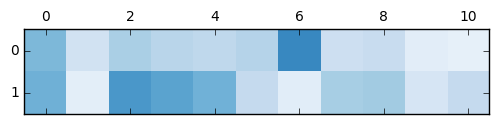

In [53]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = yr_data

fig, ax = plt.subplots()

min_val, max_val = 0, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.Blues, vmin =0, vmax = 1)

for i in xrange(15):
    for j in xrange(15):
        c = intersection_matrix[i, j]
        ax.text(i, j, str(c), va='center', ha='center')

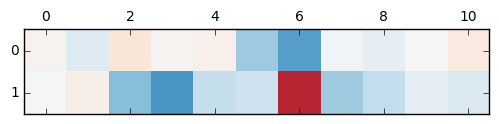

In [54]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = yr_data_diff

fig, ax = plt.subplots()

min_val, max_val = -1, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.RdBu, vmin =-.4, vmax = .4)

#for i in xrange(15):
#    for j in xrange(15):
#        c = intersection_matrix[i, j]
#        ax.text(i, j, str(c), va='center', ha='center')

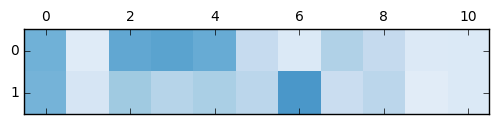

In [55]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = yl_data

fig, ax = plt.subplots()

min_val, max_val = 0, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.Blues, vmin =0, vmax = 1)

#for i in xrange(15):
#    for j in xrange(15):
#        c = intersection_matrix[i, j]
#        ax.text(i, j, str(c), va='center', ha='center')

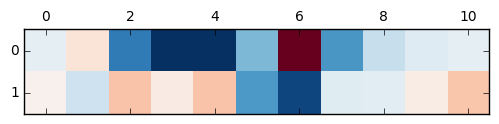

In [56]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = yl_data_diff

fig, ax = plt.subplots()

min_val, max_val = -1, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.RdBu, vmin =-.2, vmax = .2)

#for i in xrange(15):
#    for j in xrange(15):
#        c = intersection_matrix[i, j]
#        ax.text(i, j, str(c), va='center', ha='center')

TypeError: tuple indices must be integers, not tuple

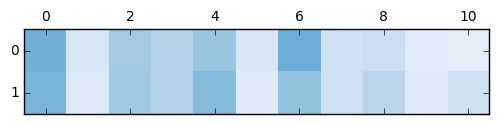

In [57]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = pu_data

fig, ax = plt.subplots()

min_val, max_val = 0, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = (data) #, size=(min_val, max_val))

ax.matshow(intersection_matrix, cmap=plt.cm.Blues, vmin =0, vmax = 1)

for i in xrange(15):
    for j in xrange(15):
        c = intersection_matrix[i, j]
        ax.text(i, j, str(c), va='center', ha='center')

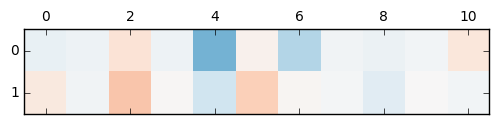

In [58]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = pu_data_diff

fig, ax = plt.subplots()

min_val, max_val = -1, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.RdBu, vmin =-.2, vmax = .2)

#for i in xrange(15):
#    for j in xrange(15):
#        c = intersection_matrix[i, j]
#        ax.text(i, j, str(c), va='center', ha='center')

TypeError: tuple indices must be integers, not tuple

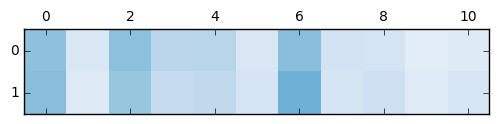

In [59]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = pd_data

fig, ax = plt.subplots()

min_val, max_val = 0, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.Blues,vmin =0, vmax = 1)

for i in xrange(15):
    for j in xrange(15):
        c = intersection_matrix[i, j]
        ax.text(i, j, str(c), va='center', ha='center')

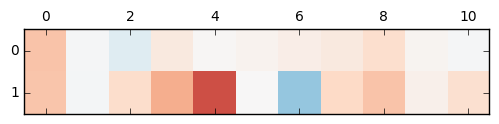

In [60]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = pd_data_diff

fig, ax = plt.subplots()

min_val, max_val = -1, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.RdBu, vmin =-.2, vmax = .2)

#for i in xrange(15):
#    for j in xrange(15):
#        c = intersection_matrix[i, j]
#        ax.text(i, j, str(c), va='center', ha='center')

TypeError: tuple indices must be integers, not tuple

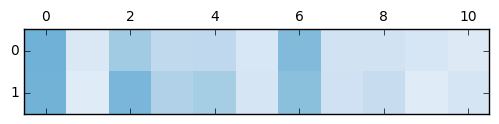

In [61]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = rc_data

fig, ax = plt.subplots()

min_val, max_val = 0, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.Blues, vmin =0, vmax = 1)

for i in xrange(15):
    for j in xrange(15):
        c = intersection_matrix[i, j]
        ax.text(i, j, str(c), va='center', ha='center')

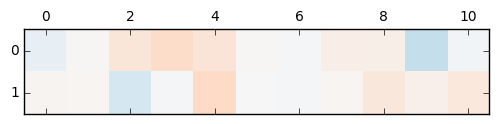

In [62]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = rc_data_diff

fig, ax = plt.subplots()

min_val, max_val = -1, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.RdBu, vmin =-.2, vmax = .2)

#for i in xrange(15):
#    for j in xrange(15):
#        c = intersection_matrix[i, j]
#        ax.text(i, j, str(c), va='center', ha='center')

TypeError: tuple indices must be integers, not tuple

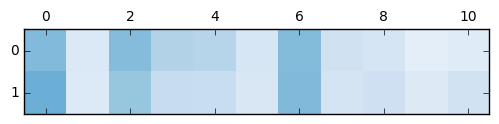

In [63]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = rcc_data

fig, ax = plt.subplots()

min_val, max_val = 0, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.Blues, vmin =0, vmax = 1)

for i in xrange(15):
    for j in xrange(15):
        c = intersection_matrix[i, j]
        ax.text(i, j, str(c), va='center', ha='center')

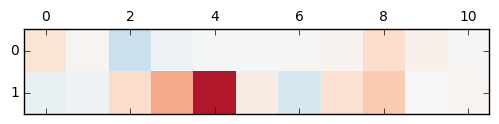

In [64]:
##### Sample color grid

import matplotlib.pyplot as plt
from matplotlib import colors
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cbook as cbook

data = rcc_data_diff

fig, ax = plt.subplots()

min_val, max_val = -1, 1

#intersection_matrix = np.random.randint(0, 10, size=(max_val, max_val))
intersection_matrix = data

ax.matshow(intersection_matrix, cmap=plt.cm.RdBu, vmin =-.2, vmax = .2)

#for i in xrange(15):
#    for j in xrange(15):
#        c = intersection_matrix[i, j]
#        ax.text(i, j, str(c), va='center', ha='center')

In [53]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_10.svg',make_mplfigures = True)


times = np.arange(500)*0.02
colors = times[150:350]

layout.axes['averaged_activity_reg'].matshow(grand_mean_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r'].matshow(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_yaw_l'].matshow(yl_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_up'].matshow(pu_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_down'].matshow(pd_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_cw'].matshow(rc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_ccw'].matshow(rcc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r_dif'].matshow(yr_data_diff, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_yaw_l_dif'].matshow(yl_data_diff, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
layout.axes['averaged_activity_pitch_up_dif'].matshow(pu_data_diff, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
layout.axes['averaged_activity_pitch_down_dif'].matshow(pd_data_diff, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
layout.axes['averaged_activity_roll_cw_dif'].matshow(rc_data_diff, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
layout.axes['averaged_activity_roll_ccw_dif'].matshow(rcc_data_diff, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)



layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean']),clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lw'].set_ybound(-2,14)
layout.axes['yaw_r_lmr_lw'].set_yticks([0, 14])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['yaw_r_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(0.0,0.3)
layout.axes['yaw_l_lmr_lb2'].set_yticks([0.0,0.3])
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean']),clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lw'].set_ybound(-14,2)
layout.axes['yaw_l_lmr_lw'].set_yticks([-14, 0])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['yaw_l_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(0.0,0.3)
layout.axes['yaw_l_lmr_lb2'].set_yticks([0.0,0.3])
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean']),clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_up_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].set_ybound(0.0,0.3)
layout.axes['pitch_up_lmr_lb2'].set_yticks([0.0,0.3])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].set_ybound(0.0,0.3)
layout.axes['pitch_down_lmr_lb2'].set_yticks([0.0,0.3])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'],clip_on = False,color = 'r')


layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean']),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean']),clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lw'].set_ybound(-2,5)
layout.axes['roll_cw_lmr_lw'].set_yticks([-2, 5])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'],clip_on = False,color = 'r')



layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean']),clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lw'].set_ybound(-5,2)
layout.axes['roll_ccw_lmr_lw'].set_yticks([-5, 2])


#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'],clip_on = False,color = 'b')

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'],clip_on = False,color = 'r')



fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v14_timing_adj_v8.svg')
plt.close('all')
display(SVG('figure_07_v14_timing_adj_v8.svg'))

In [84]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd
from scipy import ndimage


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_10.svg',make_mplfigures = True)


times = np.arange(500)*0.02
colors = times[150:350]

layout.axes['averaged_activity_reg'].matshow(all_grand_mean_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r'].matshow(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_yaw_l'].matshow(yl_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_up'].matshow(pu_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_down'].matshow(pd_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_cw'].matshow(rc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_ccw'].matshow(rcc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r_dif'].matshow(yr_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_yaw_l_dif'].matshow(yl_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_up_dif'].matshow(pu_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_down_dif'].matshow(pd_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_cw_dif'].matshow(rc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_ccw_dif'].matshow(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)

'''
#layout.axes['activity_scale_bar'].plot.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['diff_scale_bar'].plot.colorbar(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
img = plt.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
img = img[:,::-1]
img[:,0] = np.array([0,0,0,0])
#rimg = ndimage.rotate(img, 90)

layout.axes['diff_scale_bar'].imshow(img,
              interpolation = 'nearest',
              #aspect = 'auto',
              extent= (0,1,0.1,1.0))
              
              
'''


layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean']),clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lw'].set_ybound(-2,14)
layout.axes['yaw_r_lmr_lw'].set_yticks([0, 14])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['yaw_r_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb2'].set_ybound(0.0,0.7)
layout.axes['yaw_r_lmr_lb2'].set_yticks([0.0,0.7])
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb3'].set_ybound(0.2,0.65)
layout.axes['yaw_r_lmr_lb3'].set_yticks([0.2,0.65])
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].set_ybound(0.1,0.65)
layout.axes['yaw_r_lmr_li1'].set_yticks([0.1,0.65])
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].set_ybound(0.15,0.55)
layout.axes['yaw_r_lmr_li2'].set_yticks([0.15,0.55])
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].set_ybound(0.1,0.35)
layout.axes['yaw_r_lmr_liii1'].set_yticks([0.1,0.35])
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].set_ybound(0.0,0.75)
layout.axes['yaw_r_lmr_liii3'].set_yticks([0.0,0.75])
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].set_ybound(0.15,0.35)
layout.axes['yaw_r_lmr_lhg1'].set_yticks([0.15,0.35])
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].set_ybound(0.1,0.4)
layout.axes['yaw_r_lmr_lhg2'].set_yticks([0.1,0.4])
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].set_ybound(0.1,0.22)
layout.axes['yaw_r_lmr_lhg3'].set_yticks([0.1,0.2])
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].set_ybound(0.05,0.25)
layout.axes['yaw_r_lmr_lhg4'].set_yticks([0.05,0.25])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean']),clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lw'].set_ybound(-14,2)
layout.axes['yaw_l_lmr_lw'].set_yticks([-14, 0])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['yaw_l_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(0.0,0.7)
layout.axes['yaw_l_lmr_lb2'].set_yticks([0.0,0.7])
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb3'].set_ybound(0.2,0.65)
layout.axes['yaw_l_lmr_lb3'].set_yticks([0.2,0.65])
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].set_ybound(0.1,0.65)
layout.axes['yaw_l_lmr_li1'].set_yticks([0.1,0.65])
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].set_ybound(0.15,0.55)
layout.axes['yaw_l_lmr_li2'].set_yticks([0.15,0.55])
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].set_ybound(0.1,0.35)
layout.axes['yaw_l_lmr_liii1'].set_yticks([0.1,0.35])
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].set_ybound(0.0,0.75)
layout.axes['yaw_l_lmr_liii3'].set_yticks([0.0,0.75])
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].set_ybound(0.15,0.35)
layout.axes['yaw_l_lmr_lhg1'].set_yticks([0.15,0.35])
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].set_ybound(0.1,0.4)
layout.axes['yaw_l_lmr_lhg2'].set_yticks([0.1,0.4])
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].set_ybound(0.1,0.22)
layout.axes['yaw_l_lmr_lhg3'].set_yticks([0.1,0.2])
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].set_ybound(0.05,0.25)
layout.axes['yaw_l_lmr_lhg4'].set_yticks([0.05,0.25])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean']),clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_up_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['pitch_up_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].set_ybound(0.0,0.7)
layout.axes['pitch_up_lmr_lb2'].set_yticks([0.0,0.7])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb3'].set_ybound(0.2,0.65)
layout.axes['pitch_up_lmr_lb3'].set_yticks([0.2,0.65])
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].set_ybound(0.1,0.65)
layout.axes['pitch_up_lmr_li1'].set_yticks([0.1,0.65])
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].set_ybound(0.15,0.55)
layout.axes['pitch_up_lmr_li2'].set_yticks([0.15,0.55])
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].set_ybound(0.1,0.35)
layout.axes['pitch_up_lmr_liii1'].set_yticks([0.1,0.35])
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].set_ybound(0.0,0.75)
layout.axes['pitch_up_lmr_liii3'].set_yticks([0.0,0.75])
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].set_ybound(0.15,0.35)
layout.axes['pitch_up_lmr_lhg1'].set_yticks([0.15,0.35])
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].set_ybound(0.1,0.4)
layout.axes['pitch_up_lmr_lhg2'].set_yticks([0.1,0.4])
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].set_ybound(0.1,0.22)
layout.axes['pitch_up_lmr_lhg3'].set_yticks([0.1,0.2])
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].set_ybound(0.05,0.25)
layout.axes['pitch_up_lmr_lhg4'].set_yticks([0.05,0.25])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'],clip_on = False,color = 'r')


layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean']),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['pitch_down_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].set_ybound(0.0,0.7)
layout.axes['pitch_down_lmr_lb2'].set_yticks([0.0,0.7])
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].set_ybound(0.2,0.65)
layout.axes['pitch_down_lmr_lb3'].set_yticks([0.2,0.65])
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].set_ybound(0.1,0.65)
layout.axes['pitch_down_lmr_li1'].set_yticks([0.1,0.65])
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].set_ybound(0.15,0.55)
layout.axes['pitch_down_lmr_li2'].set_yticks([0.15,0.55])
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].set_ybound(0.1,0.35)
layout.axes['pitch_down_lmr_liii1'].set_yticks([0.1,0.35])
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].set_ybound(0.0,0.75)
layout.axes['pitch_down_lmr_liii3'].set_yticks([0.0,0.75])
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].set_ybound(0.15,0.35)
layout.axes['pitch_down_lmr_lhg1'].set_yticks([0.15,0.35])
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].set_ybound(0.1,0.4)
layout.axes['pitch_down_lmr_lhg2'].set_yticks([0.1,0.4])
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].set_ybound(0.1,0.22)
layout.axes['pitch_down_lmr_lhg3'].set_yticks([0.1,0.2])
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].set_ybound(0.05,0.25)
layout.axes['pitch_down_lmr_lhg4'].set_yticks([0.05,0.25])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'],clip_on = False,color = 'r')




layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean']),clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lw'].set_ybound(-2,5)
layout.axes['roll_cw_lmr_lw'].set_yticks([-2, 5])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['roll_cw_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].set_ybound(0.0,0.7)
layout.axes['roll_cw_lmr_lb2'].set_yticks([0.0,0.7])
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].set_ybound(0.2,0.65)
layout.axes['roll_cw_lmr_lb3'].set_yticks([0.2,0.65])
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].set_ybound(0.1,0.65)
layout.axes['roll_cw_lmr_li1'].set_yticks([0.1,0.65])
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].set_ybound(0.15,0.55)
layout.axes['roll_cw_lmr_li2'].set_yticks([0.15,0.55])
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].set_ybound(0.1,0.35)
layout.axes['roll_cw_lmr_liii1'].set_yticks([0.1,0.35])
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].set_ybound(0.0,0.75)
layout.axes['roll_cw_lmr_liii3'].set_yticks([0.0,0.75])
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].set_ybound(0.15,0.35)
layout.axes['roll_cw_lmr_lhg1'].set_yticks([0.15,0.35])
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].set_ybound(0.1,0.4)
layout.axes['roll_cw_lmr_lhg2'].set_yticks([0.1,0.4])
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].set_ybound(0.1,0.22)
layout.axes['roll_cw_lmr_lhg3'].set_yticks([0.1,0.2])
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].set_ybound(0.05,0.25)
layout.axes['roll_cw_lmr_lhg4'].set_yticks([0.05,0.25])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'],clip_on = False,color = 'r')



layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean']),clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lw'].set_ybound(-5,2)
layout.axes['roll_ccw_lmr_lw'].set_yticks([-5, 2])


#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].set_ybound(0.3,0.7)
layout.axes['roll_ccw_lmr_lb1'].set_yticks([0.3,0.7])
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].set_ybound(0.0,0.7)
layout.axes['roll_ccw_lmr_lb2'].set_yticks([0.0,0.7])
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].set_ybound(0.2,0.65)
layout.axes['roll_ccw_lmr_lb3'].set_yticks([0.2,0.65])
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].set_ybound(0.1,0.65)
layout.axes['roll_ccw_lmr_li1'].set_yticks([0.1,0.65])
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].set_ybound(0.15,0.55)
layout.axes['roll_ccw_lmr_li2'].set_yticks([0.15,0.55])
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].set_ybound(0.1,0.35)
layout.axes['roll_ccw_lmr_liii1'].set_yticks([0.1,0.35])
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].set_ybound(0.0,0.75)
layout.axes['roll_ccw_lmr_liii3'].set_yticks([0.0,0.75])
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].set_ybound(0.15,0.35)
layout.axes['roll_ccw_lmr_lhg1'].set_yticks([0.15,0.35])
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].set_ybound(0.1,0.4)
layout.axes['roll_ccw_lmr_lhg2'].set_yticks([0.1,0.4])
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].set_ybound(0.1,0.22)
layout.axes['roll_ccw_lmr_lhg3'].set_yticks([0.1,0.2])
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].set_ybound(0.05,0.25)
layout.axes['roll_ccw_lmr_lhg4'].set_yticks([0.05,0.25])

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'],clip_on = False,color = 'r')



fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v16_norm_5.svg')
plt.close('all')
display(SVG('figure_07_v16_norm_5.svg'))

In [ ]:
from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd
from scipy import ndimage


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_10.svg',make_mplfigures = True)


times = np.arange(499)*0.02
colors = times[150:350]

layout.axes['averaged_activity_reg'].matshow(all_grand_mean_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r'].matshow(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_yaw_l'].matshow(yl_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_up'].matshow(pu_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_down'].matshow(pd_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_cw'].matshow(rc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_ccw'].matshow(rcc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r_dif'].matshow(yr_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_yaw_l_dif'].matshow(yl_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_up_dif'].matshow(pu_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_down_dif'].matshow(pd_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_cw_dif'].matshow(rc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_ccw_dif'].matshow(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)

'''
#layout.axes['activity_scale_bar'].plot.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['diff_scale_bar'].plot.colorbar(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
img = plt.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
img = img[:,::-1]
img[:,0] = np.array([0,0,0,0])
#rimg = ndimage.rotate(img, 90)

layout.axes['diff_scale_bar'].imshow(img,
              interpolation = 'nearest',
              #aspect = 'auto',
              extent= (0,1,0.1,1.0))
              
              
'''

min_activity =0.0
max_activity = 1.0

layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lw'].set_ybound(-2,14)
layout.axes['yaw_r_lmr_lw'].set_yticks([0, 14])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].set_ybound(0,1.0)
layout.axes['yaw_r_lmr_lb1'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_lb2'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb3'].set_ybound(0.0,1.)
layout.axes['yaw_r_lmr_lb3'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li2'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].set_ybound(0.0,0)
layout.axes['yaw_r_lmr_liii1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'][:-1],clip_on = False,color = 'r')




layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lw'].set_ybound(-14,2)
layout.axes['yaw_l_lmr_lw'].set_yticks([-14, 0])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'][:-1],clip_on = False,color = 'r')




layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_up_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'][:-1],clip_on = False,color = 'r')


layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'][:-1],clip_on = False,color = 'r')




layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lw'].set_ybound(-2,5)
layout.axes['roll_cw_lmr_lw'].set_yticks([-2, 5])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'][:-1],clip_on = False,color = 'r')



layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lw'].set_ybound(-5,2)
layout.axes['roll_ccw_lmr_lw'].set_yticks([-5, 2])


#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'][:-1],clip_on = False,color = 'r')



fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v16_norm_1p5_v1.svg')
plt.close('all')
display(SVG('figure_07_v16_norm_1p5_v1.svg'))

/usr/lib/python2.7/dist-packages/matplotlib/axes/_base.py:3045: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=0, top=0.0
  'bottom=%s, top=%s') % (bottom, top))


In [ ]:
        muscle_choice =muscle_choice.replace(np.inf, np.nan)
        muscle_choice =muscle_choice.interpolate(method='pad', axis=0, limit=None, limit_direction = 'both')
        muscle_choice =muscle_choice.interpolate(method='nearest', axis=0, limit=None, limit_direction = 'both')
        muscle_choice =muscle_choice.interpolate(method='backfill', axis=0, limit=None, limit_direction = 'backward')

In [75]:
to_interpol = ('hg3_r', 'hg3_l', 'hg4_l', 'hg4_r')

In [76]:
for muscle in to_interpol:
    muscle_choice= yaw_right_df[muscle]
    muscle_choice =muscle_choice.replace(np.inf, np.nan)
    muscle_choice =muscle_choice.interpolate(method='pad', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='nearest', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='backfill', axis=0, limit=None, limit_direction = 'backward')
    
    yaw_right_df[muscle] = muscle_choice
    
    muscle_choice= yaw_left_df[muscle]
    muscle_choice =muscle_choice.replace(np.inf, np.nan)
    muscle_choice =muscle_choice.interpolate(method='pad', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='nearest', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='backfill', axis=0, limit=None, limit_direction = 'backward')
    
    yaw_left_df[muscle] = muscle_choice
    
    muscle_choice= pitch_up_df[muscle]
    muscle_choice =muscle_choice.replace(np.inf, np.nan)
    muscle_choice =muscle_choice.interpolate(method='pad', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='nearest', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='backfill', axis=0, limit=None, limit_direction = 'backward')
    
    pitch_up_df[muscle] = muscle_choice
    
    muscle_choice= pitch_down_df[muscle]
    muscle_choice =muscle_choice.replace(np.inf, np.nan)
    muscle_choice =muscle_choice.interpolate(method='pad', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='nearest', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='backfill', axis=0, limit=None, limit_direction = 'backward')
    
    pitch_down_df[muscle] = muscle_choice
    
    muscle_choice= roll_cw_df[muscle]
    muscle_choice =muscle_choice.replace(np.inf, np.nan)
    muscle_choice =muscle_choice.interpolate(method='pad', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='nearest', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='backfill', axis=0, limit=None, limit_direction = 'backward')
    
    roll_cw_df[muscle] = muscle_choice
    
    muscle_choice= roll_ccw_df[muscle]
    muscle_choice =muscle_choice.replace(np.inf, np.nan)
    muscle_choice =muscle_choice.interpolate(method='pad', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='nearest', axis=0, limit=None, limit_direction = 'both')
    muscle_choice =muscle_choice.interpolate(method='backfill', axis=0, limit=None, limit_direction = 'backward')
    
    roll_ccw_df[muscle] = muscle_choice

In [111]:
from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd
from scipy import ndimage


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_10.svg',make_mplfigures = True)


times = np.arange(499)*0.02
colors = times[150:350]

layout.axes['averaged_activity_reg'].matshow(all_grand_mean_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r'].matshow(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_yaw_l'].matshow(yl_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_up'].matshow(pu_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_down'].matshow(pd_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_cw'].matshow(rc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_ccw'].matshow(rcc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r_dif'].matshow(yr_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_yaw_l_dif'].matshow(yl_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_up_dif'].matshow(pu_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_down_dif'].matshow(pd_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_cw_dif'].matshow(rc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_ccw_dif'].matshow(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)


#gradient = np.linspace(0, 1, 256)
#gradient = np.linspace(0, 256, 1)
#gradient = np.vstack((gradient, gradient))
#gradient = np.hstack((gradient, gradient))

gradient1 = np.linspace(0, 10, 10000).reshape(100,100)
gradient2 = np.sqrt(gradient1.T) + 3




#layout.axes['activity_scale_bar'].plot.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['diff_scale_bar'].plot.colorbar(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
#layout.axes['activity_scale_bar'].ax.olorbar(cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['activity_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.Blues)
layout.axes['diff_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.RdBu)
#layout.axes['diff_scale_bar'].set_yticks([-1, 1])
#img = plt.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#img = img[:,::-1]
#img[:,0] = np.array([0,0,0,0])
#rimg = ndimage.rotate(img, 90)

#layout.axes['diff_scale_bar'].imshow(img,
#              interpolation = 'nearest',
#              #aspect = 'auto',
#              extent= (0,1,0.1,1.0))
              
              


min_activity =0.0
max_activity = 1.0

layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lw'].set_ybound(-2,14)
layout.axes['yaw_r_lmr_lw'].set_yticks([0, 14])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].set_ybound(0,1.0)
layout.axes['yaw_r_lmr_lb1'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_lb2'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb3'].set_ybound(0.0,1.)
layout.axes['yaw_r_lmr_lb3'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li2'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].set_ybound(0.0,0)
layout.axes['yaw_r_lmr_liii1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'][:-1],clip_on = False,color = 'r')




layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lw'].set_ybound(-14,2)
layout.axes['yaw_l_lmr_lw'].set_yticks([-14, 0])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'][:-1],clip_on = False,color = 'r')




layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_up_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'][:-1],clip_on = False,color = 'r')


layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'][:-1],clip_on = False,color = 'r')




layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lw'].set_ybound(-2,5)
layout.axes['roll_cw_lmr_lw'].set_yticks([-2, 5])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'][:-1],clip_on = False,color = 'r')



layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lw'].set_ybound(-5,2)
layout.axes['roll_ccw_lmr_lw'].set_yticks([-5, 2])


#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'][:-1],clip_on = False,color = 'r')



fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v16_norm_1p5_v2.svg')
plt.close('all')
display(SVG('figure_07_v16_norm_1p5_v2.svg'))

In [ ]:

#gradient = np.linspace(0, 1, 256)
#gradient = np.linspace(0, 256, 1)
#gradient = np.vstack((gradient, gradient))
#gradient = np.hstack((gradient, gradient))

#layout.axes['activity_scale_bar'].plot.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['diff_scale_bar'].plot.colorbar(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
#layout.axes['activity_scale_bar'].ax.olorbar(cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['activity_scale_bar'].imshow(gradient, aspect='auto', cmap=plt.cm.Blues)
#layout.axes['diff_scale_bar'].ax.colorbar(cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
#img = plt.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#img = img[:,::-1]
#img[:,0] = np.array([0,0,0,0])
#rimg = ndimage.rotate(img, 90)

#layout.axes['diff_scale_bar'].imshow(img,
#              interpolation = 'nearest',
#              #aspect = 'auto',

In [100]:
import pylab as plt
import numpy as np
my_image1 = np.linspace(0, 10, 10000).reshape(100,100)
my_image2 = np.sqrt(my_image1.T) + 3
#subplot(1, 2, 1)
#plt.imshow(my_image1, vmin=0, vmax=10, cmap='jet', aspect='auto')
#plt.subplot(1, 2, 2)
plt.imshow(my_image2, vmin=0, vmax=10, cmap='jet', aspect='auto')
plt.colorbar()
plt.

In [49]:
yaw_right_er_df=yaw_right_er_df*0.65
yaw_left_er_df=yaw_left_er_df*0.65
pitch_up_er_df=pitch_up_er_df*0.65
pitch_down_er_df=pitch_down_er_df*0.65
roll_cw_er_df=roll_cw_er_df*0.65
roll_ccw_er_df=roll_ccw_er_df*0.65

In [23]:
from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd
from scipy import ndimage


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_10.svg',make_mplfigures = True)


times = np.arange(497)*0.02
colors = times[150:350]

layout.axes['averaged_activity_reg'].matshow(all_grand_mean_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r'].matshow(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_yaw_l'].matshow(yl_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_up'].matshow(pu_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_down'].matshow(pd_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_cw'].matshow(rc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_ccw'].matshow(rcc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r_dif'].matshow(yr_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_yaw_l_dif'].matshow(yl_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_up_dif'].matshow(pu_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_down_dif'].matshow(pd_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_cw_dif'].matshow(rc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_ccw_dif'].matshow(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)

'''
#layout.axes['activity_scale_bar'].plot.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['diff_scale_bar'].plot.colorbar(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
img = plt.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
img = img[:,::-1]
img[:,0] = np.array([0,0,0,0])
#rimg = ndimage.rotate(img, 90)

layout.axes['diff_scale_bar'].imshow(img,
              interpolation = 'nearest',
              #aspect = 'auto',
              extent= (0,1,0.1,1.0))
              
              
'''

gradient1 = np.linspace(0, 10, 10000).reshape(100,100)
gradient2 = np.sqrt(gradient1.T) + 3



layout.axes['activity_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.Blues)
layout.axes['diff_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.RdBu)




min_activity =0.0
max_activity = 1.0

layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lw'].set_ybound(-2,14)
layout.axes['yaw_r_lmr_lw'].set_yticks([0, 14])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_l'][:-1]-yaw_right_er_df['b1_l'][:-1], yaw_right_df['b1_l'][:-1]+yaw_right_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb1'].set_ybound(0,1.0)
layout.axes['yaw_r_lmr_lb1'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_l'][:-1]-yaw_right_er_df['b2_l'][:-1], yaw_right_df['b2_l'][:-1]+yaw_right_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_lb2'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_l'][:-1]-yaw_right_er_df['b3_l'][:-1], yaw_right_df['b3_l'][:-1]+yaw_right_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].set_ybound(0.0,1.)
layout.axes['yaw_r_lmr_lb3'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_l'][:-1]-yaw_right_er_df['i1_l'][:-1], yaw_right_df['i1_l'][:-1]+yaw_right_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_li1'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_l'][:-1]-yaw_right_er_df['i2_l'][:-1], yaw_right_df['i2_l'][:-1]+yaw_right_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_li2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li2'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_l'][:-1]-yaw_right_er_df['iii1_l'][:-1], yaw_right_df['iii1_l'][:-1]+yaw_right_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].set_ybound(0.0,0)
layout.axes['yaw_r_lmr_liii1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_l'][:-1]-yaw_right_er_df['iii3_l'][:-1], yaw_right_df['iii3_l'][:-1]+yaw_right_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_l'][:-1]-yaw_right_er_df['hg1_l'][:-1], yaw_right_df['hg1_l'][:-1]+yaw_right_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_l'][:-1]-yaw_right_er_df['hg2_l'][:-1], yaw_right_df['hg2_l'][:-1]+yaw_right_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_l'][:-1]-yaw_right_er_df['hg3_l'][:-1], yaw_right_df['hg3_l'][:-1]+yaw_right_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_l'][:-1]-yaw_right_er_df['hg4_l'][:-1], yaw_right_df['hg4_l'][:-1]+yaw_right_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'][:-1],clip_on = False,color = 'r')


'''
layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_l'][:-1]-yaw_right_er_df['b1_l'][:-1], yaw_right_df['b1_l'][:-1]+yaw_right_er_df['b1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_l'][:-1]-yaw_right_er_df['b2_l'][:-1], yaw_right_df['b2_l'][:-1]+yaw_right_er_df['b2_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_l'][:-1]-yaw_right_er_df['b3_l'][:-1], yaw_right_df['b3_l'][:-1]+yaw_right_er_df['b3_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_l'][:-1]-yaw_right_er_df['i1_l'][:-1], yaw_right_df['i1_l'][:-1]+yaw_right_er_df['i1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_l'][:-1]-yaw_right_er_df['i2_l'][:-1], yaw_right_df['i2_l'][:-1]+yaw_right_er_df['i2_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_l'][:-1]-yaw_right_er_df['iii1_l'][:-1], yaw_right_df['iii1_l'][:-1]+yaw_right_er_df['iii1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_l'][:-1]-yaw_right_er_df['iii3_l'][:-1], yaw_right_df['iii3_l'][:-1]+yaw_right_er_df['iii3_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_l'][:-1]-yaw_right_er_df['hg1_l'][:-1], yaw_right_df['hg1_l'][:-1]+yaw_right_er_df['hg1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_l'][:-1]-yaw_right_er_df['hg2_l'][:-1], yaw_right_df['hg2_l'][:-1]+yaw_right_er_df['hg2_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_l'][:-1]-yaw_right_er_df['hg3_l'][:-1], yaw_right_df['hg3_l'][:-1]+yaw_right_er_df['hg3_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_l'][:-1]-yaw_right_er_df['hg4_l'][:-1], yaw_right_df['hg4_l'][:-1]+yaw_right_er_df['hg4_l'][:-1],clip_on = False,color = 'r', alpha =.05)
'''



layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_r'][:-1]-yaw_right_er_df['b1_r'][:-1], yaw_right_df['b1_r'][:-1]+yaw_right_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_r'][:-1]-yaw_right_er_df['b2_r'][:-1], yaw_right_df['b2_r'][:-1]+yaw_right_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_r'][:-1]-yaw_right_er_df['b3_r'][:-1], yaw_right_df['b3_r'][:-1]+yaw_right_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_r'][:-1]-yaw_right_er_df['i1_r'][:-1], yaw_right_df['i1_r'][:-1]+yaw_right_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_r'][:-1]-yaw_right_er_df['i2_r'][:-1], yaw_right_df['i2_r'][:-1]+yaw_right_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_r'][:-1]-yaw_right_er_df['iii1_r'][:-1], yaw_right_df['iii1_r'][:-1]+yaw_right_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_r'][:-1]-yaw_right_er_df['iii3_r'][:-1], yaw_right_df['iii3_r'][:-1]+yaw_right_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_r'][:-1]-yaw_right_er_df['hg1_r'][:-1], yaw_right_df['hg1_r'][:-1]+yaw_right_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_r'][:-1]-yaw_right_er_df['hg2_r'][:-1], yaw_right_df['hg2_r'][:-1]+yaw_right_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_r'][:-1]-yaw_right_er_df['hg3_r'][:-1], yaw_right_df['hg3_r'][:-1]+yaw_right_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_r'][:-1]-yaw_right_er_df['hg4_r'][:-1], yaw_right_df['hg4_r'][:-1]+yaw_right_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)





layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lw'].set_ybound(-14,2)
layout.axes['yaw_l_lmr_lw'].set_yticks([-14, 0])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg4'].set_yticks([min_activity,max_activity])


layout.axes['yaw_l_lmr_lb1'].fill_between(times,yaw_left_df['b1_l'][:-1]-yaw_left_er_df['b1_l'][:-1], yaw_left_df['b1_l'][:-1]+yaw_left_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lb2'].fill_between(times,yaw_left_df['b2_l'][:-1]-yaw_left_er_df['b2_l'][:-1], yaw_left_df['b2_l'][:-1]+yaw_left_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lb3'].fill_between(times,yaw_left_df['b3_l'][:-1]-yaw_left_er_df['b3_l'][:-1], yaw_left_df['b3_l'][:-1]+yaw_left_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_li1'].fill_between(times,yaw_left_df['i1_l'][:-1]-yaw_left_er_df['i1_l'][:-1], yaw_left_df['i1_l'][:-1]+yaw_left_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_li2'].fill_between(times,yaw_left_df['i2_l'][:-1]-yaw_left_er_df['i2_l'][:-1], yaw_left_df['i2_l'][:-1]+yaw_left_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_liii1'].fill_between(times,yaw_left_df['iii1_l'][:-1]-yaw_left_er_df['iii1_l'][:-1], yaw_left_df['iii1_l'][:-1]+yaw_left_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_liii3'].fill_between(times,yaw_left_df['iii3_l'][:-1]-yaw_left_er_df['iii3_l'][:-1], yaw_left_df['iii3_l'][:-1]+yaw_left_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg1'].fill_between(times,yaw_left_df['hg1_l'][:-1]-yaw_left_er_df['hg1_l'][:-1], yaw_left_df['hg1_l'][:-1]+yaw_left_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg2'].fill_between(times,yaw_left_df['hg2_l'][:-1]-yaw_left_er_df['hg2_l'][:-1], yaw_left_df['hg2_l'][:-1]+yaw_left_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg3'].fill_between(times,yaw_left_df['hg3_l'][:-1]-yaw_left_er_df['hg3_l'][:-1], yaw_left_df['hg3_l'][:-1]+yaw_left_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg4'].fill_between(times,yaw_left_df['hg4_l'][:-1]-yaw_left_er_df['hg4_l'][:-1], yaw_left_df['hg4_l'][:-1]+yaw_left_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)





#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'][:-1],clip_on = False,color = 'r')



layout.axes['yaw_l_lmr_lb1'].fill_between(times,yaw_left_df['b1_r'][:-1]-yaw_left_er_df['b1_r'][:-1], yaw_left_df['b1_r'][:-1]+yaw_left_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lb2'].fill_between(times,yaw_left_df['b2_r'][:-1]-yaw_left_er_df['b2_r'][:-1], yaw_left_df['b2_r'][:-1]+yaw_left_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lb3'].fill_between(times,yaw_left_df['b3_r'][:-1]-yaw_left_er_df['b3_r'][:-1], yaw_left_df['b3_r'][:-1]+yaw_left_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_li1'].fill_between(times,yaw_left_df['i1_r'][:-1]-yaw_left_er_df['i1_r'][:-1], yaw_left_df['i1_r'][:-1]+yaw_left_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_li2'].fill_between(times,yaw_left_df['i2_r'][:-1]-yaw_left_er_df['i2_r'][:-1], yaw_left_df['i2_r'][:-1]+yaw_left_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_liii1'].fill_between(times,yaw_left_df['iii1_r'][:-1]-yaw_left_er_df['iii1_r'][:-1], yaw_left_df['iii1_r'][:-1]+yaw_left_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_liii3'].fill_between(times,yaw_left_df['iii3_r'][:-1]-yaw_left_er_df['iii3_r'][:-1], yaw_left_df['iii3_r'][:-1]+yaw_left_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg1'].fill_between(times,yaw_left_df['hg1_r'][:-1]-yaw_left_er_df['hg1_r'][:-1], yaw_left_df['hg1_r'][:-1]+yaw_left_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg2'].fill_between(times,yaw_left_df['hg2_r'][:-1]-yaw_left_er_df['hg2_r'][:-1], yaw_left_df['hg2_r'][:-1]+yaw_left_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg3'].fill_between(times,yaw_left_df['hg3_r'][:-1]-yaw_left_er_df['hg3_r'][:-1], yaw_left_df['hg3_r'][:-1]+yaw_left_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg4'].fill_between(times,yaw_left_df['hg4_r'][:-1]-yaw_left_er_df['hg4_r'][:-1], yaw_left_df['hg4_r'][:-1]+yaw_left_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)



layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_up_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'][:-1],clip_on = False,color = 'r')


layout.axes['pitch_up_lmr_lb1'].fill_between(times,pitch_up_df['b1_r'][:-1]-pitch_up_er_df['b1_r'][:-1], pitch_up_df['b1_r'][:-1]+pitch_up_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lb2'].fill_between(times,pitch_up_df['b2_r'][:-1]-pitch_up_er_df['b2_r'][:-1], pitch_up_df['b2_r'][:-1]+pitch_up_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lb3'].fill_between(times,pitch_up_df['b3_r'][:-1]-pitch_up_er_df['b3_r'][:-1], pitch_up_df['b3_r'][:-1]+pitch_up_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_li1'].fill_between(times,pitch_up_df['i1_r'][:-1]-pitch_up_er_df['i1_r'][:-1], pitch_up_df['i1_r'][:-1]+pitch_up_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_li2'].fill_between(times,pitch_up_df['i2_r'][:-1]-pitch_up_er_df['i2_r'][:-1], pitch_up_df['i2_r'][:-1]+pitch_up_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_liii1'].fill_between(times,pitch_up_df['iii1_r'][:-1]-pitch_up_er_df['iii1_r'][:-1], pitch_up_df['iii1_r'][:-1]+pitch_up_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_liii3'].fill_between(times,pitch_up_df['iii3_r'][:-1]-pitch_up_er_df['iii3_r'][:-1], pitch_up_df['iii3_r'][:-1]+pitch_up_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg1'].fill_between(times,pitch_up_df['hg1_r'][:-1]-pitch_up_er_df['hg1_r'][:-1], pitch_up_df['hg1_r'][:-1]+pitch_up_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg2'].fill_between(times,pitch_up_df['hg2_r'][:-1]-pitch_up_er_df['hg2_r'][:-1], pitch_up_df['hg2_r'][:-1]+pitch_up_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg3'].fill_between(times,pitch_up_df['hg3_r'][:-1]-pitch_up_er_df['hg3_r'][:-1], pitch_up_df['hg3_r'][:-1]+pitch_up_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg4'].fill_between(times,pitch_up_df['hg4_r'][:-1]-pitch_up_er_df['hg4_r'][:-1], pitch_up_df['hg4_r'][:-1]+pitch_up_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['pitch_up_lmr_lb1'].fill_between(times,pitch_up_df['b1_l'][:-1]-pitch_up_er_df['b1_l'][:-1], pitch_up_df['b1_l'][:-1]+pitch_up_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lb2'].fill_between(times,pitch_up_df['b2_l'][:-1]-pitch_up_er_df['b2_l'][:-1], pitch_up_df['b2_l'][:-1]+pitch_up_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lb3'].fill_between(times,pitch_up_df['b3_l'][:-1]-pitch_up_er_df['b3_l'][:-1], pitch_up_df['b3_l'][:-1]+pitch_up_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_li1'].fill_between(times,pitch_up_df['i1_l'][:-1]-pitch_up_er_df['i1_l'][:-1], pitch_up_df['i1_l'][:-1]+pitch_up_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_li2'].fill_between(times,pitch_up_df['i2_l'][:-1]-pitch_up_er_df['i2_l'][:-1], pitch_up_df['i2_l'][:-1]+pitch_up_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_liii1'].fill_between(times,pitch_up_df['iii1_l'][:-1]-pitch_up_er_df['iii1_l'][:-1], pitch_up_df['iii1_l'][:-1]+pitch_up_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_liii3'].fill_between(times,pitch_up_df['iii3_l'][:-1]-pitch_up_er_df['iii3_l'][:-1], pitch_up_df['iii3_l'][:-1]+pitch_up_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg1'].fill_between(times,pitch_up_df['hg1_l'][:-1]-pitch_up_er_df['hg1_l'][:-1], pitch_up_df['hg1_l'][:-1]+pitch_up_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg2'].fill_between(times,pitch_up_df['hg2_l'][:-1]-pitch_up_er_df['hg2_l'][:-1], pitch_up_df['hg2_l'][:-1]+pitch_up_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg3'].fill_between(times,pitch_up_df['hg3_l'][:-1]-pitch_up_er_df['hg3_l'][:-1], pitch_up_df['hg3_l'][:-1]+pitch_up_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg4'].fill_between(times,pitch_up_df['hg4_l'][:-1]-pitch_up_er_df['hg4_l'][:-1], pitch_up_df['hg4_l'][:-1]+pitch_up_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)




layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'][:-1],clip_on = False,color = 'r')

layout.axes['pitch_down_lmr_lb1'].fill_between(times,pitch_down_df['b1_r'][:-1]-pitch_down_er_df['b1_r'][:-1], pitch_down_df['b1_r'][:-1]+pitch_down_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lb2'].fill_between(times,pitch_down_df['b2_r'][:-1]-pitch_down_er_df['b2_r'][:-1], pitch_down_df['b2_r'][:-1]+pitch_down_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lb3'].fill_between(times,pitch_down_df['b3_r'][:-1]-pitch_down_er_df['b3_r'][:-1], pitch_down_df['b3_r'][:-1]+pitch_down_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_li1'].fill_between(times,pitch_down_df['i1_r'][:-1]-pitch_down_er_df['i1_r'][:-1], pitch_down_df['i1_r'][:-1]+pitch_down_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_li2'].fill_between(times,pitch_down_df['i2_r'][:-1]-pitch_down_er_df['i2_r'][:-1], pitch_down_df['i2_r'][:-1]+pitch_down_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_liii1'].fill_between(times,pitch_down_df['iii1_r'][:-1]-pitch_down_er_df['iii1_r'][:-1], pitch_down_df['iii1_r'][:-1]+pitch_down_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_liii3'].fill_between(times,pitch_down_df['iii3_r'][:-1]-pitch_down_er_df['iii3_r'][:-1], pitch_down_df['iii3_r'][:-1]+pitch_down_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg1'].fill_between(times,pitch_down_df['hg1_r'][:-1]-pitch_down_er_df['hg1_r'][:-1], pitch_down_df['hg1_r'][:-1]+pitch_down_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg2'].fill_between(times,pitch_down_df['hg2_r'][:-1]-pitch_down_er_df['hg2_r'][:-1], pitch_down_df['hg2_r'][:-1]+pitch_down_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg3'].fill_between(times,pitch_down_df['hg3_r'][:-1]-pitch_down_er_df['hg3_r'][:-1], pitch_down_df['hg3_r'][:-1]+pitch_down_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg4'].fill_between(times,pitch_down_df['hg4_r'][:-1]-pitch_down_er_df['hg4_r'][:-1], pitch_down_df['hg4_r'][:-1]+pitch_down_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['pitch_down_lmr_lb1'].fill_between(times,pitch_down_df['b1_l'][:-1]-pitch_down_er_df['b1_l'][:-1], pitch_down_df['b1_l'][:-1]+pitch_down_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lb2'].fill_between(times,pitch_down_df['b2_l'][:-1]-pitch_down_er_df['b2_l'][:-1], pitch_down_df['b2_l'][:-1]+pitch_down_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lb3'].fill_between(times,pitch_down_df['b3_l'][:-1]-pitch_down_er_df['b3_l'][:-1], pitch_down_df['b3_l'][:-1]+pitch_down_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_li1'].fill_between(times,pitch_down_df['i1_l'][:-1]-pitch_down_er_df['i1_l'][:-1], pitch_down_df['i1_l'][:-1]+pitch_down_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_li2'].fill_between(times,pitch_down_df['i2_l'][:-1]-pitch_down_er_df['i2_l'][:-1], pitch_down_df['i2_l'][:-1]+pitch_down_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_liii1'].fill_between(times,pitch_down_df['iii1_l'][:-1]-pitch_down_er_df['iii1_l'][:-1], pitch_down_df['iii1_l'][:-1]+pitch_down_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_liii3'].fill_between(times,pitch_down_df['iii3_l'][:-1]-pitch_down_er_df['iii3_l'][:-1], pitch_down_df['iii3_l'][:-1]+pitch_down_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg1'].fill_between(times,pitch_down_df['hg1_l'][:-1]-pitch_down_er_df['hg1_l'][:-1], pitch_down_df['hg1_l'][:-1]+pitch_down_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg2'].fill_between(times,pitch_down_df['hg2_l'][:-1]-pitch_down_er_df['hg2_l'][:-1], pitch_down_df['hg2_l'][:-1]+pitch_down_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg3'].fill_between(times,pitch_down_df['hg3_l'][:-1]-pitch_down_er_df['hg3_l'][:-1], pitch_down_df['hg3_l'][:-1]+pitch_down_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg4'].fill_between(times,pitch_down_df['hg4_l'][:-1]-pitch_down_er_df['hg4_l'][:-1], pitch_down_df['hg4_l'][:-1]+pitch_down_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)



layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lw'].set_ybound(-2,5)
layout.axes['roll_cw_lmr_lw'].set_yticks([-2, 5])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'][:-1],clip_on = False,color = 'r')


layout.axes['roll_cw_lmr_lb1'].fill_between(times,roll_cw_df['b1_r'][:-1]-roll_cw_er_df['b1_r'][:-1], roll_cw_df['b1_r'][:-1]+roll_cw_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lb2'].fill_between(times,roll_cw_df['b2_r'][:-1]-roll_cw_er_df['b2_r'][:-1], roll_cw_df['b2_r'][:-1]+roll_cw_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lb3'].fill_between(times,roll_cw_df['b3_r'][:-1]-roll_cw_er_df['b3_r'][:-1], roll_cw_df['b3_r'][:-1]+roll_cw_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_li1'].fill_between(times,roll_cw_df['i1_r'][:-1]-roll_cw_er_df['i1_r'][:-1], roll_cw_df['i1_r'][:-1]+roll_cw_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_li2'].fill_between(times,roll_cw_df['i2_r'][:-1]-roll_cw_er_df['i2_r'][:-1], roll_cw_df['i2_r'][:-1]+roll_cw_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_liii1'].fill_between(times,roll_cw_df['iii1_r'][:-1]-roll_cw_er_df['iii1_r'][:-1], roll_cw_df['iii1_r'][:-1]+roll_cw_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_liii3'].fill_between(times,roll_cw_df['iii3_r'][:-1]-roll_cw_er_df['iii3_r'][:-1], roll_cw_df['iii3_r'][:-1]+roll_cw_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg1'].fill_between(times,roll_cw_df['hg1_r'][:-1]-roll_cw_er_df['hg1_r'][:-1], roll_cw_df['hg1_r'][:-1]+roll_cw_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg2'].fill_between(times,roll_cw_df['hg2_r'][:-1]-roll_cw_er_df['hg2_r'][:-1], roll_cw_df['hg2_r'][:-1]+roll_cw_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg3'].fill_between(times,roll_cw_df['hg3_r'][:-1]-roll_cw_er_df['hg3_r'][:-1], roll_cw_df['hg3_r'][:-1]+roll_cw_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg4'].fill_between(times,roll_cw_df['hg4_r'][:-1]-roll_cw_er_df['hg4_r'][:-1], roll_cw_df['hg4_r'][:-1]+roll_cw_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['roll_cw_lmr_lb1'].fill_between(times,roll_cw_df['b1_l'][:-1]-roll_cw_er_df['b1_l'][:-1], roll_cw_df['b1_l'][:-1]+roll_cw_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lb2'].fill_between(times,roll_cw_df['b2_l'][:-1]-roll_cw_er_df['b2_l'][:-1], roll_cw_df['b2_l'][:-1]+roll_cw_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lb3'].fill_between(times,roll_cw_df['b3_l'][:-1]-roll_cw_er_df['b3_l'][:-1], roll_cw_df['b3_l'][:-1]+roll_cw_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_li1'].fill_between(times,roll_cw_df['i1_l'][:-1]-roll_cw_er_df['i1_l'][:-1], roll_cw_df['i1_l'][:-1]+roll_cw_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_li2'].fill_between(times,roll_cw_df['i2_l'][:-1]-roll_cw_er_df['i2_l'][:-1], roll_cw_df['i2_l'][:-1]+roll_cw_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_liii1'].fill_between(times,roll_cw_df['iii1_l'][:-1]-roll_cw_er_df['iii1_l'][:-1], roll_cw_df['iii1_l'][:-1]+roll_cw_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_liii3'].fill_between(times,roll_cw_df['iii3_l'][:-1]-roll_cw_er_df['iii3_l'][:-1], roll_cw_df['iii3_l'][:-1]+roll_cw_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg1'].fill_between(times,roll_cw_df['hg1_l'][:-1]-roll_cw_er_df['hg1_l'][:-1], roll_cw_df['hg1_l'][:-1]+roll_cw_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg2'].fill_between(times,roll_cw_df['hg2_l'][:-1]-roll_cw_er_df['hg2_l'][:-1], roll_cw_df['hg2_l'][:-1]+roll_cw_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg3'].fill_between(times,roll_cw_df['hg3_l'][:-1]-roll_cw_er_df['hg3_l'][:-1], roll_cw_df['hg3_l'][:-1]+roll_cw_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg4'].fill_between(times,roll_cw_df['hg4_l'][:-1]-roll_cw_er_df['hg4_l'][:-1], roll_cw_df['hg4_l'][:-1]+roll_cw_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)





layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lw'].set_ybound(-5,2)
layout.axes['roll_ccw_lmr_lw'].set_yticks([-5, 2])


#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'][:-1],clip_on = False,color = 'r')

layout.axes['roll_ccw_lmr_lb1'].fill_between(times,roll_ccw_df['b1_r'][:-1]-roll_ccw_er_df['b1_r'][:-1], roll_ccw_df['b1_r'][:-1]+roll_ccw_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lb2'].fill_between(times,roll_ccw_df['b2_r'][:-1]-roll_ccw_er_df['b2_r'][:-1], roll_ccw_df['b2_r'][:-1]+roll_ccw_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lb3'].fill_between(times,roll_ccw_df['b3_r'][:-1]-roll_ccw_er_df['b3_r'][:-1], roll_ccw_df['b3_r'][:-1]+roll_ccw_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_li1'].fill_between(times,roll_ccw_df['i1_r'][:-1]-roll_ccw_er_df['i1_r'][:-1], roll_ccw_df['i1_r'][:-1]+roll_ccw_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_li2'].fill_between(times,roll_ccw_df['i2_r'][:-1]-roll_ccw_er_df['i2_r'][:-1], roll_ccw_df['i2_r'][:-1]+roll_ccw_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_liii1'].fill_between(times,roll_ccw_df['iii1_r'][:-1]-roll_ccw_er_df['iii1_r'][:-1], roll_ccw_df['iii1_r'][:-1]+roll_ccw_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_liii3'].fill_between(times,roll_ccw_df['iii3_r'][:-1]-roll_ccw_er_df['iii3_r'][:-1], roll_ccw_df['iii3_r'][:-1]+roll_ccw_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg1'].fill_between(times,roll_ccw_df['hg1_r'][:-1]-roll_ccw_er_df['hg1_r'][:-1], roll_ccw_df['hg1_r'][:-1]+roll_ccw_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg2'].fill_between(times,roll_ccw_df['hg2_r'][:-1]-roll_ccw_er_df['hg2_r'][:-1], roll_ccw_df['hg2_r'][:-1]+roll_ccw_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg3'].fill_between(times,roll_ccw_df['hg3_r'][:-1]-roll_ccw_er_df['hg3_r'][:-1], roll_ccw_df['hg3_r'][:-1]+roll_ccw_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg4'].fill_between(times,roll_ccw_df['hg4_r'][:-1]-roll_ccw_er_df['hg4_r'][:-1], roll_ccw_df['hg4_r'][:-1]+roll_ccw_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['roll_ccw_lmr_lb1'].fill_between(times,roll_ccw_df['b1_l'][:-1]-roll_ccw_er_df['b1_l'][:-1], roll_ccw_df['b1_l'][:-1]+roll_ccw_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lb2'].fill_between(times,roll_ccw_df['b2_l'][:-1]-roll_ccw_er_df['b2_l'][:-1], roll_ccw_df['b2_l'][:-1]+roll_ccw_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lb3'].fill_between(times,roll_ccw_df['b3_l'][:-1]-roll_ccw_er_df['b3_l'][:-1], roll_ccw_df['b3_l'][:-1]+roll_ccw_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_li1'].fill_between(times,roll_ccw_df['i1_l'][:-1]-roll_ccw_er_df['i1_l'][:-1], roll_ccw_df['i1_l'][:-1]+roll_ccw_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_li2'].fill_between(times,roll_ccw_df['i2_l'][:-1]-roll_ccw_er_df['i2_l'][:-1], roll_ccw_df['i2_l'][:-1]+roll_ccw_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_liii1'].fill_between(times,roll_ccw_df['iii1_l'][:-1]-roll_ccw_er_df['iii1_l'][:-1], roll_ccw_df['iii1_l'][:-1]+roll_ccw_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_liii3'].fill_between(times,roll_ccw_df['iii3_l'][:-1]-roll_ccw_er_df['iii3_l'][:-1], roll_ccw_df['iii3_l'][:-1]+roll_ccw_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg1'].fill_between(times,roll_ccw_df['hg1_l'][:-1]-roll_ccw_er_df['hg1_l'][:-1], roll_ccw_df['hg1_l'][:-1]+roll_ccw_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg2'].fill_between(times,roll_ccw_df['hg2_l'][:-1]-roll_ccw_er_df['hg2_l'][:-1], roll_ccw_df['hg2_l'][:-1]+roll_ccw_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg3'].fill_between(times,roll_ccw_df['hg3_l'][:-1]-roll_ccw_er_df['hg3_l'][:-1], roll_ccw_df['hg3_l'][:-1]+roll_ccw_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg4'].fill_between(times,roll_ccw_df['hg4_l'][:-1]-roll_ccw_er_df['hg4_l'][:-1], roll_ccw_df['hg4_l'][:-1]+roll_ccw_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)



fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v16_norm_1p5_v5.svg')
plt.close('all')
display(SVG('figure_07_v16_norm_1p5_v5.svg'))

ValueError: x and y must have same first dimension

In [ ]:
from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd
from scipy import ndimage


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_10.svg',make_mplfigures = True)


times = np.arange(497)*0.02
colors = times[150:350]

layout.axes['averaged_activity_reg'].matshow(all_grand_mean_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r'].matshow(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_yaw_l'].matshow(yl_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_up'].matshow(pu_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_down'].matshow(pd_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_cw'].matshow(rc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_ccw'].matshow(rcc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r_dif'].matshow(yr_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_yaw_l_dif'].matshow(yl_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_up_dif'].matshow(pu_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_down_dif'].matshow(pd_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_cw_dif'].matshow(rc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_ccw_dif'].matshow(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)

'''
#layout.axes['activity_scale_bar'].plot.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['diff_scale_bar'].plot.colorbar(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
img = plt.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
img = img[:,::-1]
img[:,0] = np.array([0,0,0,0])
#rimg = ndimage.rotate(img, 90)

layout.axes['diff_scale_bar'].imshow(img,
              interpolation = 'nearest',
              #aspect = 'auto',
              extent= (0,1,0.1,1.0))
              
              
'''

gradient1 = np.linspace(0, 10, 10000).reshape(100,100)
gradient2 = np.sqrt(gradient1.T) + 3



layout.axes['activity_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.Blues)
layout.axes['diff_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.RdBu)




min_activity =0.0
max_activity = 1.0

layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean'][1:498]),clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lw'].set_ybound(-2,14)
layout.axes['yaw_r_lmr_lw'].set_yticks([0, 14])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_l'][1:498]-yaw_right_er_df['b1_l'][1:498], yaw_right_df['b1_l'][1:498]+yaw_right_er_df['b1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb1'].set_ybound(0,1.0)
layout.axes['yaw_r_lmr_lb1'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_l'][1:498]-yaw_right_er_df['b2_l'][1:498], yaw_right_df['b2_l'][1:498]+yaw_right_er_df['b2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_lb2'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_l'][1:498]-yaw_right_er_df['b3_l'][1:498], yaw_right_df['b3_l'][1:498]+yaw_right_er_df['b3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].set_ybound(0.0,1.)
layout.axes['yaw_r_lmr_lb3'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_l'][1:498]-yaw_right_er_df['i1_l'][1:498], yaw_right_df['i1_l'][1:498]+yaw_right_er_df['i1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_li1'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_l'][1:498]-yaw_right_er_df['i2_l'][1:498], yaw_right_df['i2_l'][1:498]+yaw_right_er_df['i2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_li2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li2'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_l'][1:498]-yaw_right_er_df['iii1_l'][1:498], yaw_right_df['iii1_l'][1:498]+yaw_right_er_df['iii1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].set_ybound(0.0,0)
layout.axes['yaw_r_lmr_liii1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_l'][1:498]-yaw_right_er_df['iii3_l'][1:498], yaw_right_df['iii3_l'][1:498]+yaw_right_er_df['iii3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_l'][1:498]-yaw_right_er_df['hg1_l'][1:498], yaw_right_df['hg1_l'][1:498]+yaw_right_er_df['hg1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_l'][1:498]-yaw_right_er_df['hg2_l'][1:498], yaw_right_df['hg2_l'][1:498]+yaw_right_er_df['hg2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_l'][1:498]-yaw_right_er_df['hg3_l'][1:498], yaw_right_df['hg3_l'][1:498]+yaw_right_er_df['hg3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_l'][1:498]-yaw_right_er_df['hg4_l'][1:498], yaw_right_df['hg4_l'][1:498]+yaw_right_er_df['hg4_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'][1:498],clip_on = False,color = 'r')


'''
layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_l'][1:498]-yaw_right_er_df['b1_l'][1:498], yaw_right_df['b1_l'][1:498]+yaw_right_er_df['b1_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_l'][1:498]-yaw_right_er_df['b2_l'][1:498], yaw_right_df['b2_l'][1:498]+yaw_right_er_df['b2_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_l'][1:498]-yaw_right_er_df['b3_l'][1:498], yaw_right_df['b3_l'][1:498]+yaw_right_er_df['b3_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_l'][1:498]-yaw_right_er_df['i1_l'][1:498], yaw_right_df['i1_l'][1:498]+yaw_right_er_df['i1_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_l'][1:498]-yaw_right_er_df['i2_l'][1:498], yaw_right_df['i2_l'][1:498]+yaw_right_er_df['i2_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_l'][1:498]-yaw_right_er_df['iii1_l'][1:498], yaw_right_df['iii1_l'][1:498]+yaw_right_er_df['iii1_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_l'][1:498]-yaw_right_er_df['iii3_l'][1:498], yaw_right_df['iii3_l'][1:498]+yaw_right_er_df['iii3_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_l'][1:498]-yaw_right_er_df['hg1_l'][1:498], yaw_right_df['hg1_l'][1:498]+yaw_right_er_df['hg1_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_l'][1:498]-yaw_right_er_df['hg2_l'][1:498], yaw_right_df['hg2_l'][1:498]+yaw_right_er_df['hg2_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_l'][1:498]-yaw_right_er_df['hg3_l'][1:498], yaw_right_df['hg3_l'][1:498]+yaw_right_er_df['hg3_l'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_l'][1:498]-yaw_right_er_df['hg4_l'][1:498], yaw_right_df['hg4_l'][1:498]+yaw_right_er_df['hg4_l'][1:498],clip_on = False,color = 'r', alpha =.05)
'''



layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_r'][1:498]-yaw_right_er_df['b1_r'][1:498], yaw_right_df['b1_r'][1:498]+yaw_right_er_df['b1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_r'][1:498]-yaw_right_er_df['b2_r'][1:498], yaw_right_df['b2_r'][1:498]+yaw_right_er_df['b2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_r'][1:498]-yaw_right_er_df['b3_r'][1:498], yaw_right_df['b3_r'][1:498]+yaw_right_er_df['b3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_r'][1:498]-yaw_right_er_df['i1_r'][1:498], yaw_right_df['i1_r'][1:498]+yaw_right_er_df['i1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_r'][1:498]-yaw_right_er_df['i2_r'][1:498], yaw_right_df['i2_r'][1:498]+yaw_right_er_df['i2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_r'][1:498]-yaw_right_er_df['iii1_r'][1:498], yaw_right_df['iii1_r'][1:498]+yaw_right_er_df['iii1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_r'][1:498]-yaw_right_er_df['iii3_r'][1:498], yaw_right_df['iii3_r'][1:498]+yaw_right_er_df['iii3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_r'][1:498]-yaw_right_er_df['hg1_r'][1:498], yaw_right_df['hg1_r'][1:498]+yaw_right_er_df['hg1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_r'][1:498]-yaw_right_er_df['hg2_r'][1:498], yaw_right_df['hg2_r'][1:498]+yaw_right_er_df['hg2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_r'][1:498]-yaw_right_er_df['hg3_r'][1:498], yaw_right_df['hg3_r'][1:498]+yaw_right_er_df['hg3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_r'][1:498]-yaw_right_er_df['hg4_r'][1:498], yaw_right_df['hg4_r'][1:498]+yaw_right_er_df['hg4_r'][1:498],clip_on = False,color = 'r', alpha =.05)





layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean'][1:498]),clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lw'].set_ybound(-14,2)
layout.axes['yaw_l_lmr_lw'].set_yticks([-14, 0])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'][1:498],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg4'].set_yticks([min_activity,max_activity])


layout.axes['yaw_l_lmr_lb1'].fill_between(times,yaw_left_df['b1_l'][1:498]-yaw_left_er_df['b1_l'][1:498], yaw_left_df['b1_l'][1:498]+yaw_left_er_df['b1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lb2'].fill_between(times,yaw_left_df['b2_l'][1:498]-yaw_left_er_df['b2_l'][1:498], yaw_left_df['b2_l'][1:498]+yaw_left_er_df['b2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lb3'].fill_between(times,yaw_left_df['b3_l'][1:498]-yaw_left_er_df['b3_l'][1:498], yaw_left_df['b3_l'][1:498]+yaw_left_er_df['b3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_li1'].fill_between(times,yaw_left_df['i1_l'][1:498]-yaw_left_er_df['i1_l'][1:498], yaw_left_df['i1_l'][1:498]+yaw_left_er_df['i1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_li2'].fill_between(times,yaw_left_df['i2_l'][1:498]-yaw_left_er_df['i2_l'][1:498], yaw_left_df['i2_l'][1:498]+yaw_left_er_df['i2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_liii1'].fill_between(times,yaw_left_df['iii1_l'][1:498]-yaw_left_er_df['iii1_l'][1:498], yaw_left_df['iii1_l'][1:498]+yaw_left_er_df['iii1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_liii3'].fill_between(times,yaw_left_df['iii3_l'][1:498]-yaw_left_er_df['iii3_l'][1:498], yaw_left_df['iii3_l'][1:498]+yaw_left_er_df['iii3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg1'].fill_between(times,yaw_left_df['hg1_l'][1:498]-yaw_left_er_df['hg1_l'][1:498], yaw_left_df['hg1_l'][1:498]+yaw_left_er_df['hg1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg2'].fill_between(times,yaw_left_df['hg2_l'][1:498]-yaw_left_er_df['hg2_l'][1:498], yaw_left_df['hg2_l'][1:498]+yaw_left_er_df['hg2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg3'].fill_between(times,yaw_left_df['hg3_l'][1:498]-yaw_left_er_df['hg3_l'][1:498], yaw_left_df['hg3_l'][1:498]+yaw_left_er_df['hg3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg4'].fill_between(times,yaw_left_df['hg4_l'][1:498]-yaw_left_er_df['hg4_l'][1:498], yaw_left_df['hg4_l'][1:498]+yaw_left_er_df['hg4_l'][1:498],clip_on = False,color = 'b', alpha =.05)





#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'][1:498],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'][1:498],clip_on = False,color = 'r')



layout.axes['yaw_l_lmr_lb1'].fill_between(times,yaw_left_df['b1_r'][1:498]-yaw_left_er_df['b1_r'][1:498], yaw_left_df['b1_r'][1:498]+yaw_left_er_df['b1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lb2'].fill_between(times,yaw_left_df['b2_r'][1:498]-yaw_left_er_df['b2_r'][1:498], yaw_left_df['b2_r'][1:498]+yaw_left_er_df['b2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lb3'].fill_between(times,yaw_left_df['b3_r'][1:498]-yaw_left_er_df['b3_r'][1:498], yaw_left_df['b3_r'][1:498]+yaw_left_er_df['b3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_li1'].fill_between(times,yaw_left_df['i1_r'][1:498]-yaw_left_er_df['i1_r'][1:498], yaw_left_df['i1_r'][1:498]+yaw_left_er_df['i1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_li2'].fill_between(times,yaw_left_df['i2_r'][1:498]-yaw_left_er_df['i2_r'][1:498], yaw_left_df['i2_r'][1:498]+yaw_left_er_df['i2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_liii1'].fill_between(times,yaw_left_df['iii1_r'][1:498]-yaw_left_er_df['iii1_r'][1:498], yaw_left_df['iii1_r'][1:498]+yaw_left_er_df['iii1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_liii3'].fill_between(times,yaw_left_df['iii3_r'][1:498]-yaw_left_er_df['iii3_r'][1:498], yaw_left_df['iii3_r'][1:498]+yaw_left_er_df['iii3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg1'].fill_between(times,yaw_left_df['hg1_r'][1:498]-yaw_left_er_df['hg1_r'][1:498], yaw_left_df['hg1_r'][1:498]+yaw_left_er_df['hg1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg2'].fill_between(times,yaw_left_df['hg2_r'][1:498]-yaw_left_er_df['hg2_r'][1:498], yaw_left_df['hg2_r'][1:498]+yaw_left_er_df['hg2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg3'].fill_between(times,yaw_left_df['hg3_r'][1:498]-yaw_left_er_df['hg3_r'][1:498], yaw_left_df['hg3_r'][1:498]+yaw_left_er_df['hg3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg4'].fill_between(times,yaw_left_df['hg4_r'][1:498]-yaw_left_er_df['hg4_r'][1:498], yaw_left_df['hg4_r'][1:498]+yaw_left_er_df['hg4_r'][1:498],clip_on = False,color = 'r', alpha =.05)



layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean'][1:498]),clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_up_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'][1:498],clip_on = False,color = 'r')


layout.axes['pitch_up_lmr_lb1'].fill_between(times,pitch_up_df['b1_r'][1:498]-pitch_up_er_df['b1_r'][1:498], pitch_up_df['b1_r'][1:498]+pitch_up_er_df['b1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lb2'].fill_between(times,pitch_up_df['b2_r'][1:498]-pitch_up_er_df['b2_r'][1:498], pitch_up_df['b2_r'][1:498]+pitch_up_er_df['b2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lb3'].fill_between(times,pitch_up_df['b3_r'][1:498]-pitch_up_er_df['b3_r'][1:498], pitch_up_df['b3_r'][1:498]+pitch_up_er_df['b3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_li1'].fill_between(times,pitch_up_df['i1_r'][1:498]-pitch_up_er_df['i1_r'][1:498], pitch_up_df['i1_r'][1:498]+pitch_up_er_df['i1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_li2'].fill_between(times,pitch_up_df['i2_r'][1:498]-pitch_up_er_df['i2_r'][1:498], pitch_up_df['i2_r'][1:498]+pitch_up_er_df['i2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_liii1'].fill_between(times,pitch_up_df['iii1_r'][1:498]-pitch_up_er_df['iii1_r'][1:498], pitch_up_df['iii1_r'][1:498]+pitch_up_er_df['iii1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_liii3'].fill_between(times,pitch_up_df['iii3_r'][1:498]-pitch_up_er_df['iii3_r'][1:498], pitch_up_df['iii3_r'][1:498]+pitch_up_er_df['iii3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg1'].fill_between(times,pitch_up_df['hg1_r'][1:498]-pitch_up_er_df['hg1_r'][1:498], pitch_up_df['hg1_r'][1:498]+pitch_up_er_df['hg1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg2'].fill_between(times,pitch_up_df['hg2_r'][1:498]-pitch_up_er_df['hg2_r'][1:498], pitch_up_df['hg2_r'][1:498]+pitch_up_er_df['hg2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg3'].fill_between(times,pitch_up_df['hg3_r'][1:498]-pitch_up_er_df['hg3_r'][1:498], pitch_up_df['hg3_r'][1:498]+pitch_up_er_df['hg3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg4'].fill_between(times,pitch_up_df['hg4_r'][1:498]-pitch_up_er_df['hg4_r'][1:498], pitch_up_df['hg4_r'][1:498]+pitch_up_er_df['hg4_r'][1:498],clip_on = False,color = 'r', alpha =.05)

layout.axes['pitch_up_lmr_lb1'].fill_between(times,pitch_up_df['b1_l'][1:498]-pitch_up_er_df['b1_l'][1:498], pitch_up_df['b1_l'][1:498]+pitch_up_er_df['b1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lb2'].fill_between(times,pitch_up_df['b2_l'][1:498]-pitch_up_er_df['b2_l'][1:498], pitch_up_df['b2_l'][1:498]+pitch_up_er_df['b2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lb3'].fill_between(times,pitch_up_df['b3_l'][1:498]-pitch_up_er_df['b3_l'][1:498], pitch_up_df['b3_l'][1:498]+pitch_up_er_df['b3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_li1'].fill_between(times,pitch_up_df['i1_l'][1:498]-pitch_up_er_df['i1_l'][1:498], pitch_up_df['i1_l'][1:498]+pitch_up_er_df['i1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_li2'].fill_between(times,pitch_up_df['i2_l'][1:498]-pitch_up_er_df['i2_l'][1:498], pitch_up_df['i2_l'][1:498]+pitch_up_er_df['i2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_liii1'].fill_between(times,pitch_up_df['iii1_l'][1:498]-pitch_up_er_df['iii1_l'][1:498], pitch_up_df['iii1_l'][1:498]+pitch_up_er_df['iii1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_liii3'].fill_between(times,pitch_up_df['iii3_l'][1:498]-pitch_up_er_df['iii3_l'][1:498], pitch_up_df['iii3_l'][1:498]+pitch_up_er_df['iii3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg1'].fill_between(times,pitch_up_df['hg1_l'][1:498]-pitch_up_er_df['hg1_l'][1:498], pitch_up_df['hg1_l'][1:498]+pitch_up_er_df['hg1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg2'].fill_between(times,pitch_up_df['hg2_l'][1:498]-pitch_up_er_df['hg2_l'][1:498], pitch_up_df['hg2_l'][1:498]+pitch_up_er_df['hg2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg3'].fill_between(times,pitch_up_df['hg3_l'][1:498]-pitch_up_er_df['hg3_l'][1:498], pitch_up_df['hg3_l'][1:498]+pitch_up_er_df['hg3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg4'].fill_between(times,pitch_up_df['hg4_l'][1:498]-pitch_up_er_df['hg4_l'][1:498], pitch_up_df['hg4_l'][1:498]+pitch_up_er_df['hg4_l'][1:498],clip_on = False,color = 'b', alpha =.05)




layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean'][1:498]),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'][1:498],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'][1:498],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'][1:498],clip_on = False,color = 'r')

layout.axes['pitch_down_lmr_lb1'].fill_between(times,pitch_down_df['b1_r'][1:498]-pitch_down_er_df['b1_r'][1:498], pitch_down_df['b1_r'][1:498]+pitch_down_er_df['b1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lb2'].fill_between(times,pitch_down_df['b2_r'][1:498]-pitch_down_er_df['b2_r'][1:498], pitch_down_df['b2_r'][1:498]+pitch_down_er_df['b2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lb3'].fill_between(times,pitch_down_df['b3_r'][1:498]-pitch_down_er_df['b3_r'][1:498], pitch_down_df['b3_r'][1:498]+pitch_down_er_df['b3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_li1'].fill_between(times,pitch_down_df['i1_r'][1:498]-pitch_down_er_df['i1_r'][1:498], pitch_down_df['i1_r'][1:498]+pitch_down_er_df['i1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_li2'].fill_between(times,pitch_down_df['i2_r'][1:498]-pitch_down_er_df['i2_r'][1:498], pitch_down_df['i2_r'][1:498]+pitch_down_er_df['i2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_liii1'].fill_between(times,pitch_down_df['iii1_r'][1:498]-pitch_down_er_df['iii1_r'][1:498], pitch_down_df['iii1_r'][1:498]+pitch_down_er_df['iii1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_liii3'].fill_between(times,pitch_down_df['iii3_r'][1:498]-pitch_down_er_df['iii3_r'][1:498], pitch_down_df['iii3_r'][1:498]+pitch_down_er_df['iii3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg1'].fill_between(times,pitch_down_df['hg1_r'][1:498]-pitch_down_er_df['hg1_r'][1:498], pitch_down_df['hg1_r'][1:498]+pitch_down_er_df['hg1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg2'].fill_between(times,pitch_down_df['hg2_r'][1:498]-pitch_down_er_df['hg2_r'][1:498], pitch_down_df['hg2_r'][1:498]+pitch_down_er_df['hg2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg3'].fill_between(times,pitch_down_df['hg3_r'][1:498]-pitch_down_er_df['hg3_r'][1:498], pitch_down_df['hg3_r'][1:498]+pitch_down_er_df['hg3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg4'].fill_between(times,pitch_down_df['hg4_r'][1:498]-pitch_down_er_df['hg4_r'][1:498], pitch_down_df['hg4_r'][1:498]+pitch_down_er_df['hg4_r'][1:498],clip_on = False,color = 'r', alpha =.05)

layout.axes['pitch_down_lmr_lb1'].fill_between(times,pitch_down_df['b1_l'][1:498]-pitch_down_er_df['b1_l'][1:498], pitch_down_df['b1_l'][1:498]+pitch_down_er_df['b1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lb2'].fill_between(times,pitch_down_df['b2_l'][1:498]-pitch_down_er_df['b2_l'][1:498], pitch_down_df['b2_l'][1:498]+pitch_down_er_df['b2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lb3'].fill_between(times,pitch_down_df['b3_l'][1:498]-pitch_down_er_df['b3_l'][1:498], pitch_down_df['b3_l'][1:498]+pitch_down_er_df['b3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_li1'].fill_between(times,pitch_down_df['i1_l'][1:498]-pitch_down_er_df['i1_l'][1:498], pitch_down_df['i1_l'][1:498]+pitch_down_er_df['i1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_li2'].fill_between(times,pitch_down_df['i2_l'][1:498]-pitch_down_er_df['i2_l'][1:498], pitch_down_df['i2_l'][1:498]+pitch_down_er_df['i2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_liii1'].fill_between(times,pitch_down_df['iii1_l'][1:498]-pitch_down_er_df['iii1_l'][1:498], pitch_down_df['iii1_l'][1:498]+pitch_down_er_df['iii1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_liii3'].fill_between(times,pitch_down_df['iii3_l'][1:498]-pitch_down_er_df['iii3_l'][1:498], pitch_down_df['iii3_l'][1:498]+pitch_down_er_df['iii3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg1'].fill_between(times,pitch_down_df['hg1_l'][1:498]-pitch_down_er_df['hg1_l'][1:498], pitch_down_df['hg1_l'][1:498]+pitch_down_er_df['hg1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg2'].fill_between(times,pitch_down_df['hg2_l'][1:498]-pitch_down_er_df['hg2_l'][1:498], pitch_down_df['hg2_l'][1:498]+pitch_down_er_df['hg2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg3'].fill_between(times,pitch_down_df['hg3_l'][1:498]-pitch_down_er_df['hg3_l'][1:498], pitch_down_df['hg3_l'][1:498]+pitch_down_er_df['hg3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg4'].fill_between(times,pitch_down_df['hg4_l'][1:498]-pitch_down_er_df['hg4_l'][1:498], pitch_down_df['hg4_l'][1:498]+pitch_down_er_df['hg4_l'][1:498],clip_on = False,color = 'b', alpha =.05)



layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean'][1:498]),clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lw'].set_ybound(-2,5)
layout.axes['roll_cw_lmr_lw'].set_yticks([-2, 5])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'][1:498],clip_on = False,color = 'r')


layout.axes['roll_cw_lmr_lb1'].fill_between(times,roll_cw_df['b1_r'][1:498]-roll_cw_er_df['b1_r'][1:498], roll_cw_df['b1_r'][1:498]+roll_cw_er_df['b1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lb2'].fill_between(times,roll_cw_df['b2_r'][1:498]-roll_cw_er_df['b2_r'][1:498], roll_cw_df['b2_r'][1:498]+roll_cw_er_df['b2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lb3'].fill_between(times,roll_cw_df['b3_r'][1:498]-roll_cw_er_df['b3_r'][1:498], roll_cw_df['b3_r'][1:498]+roll_cw_er_df['b3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_li1'].fill_between(times,roll_cw_df['i1_r'][1:498]-roll_cw_er_df['i1_r'][1:498], roll_cw_df['i1_r'][1:498]+roll_cw_er_df['i1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_li2'].fill_between(times,roll_cw_df['i2_r'][1:498]-roll_cw_er_df['i2_r'][1:498], roll_cw_df['i2_r'][1:498]+roll_cw_er_df['i2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_liii1'].fill_between(times,roll_cw_df['iii1_r'][1:498]-roll_cw_er_df['iii1_r'][1:498], roll_cw_df['iii1_r'][1:498]+roll_cw_er_df['iii1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_liii3'].fill_between(times,roll_cw_df['iii3_r'][1:498]-roll_cw_er_df['iii3_r'][1:498], roll_cw_df['iii3_r'][1:498]+roll_cw_er_df['iii3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg1'].fill_between(times,roll_cw_df['hg1_r'][1:498]-roll_cw_er_df['hg1_r'][1:498], roll_cw_df['hg1_r'][1:498]+roll_cw_er_df['hg1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg2'].fill_between(times,roll_cw_df['hg2_r'][1:498]-roll_cw_er_df['hg2_r'][1:498], roll_cw_df['hg2_r'][1:498]+roll_cw_er_df['hg2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg3'].fill_between(times,roll_cw_df['hg3_r'][1:498]-roll_cw_er_df['hg3_r'][1:498], roll_cw_df['hg3_r'][1:498]+roll_cw_er_df['hg3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg4'].fill_between(times,roll_cw_df['hg4_r'][1:498]-roll_cw_er_df['hg4_r'][1:498], roll_cw_df['hg4_r'][1:498]+roll_cw_er_df['hg4_r'][1:498],clip_on = False,color = 'r', alpha =.05)

layout.axes['roll_cw_lmr_lb1'].fill_between(times,roll_cw_df['b1_l'][1:498]-roll_cw_er_df['b1_l'][1:498], roll_cw_df['b1_l'][1:498]+roll_cw_er_df['b1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lb2'].fill_between(times,roll_cw_df['b2_l'][1:498]-roll_cw_er_df['b2_l'][1:498], roll_cw_df['b2_l'][1:498]+roll_cw_er_df['b2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lb3'].fill_between(times,roll_cw_df['b3_l'][1:498]-roll_cw_er_df['b3_l'][1:498], roll_cw_df['b3_l'][1:498]+roll_cw_er_df['b3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_li1'].fill_between(times,roll_cw_df['i1_l'][1:498]-roll_cw_er_df['i1_l'][1:498], roll_cw_df['i1_l'][1:498]+roll_cw_er_df['i1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_li2'].fill_between(times,roll_cw_df['i2_l'][1:498]-roll_cw_er_df['i2_l'][1:498], roll_cw_df['i2_l'][1:498]+roll_cw_er_df['i2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_liii1'].fill_between(times,roll_cw_df['iii1_l'][1:498]-roll_cw_er_df['iii1_l'][1:498], roll_cw_df['iii1_l'][1:498]+roll_cw_er_df['iii1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_liii3'].fill_between(times,roll_cw_df['iii3_l'][1:498]-roll_cw_er_df['iii3_l'][1:498], roll_cw_df['iii3_l'][1:498]+roll_cw_er_df['iii3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg1'].fill_between(times,roll_cw_df['hg1_l'][1:498]-roll_cw_er_df['hg1_l'][1:498], roll_cw_df['hg1_l'][1:498]+roll_cw_er_df['hg1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg2'].fill_between(times,roll_cw_df['hg2_l'][1:498]-roll_cw_er_df['hg2_l'][1:498], roll_cw_df['hg2_l'][1:498]+roll_cw_er_df['hg2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg3'].fill_between(times,roll_cw_df['hg3_l'][1:498]-roll_cw_er_df['hg3_l'][1:498], roll_cw_df['hg3_l'][1:498]+roll_cw_er_df['hg3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg4'].fill_between(times,roll_cw_df['hg4_l'][1:498]-roll_cw_er_df['hg4_l'][1:498], roll_cw_df['hg4_l'][1:498]+roll_cw_er_df['hg4_l'][1:498],clip_on = False,color = 'b', alpha =.05)





layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean'][1:498]),clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lw'].set_ybound(-5,2)
layout.axes['roll_ccw_lmr_lw'].set_yticks([-5, 2])


#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'][1:498],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'][1:498],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'][1:498],clip_on = False,color = 'r')

layout.axes['roll_ccw_lmr_lb1'].fill_between(times,roll_ccw_df['b1_r'][1:498]-roll_ccw_er_df['b1_r'][1:498], roll_ccw_df['b1_r'][1:498]+roll_ccw_er_df['b1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lb2'].fill_between(times,roll_ccw_df['b2_r'][1:498]-roll_ccw_er_df['b2_r'][1:498], roll_ccw_df['b2_r'][1:498]+roll_ccw_er_df['b2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lb3'].fill_between(times,roll_ccw_df['b3_r'][1:498]-roll_ccw_er_df['b3_r'][1:498], roll_ccw_df['b3_r'][1:498]+roll_ccw_er_df['b3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_li1'].fill_between(times,roll_ccw_df['i1_r'][1:498]-roll_ccw_er_df['i1_r'][1:498], roll_ccw_df['i1_r'][1:498]+roll_ccw_er_df['i1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_li2'].fill_between(times,roll_ccw_df['i2_r'][1:498]-roll_ccw_er_df['i2_r'][1:498], roll_ccw_df['i2_r'][1:498]+roll_ccw_er_df['i2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_liii1'].fill_between(times,roll_ccw_df['iii1_r'][1:498]-roll_ccw_er_df['iii1_r'][1:498], roll_ccw_df['iii1_r'][1:498]+roll_ccw_er_df['iii1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_liii3'].fill_between(times,roll_ccw_df['iii3_r'][1:498]-roll_ccw_er_df['iii3_r'][1:498], roll_ccw_df['iii3_r'][1:498]+roll_ccw_er_df['iii3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg1'].fill_between(times,roll_ccw_df['hg1_r'][1:498]-roll_ccw_er_df['hg1_r'][1:498], roll_ccw_df['hg1_r'][1:498]+roll_ccw_er_df['hg1_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg2'].fill_between(times,roll_ccw_df['hg2_r'][1:498]-roll_ccw_er_df['hg2_r'][1:498], roll_ccw_df['hg2_r'][1:498]+roll_ccw_er_df['hg2_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg3'].fill_between(times,roll_ccw_df['hg3_r'][1:498]-roll_ccw_er_df['hg3_r'][1:498], roll_ccw_df['hg3_r'][1:498]+roll_ccw_er_df['hg3_r'][1:498],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg4'].fill_between(times,roll_ccw_df['hg4_r'][1:498]-roll_ccw_er_df['hg4_r'][1:498], roll_ccw_df['hg4_r'][1:498]+roll_ccw_er_df['hg4_r'][1:498],clip_on = False,color = 'r', alpha =.05)

layout.axes['roll_ccw_lmr_lb1'].fill_between(times,roll_ccw_df['b1_l'][1:498]-roll_ccw_er_df['b1_l'][1:498], roll_ccw_df['b1_l'][1:498]+roll_ccw_er_df['b1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lb2'].fill_between(times,roll_ccw_df['b2_l'][1:498]-roll_ccw_er_df['b2_l'][1:498], roll_ccw_df['b2_l'][1:498]+roll_ccw_er_df['b2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lb3'].fill_between(times,roll_ccw_df['b3_l'][1:498]-roll_ccw_er_df['b3_l'][1:498], roll_ccw_df['b3_l'][1:498]+roll_ccw_er_df['b3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_li1'].fill_between(times,roll_ccw_df['i1_l'][1:498]-roll_ccw_er_df['i1_l'][1:498], roll_ccw_df['i1_l'][1:498]+roll_ccw_er_df['i1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_li2'].fill_between(times,roll_ccw_df['i2_l'][1:498]-roll_ccw_er_df['i2_l'][1:498], roll_ccw_df['i2_l'][1:498]+roll_ccw_er_df['i2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_liii1'].fill_between(times,roll_ccw_df['iii1_l'][1:498]-roll_ccw_er_df['iii1_l'][1:498], roll_ccw_df['iii1_l'][1:498]+roll_ccw_er_df['iii1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_liii3'].fill_between(times,roll_ccw_df['iii3_l'][1:498]-roll_ccw_er_df['iii3_l'][1:498], roll_ccw_df['iii3_l'][1:498]+roll_ccw_er_df['iii3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg1'].fill_between(times,roll_ccw_df['hg1_l'][1:498]-roll_ccw_er_df['hg1_l'][1:498], roll_ccw_df['hg1_l'][1:498]+roll_ccw_er_df['hg1_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg2'].fill_between(times,roll_ccw_df['hg2_l'][1:498]-roll_ccw_er_df['hg2_l'][1:498], roll_ccw_df['hg2_l'][1:498]+roll_ccw_er_df['hg2_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg3'].fill_between(times,roll_ccw_df['hg3_l'][1:498]-roll_ccw_er_df['hg3_l'][1:498], roll_ccw_df['hg3_l'][1:498]+roll_ccw_er_df['hg3_l'][1:498],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg4'].fill_between(times,roll_ccw_df['hg4_l'][1:498]-roll_ccw_er_df['hg4_l'][1:498], roll_ccw_df['hg4_l'][1:498]+roll_ccw_er_df['hg4_l'][1:498],clip_on = False,color = 'b', alpha =.05)



fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v16_norm_1p5_v5.svg')
plt.close('all')
display(SVG('figure_07_v16_norm_1p5_v5.svg'))

In [50]:
from matplotlib.animation import FuncAnimation

import figurefirst as fifi
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd
from scipy import ndimage


layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_10.svg',make_mplfigures = True)


times = np.arange(499)*0.02
colors = times[150:350]

layout.axes['averaged_activity_reg'].matshow(all_grand_mean_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r'].matshow(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_yaw_l'].matshow(yl_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_up'].matshow(pu_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_pitch_down'].matshow(pd_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_cw'].matshow(rc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
layout.axes['averaged_activity_roll_ccw'].matshow(rcc_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)

layout.axes['averaged_activity_yaw_r_dif'].matshow(yr_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_yaw_l_dif'].matshow(yl_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_up_dif'].matshow(pu_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_pitch_down_dif'].matshow(pd_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_cw_dif'].matshow(rc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)
layout.axes['averaged_activity_roll_ccw_dif'].matshow(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.3, vmax = 0.3)

'''
#layout.axes['activity_scale_bar'].plot.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
#layout.axes['diff_scale_bar'].plot.colorbar(rcc_data_diff_a, cmap=plt.cm.RdBu, vmin =-0.2, vmax = 0.2)
img = plt.colorbar(yr_data, cmap=plt.cm.Blues, vmin =0, vmax = 1)
img = img[:,::-1]
img[:,0] = np.array([0,0,0,0])
#rimg = ndimage.rotate(img, 90)

layout.axes['diff_scale_bar'].imshow(img,
              interpolation = 'nearest',
              #aspect = 'auto',
              extent= (0,1,0.1,1.0))
              
              
'''

gradient1 = np.linspace(0, 10, 10000).reshape(100,100)
gradient2 = np.sqrt(gradient1.T) + 3



layout.axes['activity_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.Blues)
layout.axes['diff_scale_bar'].imshow(gradient1, aspect='auto', cmap=plt.cm.RdBu)




min_activity =0.0
max_activity = 1.0

layout.axes['yaw_r_lmr_lw'].plot(times,rad_to_deg(yaw_right_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lw'].set_ybound(-2,14)
layout.axes['yaw_r_lmr_lw'].set_yticks([0, 14])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_l'][:-1]-yaw_right_er_df['b1_l'][:-1], yaw_right_df['b1_l'][:-1]+yaw_right_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb1'].set_ybound(0,1.0)
layout.axes['yaw_r_lmr_lb1'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_l'][:-1]-yaw_right_er_df['b2_l'][:-1], yaw_right_df['b2_l'][:-1]+yaw_right_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_lb2'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_l'][:-1]-yaw_right_er_df['b3_l'][:-1], yaw_right_df['b3_l'][:-1]+yaw_right_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].set_ybound(0.0,1.)
layout.axes['yaw_r_lmr_lb3'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_l'][:-1]-yaw_right_er_df['i1_l'][:-1], yaw_right_df['i1_l'][:-1]+yaw_right_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_li1'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_l'][:-1]-yaw_right_er_df['i2_l'][:-1], yaw_right_df['i2_l'][:-1]+yaw_right_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_li2'].set_ybound(0.0,1.0)
layout.axes['yaw_r_lmr_li2'].set_yticks([0,1.0])
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_l'][:-1]-yaw_right_er_df['iii1_l'][:-1], yaw_right_df['iii1_l'][:-1]+yaw_right_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].set_ybound(0.0,0)
layout.axes['yaw_r_lmr_liii1'].set_yticks([0.0,1.0])
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_l'][:-1]-yaw_right_er_df['iii3_l'][:-1], yaw_right_df['iii3_l'][:-1]+yaw_right_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_l'][:-1]-yaw_right_er_df['hg1_l'][:-1], yaw_right_df['hg1_l'][:-1]+yaw_right_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_l'][:-1]-yaw_right_er_df['hg2_l'][:-1], yaw_right_df['hg2_l'][:-1]+yaw_right_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_l'][:-1]-yaw_right_er_df['hg3_l'][:-1], yaw_right_df['hg3_l'][:-1]+yaw_right_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_l'][:-1]-yaw_right_er_df['hg4_l'][:-1], yaw_right_df['hg4_l'][:-1]+yaw_right_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_r_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['yaw_r_lmr_lw'].plot(times,yaw_right_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_r_lmr_lb1'].plot(times,yaw_right_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb2'].plot(times,yaw_right_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lb3'].plot(times,yaw_right_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li1'].plot(times,yaw_right_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_li2'].plot(times,yaw_right_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii1'].plot(times,yaw_right_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_liii3'].plot(times,yaw_right_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg1'].plot(times,yaw_right_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg2'].plot(times,yaw_right_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg3'].plot(times,yaw_right_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_r_lmr_lhg4'].plot(times,yaw_right_df['hg4_r'][:-1],clip_on = False,color = 'r')


'''
layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_l'][:-1]-yaw_right_er_df['b1_l'][:-1], yaw_right_df['b1_l'][:-1]+yaw_right_er_df['b1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_l'][:-1]-yaw_right_er_df['b2_l'][:-1], yaw_right_df['b2_l'][:-1]+yaw_right_er_df['b2_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_l'][:-1]-yaw_right_er_df['b3_l'][:-1], yaw_right_df['b3_l'][:-1]+yaw_right_er_df['b3_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_l'][:-1]-yaw_right_er_df['i1_l'][:-1], yaw_right_df['i1_l'][:-1]+yaw_right_er_df['i1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_l'][:-1]-yaw_right_er_df['i2_l'][:-1], yaw_right_df['i2_l'][:-1]+yaw_right_er_df['i2_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_l'][:-1]-yaw_right_er_df['iii1_l'][:-1], yaw_right_df['iii1_l'][:-1]+yaw_right_er_df['iii1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_l'][:-1]-yaw_right_er_df['iii3_l'][:-1], yaw_right_df['iii3_l'][:-1]+yaw_right_er_df['iii3_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_l'][:-1]-yaw_right_er_df['hg1_l'][:-1], yaw_right_df['hg1_l'][:-1]+yaw_right_er_df['hg1_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_l'][:-1]-yaw_right_er_df['hg2_l'][:-1], yaw_right_df['hg2_l'][:-1]+yaw_right_er_df['hg2_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_l'][:-1]-yaw_right_er_df['hg3_l'][:-1], yaw_right_df['hg3_l'][:-1]+yaw_right_er_df['hg3_l'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_l'][:-1]-yaw_right_er_df['hg4_l'][:-1], yaw_right_df['hg4_l'][:-1]+yaw_right_er_df['hg4_l'][:-1],clip_on = False,color = 'r', alpha =.05)
'''



layout.axes['yaw_r_lmr_lb1'].fill_between(times,yaw_right_df['b1_r'][:-1]-yaw_right_er_df['b1_r'][:-1], yaw_right_df['b1_r'][:-1]+yaw_right_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb2'].fill_between(times,yaw_right_df['b2_r'][:-1]-yaw_right_er_df['b2_r'][:-1], yaw_right_df['b2_r'][:-1]+yaw_right_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lb3'].fill_between(times,yaw_right_df['b3_r'][:-1]-yaw_right_er_df['b3_r'][:-1], yaw_right_df['b3_r'][:-1]+yaw_right_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li1'].fill_between(times,yaw_right_df['i1_r'][:-1]-yaw_right_er_df['i1_r'][:-1], yaw_right_df['i1_r'][:-1]+yaw_right_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_li2'].fill_between(times,yaw_right_df['i2_r'][:-1]-yaw_right_er_df['i2_r'][:-1], yaw_right_df['i2_r'][:-1]+yaw_right_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii1'].fill_between(times,yaw_right_df['iii1_r'][:-1]-yaw_right_er_df['iii1_r'][:-1], yaw_right_df['iii1_r'][:-1]+yaw_right_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_liii3'].fill_between(times,yaw_right_df['iii3_r'][:-1]-yaw_right_er_df['iii3_r'][:-1], yaw_right_df['iii3_r'][:-1]+yaw_right_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg1'].fill_between(times,yaw_right_df['hg1_r'][:-1]-yaw_right_er_df['hg1_r'][:-1], yaw_right_df['hg1_r'][:-1]+yaw_right_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg2'].fill_between(times,yaw_right_df['hg2_r'][:-1]-yaw_right_er_df['hg2_r'][:-1], yaw_right_df['hg2_r'][:-1]+yaw_right_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg3'].fill_between(times,yaw_right_df['hg3_r'][:-1]-yaw_right_er_df['hg3_r'][:-1], yaw_right_df['hg3_r'][:-1]+yaw_right_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_r_lmr_lhg4'].fill_between(times,yaw_right_df['hg4_r'][:-1]-yaw_right_er_df['hg4_r'][:-1], yaw_right_df['hg4_r'][:-1]+yaw_right_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)





layout.axes['yaw_l_lmr_lw'].plot(times,rad_to_deg(yaw_left_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lw'].set_ybound(-14,2)
layout.axes['yaw_l_lmr_lw'].set_yticks([-14, 0])

#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['yaw_l_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['yaw_l_lmr_lhg4'].set_yticks([min_activity,max_activity])


layout.axes['yaw_l_lmr_lb1'].fill_between(times,yaw_left_df['b1_l'][:-1]-yaw_left_er_df['b1_l'][:-1], yaw_left_df['b1_l'][:-1]+yaw_left_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lb2'].fill_between(times,yaw_left_df['b2_l'][:-1]-yaw_left_er_df['b2_l'][:-1], yaw_left_df['b2_l'][:-1]+yaw_left_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lb3'].fill_between(times,yaw_left_df['b3_l'][:-1]-yaw_left_er_df['b3_l'][:-1], yaw_left_df['b3_l'][:-1]+yaw_left_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_li1'].fill_between(times,yaw_left_df['i1_l'][:-1]-yaw_left_er_df['i1_l'][:-1], yaw_left_df['i1_l'][:-1]+yaw_left_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_li2'].fill_between(times,yaw_left_df['i2_l'][:-1]-yaw_left_er_df['i2_l'][:-1], yaw_left_df['i2_l'][:-1]+yaw_left_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_liii1'].fill_between(times,yaw_left_df['iii1_l'][:-1]-yaw_left_er_df['iii1_l'][:-1], yaw_left_df['iii1_l'][:-1]+yaw_left_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_liii3'].fill_between(times,yaw_left_df['iii3_l'][:-1]-yaw_left_er_df['iii3_l'][:-1], yaw_left_df['iii3_l'][:-1]+yaw_left_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg1'].fill_between(times,yaw_left_df['hg1_l'][:-1]-yaw_left_er_df['hg1_l'][:-1], yaw_left_df['hg1_l'][:-1]+yaw_left_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg2'].fill_between(times,yaw_left_df['hg2_l'][:-1]-yaw_left_er_df['hg2_l'][:-1], yaw_left_df['hg2_l'][:-1]+yaw_left_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg3'].fill_between(times,yaw_left_df['hg3_l'][:-1]-yaw_left_er_df['hg3_l'][:-1], yaw_left_df['hg3_l'][:-1]+yaw_left_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['yaw_l_lmr_lhg4'].fill_between(times,yaw_left_df['hg4_l'][:-1]-yaw_left_er_df['hg4_l'][:-1], yaw_left_df['hg4_l'][:-1]+yaw_left_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)





#layout.axes['yaw_l_lmr_lw'].plot(times,yaw_left_df['mean'],clip_on = False,color = 'k')
layout.axes['yaw_l_lmr_lb1'].plot(times,yaw_left_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb2'].plot(times,yaw_left_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lb3'].plot(times,yaw_left_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li1'].plot(times,yaw_left_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_li2'].plot(times,yaw_left_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii1'].plot(times,yaw_left_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_liii3'].plot(times,yaw_left_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg1'].plot(times,yaw_left_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg2'].plot(times,yaw_left_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg3'].plot(times,yaw_left_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['yaw_l_lmr_lhg4'].plot(times,yaw_left_df['hg4_r'][:-1],clip_on = False,color = 'r')



layout.axes['yaw_l_lmr_lb1'].fill_between(times,yaw_left_df['b1_r'][:-1]-yaw_left_er_df['b1_r'][:-1], yaw_left_df['b1_r'][:-1]+yaw_left_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lb2'].fill_between(times,yaw_left_df['b2_r'][:-1]-yaw_left_er_df['b2_r'][:-1], yaw_left_df['b2_r'][:-1]+yaw_left_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lb3'].fill_between(times,yaw_left_df['b3_r'][:-1]-yaw_left_er_df['b3_r'][:-1], yaw_left_df['b3_r'][:-1]+yaw_left_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_li1'].fill_between(times,yaw_left_df['i1_r'][:-1]-yaw_left_er_df['i1_r'][:-1], yaw_left_df['i1_r'][:-1]+yaw_left_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_li2'].fill_between(times,yaw_left_df['i2_r'][:-1]-yaw_left_er_df['i2_r'][:-1], yaw_left_df['i2_r'][:-1]+yaw_left_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_liii1'].fill_between(times,yaw_left_df['iii1_r'][:-1]-yaw_left_er_df['iii1_r'][:-1], yaw_left_df['iii1_r'][:-1]+yaw_left_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_liii3'].fill_between(times,yaw_left_df['iii3_r'][:-1]-yaw_left_er_df['iii3_r'][:-1], yaw_left_df['iii3_r'][:-1]+yaw_left_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg1'].fill_between(times,yaw_left_df['hg1_r'][:-1]-yaw_left_er_df['hg1_r'][:-1], yaw_left_df['hg1_r'][:-1]+yaw_left_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg2'].fill_between(times,yaw_left_df['hg2_r'][:-1]-yaw_left_er_df['hg2_r'][:-1], yaw_left_df['hg2_r'][:-1]+yaw_left_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg3'].fill_between(times,yaw_left_df['hg3_r'][:-1]-yaw_left_er_df['hg3_r'][:-1], yaw_left_df['hg3_r'][:-1]+yaw_left_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['yaw_l_lmr_lhg4'].fill_between(times,yaw_left_df['hg4_r'][:-1]-yaw_left_er_df['hg4_r'][:-1], yaw_left_df['hg4_r'][:-1]+yaw_left_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)



layout.axes['pitch_up_lmr_lw'].plot(times,rad_to_deg(pitch_up_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_up_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_up_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_up_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_up_lmr_lw'].plot(times,pitch_up_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_up_lmr_lb1'].plot(times,pitch_up_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb2'].plot(times,pitch_up_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lb3'].plot(times,pitch_up_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li1'].plot(times,pitch_up_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_li2'].plot(times,pitch_up_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii1'].plot(times,pitch_up_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_liii3'].plot(times,pitch_up_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg1'].plot(times,pitch_up_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg2'].plot(times,pitch_up_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg3'].plot(times,pitch_up_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_up_lmr_lhg4'].plot(times,pitch_up_df['hg4_r'][:-1],clip_on = False,color = 'r')


layout.axes['pitch_up_lmr_lb1'].fill_between(times,pitch_up_df['b1_r'][:-1]-pitch_up_er_df['b1_r'][:-1], pitch_up_df['b1_r'][:-1]+pitch_up_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lb2'].fill_between(times,pitch_up_df['b2_r'][:-1]-pitch_up_er_df['b2_r'][:-1], pitch_up_df['b2_r'][:-1]+pitch_up_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lb3'].fill_between(times,pitch_up_df['b3_r'][:-1]-pitch_up_er_df['b3_r'][:-1], pitch_up_df['b3_r'][:-1]+pitch_up_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_li1'].fill_between(times,pitch_up_df['i1_r'][:-1]-pitch_up_er_df['i1_r'][:-1], pitch_up_df['i1_r'][:-1]+pitch_up_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_li2'].fill_between(times,pitch_up_df['i2_r'][:-1]-pitch_up_er_df['i2_r'][:-1], pitch_up_df['i2_r'][:-1]+pitch_up_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_liii1'].fill_between(times,pitch_up_df['iii1_r'][:-1]-pitch_up_er_df['iii1_r'][:-1], pitch_up_df['iii1_r'][:-1]+pitch_up_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_liii3'].fill_between(times,pitch_up_df['iii3_r'][:-1]-pitch_up_er_df['iii3_r'][:-1], pitch_up_df['iii3_r'][:-1]+pitch_up_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg1'].fill_between(times,pitch_up_df['hg1_r'][:-1]-pitch_up_er_df['hg1_r'][:-1], pitch_up_df['hg1_r'][:-1]+pitch_up_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg2'].fill_between(times,pitch_up_df['hg2_r'][:-1]-pitch_up_er_df['hg2_r'][:-1], pitch_up_df['hg2_r'][:-1]+pitch_up_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg3'].fill_between(times,pitch_up_df['hg3_r'][:-1]-pitch_up_er_df['hg3_r'][:-1], pitch_up_df['hg3_r'][:-1]+pitch_up_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_up_lmr_lhg4'].fill_between(times,pitch_up_df['hg4_r'][:-1]-pitch_up_er_df['hg4_r'][:-1], pitch_up_df['hg4_r'][:-1]+pitch_up_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['pitch_up_lmr_lb1'].fill_between(times,pitch_up_df['b1_l'][:-1]-pitch_up_er_df['b1_l'][:-1], pitch_up_df['b1_l'][:-1]+pitch_up_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lb2'].fill_between(times,pitch_up_df['b2_l'][:-1]-pitch_up_er_df['b2_l'][:-1], pitch_up_df['b2_l'][:-1]+pitch_up_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lb3'].fill_between(times,pitch_up_df['b3_l'][:-1]-pitch_up_er_df['b3_l'][:-1], pitch_up_df['b3_l'][:-1]+pitch_up_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_li1'].fill_between(times,pitch_up_df['i1_l'][:-1]-pitch_up_er_df['i1_l'][:-1], pitch_up_df['i1_l'][:-1]+pitch_up_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_li2'].fill_between(times,pitch_up_df['i2_l'][:-1]-pitch_up_er_df['i2_l'][:-1], pitch_up_df['i2_l'][:-1]+pitch_up_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_liii1'].fill_between(times,pitch_up_df['iii1_l'][:-1]-pitch_up_er_df['iii1_l'][:-1], pitch_up_df['iii1_l'][:-1]+pitch_up_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_liii3'].fill_between(times,pitch_up_df['iii3_l'][:-1]-pitch_up_er_df['iii3_l'][:-1], pitch_up_df['iii3_l'][:-1]+pitch_up_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg1'].fill_between(times,pitch_up_df['hg1_l'][:-1]-pitch_up_er_df['hg1_l'][:-1], pitch_up_df['hg1_l'][:-1]+pitch_up_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg2'].fill_between(times,pitch_up_df['hg2_l'][:-1]-pitch_up_er_df['hg2_l'][:-1], pitch_up_df['hg2_l'][:-1]+pitch_up_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg3'].fill_between(times,pitch_up_df['hg3_l'][:-1]-pitch_up_er_df['hg3_l'][:-1], pitch_up_df['hg3_l'][:-1]+pitch_up_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_up_lmr_lhg4'].fill_between(times,pitch_up_df['hg4_l'][:-1]-pitch_up_er_df['hg4_l'][:-1], pitch_up_df['hg4_l'][:-1]+pitch_up_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)




layout.axes['pitch_down_lmr_lw'].plot(times,rad_to_deg(pitch_down_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lw'].set_ybound(72,80)
layout.axes['pitch_down_lmr_lw'].set_yticks([72, 80])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['pitch_down_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['pitch_down_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['pitch_down_lmr_lw'].plot(times,pitch_down_df['mean'],clip_on = False,color = 'k')
layout.axes['pitch_down_lmr_lb1'].plot(times,pitch_down_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb2'].plot(times,pitch_down_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lb3'].plot(times,pitch_down_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li1'].plot(times,pitch_down_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_li2'].plot(times,pitch_down_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii1'].plot(times,pitch_down_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_liii3'].plot(times,pitch_down_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg1'].plot(times,pitch_down_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg2'].plot(times,pitch_down_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg3'].plot(times,pitch_down_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['pitch_down_lmr_lhg4'].plot(times,pitch_down_df['hg4_r'][:-1],clip_on = False,color = 'r')

layout.axes['pitch_down_lmr_lb1'].fill_between(times,pitch_down_df['b1_r'][:-1]-pitch_down_er_df['b1_r'][:-1], pitch_down_df['b1_r'][:-1]+pitch_down_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lb2'].fill_between(times,pitch_down_df['b2_r'][:-1]-pitch_down_er_df['b2_r'][:-1], pitch_down_df['b2_r'][:-1]+pitch_down_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lb3'].fill_between(times,pitch_down_df['b3_r'][:-1]-pitch_down_er_df['b3_r'][:-1], pitch_down_df['b3_r'][:-1]+pitch_down_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_li1'].fill_between(times,pitch_down_df['i1_r'][:-1]-pitch_down_er_df['i1_r'][:-1], pitch_down_df['i1_r'][:-1]+pitch_down_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_li2'].fill_between(times,pitch_down_df['i2_r'][:-1]-pitch_down_er_df['i2_r'][:-1], pitch_down_df['i2_r'][:-1]+pitch_down_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_liii1'].fill_between(times,pitch_down_df['iii1_r'][:-1]-pitch_down_er_df['iii1_r'][:-1], pitch_down_df['iii1_r'][:-1]+pitch_down_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_liii3'].fill_between(times,pitch_down_df['iii3_r'][:-1]-pitch_down_er_df['iii3_r'][:-1], pitch_down_df['iii3_r'][:-1]+pitch_down_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg1'].fill_between(times,pitch_down_df['hg1_r'][:-1]-pitch_down_er_df['hg1_r'][:-1], pitch_down_df['hg1_r'][:-1]+pitch_down_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg2'].fill_between(times,pitch_down_df['hg2_r'][:-1]-pitch_down_er_df['hg2_r'][:-1], pitch_down_df['hg2_r'][:-1]+pitch_down_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg3'].fill_between(times,pitch_down_df['hg3_r'][:-1]-pitch_down_er_df['hg3_r'][:-1], pitch_down_df['hg3_r'][:-1]+pitch_down_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['pitch_down_lmr_lhg4'].fill_between(times,pitch_down_df['hg4_r'][:-1]-pitch_down_er_df['hg4_r'][:-1], pitch_down_df['hg4_r'][:-1]+pitch_down_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['pitch_down_lmr_lb1'].fill_between(times,pitch_down_df['b1_l'][:-1]-pitch_down_er_df['b1_l'][:-1], pitch_down_df['b1_l'][:-1]+pitch_down_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lb2'].fill_between(times,pitch_down_df['b2_l'][:-1]-pitch_down_er_df['b2_l'][:-1], pitch_down_df['b2_l'][:-1]+pitch_down_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lb3'].fill_between(times,pitch_down_df['b3_l'][:-1]-pitch_down_er_df['b3_l'][:-1], pitch_down_df['b3_l'][:-1]+pitch_down_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_li1'].fill_between(times,pitch_down_df['i1_l'][:-1]-pitch_down_er_df['i1_l'][:-1], pitch_down_df['i1_l'][:-1]+pitch_down_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_li2'].fill_between(times,pitch_down_df['i2_l'][:-1]-pitch_down_er_df['i2_l'][:-1], pitch_down_df['i2_l'][:-1]+pitch_down_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_liii1'].fill_between(times,pitch_down_df['iii1_l'][:-1]-pitch_down_er_df['iii1_l'][:-1], pitch_down_df['iii1_l'][:-1]+pitch_down_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_liii3'].fill_between(times,pitch_down_df['iii3_l'][:-1]-pitch_down_er_df['iii3_l'][:-1], pitch_down_df['iii3_l'][:-1]+pitch_down_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg1'].fill_between(times,pitch_down_df['hg1_l'][:-1]-pitch_down_er_df['hg1_l'][:-1], pitch_down_df['hg1_l'][:-1]+pitch_down_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg2'].fill_between(times,pitch_down_df['hg2_l'][:-1]-pitch_down_er_df['hg2_l'][:-1], pitch_down_df['hg2_l'][:-1]+pitch_down_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg3'].fill_between(times,pitch_down_df['hg3_l'][:-1]-pitch_down_er_df['hg3_l'][:-1], pitch_down_df['hg3_l'][:-1]+pitch_down_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['pitch_down_lmr_lhg4'].fill_between(times,pitch_down_df['hg4_l'][:-1]-pitch_down_er_df['hg4_l'][:-1], pitch_down_df['hg4_l'][:-1]+pitch_down_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)



layout.axes['roll_cw_lmr_lw'].plot(times,rad_to_deg(roll_cw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lw'].set_ybound(-2,5)
layout.axes['roll_cw_lmr_lw'].set_yticks([-2, 5])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_cw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_cw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_cw_lmr_lw'].plot(times,roll_cw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_cw_lmr_lb1'].plot(times,roll_cw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb2'].plot(times,roll_cw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lb3'].plot(times,roll_cw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li1'].plot(times,roll_cw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_li2'].plot(times,roll_cw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii1'].plot(times,roll_cw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_liii3'].plot(times,roll_cw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg1'].plot(times,roll_cw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg2'].plot(times,roll_cw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg3'].plot(times,roll_cw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_cw_lmr_lhg4'].plot(times,roll_cw_df['hg4_r'][:-1],clip_on = False,color = 'r')


layout.axes['roll_cw_lmr_lb1'].fill_between(times,roll_cw_df['b1_r'][:-1]-roll_cw_er_df['b1_r'][:-1], roll_cw_df['b1_r'][:-1]+roll_cw_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lb2'].fill_between(times,roll_cw_df['b2_r'][:-1]-roll_cw_er_df['b2_r'][:-1], roll_cw_df['b2_r'][:-1]+roll_cw_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lb3'].fill_between(times,roll_cw_df['b3_r'][:-1]-roll_cw_er_df['b3_r'][:-1], roll_cw_df['b3_r'][:-1]+roll_cw_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_li1'].fill_between(times,roll_cw_df['i1_r'][:-1]-roll_cw_er_df['i1_r'][:-1], roll_cw_df['i1_r'][:-1]+roll_cw_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_li2'].fill_between(times,roll_cw_df['i2_r'][:-1]-roll_cw_er_df['i2_r'][:-1], roll_cw_df['i2_r'][:-1]+roll_cw_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_liii1'].fill_between(times,roll_cw_df['iii1_r'][:-1]-roll_cw_er_df['iii1_r'][:-1], roll_cw_df['iii1_r'][:-1]+roll_cw_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_liii3'].fill_between(times,roll_cw_df['iii3_r'][:-1]-roll_cw_er_df['iii3_r'][:-1], roll_cw_df['iii3_r'][:-1]+roll_cw_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg1'].fill_between(times,roll_cw_df['hg1_r'][:-1]-roll_cw_er_df['hg1_r'][:-1], roll_cw_df['hg1_r'][:-1]+roll_cw_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg2'].fill_between(times,roll_cw_df['hg2_r'][:-1]-roll_cw_er_df['hg2_r'][:-1], roll_cw_df['hg2_r'][:-1]+roll_cw_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg3'].fill_between(times,roll_cw_df['hg3_r'][:-1]-roll_cw_er_df['hg3_r'][:-1], roll_cw_df['hg3_r'][:-1]+roll_cw_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_cw_lmr_lhg4'].fill_between(times,roll_cw_df['hg4_r'][:-1]-roll_cw_er_df['hg4_r'][:-1], roll_cw_df['hg4_r'][:-1]+roll_cw_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['roll_cw_lmr_lb1'].fill_between(times,roll_cw_df['b1_l'][:-1]-roll_cw_er_df['b1_l'][:-1], roll_cw_df['b1_l'][:-1]+roll_cw_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lb2'].fill_between(times,roll_cw_df['b2_l'][:-1]-roll_cw_er_df['b2_l'][:-1], roll_cw_df['b2_l'][:-1]+roll_cw_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lb3'].fill_between(times,roll_cw_df['b3_l'][:-1]-roll_cw_er_df['b3_l'][:-1], roll_cw_df['b3_l'][:-1]+roll_cw_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_li1'].fill_between(times,roll_cw_df['i1_l'][:-1]-roll_cw_er_df['i1_l'][:-1], roll_cw_df['i1_l'][:-1]+roll_cw_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_li2'].fill_between(times,roll_cw_df['i2_l'][:-1]-roll_cw_er_df['i2_l'][:-1], roll_cw_df['i2_l'][:-1]+roll_cw_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_liii1'].fill_between(times,roll_cw_df['iii1_l'][:-1]-roll_cw_er_df['iii1_l'][:-1], roll_cw_df['iii1_l'][:-1]+roll_cw_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_liii3'].fill_between(times,roll_cw_df['iii3_l'][:-1]-roll_cw_er_df['iii3_l'][:-1], roll_cw_df['iii3_l'][:-1]+roll_cw_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg1'].fill_between(times,roll_cw_df['hg1_l'][:-1]-roll_cw_er_df['hg1_l'][:-1], roll_cw_df['hg1_l'][:-1]+roll_cw_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg2'].fill_between(times,roll_cw_df['hg2_l'][:-1]-roll_cw_er_df['hg2_l'][:-1], roll_cw_df['hg2_l'][:-1]+roll_cw_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg3'].fill_between(times,roll_cw_df['hg3_l'][:-1]-roll_cw_er_df['hg3_l'][:-1], roll_cw_df['hg3_l'][:-1]+roll_cw_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_cw_lmr_lhg4'].fill_between(times,roll_cw_df['hg4_l'][:-1]-roll_cw_er_df['hg4_l'][:-1], roll_cw_df['hg4_l'][:-1]+roll_cw_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)





layout.axes['roll_ccw_lmr_lw'].plot(times,rad_to_deg(roll_ccw_df['mean'][:-1]),clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lw'].set_ybound(-5,2)
layout.axes['roll_ccw_lmr_lw'].set_yticks([-5, 2])


#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lb3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lb3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_li2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_li2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_liii3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_liii3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg1'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg1'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg2'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg2'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg3'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg3'].set_yticks([min_activity,max_activity])
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_l'][:-1],clip_on = False,color = 'b')
layout.axes['roll_ccw_lmr_lhg4'].set_ybound(min_activity,max_activity)
layout.axes['roll_ccw_lmr_lhg4'].set_yticks([min_activity,max_activity])

#layout.axes['roll_ccw_lmr_lw'].plot(times,roll_ccw_df['mean'],clip_on = False,color = 'k')
layout.axes['roll_ccw_lmr_lb1'].plot(times,roll_ccw_df['b1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb2'].plot(times,roll_ccw_df['b2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lb3'].plot(times,roll_ccw_df['b3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li1'].plot(times,roll_ccw_df['i1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_li2'].plot(times,roll_ccw_df['i2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii1'].plot(times,roll_ccw_df['iii1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_liii3'].plot(times,roll_ccw_df['iii3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg1'].plot(times,roll_ccw_df['hg1_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg2'].plot(times,roll_ccw_df['hg2_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg3'].plot(times,roll_ccw_df['hg3_r'][:-1],clip_on = False,color = 'r')
layout.axes['roll_ccw_lmr_lhg4'].plot(times,roll_ccw_df['hg4_r'][:-1],clip_on = False,color = 'r')

layout.axes['roll_ccw_lmr_lb1'].fill_between(times,roll_ccw_df['b1_r'][:-1]-roll_ccw_er_df['b1_r'][:-1], roll_ccw_df['b1_r'][:-1]+roll_ccw_er_df['b1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lb2'].fill_between(times,roll_ccw_df['b2_r'][:-1]-roll_ccw_er_df['b2_r'][:-1], roll_ccw_df['b2_r'][:-1]+roll_ccw_er_df['b2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lb3'].fill_between(times,roll_ccw_df['b3_r'][:-1]-roll_ccw_er_df['b3_r'][:-1], roll_ccw_df['b3_r'][:-1]+roll_ccw_er_df['b3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_li1'].fill_between(times,roll_ccw_df['i1_r'][:-1]-roll_ccw_er_df['i1_r'][:-1], roll_ccw_df['i1_r'][:-1]+roll_ccw_er_df['i1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_li2'].fill_between(times,roll_ccw_df['i2_r'][:-1]-roll_ccw_er_df['i2_r'][:-1], roll_ccw_df['i2_r'][:-1]+roll_ccw_er_df['i2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_liii1'].fill_between(times,roll_ccw_df['iii1_r'][:-1]-roll_ccw_er_df['iii1_r'][:-1], roll_ccw_df['iii1_r'][:-1]+roll_ccw_er_df['iii1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_liii3'].fill_between(times,roll_ccw_df['iii3_r'][:-1]-roll_ccw_er_df['iii3_r'][:-1], roll_ccw_df['iii3_r'][:-1]+roll_ccw_er_df['iii3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg1'].fill_between(times,roll_ccw_df['hg1_r'][:-1]-roll_ccw_er_df['hg1_r'][:-1], roll_ccw_df['hg1_r'][:-1]+roll_ccw_er_df['hg1_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg2'].fill_between(times,roll_ccw_df['hg2_r'][:-1]-roll_ccw_er_df['hg2_r'][:-1], roll_ccw_df['hg2_r'][:-1]+roll_ccw_er_df['hg2_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg3'].fill_between(times,roll_ccw_df['hg3_r'][:-1]-roll_ccw_er_df['hg3_r'][:-1], roll_ccw_df['hg3_r'][:-1]+roll_ccw_er_df['hg3_r'][:-1],clip_on = False,color = 'r', alpha =.05)
layout.axes['roll_ccw_lmr_lhg4'].fill_between(times,roll_ccw_df['hg4_r'][:-1]-roll_ccw_er_df['hg4_r'][:-1], roll_ccw_df['hg4_r'][:-1]+roll_ccw_er_df['hg4_r'][:-1],clip_on = False,color = 'r', alpha =.05)

layout.axes['roll_ccw_lmr_lb1'].fill_between(times,roll_ccw_df['b1_l'][:-1]-roll_ccw_er_df['b1_l'][:-1], roll_ccw_df['b1_l'][:-1]+roll_ccw_er_df['b1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lb2'].fill_between(times,roll_ccw_df['b2_l'][:-1]-roll_ccw_er_df['b2_l'][:-1], roll_ccw_df['b2_l'][:-1]+roll_ccw_er_df['b2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lb3'].fill_between(times,roll_ccw_df['b3_l'][:-1]-roll_ccw_er_df['b3_l'][:-1], roll_ccw_df['b3_l'][:-1]+roll_ccw_er_df['b3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_li1'].fill_between(times,roll_ccw_df['i1_l'][:-1]-roll_ccw_er_df['i1_l'][:-1], roll_ccw_df['i1_l'][:-1]+roll_ccw_er_df['i1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_li2'].fill_between(times,roll_ccw_df['i2_l'][:-1]-roll_ccw_er_df['i2_l'][:-1], roll_ccw_df['i2_l'][:-1]+roll_ccw_er_df['i2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_liii1'].fill_between(times,roll_ccw_df['iii1_l'][:-1]-roll_ccw_er_df['iii1_l'][:-1], roll_ccw_df['iii1_l'][:-1]+roll_ccw_er_df['iii1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_liii3'].fill_between(times,roll_ccw_df['iii3_l'][:-1]-roll_ccw_er_df['iii3_l'][:-1], roll_ccw_df['iii3_l'][:-1]+roll_ccw_er_df['iii3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg1'].fill_between(times,roll_ccw_df['hg1_l'][:-1]-roll_ccw_er_df['hg1_l'][:-1], roll_ccw_df['hg1_l'][:-1]+roll_ccw_er_df['hg1_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg2'].fill_between(times,roll_ccw_df['hg2_l'][:-1]-roll_ccw_er_df['hg2_l'][:-1], roll_ccw_df['hg2_l'][:-1]+roll_ccw_er_df['hg2_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg3'].fill_between(times,roll_ccw_df['hg3_l'][:-1]-roll_ccw_er_df['hg3_l'][:-1], roll_ccw_df['hg3_l'][:-1]+roll_ccw_er_df['hg3_l'][:-1],clip_on = False,color = 'b', alpha =.05)
layout.axes['roll_ccw_lmr_lhg4'].fill_between(times,roll_ccw_df['hg4_l'][:-1]-roll_ccw_er_df['hg4_l'][:-1], roll_ccw_df['hg4_l'][:-1]+roll_ccw_er_df['hg4_l'][:-1],clip_on = False,color = 'b', alpha =.05)



fifi.mpl_functions.set_spines(layout)
layout.save('figure_07_v16_norm_1p5_v4_new_unmix.svg')
plt.close('all')
display(SVG('figure_07_v16_norm_1p5_v4_new_unmix.svg'))

/usr/lib/python2.7/dist-packages/matplotlib/axes/_base.py:3045: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=0, top=0.0
  'bottom=%s, top=%s') % (bottom, top))


In [93]:
### remember to add scale bar   --> b2, i2, etc. etc...  hg1 for pitch down

In [ ]:
### analysis of muscle transition states


In [ ]:
### Put together correlations, finish factor analysis, order figures and storyboard again

In [ ]:
### Finish PDF estimation, plot key for the following figures 

In [ ]:
#### Print the gaussain distrubutions for each of the muscles from CL trials


#### check normalization 

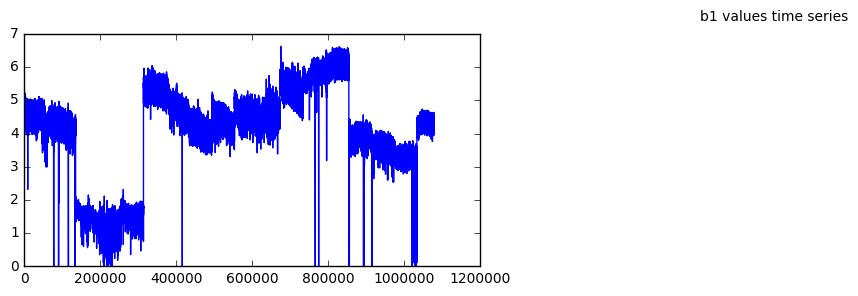

In [121]:
##### Plot full time series for each muscle and accompanying histograms 

len(multi_fly_df['b1_left'])
left_b1s = multi_fly_df['b1_left']
times = np.arange(1077800)

plt.figure(figsize=(20, 3))

plt.subplot(131)
#plt.bar(names, values)
#plt.subplot(132)
#plt.scatter(names, values)
#plt.subplot(133)
plt.plot(times, left_b1s)
plt.suptitle('b1 values time series')
plt.show()


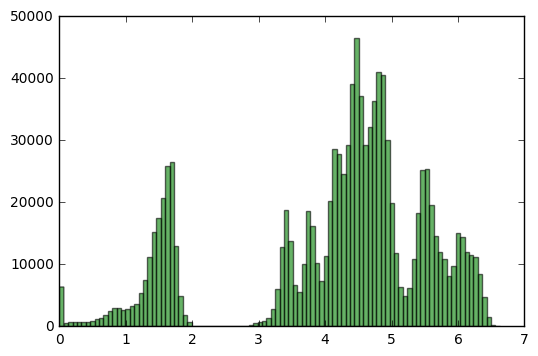

In [127]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt


# Generate some data for this demonstration.
data = left_b1s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_b1s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

In [3]:
fly_1 = multi_fly_df.loc[multi_fly_df['fly_num']==1729]

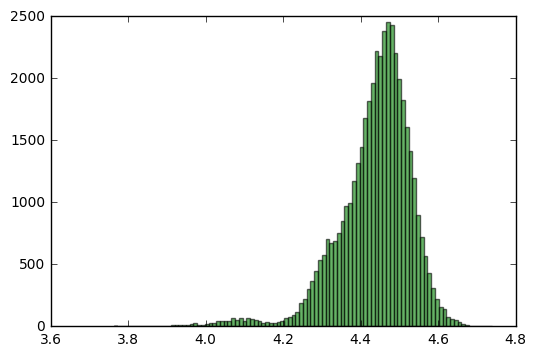

In [12]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

left_b1s = fly_1['b1_left']
times = np.arange(len(left_b1s))

# Generate some data for this demonstration.
data = left_b1s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_b1s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

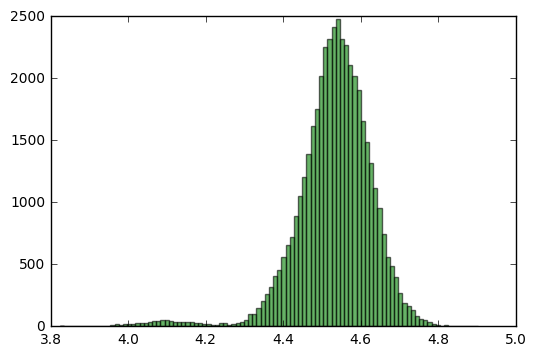

In [13]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

right_b1s = fly_1['b1_right']
times = np.arange(len(left_b1s))

# Generate some data for this demonstration.
data = right_b1s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(right_b1s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

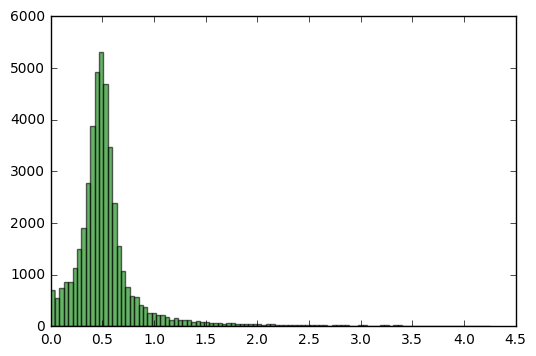

In [14]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

left_b2s = fly_1['b2_left']
times = np.arange(len(left_b1s))

# Generate some data for this demonstration.
data = left_b2s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_b2s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

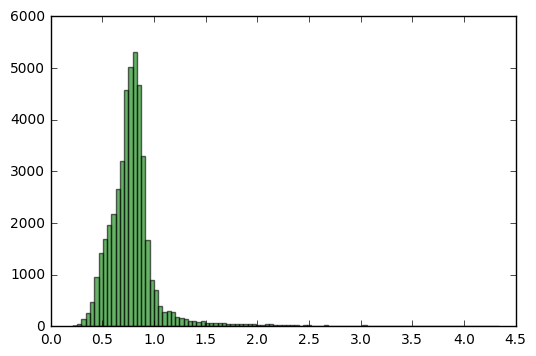

In [16]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

right_b2s = fly_1['b2_right']
times = np.arange(len(left_b1s))

# Generate some data for this demonstration.
data = right_b2s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(right_b2s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

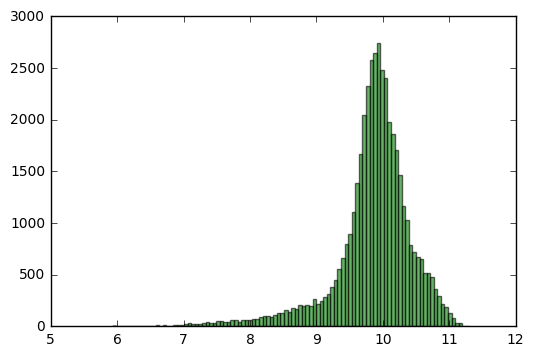

In [20]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

left_b3s = fly_1['b3_left']
times = np.arange(len(left_b3s))

# Generate some data for this demonstration.
data = left_b3s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_b3s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

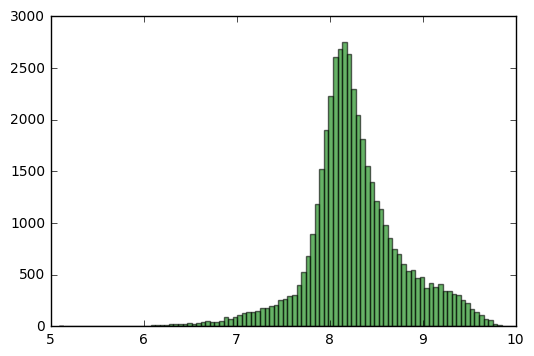

In [19]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

right_b3s = fly_1['b3_right']
times = np.arange(len(left_b3s))

# Generate some data for this demonstration.
data = right_b3s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(right_b3s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

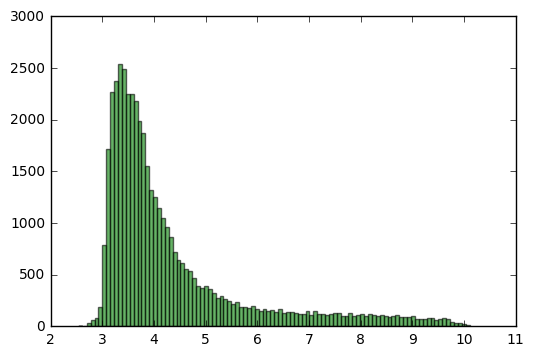

In [21]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

left_i1s = fly_1['i1_left']
times = np.arange(len(left_i1s))

# Generate some data for this demonstration.
data = left_i1s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_i1s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

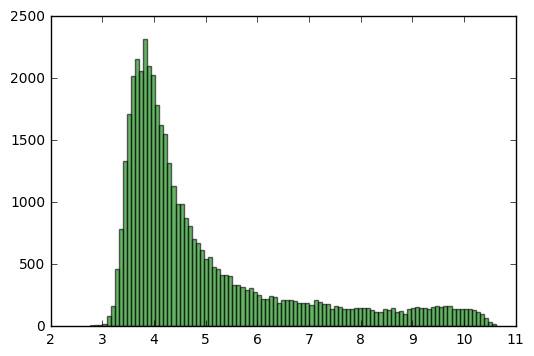

In [22]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

right_i1s = fly_1['i1_right']
times = np.arange(len(left_i1s))

# Generate some data for this demonstration.
data = right_i1s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(right_i1s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

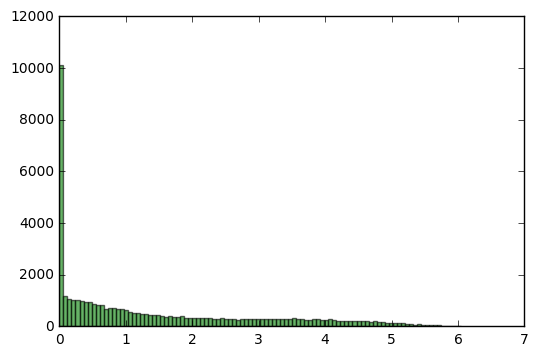

In [23]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

left_i2s = fly_1['i2_left']
times = np.arange(len(left_i2s))

# Generate some data for this demonstration.
data = left_i2s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_i2s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

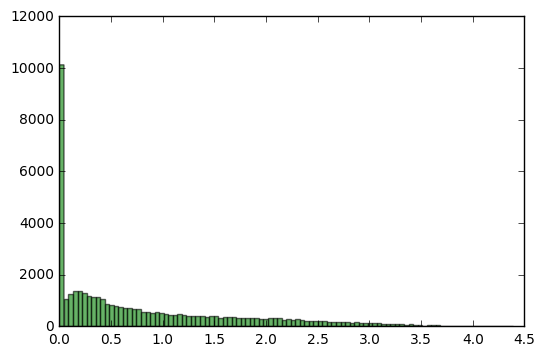

In [24]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt

right_i2s = fly_1['i2_right']
times = np.arange(len(left_i2s))

# Generate some data for this demonstration.
data = right_i2s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(right_i2s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

In [25]:
from scipy import stats

sample = right_i2s

# estimate parameters from sample
ae, loce, scalee = stats.skewnorm.fit(sample)


10206809.306727305

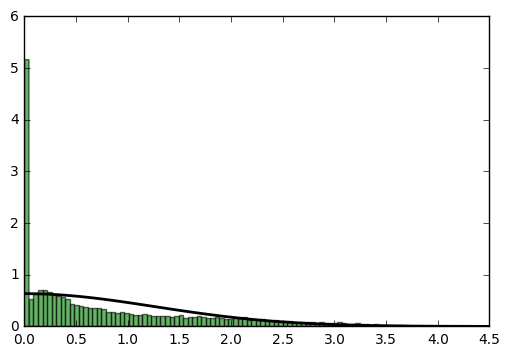

In [26]:

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.6, color='g')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)
p = stats.skewnorm.pdf(x,ae, loce, scalee)#.rvs(100)
plt.plot(x, p, 'k', linewidth=2)

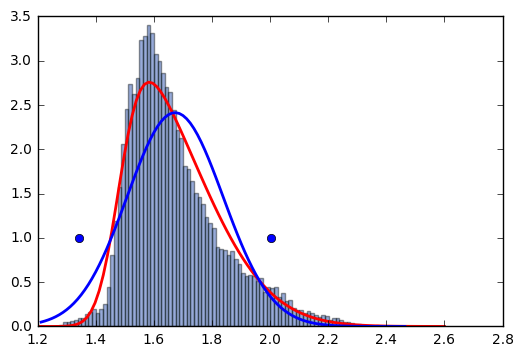

In [47]:
data = fly_1['iii1_left']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')




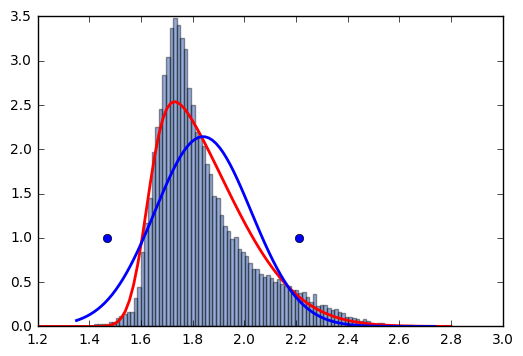

In [48]:
data = fly_1['iii1_right']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



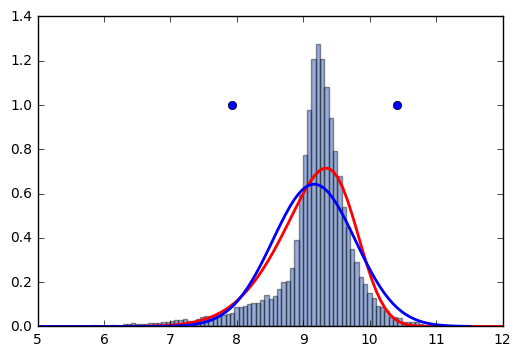

In [49]:
data = fly_1['iii3_left']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



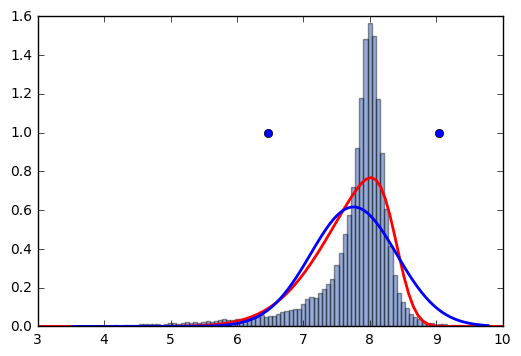

In [50]:
data = fly_1['iii3_right']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



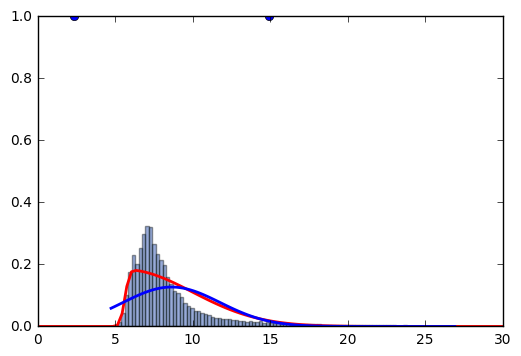

In [51]:
data = fly_1['hg1_left']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



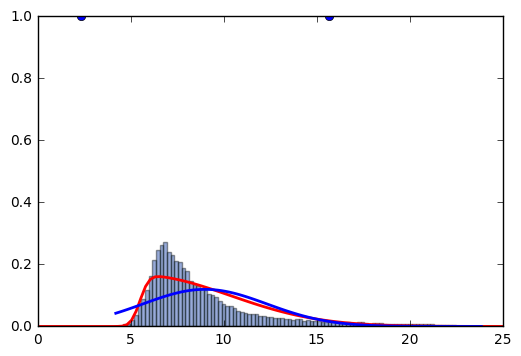

In [52]:
data = fly_1['hg1_right']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



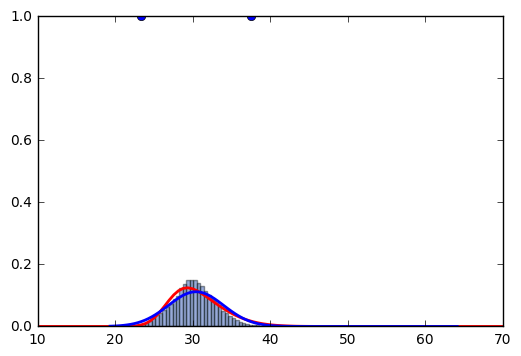

In [53]:
data = fly_1['hg2_left']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



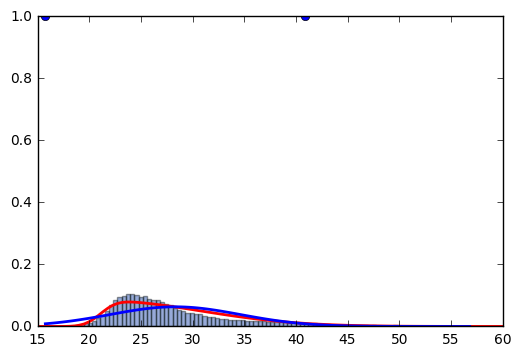

In [54]:
data = fly_1['hg2_right']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



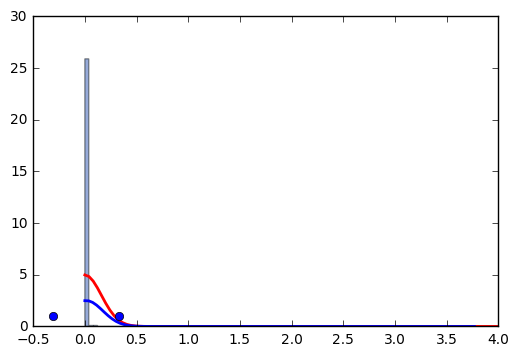

In [55]:
data = fly_1['hg3_left']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



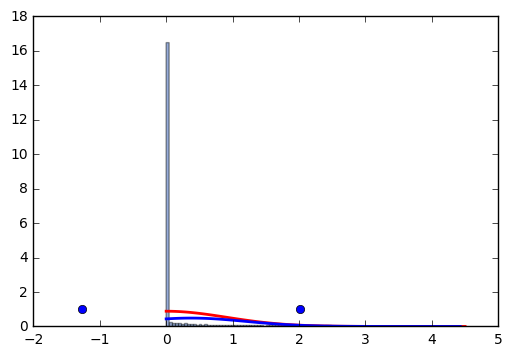

In [56]:
data = fly_1['hg3_right']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



/home/imager/.local/lib/python2.7/site-packages/scipy/stats/_distn_infrastructure.py:1608: RuntimeWarning: divide by zero encountered in log
  return log(self._pdf(x, *args))


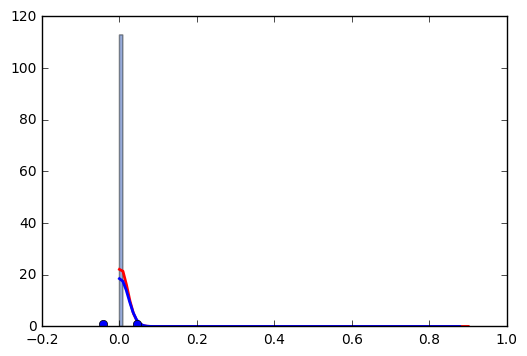

In [57]:
data = fly_1['hg4_left']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



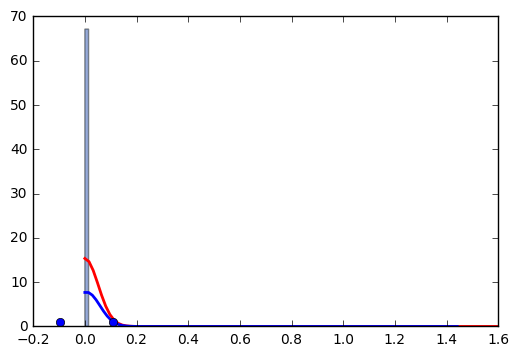

In [58]:
data = fly_1['hg4_right']

plt.figure()
plt.hist(data, bins=100, normed=True, alpha=0.3, color='b')
xmin, xmax = plt.xlim()
x = np.linspace(xmin, xmax, 100)

a_e, loc_e, scale_e = stats.skewnorm.fit(data)
p = stats.skewnorm.pdf(x, a_e, loc_e, scale_e)#.rvs(100)
plt.plot(x, p, 'r', linewidth=2)


(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.15)

# add a 'best fit' line
#y = mlab.normpdf( bins, mu, sigma)
#l = plt.plot(bins, y, 'r--', linewidth=2)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='b')

plt.plot(mu + (2*sigma),1, marker= 'o', color = 'blue')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'blue')



In [10]:
def min_max_tonic_range(data):
    data = data
    # best fit of data
    (mu, sigma) = norm.fit(data)

    # the histogram of the data
    n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.75)

    # add a 'best fit' line
    y = mlab.normpdf( bins, mu, sigma)
    #l = plt.plot(bins, y, 'r--', linewidth=2)

    mmin = mu - (2*sigma)
    mmax = mu + (2*sigma)
    
    return (mu, sigma, mmin, mmax)


In [9]:
def min_max_tonic_range_mods(data):
    data = data
    # best fit of data
    (mu, sigma) = norm.fit(data)

    # the histogram of the data
    n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.75)

    # add a 'best fit' line
    y = mlab.normpdf( bins, mu, sigma)
    #l = plt.plot(bins, y, 'r--', linewidth=2)

    #mmin = mu - (2*sigma)
    mmin = np.min(data)
    mmax = np.max(data)
    #mmax = mu + (2*sigma)
    
    return (mu, sigma, mmin, mmax)


In [7]:
def normd_mods(muscle_data):
        mu, sigma, mmin, mmax = min_max_tonic_range(muscle_data)
        xno = muscle_data
        normalized = (xno-mmin)/(max(xno)-mmin)
        return normalized

In [8]:
def normd_mods_mods(muscle_data):
        mu, sigma, mmin, mmax = min_max_tonic_range_mods(muscle_data)
        xno = muscle_data
        normalized = (xno-mmin)/(max(xno)-mmin)
        return normalized

In [ ]:
    
normed_multi_fly_df = pd.DataFrame()

for flynum in fly_nums:
    df=multi_fly_df.loc[multi_fly_df['fly_num']==flynum]
    for key in sorted_keys: 
        a = normd_mods(df[key])
        df[key] = a
    normed_multi_fly_df = normed_multi_fly_df.append(df)  

/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
/usr/lib/python2.7/dist-packages/matplotlib/mlab.py:1587: RuntimeWarning: divide by zero encountered in double_scalars
  return 1./(np.sqrt(2*np.pi)*sigma)*np.exp(-0.5 * (1./sigma*(x - mu))**2)
/usr/lib/python2.7/dist-packages/matplotlib/mlab.py:1587: RuntimeWarning: invalid value encountered in multiply
  return 1./(np.sqrt(2*np.pi)*sigma)*np.exp(-0.5 * (1./sigma*(x - mu))**2)


In [5]:
fly_1 = multi_fly_df.loc[multi_fly_df['fly_num']==1729]

In [4]:
data = fly_1['b1_left']
len(data)

44700

In [119]:
D = data.tolist()

In [5]:
import matplotlib.pyplot as plt

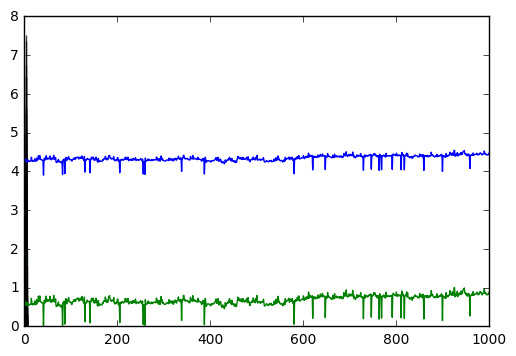

In [122]:
plt.figure()
plt.plot(D[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(D[1000:2000]),linewidth=1, color='g')
#plt.xlim(1034000, 1035500)
plt.show()

diff = np.diff(data[1000:2000])

plt.figure()
#plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(diff,linewidth=1, color='r')
#plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

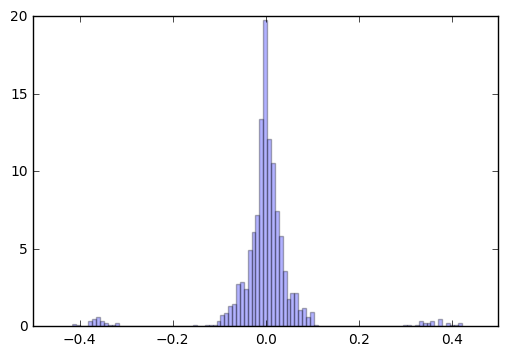

In [123]:
#print(diff)
len(D[1000:2000])
data1 =(D[1000:2000])
#diff = np.diff(data[1000:2000])
diff = np.diff(data1)

plt.figure()
plt.hist(diff, bins=100, normed=True, alpha=0.3, color='b')
plt.show()

glitch_list = []

counter = 0
for n in diff:
    if n > 0.2:
        glitch_list.append(counter)
    if n < -0.2:
        glitch_list.append(counter)
    counter += 1


In [124]:
print(len(glitch_list))
print(len(diff))
print(glitch_list)
for n in range(len(data1)): 
    if n in glitch_list: 
        data1[n-1]= np.nan
        data1[n]= np.nan
        #data1[n+1]= np.nan
        
#print data1

        
#df.interpolate(method ='linear', limit_direction ='forward') 

46
999
[40, 41, 81, 82, 86, 87, 129, 130, 140, 141, 204, 205, 254, 256, 258, 259, 337, 338, 386, 387, 579, 580, 619, 620, 646, 647, 728, 729, 745, 746, 762, 763, 767, 768, 790, 791, 809, 810, 816, 817, 858, 859, 898, 899, 957, 958]


40
41
81
82
86
87
129
130
140
141
204
205
254
256
258
259
337
338
386
387
579
580
619
620
646
647
728
729
745
746
762
763
767
768
790
791
809
810
816
817
858
859
898
899
957
958


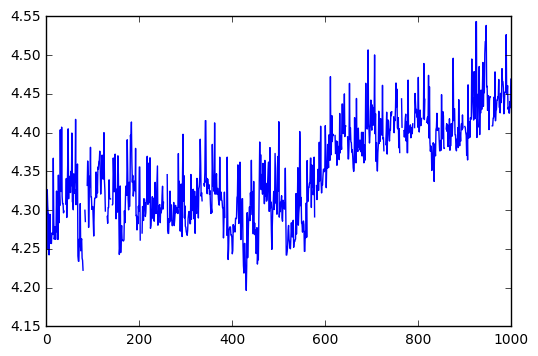

In [125]:
plt.figure()
plt.plot(data1,linewidth=1, color='b')
for x in glitch_list:
    print x
    plt.plot(x, data1[x], 'o', color ='r')
plt.plot()
#plt.xlim(1034000, 1035500)
plt.show()

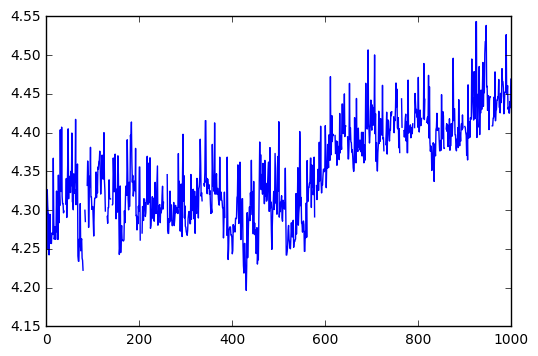

In [126]:
plt.figure()
plt.plot(data1,linewidth=1, color='b')
#plt.xlim(1034000, 1035500)
plt.show()

In [129]:
df = pd.DataFrame()
df['data'] = data1

#df=df.interpolate(method ='linear', limit_direction ='forward')
df=df.interpolate(method='linear', limit_direction='forward', axis=0)
#df =df['data'].interpolate(method='polynomial', order=2)
#df =df.interpolate()
df.head()

,data
0,4.320782
1,4.249184
2,4.326340
3,4.305834
4,4.294948


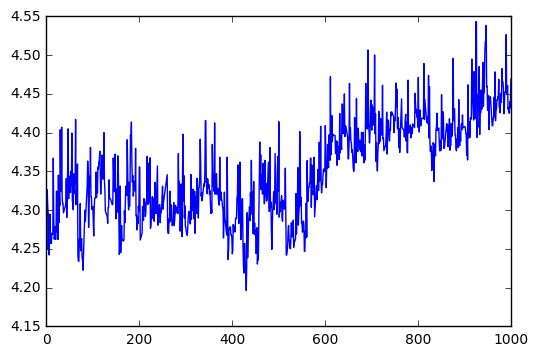

In [130]:
plt.figure()
plt.plot(df,linewidth=1, color='b')
#plt.xlim(1034000, 1035500)
plt.show()

In [131]:
df = pd.DataFrame()
df['data'] = D

#df=df.interpolate(method ='linear', limit_direction ='forward')
df=df.interpolate(method='linear', limit_direction='forward', axis=0)
#df =df['data'].interpolate(method='polynomial', order=2)
#df =df.interpolate()
df.head()

,data
0,4.285757
1,4.298758
2,4.339421
3,4.431994
4,4.347752


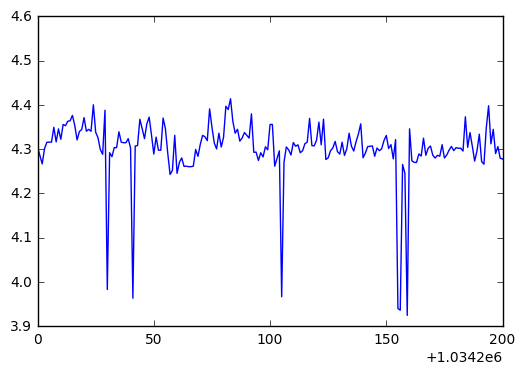

In [13]:
plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
#plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034200, 1034400)
plt.show()

In [ ]:
plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1034100)
plt.show()

In [ ]:
data = fly_1['b1_left']
time = np.arange(1000)
plt.figure()
plt.plot(time, data[1000:2000],linewidth=2, color='b')


In [51]:
data = fly_1['b2_left']
len(data)

44700

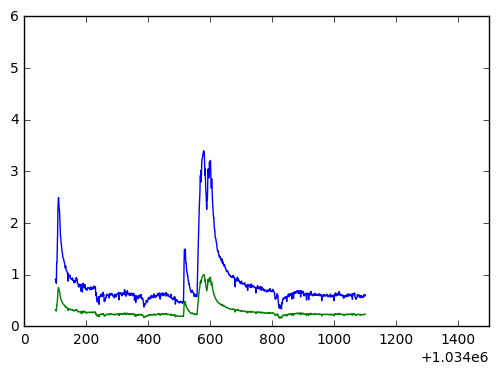

In [52]:
plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

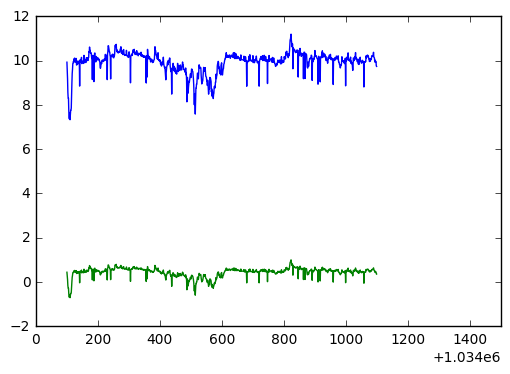

In [53]:
data = fly_1['b3_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

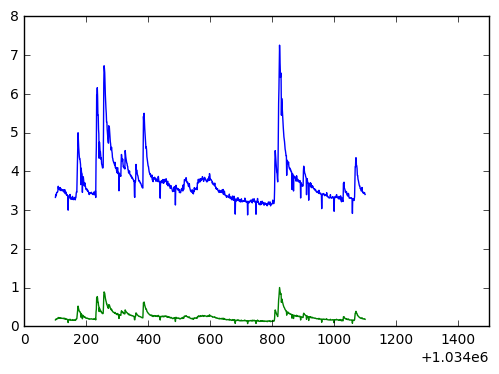

In [54]:
data = fly_1['i1_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

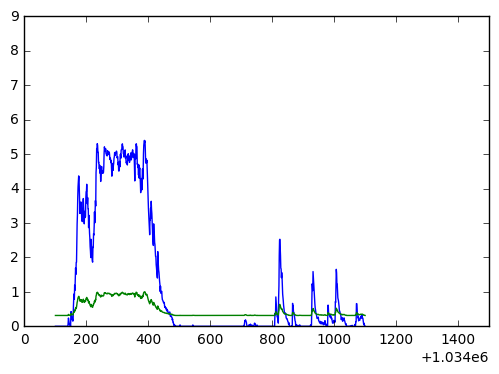

In [55]:
data = fly_1['i2_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

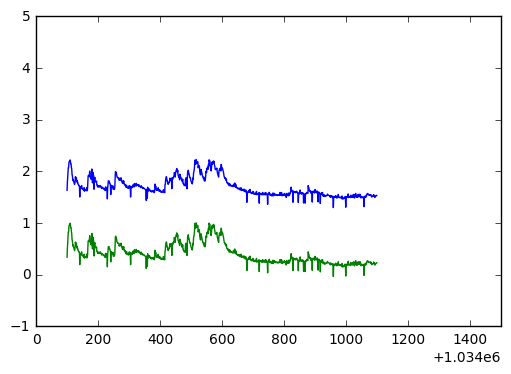

In [56]:
data = fly_1['iii1_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

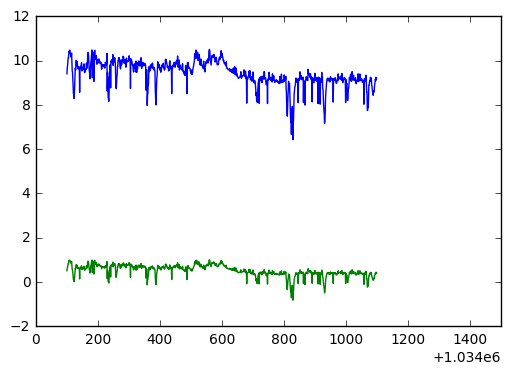

In [57]:
data = fly_1['iii3_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

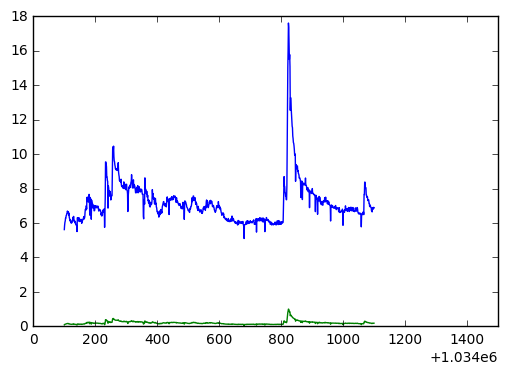

In [58]:
data = fly_1['hg1_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

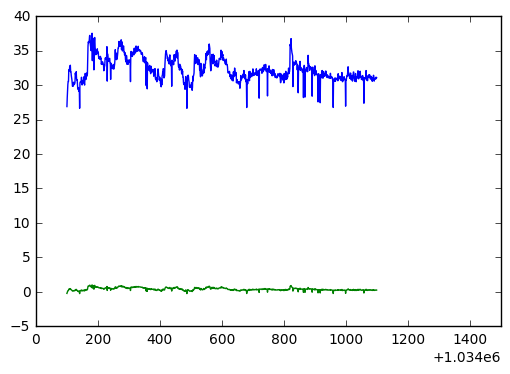

In [59]:
data = fly_1['hg2_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods(data[1000:2000]),linewidth=1, color='g')
plt.xlim(1034000, 1035500)
plt.show()

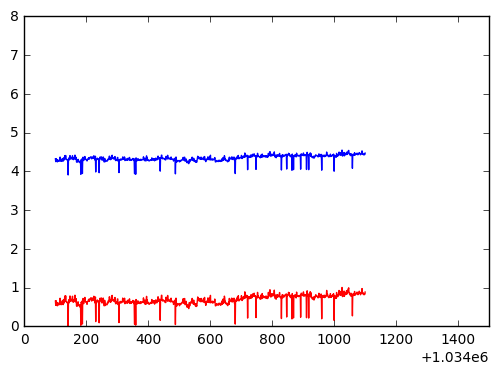

In [63]:
data = fly_1['b1_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

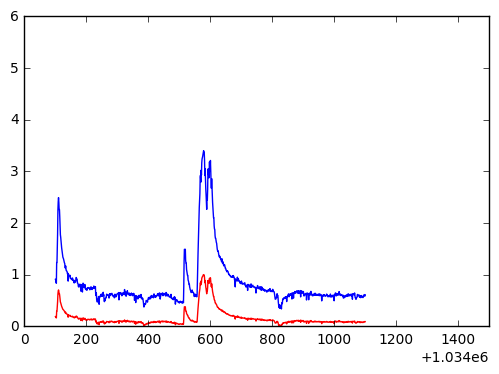

In [64]:
data = fly_1['b2_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

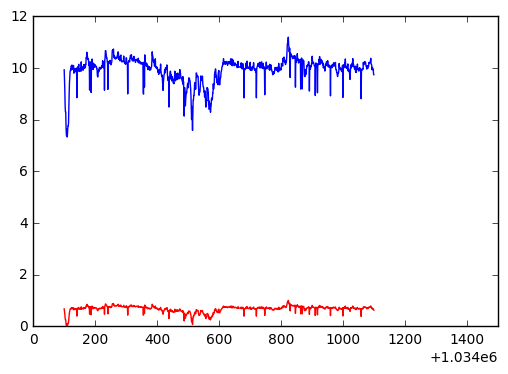

In [65]:
data = fly_1['b3_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

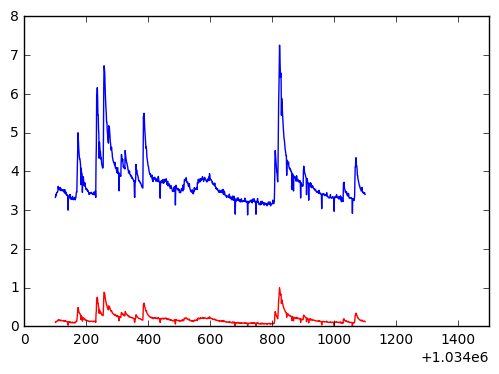

In [66]:
data = fly_1['i1_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

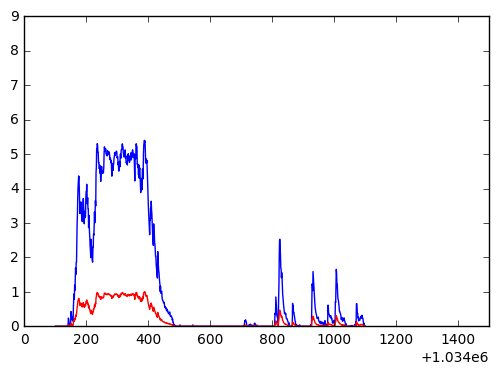

In [68]:
data = fly_1['i2_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

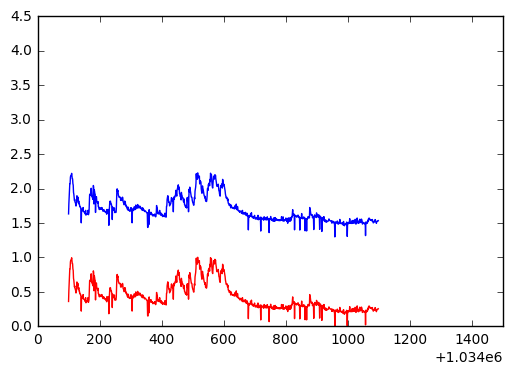

In [69]:
data = fly_1['iii1_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

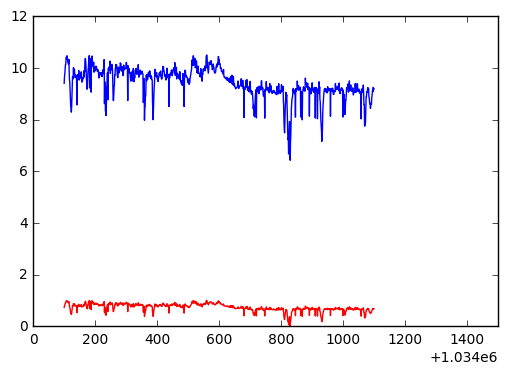

In [70]:
data = fly_1['iii3_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

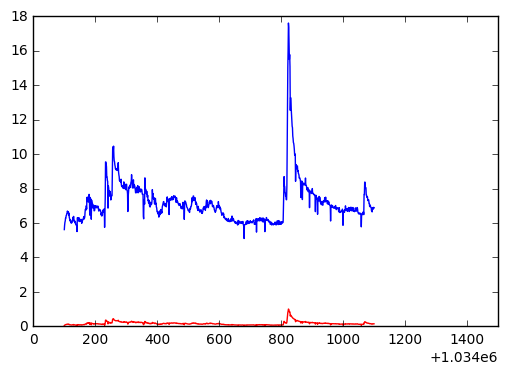

In [71]:
data = fly_1['hg1_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

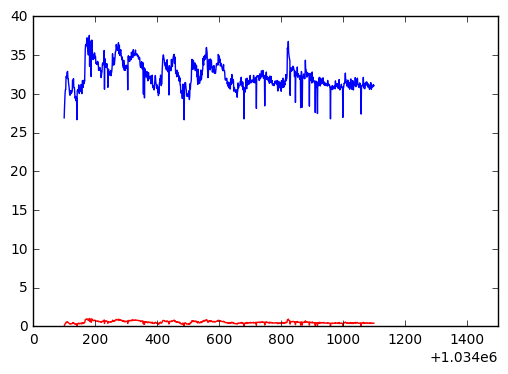

In [72]:
data = fly_1['hg2_left']

plt.figure()
plt.plot(data[1000:2000],linewidth=1, color='b')
plt.plot(normd_mods_mods(data[1000:2000]),linewidth=1, color='r')
plt.xlim(1034000, 1035500)
plt.show()

In [134]:
fly_1 = multi_fly_df.loc[multi_fly_df['fly_num']==1729]

In [ ]:
len(multi_fly_df['b1_left'])

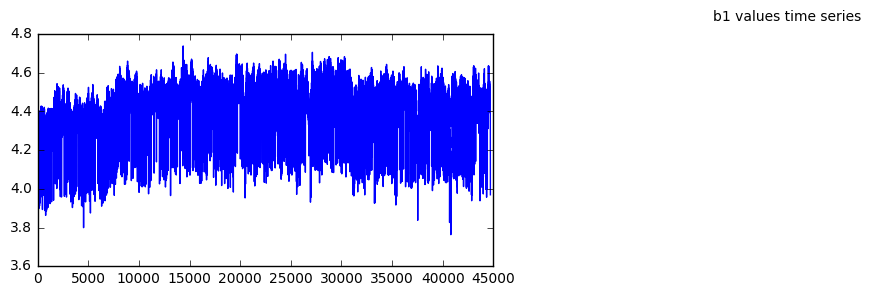

In [136]:
left_b1s = fly_1['b1_left']
times = np.arange(len(left_b1s))

plt.figure(figsize=(20, 3))

plt.subplot(131)
#plt.bar(names, values)
#plt.subplot(132)
#plt.scatter(names, values)
#plt.subplot(133)
plt.plot(times, left_b1s)
plt.suptitle('b1 values time series')
plt.show()

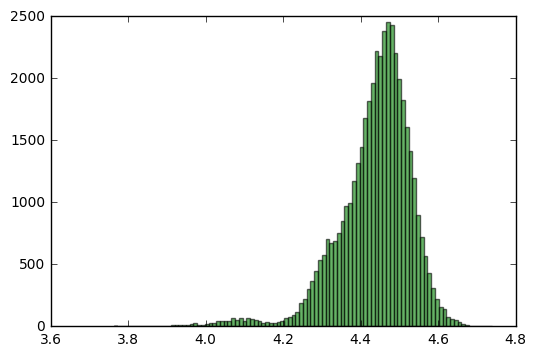

In [137]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt


# Generate some data for this demonstration.
data = left_b1s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_b1s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

In [ ]:
### Use gaussian to do the nornalization


In [ ]:
##### Plot full time series for each muscle and accompanying histograms 

len(multi_fly_df['b1_left'])
left_b1s = multi_fly_df['b1_left']
times = np.arange(1077800)

plt.figure(figsize=(20, 3))

plt.subplot(131)
#plt.bar(names, values)
#plt.subplot(132)
#plt.scatter(names, values)
#plt.subplot(133)
plt.plot(times, left_b1s)
plt.suptitle('b1 values time series')
plt.show()


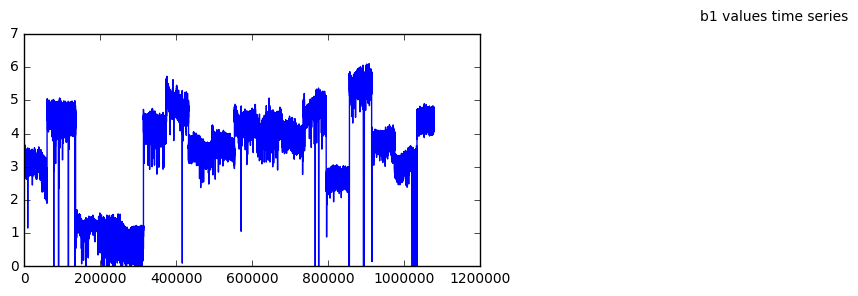

In [125]:
len(multi_fly_df['b1_right'])
right_b1s = multi_fly_df['b1_right']
times = np.arange(1077800)

plt.figure(figsize=(20, 3))

plt.subplot(131)
#plt.bar(names, values)
#plt.subplot(132)
#plt.scatter(names, values)
#plt.subplot(133)
plt.plot(times, right_b1s)
plt.suptitle('b1 values time series')
plt.show()


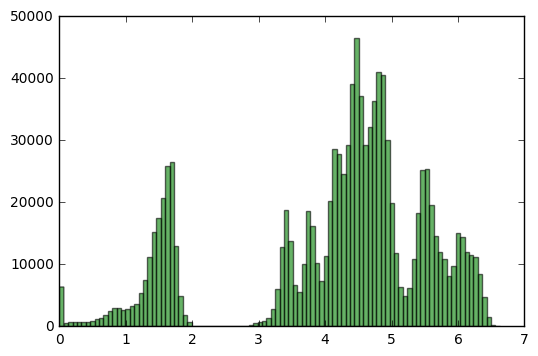

In [128]:
import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt


# Generate some data for this demonstration.
data = left_b1s

# Plot the histogram.
plt.hist(left_b1s, bins=100, alpha=0.6, color='g')



plt.show()

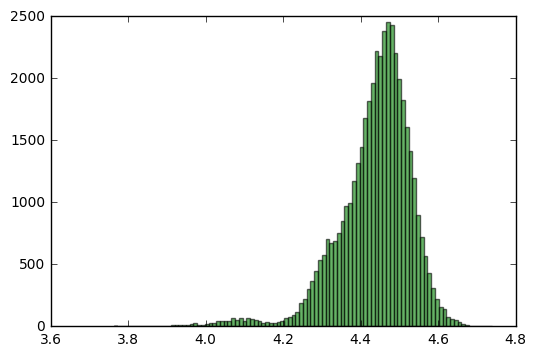

In [138]:
##### Find the range of the data for this -- gaussian map fitting

import numpy as np
from scipy.stats import norm
import matplotlib.pyplot as plt


# Generate some data for this demonstration.
data = left_b1s

# Fit a normal distribution to the data:
#mu, std = norm.fit(data)

# Plot the histogram.
plt.hist(left_b1s, bins=100, alpha=0.6, color='g')

# Plot the PDF.
#xmin, xmax = plt.xlim()
#x = np.linspace(xmin, xmax, 100)
#p = norm.pdf(x, mu, std)
#plt.plot(x, p, 'k', linewidth=2)
#title = "Fit results: mu = %.2f,  std = %.2f" % (mu, std)
#plt.title(title)

plt.show()

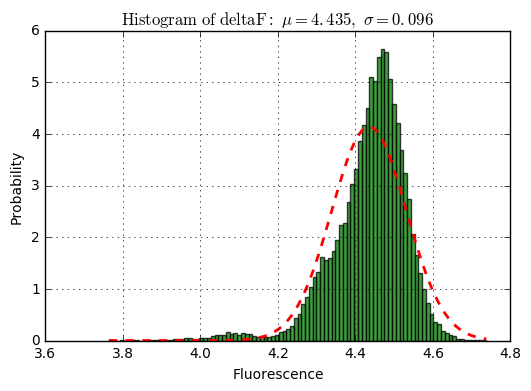

In [140]:
### Fit gaussian then find confidence interval


from scipy.stats import norm
import matplotlib.mlab as mlab
import matplotlib.pyplot as plt


# best fit of data
(mu, sigma) = norm.fit(data)

# the histogram of the data
n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.75)

# add a 'best fit' line
y = mlab.normpdf( bins, mu, sigma)
l = plt.plot(bins, y, 'r--', linewidth=2)

#plot
plt.xlabel('Fluorescence')
plt.ylabel('Probability')
plt.title(r'$\mathrm{Histogram\ of\ delta F:}\ \mu=%.3f,\ \sigma=%.3f$' %(mu, sigma))
plt.grid(True)

plt.show()

/* What is a "large value" of a normal sample? The answer depends on the size of the sample. */
/* Use CDF to find probability that a random value from N(0,1) exceeds 4 */
proc iml;
P_NotGT4 = cdf("Normal", 4);   /* P(x < 4) */
 
/* Probability of an extreme obs in a sample that contains n independent observations */
n = {1, 100, 1000, 10000};     /* sample sizes */
P_NotGT4 = P_NotGT4**n;        /* P(all values are < 4) */
P_GT4 = 1 - P_NotGT4;          /* P(any value is > 4)   */
print n P_NotGT4 P_GT4;

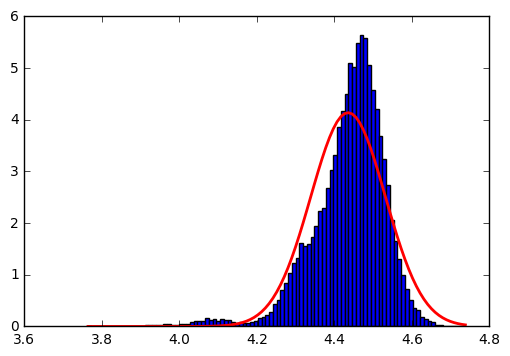

In [144]:
import matplotlib.pyplot as plt
count, bins, ignored = plt.hist(data, 100, normed=True)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='r')
plt.show()


In [146]:
2*sigma 

0.19284358047973046

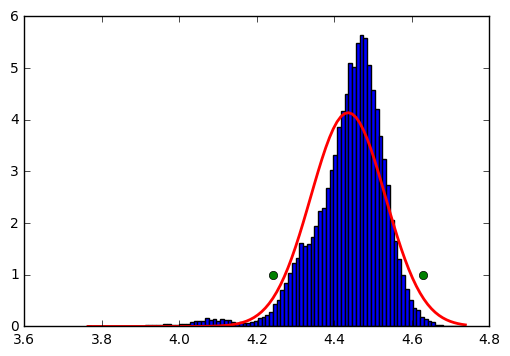

In [152]:
import matplotlib.pyplot as plt
count, bins, ignored = plt.hist(data, 100, normed=True)
plt.plot(bins, 1/(sigma * np.sqrt(2 * np.pi)) *np.exp( - (bins - mu)**2 / (2 * sigma**2) ),linewidth=2, color='r')
plt.plot(mu + (2*sigma),1, marker= 'o', color = 'green')
plt.plot(mu - (2*sigma),1, marker= 'o', color = 'green')
plt.show()

In [153]:
#### Now apply the 2sigma gaussian etc to each fly 


In [154]:
def min_max_tonic_range(data):
    data = data
    # best fit of data
    (mu, sigma) = norm.fit(data)

    # the histogram of the data
    n, bins, patches = plt.hist(data, 100, normed=1, facecolor='green', alpha=0.75)

    # add a 'best fit' line
    y = mlab.normpdf( bins, mu, sigma)
    #l = plt.plot(bins, y, 'r--', linewidth=2)

    mmin = mu - (2*sigma)
    mmax = mu + (2*sigma)
    
    return (mu, sigma, mmin, mmax)


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd



x = np.arange(-10,10)
layout.axes['phasic'].plot(x, x**3)
layout.axes['tonic'].plot(x, x** (1. / 3))
layout.axes['phasic'].set_xbound(-10, 10)
layout.axes['tonic'].set_xbound(-10, 10)
layout.axes['tonic'].axhline(y=0, color='k')
layout.axes['tonic'].axvline(x=0, color='k')
layout.axes['phasic'].axhline(y=0, color='k')
layout.axes['phasic'].axvline(x=0, color='k')
#layout.axes['phasic'].set_ybound(-10, 10)
layout.axes['tonic'].set_ybound([-3, 3])
layout.axes['tonic'].plot(x, np.cbrt(x))




fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]

times = np.arange(len(x))*0.02
colors = times[120:240]


x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

In [ ]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi

#layout = fifi.FigureLayout('paper_figure_1_v2.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v7.svg',make_mplfigures = True)

#layout.axes['yaw_left'].plot(time, mean_WBA) #,'o',alpha = 0.2)
#layout.axes['yaw_left'].fill_between(time, (mean_WBA-error), (mean_WBA + error),alpha = 0.1)

#layout.axes['yaw_right'].plot(time, mean_WBA_turn_right) #,'o',alpha = 0.2)
#layout.axes['yaw_right'].fill_between(time, (mean_WBA_turn_right-error_turn_right), (mean_WBA_turn_right + error_turn_right),alpha = 0.1)

import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd



x = np.arange(-10,10)
layout.axes['phasic'].plot(x, x**3)
layout.axes['tonic'].plot(x, x** (1. / 3))
layout.axes['phasic'].set_xbound(-10, 10)
layout.axes['tonic'].set_xbound(-10, 10)
layout.axes['tonic'].axhline(y=0, color='k')
layout.axes['tonic'].axvline(x=0, color='k')
layout.axes['phasic'].axhline(y=0, color='k')
layout.axes['phasic'].axvline(x=0, color='k')
#layout.axes['phasic'].set_ybound(-10, 10)
layout.axes['tonic'].set_ybound([-3, 3])
layout.axes['tonic'].plot(x, np.cbrt(x))




fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]

times = np.arange(len(x))*0.02
colors = times[120:240]


x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

'''
layout.axes['l_wsa'].plot(times,l_deg,clip_on = False,color = 'k')
layout.axes['l_wsa'].set_xbound(0,times[-1])
layout.axes['l_wsa'].set_ylabel('left \n amplitude')
layout.axes['l_wsa'].patch.set_alpha(0.0)
layout.axes['l_wsa'].set_ybound(20,40)
layout.axes['l_wsa'].set_yticks([20, 30, 40])
#layout.axes['l_wsa'].set_ybound(-15,15)
#layout.axes['l_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

layout.axes['r_wsa'].plot(times,r_deg,clip_on = False,color = 'k')
layout.axes['r_wsa'].set_xbound(0,times[-1])
layout.axes['r_wsa'].set_ylabel('right \n amplitude')
layout.axes['r_wsa'].patch.set_alpha(0.0)
layout.axes['r_wsa'].set_ybound(20,40)
layout.axes['r_wsa'].set_yticks([20, 30, 40])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

'''

layout.axes['lmr_rt'].plot(times,yaw_right_dlmr,clip_on = False,color = 'k')
#layout.axes['lmr_rt'].fill_between(times, (yaw_right_dlmr - yaw_right_dlmr_er),  (yaw_right_dlmr + yaw_right_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_rt'].set_xbound(0,times[-1])
layout.axes['lmr_rt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_rt'].patch.set_alpha(0.0)
layout.axes['lmr_rt'].set_ybound(-20,20)
layout.axes['lmr_rt'].set_yticks([-15, 0, 15])
layout.axes['lmr_rt'].plot(times[120],yaw_right_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_rt'].plot(times[240],yaw_right_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 
#ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
layout.axes['lmr_rt'].set_xticks([times[120],times[240]])


layout.axes['liii1_rt'].plot(times,yaw_right_diii3l,clip_on = False,color = 'k')
#layout.axes['liii1_rt'].fill_between(times, (yaw_right_diii3l - yaw_right_diii3l_er),  (yaw_right_diii3l + yaw_right_diii3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['liii1_rt'].set_xbound(0,times[-1])
layout.axes['liii1_rt'].set_ylabel('L iii3')
layout.axes['liii1_rt'].plot(times[120],yaw_right_diii3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
#layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].plot(times[240],yaw_right_diii3l[240],'purple', marker='o', markersize=4)#, 'o')
layout.axes['liii1_rt'].set_ybound(0.45,0.60)
layout.axes['liii1_rt'].set_yticks([0.45, 0.6])

#x = list(pitch_down_new_df['muscles'])
c_r = times[120:240]
Min = times[119]
Max = times[241]             
x = yaw_right_di1r[120:240]
y = yaw_right_db3r[120:240]
df= pd.DataFrame({"x":x,"y":y,"c":c_r})
cmap = plt.cm.cool
norm = matplotlib.colors.Normalize(vmin=Min, vmax=Max)

ax1 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Ri1'),('Rb3'), ax1)
c = ax1.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
#plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
########layout.axes['Liii1_Rb3'].plot(df.x, df.y, color=cmap(norm(df.c.values)), marker = 'o', markersize=2)
#plot_sector(flylist,('left','iii1'),('right','b3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
layout.axes['Liii1_Rb3'].set_xbound(0,1),layout.axes['Liii1_Rb3'].set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
layout.axes['Liii1_Rb3'].set_xticks([0,1])
layout.axes['Liii1_Rb3'].set_yticks([0,1])  
layout.axes['Liii1_Rb3'].set_ybound(0.20,0.45)
layout.axes['Liii1_Rb3'].set_yticks([0.2, 0.45])

x = yaw_right_diii3l[120:240]
y = yaw_right_dhg1r[120:240]
ax2 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax2)
c = ax2.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])                
                
x = yaw_right_diii3l[120:240]
y = yaw_right_db3r[120:240]
ax3 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax3)
c = ax3.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax3.set_xbound(0,1),ax2.set_ybound(0,1)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])  


x = yaw_right_dhg1r[120:240]
y = yaw_right_di1r[120:240]
ax4 = layout.axes['Ri1_Rhg1']
scatter(flylist[6], ('Ri1'),('Rhg1'), ax4)
c = ax4.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax4.set_xbound(0,1),ax2.set_ybound(0,1)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])  



            

layout.axes['ri1_rt'].plot(times,yaw_right_di1r,clip_on = False,color = 'k')
#layout.axes['ri1_rt'].fill_between(times, (yaw_right_di1r - yaw_right_di1r_er),  (yaw_right_di1r+ yaw_right_di1r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['ri1_rt'].set_xbound(0,times[-1])
layout.axes['ri1_rt'].set_ylabel('Right i1')
layout.axes['ri1_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['ri1_rt'].plot(times[120],yaw_right_di1r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['ri1_rt'].plot(times[240],yaw_right_di1r[240],'purple', marker='o', markersize=4)#, 'o') 
#layout.axes['ri1_rt'].set_ybound(0.40,0.60)
#layout.axes['ri1_rt'].set_yticks([0.40, 0.6])
layout.axes['ri1_rt'].set_ybound(0.2,0.45)
layout.axes['ri1_rt'].set_yticks([0.2, 0.45])


layout.axes['rb3_rt'].plot(times,yaw_right_db3r,clip_on = False,color = 'k')
#layout.axes['rb3_rt'].fill_between(times, (yaw_right_db3r - yaw_right_db3r_er),  (yaw_right_db3r+ yaw_right_db3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['rb3_rt'].set_xbound(0,times[-1])
layout.axes['rb3_rt'].set_ylabel('Right b3')
layout.axes['rb3_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['rb3_rt'].plot(times[120],yaw_right_db3r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].plot(times[240],yaw_right_db3r[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].set_ybound(0.55,0.65)
layout.axes['rb3_rt'].set_yticks([0.55, 0.65])



#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


##write the clips out here and use the derivative to get the signals 



## plot each segment

#----------------------------------------------------------------------


fly = flylist[6]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]



layout.axes['lmr_lt'].plot(times,yaw_left_dlmr,clip_on = False,color = 'k')
#layout.axes['lmr_lt'].fill_between(times, (yaw_left_dlmr - yaw_left_dlmr_er),  (yaw_left_dlmr+ yaw_left_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_lt'].set_xbound(0,times[-1])
layout.axes['lmr_lt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_lt'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].set_ybound(-20,20)
layout.axes['lmr_lt'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].plot(times[130],yaw_left_dlmr[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_lt'].plot(times[240],yaw_left_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 


x = yaw_left_di1l[120:240]
y = yaw_left_diii3r[120:240]
ax5 = layout.axes['Li1_Riii3']
scatter(flylist[6], ('Li1'),('Riii3'), ax5)
c = ax5.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax5.set_xbound(0,1),ax5.set_ybound(0,1)
ax5.set_xticks([0,1])
ax5.set_yticks([0,1])                
                


x = yaw_left_db3l[120:240]
y = yaw_left_diii3r[120:240]
ax6 = layout.axes['Lb3_Riii3']
scatter(flylist[6], ('Lb3'),('Riii3'), ax6)
c = ax6.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax6.set_xbound(0,1),ax6.set_ybound(0,1)
ax6.set_xticks([0,1])
ax6.set_yticks([0,1])                
                               
                
x = yaw_left_dhg1l[120:240]
y = yaw_left_diii3r[120:240]
ax7 = layout.axes['Lhg1_Riii3']
scatter(flylist[6], ('Lhg1'),('Riii3'), ax7)
c = ax7.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax7.set_xbound(0,1),ax7.set_ybound(0,1)
ax7.set_xticks([0,1])
ax7.set_yticks([0,1])  


x = yaw_left_di1l[120:240]
y = yaw_left_diii1r[120:240]
ax8 = layout.axes['Li1_Riii1']
scatter(flylist[6], ('Li1'),('Riii1'), ax8)
c = ax8.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax8.set_xbound(0,1),ax8.set_ybound(0,1)
ax8.set_xticks([0,1])
ax8.set_yticks([0,1])  



layout.axes['riii3_lt'].plot(times,yaw_left_diii3r,clip_on = False,color = 'k')
#layout.axes['riii3_lt'].fill_between(times, (yaw_left_diii3r - yaw_left_diii3r_er),  (yaw_left_diii3r+ yaw_left_diii3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['riii3_lt'].set_xbound(0,times[-1])
layout.axes['riii3_lt'].set_ylabel('R iii3')
layout.axes['riii3_lt'].set_ybound(0.45,0.60)
layout.axes['riii3_lt'].set_yticks([0.45, 0.6])
layout.axes['riii3_lt'].patch.set_alpha(0.0)
layout.axes['riii3_lt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['riii3_lt'].plot(times[130],yaw_left_diii3r[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['riii3_lt'].plot(times[240],yaw_left_diii3r[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['li1_lt'].plot(times,yaw_left_di1l,clip_on = False,color = 'k')
#layout.axes['li1_lt'].fill_between(times, (yaw_left_di1l - yaw_left_di1l_er),  (yaw_left_di1l+ yaw_left_di1l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['li1_lt'].set_xbound(0,times[-1])
layout.axes['li1_lt'].set_ylabel('L i1')
layout.axes['li1_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['li1_lt'].plot(times[130],yaw_left_di1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].plot(times[240],yaw_left_di1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].set_ybound(0.20,0.40)
layout.axes['li1_lt'].set_yticks([0.20, 0.4])

layout.axes['lb3_lt'].plot(times,yaw_left_db3l,clip_on = False,color = 'k')
#layout.axes['lb3_lt'].fill_between(times, (yaw_left_db3l - yaw_left_db3l_er),  (yaw_left_db3l+ yaw_left_db3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lb3_lt'].set_xbound(0,times[-1])
layout.axes['lb3_lt'].set_ylabel('L b3')
layout.axes['lb3_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_lt'].plot(times[130],yaw_left_db3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].plot(times[240],yaw_left_db3l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].set_ybound(0.50,0.60)
layout.axes['lb3_lt'].set_yticks([0.50, 0.60])




#____________________________________________________________________





fly = flylist[3]
snum = 1  #5


l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

layout.axes['lpr_WSAi'].plot(times,WSAi_dlmr,clip_on = False,color = 'k')
layout.axes['lpr_WSAi'].set_xbound(0,times[-1])
layout.axes['lpr_WSAi'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAi'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAi'].set_ybound(-20,20)
layout.axes['lpr_WSAi'].set_yticks([50, 75])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAi'].plot(times[120],WSAi_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAi'].plot(times[240],WSAi_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 




x = WSAi_db2l[120:240]
y = WSAi_diii3r[120:240]
ax9 = layout.axes['Lb2_Riii3']
scatter(flylist[6], ('Lb2'),('Riii3'), ax9)
c = ax9.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax9.set_xbound(0,1),ax9.set_ybound(0,1)
ax9.set_xticks([0,1])
ax9.set_yticks([0,1])                
                


x = WSAi_diii3l[120:240]
y = WSAi_diii3r[120:240]
ax10 = layout.axes['Liii3_Riii3']
scatter(flylist[6], ('Liii3'),('Riii3'), ax10)
c = ax10.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax10.set_xbound(0,1),ax10.set_ybound(0,1)
ax10.set_xticks([0,1])
ax10.set_yticks([0,1])                
                               
                
x = WSAi_diii1l[120:240]
y = WSAi_diii3r[120:240]
ax11 = layout.axes['Liii1_Riii3']
scatter(flylist[6], ('Liii1'),('Riii3'), ax11)
c = ax11.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax11.set_xbound(0,1),ax11.set_ybound(0,1)
ax11.set_xticks([0,1])
ax11.set_yticks([0,1])  


x = iii1l[120:240]
y = iii1r[120:240]
ax12 = layout.axes['Liii1_Riii1']
scatter(flylist[6], ('Liii1'),('Riii1'), ax12)
c = ax12.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax12.set_xbound(0,1),ax12.set_ybound(0,1)
ax12.set_xticks([0,1])
ax12.set_yticks([0,1])  



layout.axes['lb2_WSAi'].plot(times,WSAi_db2l,clip_on = False,color = 'k')
layout.axes['lb2_WSAi'].set_xbound(0,times[-1])
layout.axes['lb2_WSAi'].set_ylabel('L b2')
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['lb2_WSAi'].plot(times[120],WSAi_db2l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb2_WSAi'].plot(times[240],WSAi_db2l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lb2_WSAi'].set_ybound(0.19,0.23)
layout.axes['lb2_WSAi'].set_yticks([0.19, 0.23])


layout.axes['liii3_WSAi'].plot(times,WSAi_diii3l,clip_on = False,color = 'k')
layout.axes['liii3_WSAi'].set_xbound(0,times[-1])
layout.axes['liii3_WSAi'].set_ylabel('L iii3')
layout.axes['liii3_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii3_WSAi'].plot(times[130],WSAi_diii3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii3_WSAi'].plot(times[240],WSAi_diii3l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii3_WSAi'].set_ybound(0.45,0.60)
layout.axes['liii3_WSAi'].set_yticks([0.40, 0.6])

layout.axes['liii1_WSAi'].plot(times,WSAi_diii1l,clip_on = False,color = 'k')
layout.axes['liii1_WSAi'].set_xbound(0,times[-1])
layout.axes['liii1_WSAi'].set_ylabel('L iii1')
layout.axes['liii1_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii1_WSAi'].plot(times[130],WSAi_diii1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_WSAi'].plot(times[240],WSAi_diii1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_WSAi'].set_ybound(0.150,0.18)
layout.axes['liii1_WSAi'].set_yticks([0.150, 0.18])








#____________________________________________________________________________

fly = flylist[1]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]


layout.axes['lpr_WSAd'].plot(times,WSAd_dlmr,clip_on = False,color = 'k')
layout.axes['lpr_WSAd'].set_xbound(0,times[-1])
layout.axes['lpr_WSAd'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAd'].patch.set_alpha(0.0)
layout.axes['lpr_WSAd'].set_ybound(50,75)
layout.axes['lpr_WSAd'].set_yticks([50, 75])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAd'].plot(times[120],WSAd_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAd'].plot(times[240],WSAd_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 




x = WSAd_db3l[120:240]
y = WSAd_db3r[120:240]
ax13 = layout.axes['Lb3_Rb3']
scatter(flylist[6], ('Lb3'),('Rb3'), ax13)
c = ax13.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax13.set_xbound(0,1),ax13.set_ybound(0,1)
ax13.set_xticks([0,1])
ax13.set_yticks([0,1])                
                


x = WSAd_dhg1l[120:240]
y = WSAd_dhg1r[120:240]
ax14 = layout.axes['Lhg1_Rhg1']
scatter(flylist[6], ('Lhg1'),('Rhg1'), ax14)
c = ax14.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax14.set_xbound(0,1),ax14.set_ybound(0,1)
ax14.set_xticks([0,1])
ax14.set_yticks([0,1])                
                               
                
x = WSAd_db3l[120:240]
y = WSAd_diii1r[120:240]
ax15 = layout.axes['Lb3_Riii1']
scatter(flylist[6], ('Lb3'),('Riii1'), ax15)
c = ax15.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax15.set_xbound(0,1),ax15.set_ybound(0,1)
ax15.set_xticks([0,1])
ax15.set_yticks([0,1])  


x = WSAd_dhg1l[120:240]
y = WSAd_di1r[120:240]
ax16 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax16)
c = ax16.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax16.set_xbound(0,1),ax16.set_ybound(0,1)
ax16.set_xticks([0,1])
ax16.set_yticks([0,1])  


x = times[120:240]
y = np.ones(20)
ax17 = layout.axes['cmap_legend']
x_prime = x[::6]
colors = x_prime
c = ax17.scatter(x_prime, y, c=colors, cmap='cool', alpha=0.45)
ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
ax17.set_xticks([times[120],times[240]])
ax17.set_yticks([1])  



layout.axes['li1_WSAd'].plot(times,WSAd_di1l,clip_on = False,color = 'k')
layout.axes['li1_WSAd'].set_xbound(0,times[-1])
layout.axes['li1_WSAd'].set_ylabel('L i1')
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['li1_WSAd'].plot(times[120],WSAd_di1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_WSAd'].plot(times[240],WSAd_di1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['li1_WSAd'].set_ybound(0.20,0.4)
layout.axes['li1_WSAd'].set_yticks([0.20, 0.40])

layout.axes['lb3_WSAd'].plot(times,WSAd_db3l,clip_on = False,color = 'k')
layout.axes['lb3_WSAd'].set_xbound(0,times[-1])
layout.axes['lb3_WSAd'].set_ylabel('L b3')
layout.axes['lb3_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_WSAd'].plot(times[120],WSAd_db3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_WSAd'].plot(times[240],WSAd_db3l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_WSAd'].set_ybound(0.40,0.60)
layout.axes['lb3_WSAd'].set_yticks([0.40, 0.6])

layout.axes['lhg1_WSAd'].plot(times,WSAd_db1l,clip_on = False,color = 'k')
layout.axes['lhg1_WSAd'].set_xbound(0,times[-1])
layout.axes['lhg1_WSAd'].set_ylabel('L b1')
layout.axes['lhg1_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lhg1_WSAd'].plot(times[120],WSAd_db1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lhg1_WSAd'].plot(times[240],WSAd_db1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lhg1_WSAd'].set_ybound(0.55,0.58)
layout.axes['lhg1_WSAd'].set_yticks([0.55, 0.58])







fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v7.svg')
plt.close('all')
display(SVG('figure_05_v7.svg'))

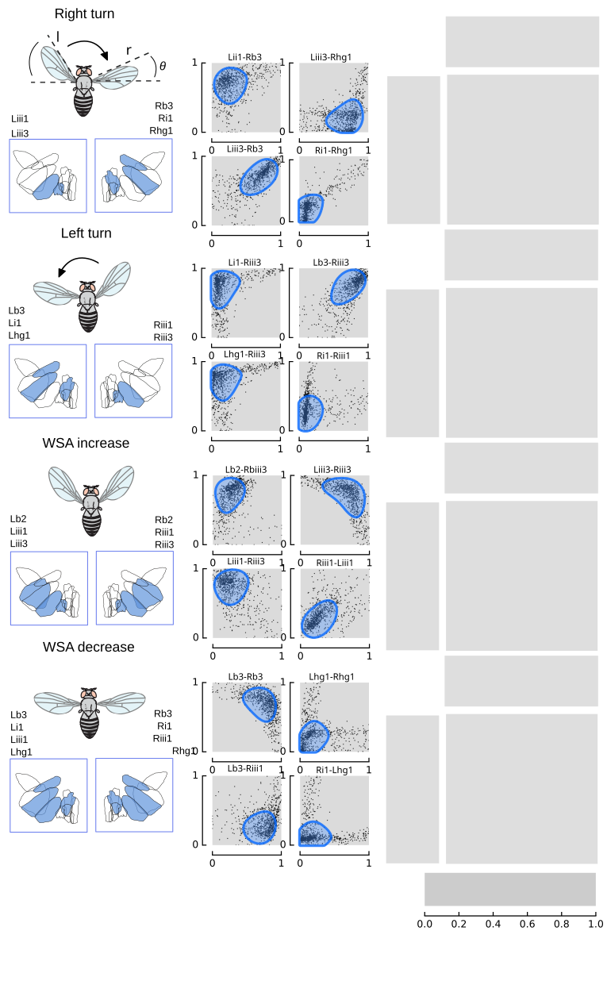

In [18]:
#lpf.make_scatter_plots(flylist[6])#,layout.axes_groups)

#layout = fifi.FigureLayout('layouts/scatter_anc_contour_layout.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v3.svg',make_mplfigures = True)




c_l = layout.pathspecs['lb-nu'].mplkwargs()['edgecolor']
c_r = layout.pathspecs['rb-nu'].mplkwargs()['edgecolor']


#make_scatter_plots(flylist[6],layout.axes_groups['none']['scatter_mtrx'])



ax2 = layout.axes['Lb3_Rb3']
scatter(flylist[6], ('Lb3'),('Rb3'), ax2)
plot_sector(flylist,('left','b3'),('right','b3'),'nb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)#,ax2.set_xlabel('left b3',color = c_l),ax2.set_ylabel('right b3',color = c_r)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])


ax3 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Liii1'),('Rb3'), ax3)
plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax3.set_xbound(0,1),ax3.set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])

ax4 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax4)
plot_sector(flylist,('left','iii3'),('right','hg1'),'nb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax4.set_xbound(0,1),ax4.set_ybound(0,1)#,ax4.set_xlabel('left b3',color = c_l),ax4.set_ylabel('right b3',color = c_r)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])

ax5 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax5)
plot_sector(flylist,('left','iii3'),('right','b3'),'nb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax5.set_xbound(0,1),ax5.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax5.set_ylabel('right b3',color = c_r)
ax5.set_xticks([0,1])
ax5.set_yticks([0,1])

ax6 = layout.axes['Ri1_Rhg1']
scatter(flylist[6], ('Ri1'),('Rhg1'), ax6)
plot_sector(flylist,('right','i1'),('right','hg1'),'nb-nu',ax6,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax6.set_xbound(0,1),ax5.set_ybound(0,1)#,ax6.set_xlabel('left b3',color = c_l),ax6.set_ylabel('right b3',color = c_r)
ax6.set_xticks([0,1])
ax6.set_yticks([0,1])

ax7 = layout.axes['Li1_Riii3']
scatter(flylist[6], ('Li1'),('Riii3'), ax7)
plot_sector(flylist,('left','i1'),('right','iii3'),'nb-nu',ax7,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax7.set_xbound(0,1),ax7.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax7.set_xticks([0,1])
ax7.set_yticks([0,1])

ax8 = layout.axes['Lb3_Riii3']
scatter(flylist[6], ('Lb3'),('Riii3'), ax8)
plot_sector(flylist,('left','b3'),('right','iii3'),'nb-nu',ax8,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax8.set_xbound(0,1),ax8.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax8.set_xticks([0,1])
ax8.set_yticks([0,1])


ax9 = layout.axes['Lhg1_Riii3']
scatter(flylist[6], ('Lhg1'),('Riii3'), ax9)
plot_sector(flylist,('left','hg1'),('right','iii3'),'nb-nu',ax9,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax9.set_xbound(0,1),ax9.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax9.set_xticks([0,1])
ax9.set_yticks([0,1])

ax10 = layout.axes['Ri1_Riii1']
scatter(flylist[6], ('Ri1'),('Riii1'), ax10)
plot_sector(flylist,('right','i1'),('right','iii1'),'nb-nu',ax10,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax10.set_xbound(0,1),ax10.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax10.set_xticks([0,1])
ax10.set_yticks([0,1])


ax11 = layout.axes['Lb2_Riii3']
scatter(flylist[6], ('Lb2'),('Riii3'), ax11)
plot_sector(flylist,('left','b2'),('right','iii3'),'nb-nu',ax11,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax11.set_xbound(0,1),ax11.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax11.set_xticks([0,1])
ax11.set_yticks([0,1])

ax12 = layout.axes['Liii3_Riii3']
scatter(flylist[6], ('Liii3'),('Riii3'), ax12)
plot_sector(flylist,('left','iii3'),('right','iii3'),'nb-nu',ax12,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax12.set_xbound(0,1),ax12.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax12.set_xticks([0,1])
ax12.set_yticks([0,1])

ax13 = layout.axes['Liii1_Riii3']
scatter(flylist[6], ('Liii1'),('Riii3'), ax13)
plot_sector(flylist,('left','iii1'),('right','iii3'),'nb-nu',ax13,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax13.set_xbound(0,1),ax13.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax13.set_xticks([0,1])
ax13.set_yticks([0,1])

ax14 = layout.axes['Liii1_Riii1']
scatter(flylist[6], ('Liii1'),('Riii1'), ax14)
plot_sector(flylist,('left','iii1'),('right','iii1'),'nb-nu',ax14,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax14.set_xbound(0,1),ax14.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax14.set_xticks([0,1])
ax14.set_yticks([0,1])


ax15 = layout.axes['Lhg1_Rhg1']
scatter(flylist[6], ('Lhg1'),('Rhg1'), ax15)
plot_sector(flylist,('left','hg1'),('right','hg1'),'nb-nu',ax15,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax15.set_xbound(0,1),ax15.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax15.set_xticks([0,1])
ax15.set_yticks([0,1])

ax16 = layout.axes['Lb3_Riii1']
scatter(flylist[6], ('Lb3'),('Riii1'), ax16)
plot_sector(flylist,('left','b3'),('right','iii1'),'nb-nu',ax16,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax16.set_xbound(0,1),ax16.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax16.set_xticks([0,1])
ax16.set_yticks([0,1])

ax17 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax17)
plot_sector(flylist,('left','hg1'),('right','i1'),'nb-nu',ax17,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax17.set_xbound(0,1),ax17.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax17.set_xticks([0,1])
ax17.set_yticks([0,1])





'''
ax3 = layout.axes_groups['none']['expanded_inset']['Liii3_Riii3']
plot_sector(flylist,('left','iii3'),('right','iii3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','iii3'),('right','iii3'),'rb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','iii3'),('right','iii3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
ax3.set_xbound(0,1),ax3.set_ybound(0,1),ax3.set_xlabel('left iii3',color = c_l),ax3.set_ylabel('right iii3',color = c_r)

ax4 = layout.axes_groups['none']['expanded_inset']['Lb3_Riii3']
plot_sector(flylist,('left','b3'),('right','iii3'),'nb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','iii3'),'rb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','iii3'),'lb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
ax4.set_xbound(0,1),ax4.set_ybound(0,1),ax4.set_xlabel('left b3',color = c_l),ax4.set_ylabel('right iii3',color = c_r)

ax5 = layout.axes_groups['none']['expanded_inset']['Ri1_Lhg1']
plot_sector(flylist,('left','hg1'),('right','i1'),'nb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','hg1'),('right','i1'),'rb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','hg1'),('right','i1'),'lb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
ax5.set_xbound(0,1),ax5.set_ybound(0,1),ax5.set_xlabel('left hg1',color = c_l),ax5.set_ylabel('right i1',color = c_r)
'''

fifi.mpl_functions.set_spines(layout)
layout.save('figure_05.svg')
plt.close('all')
display(SVG('figure_05.svg'))

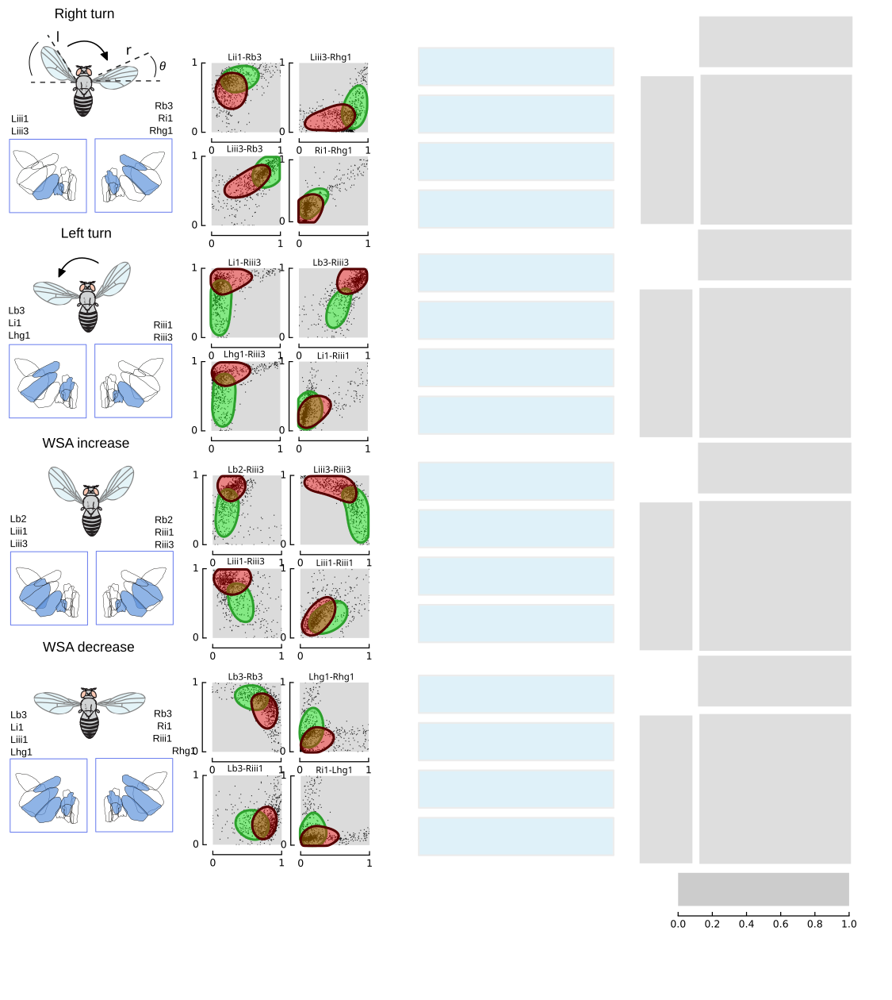

In [22]:
#lpf.make_scatter_plots(flylist[6])#,layout.axes_groups)

#layout = fifi.FigureLayout('layouts/scatter_anc_contour_layout.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v5.svg',make_mplfigures = True)




c_l = layout.pathspecs['lb-nu'].mplkwargs()['edgecolor']
c_r = layout.pathspecs['rb-nu'].mplkwargs()['edgecolor']


#make_scatter_plots(flylist[6],layout.axes_groups['none']['scatter_mtrx'])



ax2 = layout.axes['Lb3_Rb3']
scatter(flylist[6], ('Lb3'),('Rb3'), ax2)
#plot_sector(flylist,('left','b3'),('right','b3'),'nb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)#,ax2.set_xlabel('left b3',color = c_l),ax2.set_ylabel('right b3',color = c_r)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])


ax3 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Liii1'),('Rb3'), ax3)
#plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii1'),('right','b3'),'rb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii1'),('right','b3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
ax3.set_xbound(0,1),ax3.set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])

ax4 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax4)
#plot_sector(flylist,('left','iii3'),('right','hg1'),'nb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii3'),('right','hg1'),'rb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii3'),('right','hg1'),'lb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
ax4.set_xbound(0,1),ax4.set_ybound(0,1)#,ax4.set_xlabel('left b3',color = c_l),ax4.set_ylabel('right b3',color = c_r)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])

ax5 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax5)
#plot_sector(flylist,('left','iii3'),('right','b3'),'nb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii3'),('right','b3'),'rb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii3'),('right','b3'),'lb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
ax5.set_xbound(0,1),ax5.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax5.set_ylabel('right b3',color = c_r)
ax5.set_xticks([0,1])
ax5.set_yticks([0,1])

ax6 = layout.axes['Ri1_Rhg1']
scatter(flylist[6], ('Ri1'),('Rhg1'), ax6)
#plot_sector(flylist,('right','i1'),('right','hg1'),'nb-nu',ax6,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('right','i1'),('right','hg1'),'rb-nu',ax6,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('right','i1'),('right','hg1'),'lb-nu',ax6,layout.pathspecs,mode = 'kde',contours = True)
ax6.set_xbound(0,1),ax5.set_ybound(0,1)#,ax6.set_xlabel('left b3',color = c_l),ax6.set_ylabel('right b3',color = c_r)
ax6.set_xticks([0,1])
ax6.set_yticks([0,1])

ax7 = layout.axes['Li1_Riii3']
scatter(flylist[6], ('Li1'),('Riii3'), ax7)
#plot_sector(flylist,('left','i1'),('right','iii3'),'nb-nu',ax7,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','i1'),('right','iii3'),'rb-nu',ax7,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','i1'),('right','iii3'),'lb-nu',ax7,layout.pathspecs,mode = 'kde',contours = True)
ax7.set_xbound(0,1),ax7.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax7.set_xticks([0,1])
ax7.set_yticks([0,1])

ax8 = layout.axes['Lb3_Riii3']
scatter(flylist[6], ('Lb3'),('Riii3'), ax8)
#plot_sector(flylist,('left','b3'),('right','iii3'),'nb-nu',ax8,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b3'),('right','iii3'),'rb-nu',ax8,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b3'),('right','iii3'),'lb-nu',ax8,layout.pathspecs,mode = 'kde',contours = True)
ax8.set_xbound(0,1),ax8.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax8.set_xticks([0,1])
ax8.set_yticks([0,1])


ax9 = layout.axes['Lhg1_Riii3']
scatter(flylist[6], ('Lhg1'),('Riii3'), ax9)
#plot_sector(flylist,('left','hg1'),('right','iii3'),'nb-nu',ax9,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','hg1'),('right','iii3'),'rb-nu',ax9,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','hg1'),('right','iii3'),'lb-nu',ax9,layout.pathspecs,mode = 'kde',contours = True)
ax9.set_xbound(0,1),ax9.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax9.set_xticks([0,1])
ax9.set_yticks([0,1])

ax10 = layout.axes['Li1_Riii1']
scatter(flylist[6], ('Li1'),('Riii1'), ax10)
#plot_sector(flylist,('right','i1'),('right','iii1'),'nb-nu',ax10,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','i1'),('right','iii1'),'rb-nu',ax10,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','i1'),('right','iii1'),'lb-nu',ax10,layout.pathspecs,mode = 'kde',contours = True)
ax10.set_xbound(0,1),ax10.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax10.set_xticks([0,1])
ax10.set_yticks([0,1])


ax11 = layout.axes['Lb2_Riii3']
scatter(flylist[6], ('Lb2'),('Riii3'), ax11)
#plot_sector(flylist,('left','b2'),('right','iii3'),'nb-nu',ax11,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b2'),('right','iii3'),'rb-nu',ax11,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b2'),('right','iii3'),'lb-nu',ax11,layout.pathspecs,mode = 'kde',contours = True)
ax11.set_xbound(0,1),ax11.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax11.set_xticks([0,1])
ax11.set_yticks([0,1])

ax12 = layout.axes['Liii3_Riii3']
scatter(flylist[6], ('Liii3'),('Riii3'), ax12)
#plot_sector(flylist,('left','iii3'),('right','iii3'),'nb-nu',ax12,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii3'),('right','iii3'),'rb-nu',ax12,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii3'),('right','iii3'),'lb-nu',ax12,layout.pathspecs,mode = 'kde',contours = True)
ax12.set_xbound(0,1),ax12.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax12.set_xticks([0,1])
ax12.set_yticks([0,1])

ax13 = layout.axes['Liii1_Riii3']
scatter(flylist[6], ('Liii1'),('Riii3'), ax13)
#plot_sector(flylist,('left','iii1'),('right','iii3'),'nb-nu',ax13,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii1'),('right','iii3'),'rb-nu',ax13,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii1'),('right','iii3'),'lb-nu',ax13,layout.pathspecs,mode = 'kde',contours = True)
ax13.set_xbound(0,1),ax13.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax13.set_xticks([0,1])
ax13.set_yticks([0,1])

ax14 = layout.axes['Liii1_Riii1']
scatter(flylist[6], ('Liii1'),('Riii1'), ax14)
#plot_sector(flylist,('left','iii1'),('right','iii1'),'nb-nu',ax14,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii1'),('right','iii1'),'rb-nu',ax14,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','iii1'),('right','iii1'),'lb-nu',ax14,layout.pathspecs,mode = 'kde',contours = True)
ax14.set_xbound(0,1),ax14.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax14.set_xticks([0,1])
ax14.set_yticks([0,1])


ax15 = layout.axes['Lhg1_Rhg1']
scatter(flylist[6], ('Lhg1'),('Rhg1'), ax15)
#plot_sector(flylist,('left','hg1'),('right','hg1'),'nb-nu',ax15,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','hg1'),('right','hg1'),'rb-nu',ax15,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','hg1'),('right','hg1'),'lb-nu',ax15,layout.pathspecs,mode = 'kde',contours = True)
ax15.set_xbound(0,1),ax15.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax15.set_xticks([0,1])
ax15.set_yticks([0,1])

ax16 = layout.axes['Lb3_Riii1']
scatter(flylist[6], ('Lb3'),('Riii1'), ax16)
#plot_sector(flylist,('left','b3'),('right','iii1'),'nb-nu',ax16,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b3'),('right','iii1'),'rb-nu',ax16,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','b3'),('right','iii1'),'lb-nu',ax16,layout.pathspecs,mode = 'kde',contours = True)
ax16.set_xbound(0,1),ax16.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax16.set_xticks([0,1])
ax16.set_yticks([0,1])

ax17 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax17)
#plot_sector(flylist,('left','hg1'),('right','i1'),'nb-nu',ax17,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','hg1'),('right','i1'),'rb-nu',ax17,layout.pathspecs,mode = 'kde',contours = True)
plot_sector(flylist,('left','hg1'),('right','i1'),'lb-nu',ax17,layout.pathspecs,mode = 'kde',contours = True)
ax17.set_xbound(0,1),ax17.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
ax17.set_xticks([0,1])
ax17.set_yticks([0,1])




#ax18 = layout.axes['Lhg1_Ri1']
#scatter(flylist[6], ('Lhg1'),('Ri1'), ax18)
#plot_sector(flylist,('left','hg1'),('right','i1'),'nb-nu',ax17,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'rb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','b3'),'lb-nu',ax2,layout.pathspecs,mode = 'kde',contours = True)
#ax17.set_xbound(0,1),ax18.set_ybound(0,1)#,ax5.set_xlabel('left b3',color = c_l),ax7.set_ylabel('right b3',color = c_r)
#ax17.set_xticks([0,1])
#ax17.set_yticks([0,1])






'''
ax3 = layout.axes_groups['none']['expanded_inset']['Liii3_Riii3']
plot_sector(flylist,('left','iii3'),('right','iii3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','iii3'),('right','iii3'),'rb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','iii3'),('right','iii3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
ax3.set_xbound(0,1),ax3.set_ybound(0,1),ax3.set_xlabel('left iii3',color = c_l),ax3.set_ylabel('right iii3',color = c_r)

ax4 = layout.axes_groups['none']['expanded_inset']['Lb3_Riii3']
plot_sector(flylist,('left','b3'),('right','iii3'),'nb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','iii3'),'rb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','b3'),('right','iii3'),'lb-nu',ax4,layout.pathspecs,mode = 'kde',contours = True)
ax4.set_xbound(0,1),ax4.set_ybound(0,1),ax4.set_xlabel('left b3',color = c_l),ax4.set_ylabel('right iii3',color = c_r)

ax5 = layout.axes_groups['none']['expanded_inset']['Ri1_Lhg1']
plot_sector(flylist,('left','hg1'),('right','i1'),'nb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','hg1'),('right','i1'),'rb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
#plot_sector(flylist,('left','hg1'),('right','i1'),'lb-nu',ax5,layout.pathspecs,mode = 'kde',contours = True)
ax5.set_xbound(0,1),ax5.set_ybound(0,1),ax5.set_xlabel('left hg1',color = c_l),ax5.set_ylabel('right i1',color = c_r)
'''

fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v2.svg')
plt.close('all')
display(SVG('figure_05_v2.svg'))

In [22]:
#Normalized Data
#normalized = (x-min(x))/(max(x)-min(x))

def normd (muscle_data):
    x = muscle_data
    normalized = (x-min(x))/(max(x)-min(x))
    return normalized

In [ ]:
print(2)

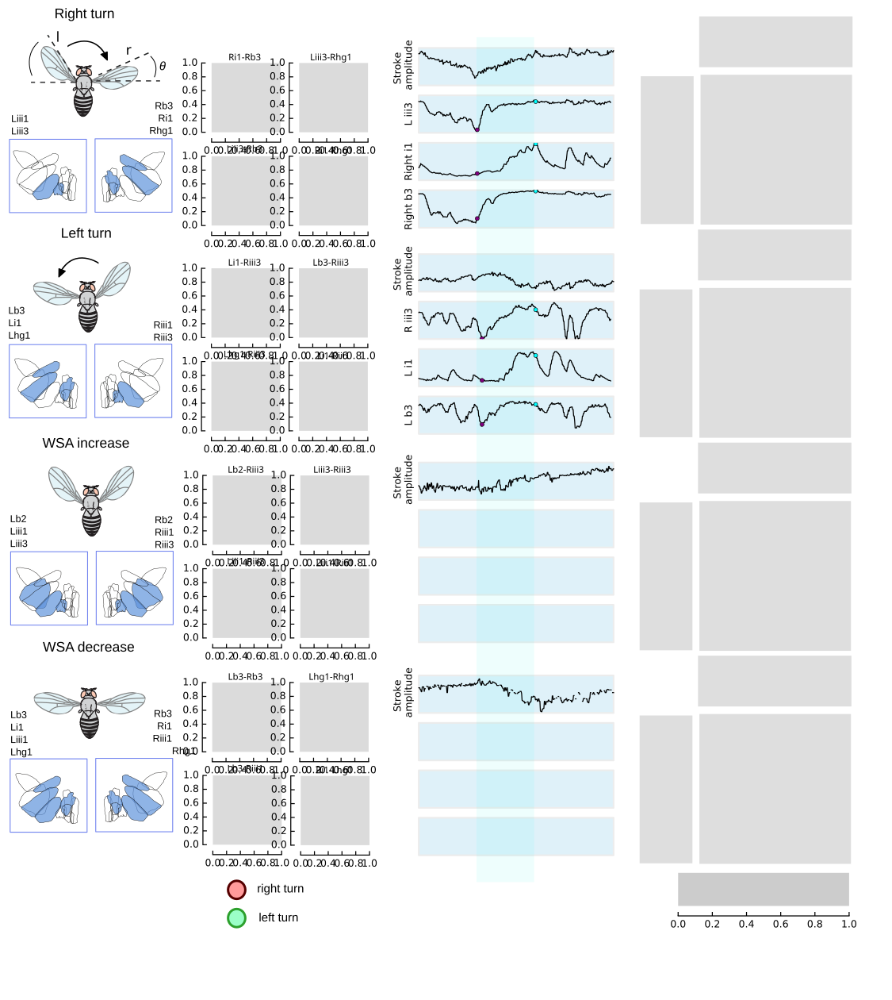

In [22]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi

#layout = fifi.FigureLayout('paper_figure_1_v2.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v5.svg',make_mplfigures = True)

#layout.axes['yaw_left'].plot(time, mean_WBA) #,'o',alpha = 0.2)
#layout.axes['yaw_left'].fill_between(time, (mean_WBA-error), (mean_WBA + error),alpha = 0.1)

#layout.axes['yaw_right'].plot(time, mean_WBA_turn_right) #,'o',alpha = 0.2)
#layout.axes['yaw_right'].fill_between(time, (mean_WBA_turn_right-error_turn_right), (mean_WBA_turn_right + error_turn_right),alpha = 0.1)


fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]


times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

'''
layout.axes['l_wsa'].plot(times,l_deg,clip_on = False,color = 'k')
layout.axes['l_wsa'].set_xbound(0,times[-1])
layout.axes['l_wsa'].set_ylabel('left \n amplitude')
layout.axes['l_wsa'].patch.set_alpha(0.0)
layout.axes['l_wsa'].set_ybound(20,40)
layout.axes['l_wsa'].set_yticks([20, 30, 40])
#layout.axes['l_wsa'].set_ybound(-15,15)
#layout.axes['l_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

layout.axes['r_wsa'].plot(times,r_deg,clip_on = False,color = 'k')
layout.axes['r_wsa'].set_xbound(0,times[-1])
layout.axes['r_wsa'].set_ylabel('right \n amplitude')
layout.axes['r_wsa'].patch.set_alpha(0.0)
layout.axes['r_wsa'].set_ybound(20,40)
layout.axes['r_wsa'].set_yticks([20, 30, 40])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

'''

layout.axes['lmr_rt'].plot(times,lmr,clip_on = False,color = 'k')
layout.axes['lmr_rt'].set_xbound(0,times[-1])
layout.axes['lmr_rt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_rt'].patch.set_alpha(0.0)
layout.axes['lmr_rt'].set_ybound(-20,20)
layout.axes['lmr_rt'].set_yticks([-15, 0, 15])

layout.axes['liii1_rt'].plot(times,iii3l,clip_on = False,color = 'k')
layout.axes['liii1_rt'].set_xbound(0,times[-1])
layout.axes['liii1_rt'].set_ylabel('L iii3')
layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
#layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].plot(times[240],iii3l[240],'cyan', marker='o', markersize=4)#, 'o') 



layout.axes['ri1_rt'].plot(times,i1r,clip_on = False,color = 'k')
layout.axes['ri1_rt'].set_xbound(0,times[-1])
layout.axes['ri1_rt'].set_ylabel('Right i1')
layout.axes['ri1_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['ri1_rt'].plot(times[120],i1r[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['ri1_rt'].plot(times[240],i1r[240],'cyan', marker='o', markersize=4)#, 'o') 



layout.axes['rb3_rt'].plot(times,b3r,clip_on = False,color = 'k')
layout.axes['rb3_rt'].set_xbound(0,times[-1])
layout.axes['rb3_rt'].set_ylabel('Right b3')
layout.axes['rb3_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['rb3_rt'].plot(times[120],b3r[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].plot(times[240],b3r[240],'cyan', marker='o', markersize=4)#, 'o') 



#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


##write the clips out here and use the derivative to get the signals 



## plot each segment

#---------------------------------------------------------------------------------------


fly = flylist[6]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]



layout.axes['lmr_lt'].plot(times,lmr,clip_on = False,color = 'k')
layout.axes['lmr_lt'].set_xbound(0,times[-1])
layout.axes['lmr_lt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_lt'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].set_ybound(-20,20)
layout.axes['lmr_lt'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


layout.axes['riii3_lt'].plot(times,iii3r,clip_on = False,color = 'k')
layout.axes['riii3_lt'].set_xbound(0,times[-1])
layout.axes['riii3_lt'].set_ylabel('R iii3')
layout.axes['riii3_lt'].patch.set_alpha(0.0)
layout.axes['riii3_lt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['riii3_lt'].plot(times[130],iii3r[130],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['riii3_lt'].plot(times[240],iii3r[240],'cyan', marker='o', markersize=4)#, 'o') 


layout.axes['li1_lt'].plot(times,i1l,clip_on = False,color = 'k')
layout.axes['li1_lt'].set_xbound(0,times[-1])
layout.axes['li1_lt'].set_ylabel('L i1')
layout.axes['li1_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['li1_lt'].plot(times[130],i1l[130],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].plot(times[240],i1l[240],'cyan', marker='o', markersize=4)#, 'o') 

layout.axes['lb3_lt'].plot(times,b3l,clip_on = False,color = 'k')
layout.axes['lb3_lt'].set_xbound(0,times[-1])
layout.axes['lb3_lt'].set_ylabel('L b3')
layout.axes['lb3_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_lt'].plot(times[130],b3l[130],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].plot(times[240],b3l[240],'cyan', marker='o', markersize=4)#, 'o') 






#---------------------------------------------------------------------------------------




fly = flylist[3]
snum = 1  #5


l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]


times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

layout.axes['lpr_WSAi'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAi'].set_xbound(0,times[-1])
layout.axes['lpr_WSAi'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAi'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAi'].set_ybound(-20,20)
#layout.axes['lpr_WSAi'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)



#---------------------------------------------------------------------------------------

fly = flylist[1]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)



layout.axes['lpr_WSAd'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAd'].set_xbound(0,times[-1])
layout.axes['lpr_WSAd'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAd'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAd'].set_ybound(-20,20)
#layout.axes['lpr_WSAd'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)




fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v3.svg')
plt.close('all')
display(SVG('figure_05_v3.svg'))



### cool color scheme 


In [23]:
len(times)

395

In [47]:
times[394]

7.8799999999999999

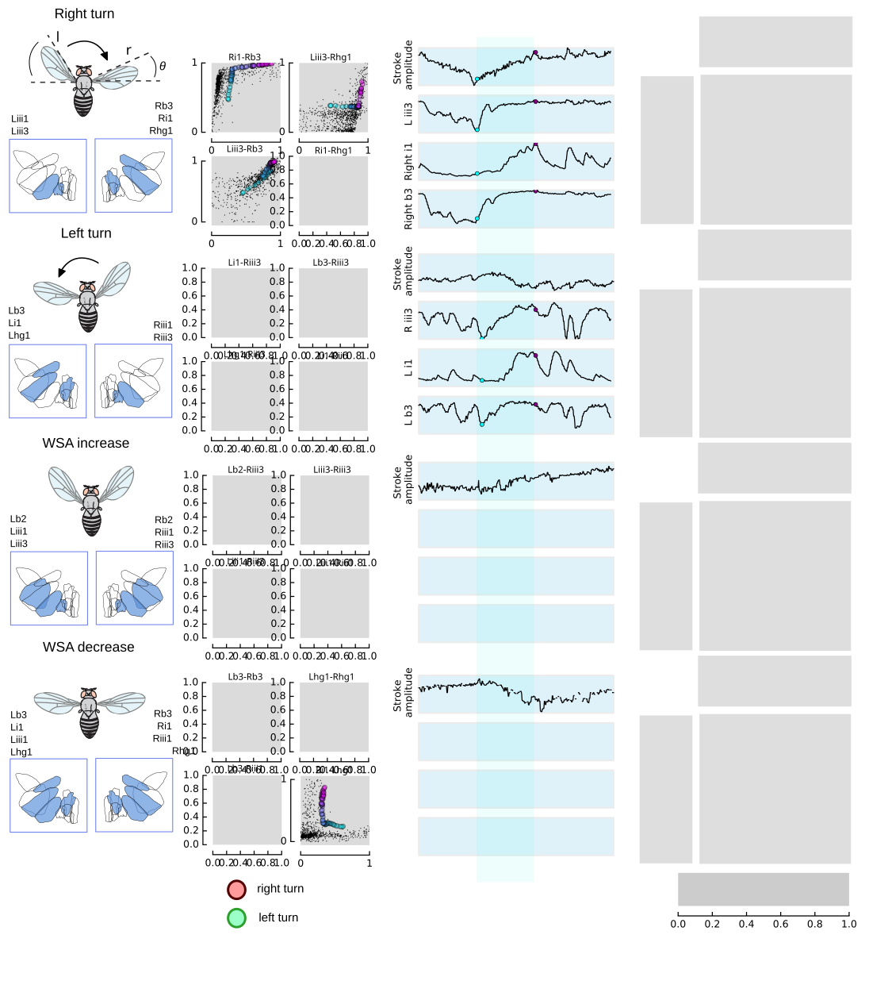

In [121]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi

#layout = fifi.FigureLayout('paper_figure_1_v2.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v5.svg',make_mplfigures = True)

#layout.axes['yaw_left'].plot(time, mean_WBA) #,'o',alpha = 0.2)
#layout.axes['yaw_left'].fill_between(time, (mean_WBA-error), (mean_WBA + error),alpha = 0.1)

#layout.axes['yaw_right'].plot(time, mean_WBA_turn_right) #,'o',alpha = 0.2)
#layout.axes['yaw_right'].fill_between(time, (mean_WBA_turn_right-error_turn_right), (mean_WBA_turn_right + error_turn_right),alpha = 0.1)

import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd






fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]


times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

'''
layout.axes['l_wsa'].plot(times,l_deg,clip_on = False,color = 'k')
layout.axes['l_wsa'].set_xbound(0,times[-1])
layout.axes['l_wsa'].set_ylabel('left \n amplitude')
layout.axes['l_wsa'].patch.set_alpha(0.0)
layout.axes['l_wsa'].set_ybound(20,40)
layout.axes['l_wsa'].set_yticks([20, 30, 40])
#layout.axes['l_wsa'].set_ybound(-15,15)
#layout.axes['l_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

layout.axes['r_wsa'].plot(times,r_deg,clip_on = False,color = 'k')
layout.axes['r_wsa'].set_xbound(0,times[-1])
layout.axes['r_wsa'].set_ylabel('right \n amplitude')
layout.axes['r_wsa'].patch.set_alpha(0.0)
layout.axes['r_wsa'].set_ybound(20,40)
layout.axes['r_wsa'].set_yticks([20, 30, 40])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

'''

layout.axes['lmr_rt'].plot(times,lmr,clip_on = False,color = 'k')
layout.axes['lmr_rt'].set_xbound(0,times[-1])
layout.axes['lmr_rt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_rt'].patch.set_alpha(0.0)
layout.axes['lmr_rt'].set_ybound(-20,20)
layout.axes['lmr_rt'].set_yticks([-15, 0, 15])
layout.axes['lmr_rt'].plot(times[120],lmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_rt'].plot(times[240],lmr[240],'purple', marker='o', markersize=4)#, 'o') 



layout.axes['liii1_rt'].plot(times,iii3l,clip_on = False,color = 'k')
layout.axes['liii1_rt'].set_xbound(0,times[-1])
layout.axes['liii1_rt'].set_ylabel('L iii3')
layout.axes['liii1_rt'].plot(times[120],iii3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
#layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].plot(times[240],iii3l[240],'purple', marker='o', markersize=4)#, 'o') 

#x = list(pitch_down_new_df['muscles'])
c_r = times[120:240]
Min = times[119]
Max = times[241]             
x = i1r[120:240]
y = b3r[120:240]
df= pd.DataFrame({"x":x,"y":y,"c":c_r})
cmap = plt.cm.cool
norm = matplotlib.colors.Normalize(vmin=Min, vmax=Max)

ax1 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Ri1'),('Rb3'), ax1)
c = ax1.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
#plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
########layout.axes['Liii1_Rb3'].plot(df.x, df.y, color=cmap(norm(df.c.values)), marker = 'o', markersize=2)
#plot_sector(flylist,('left','iii1'),('right','b3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
layout.axes['Liii1_Rb3'].set_xbound(0,1),layout.axes['Liii1_Rb3'].set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
layout.axes['Liii1_Rb3'].set_xticks([0,1])
layout.axes['Liii1_Rb3'].set_yticks([0,1])                

x = iii3l[120:240]
y = hg1r[120:240]
ax2 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax2)
c = ax2.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])                
                
x = iii3l[120:240]
y = b3r[120:240]
ax3 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax3)
c = ax3.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax3.set_xbound(0,1),ax2.set_ybound(0,1)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])  


x = hg1l[120:240]
y = i1r[120:240]
ax4 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax4)
c = ax4.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax4.set_xbound(0,1),ax2.set_ybound(0,1)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])  



            

layout.axes['ri1_rt'].plot(times,i1r,clip_on = False,color = 'k')
layout.axes['ri1_rt'].set_xbound(0,times[-1])
layout.axes['ri1_rt'].set_ylabel('Right i1')
layout.axes['ri1_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['ri1_rt'].plot(times[120],i1r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['ri1_rt'].plot(times[240],i1r[240],'purple', marker='o', markersize=4)#, 'o') 



layout.axes['rb3_rt'].plot(times,b3r,clip_on = False,color = 'k')
layout.axes['rb3_rt'].set_xbound(0,times[-1])
layout.axes['rb3_rt'].set_ylabel('Right b3')
layout.axes['rb3_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['rb3_rt'].plot(times[120],b3r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].plot(times[240],b3r[240],'purple', marker='o', markersize=4)#, 'o') 



#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


##write the clips out here and use the derivative to get the signals 



## plot each segment




fly = flylist[6]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]



layout.axes['lmr_lt'].plot(times,lmr,clip_on = False,color = 'k')
layout.axes['lmr_lt'].set_xbound(0,times[-1])
layout.axes['lmr_lt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_lt'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].set_ybound(-20,20)
layout.axes['lmr_lt'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


layout.axes['riii3_lt'].plot(times,iii3r,clip_on = False,color = 'k')
layout.axes['riii3_lt'].set_xbound(0,times[-1])
layout.axes['riii3_lt'].set_ylabel('R iii3')
layout.axes['riii3_lt'].patch.set_alpha(0.0)
layout.axes['riii3_lt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['riii3_lt'].plot(times[130],iii3r[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['riii3_lt'].plot(times[240],iii3r[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['li1_lt'].plot(times,i1l,clip_on = False,color = 'k')
layout.axes['li1_lt'].set_xbound(0,times[-1])
layout.axes['li1_lt'].set_ylabel('L i1')
layout.axes['li1_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['li1_lt'].plot(times[130],i1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].plot(times[240],i1l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['lb3_lt'].plot(times,b3l,clip_on = False,color = 'k')
layout.axes['lb3_lt'].set_xbound(0,times[-1])
layout.axes['lb3_lt'].set_ylabel('L b3')
layout.axes['lb3_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_lt'].plot(times[130],b3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].plot(times[240],b3l[240],'purple', marker='o', markersize=4)#, 'o') 











fly = flylist[3]
snum = 1  #5


l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]


times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

layout.axes['lpr_WSAi'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAi'].set_xbound(0,times[-1])
layout.axes['lpr_WSAi'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAi'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAi'].set_ybound(-20,20)
#layout.axes['lpr_WSAi'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)



fly = flylist[1]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)



layout.axes['lpr_WSAd'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAd'].set_xbound(0,times[-1])
layout.axes['lpr_WSAd'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAd'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAd'].set_ybound(-20,20)
#layout.axes['lpr_WSAd'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)




fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v4.svg')
plt.close('all')
display(SVG('figure_05_v4.svg'))





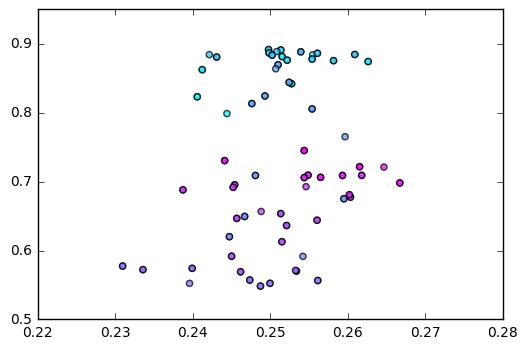

In [108]:
### cool color scheme 

import numpy as np
import matplotlib.pyplot as plt


x = iii1l[120:240]
y = b3r[120:240]
colors = times[120:240]
fig = plt.figure()
ax = fig.add_subplot(111)
c = ax.scatter(x, y, c=colors, cmap='cool', alpha=0.75)


'''
c_r = times[120:240]
Min = times[119]
Max = times[241]             
x = iii1l[120:240]
y = b3r[120:240]

df= pd.DataFrame({"x":x,"y":y,"c":c_r})
cmap = plt.cm.cool
norm = matplotlib.colors.Normalize(vmin=Min, vmax=Max)

print(len(x))

print(len(y))

print(len(c_r))

'''


#plt.plot(df.x, df.y, color=cmap(norm(df.c.values)), marker = 'o', markersize=2)
plt.show()

/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:28: RuntimeWarning: invalid value encountered in power


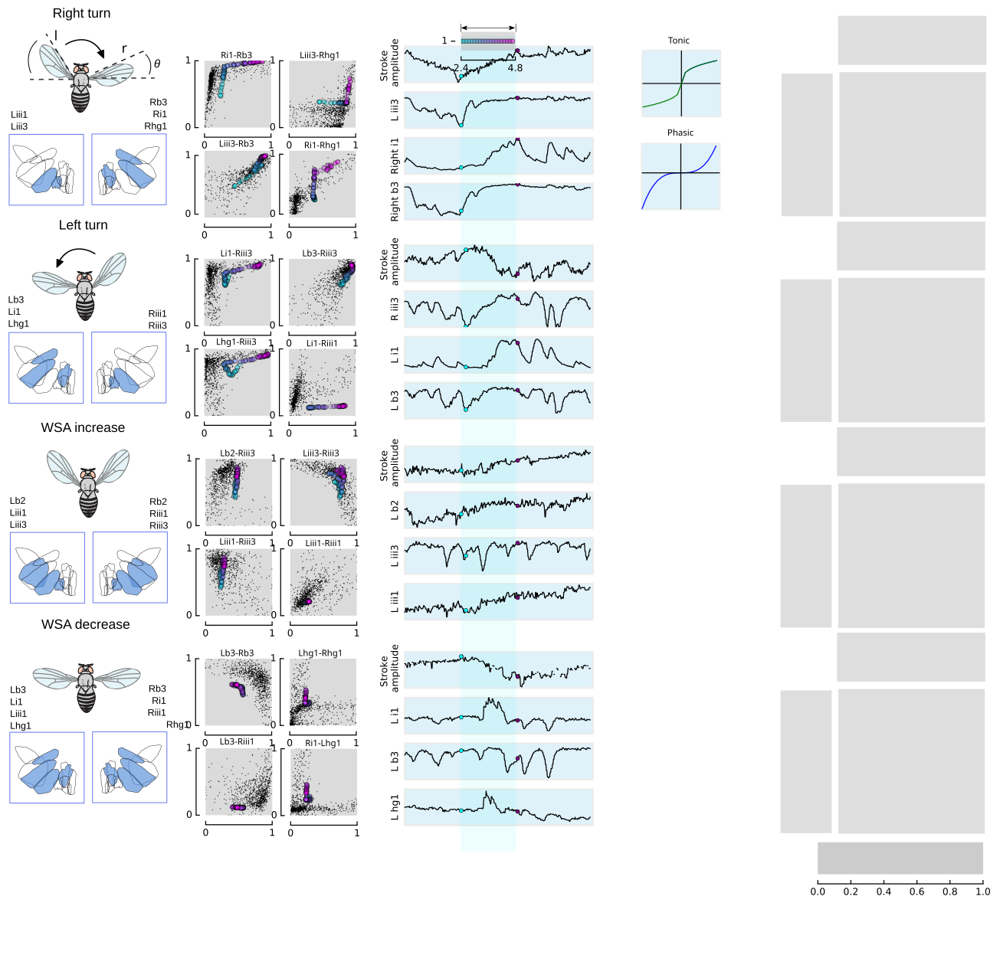

In [64]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi

#layout = fifi.FigureLayout('paper_figure_1_v2.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v6.svg',make_mplfigures = True)

#layout.axes['yaw_left'].plot(time, mean_WBA) #,'o',alpha = 0.2)
#layout.axes['yaw_left'].fill_between(time, (mean_WBA-error), (mean_WBA + error),alpha = 0.1)

#layout.axes['yaw_right'].plot(time, mean_WBA_turn_right) #,'o',alpha = 0.2)
#layout.axes['yaw_right'].fill_between(time, (mean_WBA_turn_right-error_turn_right), (mean_WBA_turn_right + error_turn_right),alpha = 0.1)

import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd



x = np.arange(-10,10)
layout.axes['phasic'].plot(x, x**3)
layout.axes['tonic'].plot(x, x** (1. / 3))
layout.axes['phasic'].set_xbound(-10, 10)
layout.axes['tonic'].set_xbound(-10, 10)
layout.axes['tonic'].axhline(y=0, color='k')
layout.axes['tonic'].axvline(x=0, color='k')
layout.axes['phasic'].axhline(y=0, color='k')
layout.axes['phasic'].axvline(x=0, color='k')
#layout.axes['phasic'].set_ybound(-10, 10)
layout.axes['tonic'].set_ybound([-3, 3])
layout.axes['tonic'].plot(x, np.cbrt(x))




fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]

times = np.arange(len(x))*0.02
colors = times[120:240]


x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

'''
layout.axes['l_wsa'].plot(times,l_deg,clip_on = False,color = 'k')
layout.axes['l_wsa'].set_xbound(0,times[-1])
layout.axes['l_wsa'].set_ylabel('left \n amplitude')
layout.axes['l_wsa'].patch.set_alpha(0.0)
layout.axes['l_wsa'].set_ybound(20,40)
layout.axes['l_wsa'].set_yticks([20, 30, 40])
#layout.axes['l_wsa'].set_ybound(-15,15)
#layout.axes['l_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

layout.axes['r_wsa'].plot(times,r_deg,clip_on = False,color = 'k')
layout.axes['r_wsa'].set_xbound(0,times[-1])
layout.axes['r_wsa'].set_ylabel('right \n amplitude')
layout.axes['r_wsa'].patch.set_alpha(0.0)
layout.axes['r_wsa'].set_ybound(20,40)
layout.axes['r_wsa'].set_yticks([20, 30, 40])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

'''

layout.axes['lmr_rt'].plot(times,lmr,clip_on = False,color = 'k')
layout.axes['lmr_rt'].set_xbound(0,times[-1])
layout.axes['lmr_rt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_rt'].patch.set_alpha(0.0)
layout.axes['lmr_rt'].set_ybound(-20,20)
layout.axes['lmr_rt'].set_yticks([-15, 0, 15])
layout.axes['lmr_rt'].plot(times[120],lmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_rt'].plot(times[240],lmr[240],'purple', marker='o', markersize=4)#, 'o') 
#ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
layout.axes['lmr_rt'].set_xticks([times[120],times[240]])


layout.axes['liii1_rt'].plot(times,iii3l,clip_on = False,color = 'k')
layout.axes['liii1_rt'].set_xbound(0,times[-1])
layout.axes['liii1_rt'].set_ylabel('L iii3')
layout.axes['liii1_rt'].plot(times[120],iii3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
#layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].plot(times[240],iii3l[240],'purple', marker='o', markersize=4)#, 'o') 

#x = list(pitch_down_new_df['muscles'])
c_r = times[120:240]
Min = times[119]
Max = times[241]             
x = i1r[120:240]
y = b3r[120:240]
df= pd.DataFrame({"x":x,"y":y,"c":c_r})
cmap = plt.cm.cool
norm = matplotlib.colors.Normalize(vmin=Min, vmax=Max)

ax1 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Ri1'),('Rb3'), ax1)
c = ax1.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
#plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
########layout.axes['Liii1_Rb3'].plot(df.x, df.y, color=cmap(norm(df.c.values)), marker = 'o', markersize=2)
#plot_sector(flylist,('left','iii1'),('right','b3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
layout.axes['Liii1_Rb3'].set_xbound(0,1),layout.axes['Liii1_Rb3'].set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
layout.axes['Liii1_Rb3'].set_xticks([0,1])
layout.axes['Liii1_Rb3'].set_yticks([0,1])                

x = iii3l[120:240]
y = hg1r[120:240]
ax2 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax2)
c = ax2.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])                
                
x = iii3l[120:240]
y = b3r[120:240]
ax3 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax3)
c = ax3.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax3.set_xbound(0,1),ax2.set_ybound(0,1)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])  


x = hg1r[120:240]
y = i1r[120:240]
ax4 = layout.axes['Ri1_Rhg1']
scatter(flylist[6], ('Ri1'),('Rhg1'), ax4)
c = ax4.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax4.set_xbound(0,1),ax2.set_ybound(0,1)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])  



            

layout.axes['ri1_rt'].plot(times,i1r,clip_on = False,color = 'k')
layout.axes['ri1_rt'].set_xbound(0,times[-1])
layout.axes['ri1_rt'].set_ylabel('Right i1')
layout.axes['ri1_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['ri1_rt'].plot(times[120],i1r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['ri1_rt'].plot(times[240],i1r[240],'purple', marker='o', markersize=4)#, 'o') 



layout.axes['rb3_rt'].plot(times,b3r,clip_on = False,color = 'k')
layout.axes['rb3_rt'].set_xbound(0,times[-1])
layout.axes['rb3_rt'].set_ylabel('Right b3')
layout.axes['rb3_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['rb3_rt'].plot(times[120],b3r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].plot(times[240],b3r[240],'purple', marker='o', markersize=4)#, 'o') 



#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


##write the clips out here and use the derivative to get the signals 



## plot each segment

#----------------------------------------------------------------------


fly = flylist[6]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]



layout.axes['lmr_lt'].plot(times,lmr,clip_on = False,color = 'k')
layout.axes['lmr_lt'].set_xbound(0,times[-1])
layout.axes['lmr_lt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_lt'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].set_ybound(-20,20)
layout.axes['lmr_lt'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].plot(times[130],lmr[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_lt'].plot(times[240],lmr[240],'purple', marker='o', markersize=4)#, 'o') 


x = i1l[120:240]
y = iii3r[120:240]
ax5 = layout.axes['Li1_Riii3']
scatter(flylist[6], ('Li1'),('Riii3'), ax5)
c = ax5.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax5.set_xbound(0,1),ax5.set_ybound(0,1)
ax5.set_xticks([0,1])
ax5.set_yticks([0,1])                
                


x = b3l[120:240]
y = iii3r[120:240]
ax6 = layout.axes['Lb3_Riii3']
scatter(flylist[6], ('Lb3'),('Riii3'), ax6)
c = ax6.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax6.set_xbound(0,1),ax6.set_ybound(0,1)
ax6.set_xticks([0,1])
ax6.set_yticks([0,1])                
                               
                
x = hg1l[120:240]
y = iii3r[120:240]
ax7 = layout.axes['Lhg1_Riii3']
scatter(flylist[6], ('Lhg1'),('Riii3'), ax7)
c = ax7.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax7.set_xbound(0,1),ax7.set_ybound(0,1)
ax7.set_xticks([0,1])
ax7.set_yticks([0,1])  


x = i1l[120:240]
y = iii1r[120:240]
ax8 = layout.axes['Li1_Riii1']
scatter(flylist[6], ('Li1'),('Riii1'), ax8)
c = ax8.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax8.set_xbound(0,1),ax8.set_ybound(0,1)
ax8.set_xticks([0,1])
ax8.set_yticks([0,1])  



layout.axes['riii3_lt'].plot(times,iii3r,clip_on = False,color = 'k')
layout.axes['riii3_lt'].set_xbound(0,times[-1])
layout.axes['riii3_lt'].set_ylabel('R iii3')
layout.axes['riii3_lt'].patch.set_alpha(0.0)
layout.axes['riii3_lt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['riii3_lt'].plot(times[130],iii3r[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['riii3_lt'].plot(times[240],iii3r[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['li1_lt'].plot(times,i1l,clip_on = False,color = 'k')
layout.axes['li1_lt'].set_xbound(0,times[-1])
layout.axes['li1_lt'].set_ylabel('L i1')
layout.axes['li1_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['li1_lt'].plot(times[130],i1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].plot(times[240],i1l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['lb3_lt'].plot(times,b3l,clip_on = False,color = 'k')
layout.axes['lb3_lt'].set_xbound(0,times[-1])
layout.axes['lb3_lt'].set_ylabel('L b3')
layout.axes['lb3_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_lt'].plot(times[130],b3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].plot(times[240],b3l[240],'purple', marker='o', markersize=4)#, 'o') 





#____________________________________________________________________





fly = flylist[3]
snum = 1  #5


l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

layout.axes['lpr_WSAi'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAi'].set_xbound(0,times[-1])
layout.axes['lpr_WSAi'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAi'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAi'].set_ybound(-20,20)
#layout.axes['lpr_WSAi'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAi'].plot(times[120],lpr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAi'].plot(times[240],lpr[240],'purple', marker='o', markersize=4)#, 'o') 




x = b2l[120:240]
y = iii3r[120:240]
ax9 = layout.axes['Lb2_Riii3']
scatter(flylist[6], ('Lb2'),('Riii3'), ax9)
c = ax9.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax9.set_xbound(0,1),ax9.set_ybound(0,1)
ax9.set_xticks([0,1])
ax9.set_yticks([0,1])                
                


x = iii3l[120:240]
y = iii3r[120:240]
ax10 = layout.axes['Liii3_Riii3']
scatter(flylist[6], ('Liii3'),('Riii3'), ax10)
c = ax10.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax10.set_xbound(0,1),ax10.set_ybound(0,1)
ax10.set_xticks([0,1])
ax10.set_yticks([0,1])                
                               
                
x = iii1l[120:240]
y = iii3r[120:240]
ax11 = layout.axes['Liii1_Riii3']
scatter(flylist[6], ('Liii1'),('Riii3'), ax11)
c = ax11.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax11.set_xbound(0,1),ax11.set_ybound(0,1)
ax11.set_xticks([0,1])
ax11.set_yticks([0,1])  


x = iii1l[120:240]
y = iii1r[120:240]
ax12 = layout.axes['Liii1_Riii1']
scatter(flylist[6], ('Liii1'),('Riii1'), ax12)
c = ax12.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax12.set_xbound(0,1),ax12.set_ybound(0,1)
ax12.set_xticks([0,1])
ax12.set_yticks([0,1])  



layout.axes['lb2_WSAi'].plot(times,b2l,clip_on = False,color = 'k')
layout.axes['lb2_WSAi'].set_xbound(0,times[-1])
layout.axes['lb2_WSAi'].set_ylabel('L b2')
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['lb2_WSAi'].plot(times[120],b2l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb2_WSAi'].plot(times[240],b2l[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['liii3_WSAi'].plot(times,iii3l,clip_on = False,color = 'k')
layout.axes['liii3_WSAi'].set_xbound(0,times[-1])
layout.axes['liii3_WSAi'].set_ylabel('L iii3')
layout.axes['liii3_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii3_WSAi'].plot(times[130],iii3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii3_WSAi'].plot(times[240],iii3l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['liii1_WSAi'].plot(times,iii1l,clip_on = False,color = 'k')
layout.axes['liii1_WSAi'].set_xbound(0,times[-1])
layout.axes['liii1_WSAi'].set_ylabel('L iii1')
layout.axes['liii1_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii1_WSAi'].plot(times[130],iii1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_WSAi'].plot(times[240],iii1l[240],'purple', marker='o', markersize=4)#, 'o') 









#____________________________________________________________________________

fly = flylist[1]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]


layout.axes['lpr_WSAd'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAd'].set_xbound(0,times[-1])
layout.axes['lpr_WSAd'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAd'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAd'].set_ybound(-20,20)
#layout.axes['lpr_WSAd'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAd'].plot(times[120],lpr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAd'].plot(times[240],lpr[240],'purple', marker='o', markersize=4)#, 'o') 




x = b3l[120:240]
y = b3r[120:240]
ax13 = layout.axes['Lb3_Rb3']
scatter(flylist[6], ('Lb3'),('Rb3'), ax13)
c = ax13.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax13.set_xbound(0,1),ax13.set_ybound(0,1)
ax13.set_xticks([0,1])
ax13.set_yticks([0,1])                
                


x = hg1l[120:240]
y = hg1r[120:240]
ax14 = layout.axes['Lhg1_Rhg1']
scatter(flylist[6], ('Lhg1'),('Rhg1'), ax14)
c = ax14.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax14.set_xbound(0,1),ax14.set_ybound(0,1)
ax14.set_xticks([0,1])
ax14.set_yticks([0,1])                
                               
                
x = b3l[120:240]
y = iii1r[120:240]
ax15 = layout.axes['Lb3_Riii1']
scatter(flylist[6], ('Lb3'),('Riii1'), ax15)
c = ax15.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax15.set_xbound(0,1),ax15.set_ybound(0,1)
ax15.set_xticks([0,1])
ax15.set_yticks([0,1])  


x = hg1l[120:240]
y = i1r[120:240]
ax16 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax16)
c = ax16.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax16.set_xbound(0,1),ax16.set_ybound(0,1)
ax16.set_xticks([0,1])
ax16.set_yticks([0,1])  


x = times[120:240]
y = np.ones(20)
ax17 = layout.axes['cmap_legend']
x_prime = x[::6]
colors = x_prime
c = ax17.scatter(x_prime, y, c=colors, cmap='cool', alpha=0.45)
ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
ax17.set_xticks([times[120],times[240]])
#ax17.set_xticks([])
#ax17.tick_params(axis=u'none', which=u'none',length=0)
ax17.set_yticks([1])  



layout.axes['li1_WSAd'].plot(times,i1l,clip_on = False,color = 'k')
layout.axes['li1_WSAd'].set_xbound(0,times[-1])
layout.axes['li1_WSAd'].set_ylabel('L i1')
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['li1_WSAd'].plot(times[120],i1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_WSAd'].plot(times[240],i1l[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['lb3_WSAd'].plot(times,b3l,clip_on = False,color = 'k')
layout.axes['lb3_WSAd'].set_xbound(0,times[-1])
layout.axes['lb3_WSAd'].set_ylabel('L b3')
layout.axes['lb3_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_WSAd'].plot(times[120],b3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_WSAd'].plot(times[240],b3l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['lhg1_WSAd'].plot(times,hg1l,clip_on = False,color = 'k')
layout.axes['lhg1_WSAd'].set_xbound(0,times[-1])
layout.axes['lhg1_WSAd'].set_ylabel('L hg1')
layout.axes['lhg1_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lhg1_WSAd'].plot(times[120],hg1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lhg1_WSAd'].plot(times[240],hg1l[240],'purple', marker='o', markersize=4)#, 'o') 









fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v6_.svg')
plt.close('all')
display(SVG('figure_05_v6_.svg'))




In [ ]:
yaw_right
yaw_left
pitch_up
pitch_down
roll_cw
roll_ccw


In [52]:
yaw_left = multi_fly_df.loc[multi_fly_df['stimulus']== 'yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
yaw_right = multi_fly_df.loc[multi_fly_df['stimulus']== 'yaw_right, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_up = multi_fly_df.loc[multi_fly_df['stimulus']== 'pitch_up_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
pitch_down = multi_fly_df.loc[multi_fly_df['stimulus']== 'pitch_down_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_cw = multi_fly_df.loc[multi_fly_df['stimulus']== 'roll_clockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
roll_ccw = multi_fly_df.loc[multi_fly_df['stimulus']== 'roll_counterclockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']



In [53]:
yaw_left_a = yaw_left.loc[yaw_left['experimental_condition']== 'condition=test']
yaw_right_a = yaw_right.loc[yaw_right['experimental_condition']== 'condition=test']
pitch_up_a = pitch_up.loc[pitch_up['experimental_condition']== 'condition=test']
pitch_down_a = pitch_down.loc[pitch_down['experimental_condition']== 'condition=test']
roll_cw_a = roll_cw.loc[roll_cw['experimental_condition']== 'condition=test']
roll_ccw_a = roll_ccw.loc[roll_ccw['experimental_condition']== 'condition=test']




In [54]:

####Yaw right

repeats = range(3)
i = 0

db1l = pd.DataFrame()
db1r= pd.DataFrame()
db2l=pd.DataFrame()
db2r=pd.DataFrame()
db3l=pd.DataFrame()
db3r=pd.DataFrame()
di1l=pd.DataFrame()
di1r=pd.DataFrame()
di2l=pd.DataFrame()
di2r=pd.DataFrame()
diii1l= pd.DataFrame()
diii1r=pd.DataFrame()
diii3l=pd.DataFrame()
diii3r=pd.DataFrame()
dhg1l=pd.DataFrame()
dhg1r=pd.DataFrame()
dhg2l=pd.DataFrame()
dhg2r=pd.DataFrame()
dhg3l=pd.DataFrame()
dhg3r=pd.DataFrame()
dhg4l=pd.DataFrame()
dhg4r=pd.DataFrame()
dlmr= pd.DataFrame()

for fly in flylist:
    for snum in repeats:
        
        l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        
        b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
        b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

        b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
        b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

        b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
        b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

        i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
        i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

        i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
        i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

        iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
        iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

        iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
        iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

        hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
        hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

        hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
        hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

        hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
        hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

        hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
        hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]
        
        lmr_prime = np.rad2deg((l-r)/10 *2*np.pi)
        
        
        db1l[i] = b1l
        db1r[i]= b1r
        db2l[i]=b2l
        db2r[i]=b2r
        db3l[i]=b3l
        db3r[i]=b3r
        di1l[i]=i1l
        di1r[i]=i1r
        di2l[i]=i2l
        di2r[i]=i2r
        diii1l[i]= iii1l
        diii1r[i]=iii1r
        diii3l[i]=iii3l
        diii3r[i]=iii3r
        dhg1l[i]=hg1l
        dhg1r[i]=hg1r
        dhg2l[i]=hg2l
        dhg2r[i]=hg2r
        dhg3l[i]=hg3l
        dhg3r[i]=hg3r
        dhg4l[i]=hg4l
        dhg4r[i]=hg4r
        dlmr[i] = lmr_prime
        
        i+= 1

db1l = db1l.fillna(0)
db1r= db1r.fillna(0)
db2l=db2l.fillna(0)
db2r=db2r.fillna(0)
db3l=db3l.fillna(0)
db3r=db3r.fillna(0)
di1l=di1l.fillna(0)
di1r=di1r.fillna(0)
di2l=di2l.fillna(0)
di2r=di2r.fillna(0)
diii1l= diii1l.fillna(0)
diii1r=diii1r.fillna(0)
diii3l=diii3l.fillna(0)
diii3r=diii3r.fillna(0)
dhg1l=dhg1l.fillna(0)
dhg1r=dhg1r.fillna(0)
dhg2l=dhg2l.fillna(0)
dhg2r=dhg2r.fillna(0)
dhg3l=dhg3l.fillna(0)
dhg3r=dhg3r.fillna(0)
dhg4l=dhg4l.fillna(0)
dhg4r=dhg4r.fillna(0)
dlmr= dlmr.fillna(0)

yaw_right_db1l = db1l.mean(axis = 1)
yaw_right_db1r= db1r.mean(axis = 1)
yaw_right_db2l=db2l.mean(axis = 1)
yaw_right_db2r=db2r.mean(axis = 1)
yaw_right_db3l=db3l.mean(axis = 1)
yaw_right_db3r=db3r.mean(axis = 1)
yaw_right_di1l=di1l.mean(axis = 1)
yaw_right_di1r=di1r.mean(axis = 1)
yaw_right_di2l=di2l.mean(axis = 1)
yaw_right_di2r=di2r.mean(axis = 1)
yaw_right_diii1l= diii1l.mean(axis = 1)
yaw_right_diii1r=diii1r.mean(axis = 1)
yaw_right_diii3l=diii3l.mean(axis = 1)
yaw_right_diii3r=diii3r.mean(axis = 1)
yaw_right_dhg1l=dhg1l.mean(axis = 1)
yaw_right_dhg1r=dhg1r.mean(axis = 1)
yaw_right_dhg2l=dhg2l.mean(axis = 1)
yaw_right_dhg2r=dhg2r.mean(axis = 1)
yaw_right_dhg3l=dhg3l.mean(axis = 1)
yaw_right_dhg3r=dhg3r.mean(axis = 1)
yaw_right_dhg4l=dhg4l.mean(axis = 1)
yaw_right_dhg4r=dhg4r.mean(axis = 1)
yaw_right_dlmr= dlmr.mean(axis=1)

yaw_right_db1l_er = db1l.std(axis = 1)
yaw_right_db1r_er= db1r.std(axis = 1)
yaw_right_db2l_er=db2l.std(axis = 1)
yaw_right_db2r_er=db2r.std(axis = 1)
yaw_right_db3l_er=db3l.std(axis = 1)
yaw_right_db3r_er=db3r.std(axis = 1)
yaw_right_di1l_er=di1l.std(axis = 1)
yaw_right_di1r_er=di1r.std(axis = 1)
yaw_right_di2l_er=di2l.std(axis = 1)
yaw_right_di2r_er=di2r.std(axis = 1)
yaw_right_diii1l_er= diii1l.std(axis = 1)
yaw_right_diii1r_er=diii1r.std(axis = 1)
yaw_right_diii3l_er=diii3l.std(axis = 1)
yaw_right_diii3r_er=diii3r.std(axis = 1)
yaw_right_dhg1l_er=dhg1l.std(axis = 1)
yaw_right_dhg1r_er=dhg1r.std(axis = 1)
yaw_right_dhg2l_er=dhg2l.std(axis = 1)
yaw_right_dhg2r_er=dhg2r.std(axis = 1)
yaw_right_dhg3l_er=dhg3l.std(axis = 1)
yaw_right_dhg3r_er=dhg3r.std(axis = 1)
yaw_right_dhg4l_er=dhg4l.std(axis = 1)
yaw_right_dhg4r_er=dhg4r.std(axis = 1)
yaw_right_dlmr_er= dlmr.std(axis=1)


/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:6: RuntimeWarning: invalid value encountered in divide


In [57]:
yaw_right_dhg4r_er.head()

0    0.229175
1    0.224203
2    0.226475
3    0.227547
4    0.226930
dtype: float64

In [55]:

####Yaw left

repeats = range(3)
i = 0

db1l = pd.DataFrame()
db1r= pd.DataFrame()
db2l=pd.DataFrame()
db2r=pd.DataFrame()
db3l=pd.DataFrame()
db3r=pd.DataFrame()
di1l=pd.DataFrame()
di1r=pd.DataFrame()
di2l=pd.DataFrame()
di2r=pd.DataFrame()
diii1l= pd.DataFrame()
diii1r=pd.DataFrame()
diii3l=pd.DataFrame()
diii3r=pd.DataFrame()
dhg1l=pd.DataFrame()
dhg1r=pd.DataFrame()
dhg2l=pd.DataFrame()
dhg2r=pd.DataFrame()
dhg3l=pd.DataFrame()
dhg3r=pd.DataFrame()
dhg4l=pd.DataFrame()
dhg4r=pd.DataFrame()
dlmr= pd.DataFrame()

for fly in flylist:
    for snum in repeats:
        
        l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
        r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
        x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
        idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
        
        b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
        b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

        b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
        b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

        b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
        b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

        i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
        i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

        i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
        i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

        iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
        iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

        iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
        iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

        hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
        hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

        hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
        hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

        hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
        hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

        hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
        hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]
        
        lmr_prime = np.rad2deg((l-r)/10 *2*np.pi)
        
        
        db1l[i] = b1l
        db1r[i]= b1r
        db2l[i]=b2l
        db2r[i]=b2r
        db3l[i]=b3l
        db3r[i]=b3r
        di1l[i]=i1l
        di1r[i]=i1r
        di2l[i]=i2l
        di2r[i]=i2r
        diii1l[i]= iii1l
        diii1r[i]=iii1r
        diii3l[i]=iii3l
        diii3r[i]=iii3r
        dhg1l[i]=hg1l
        dhg1r[i]=hg1r
        dhg2l[i]=hg2l
        dhg2r[i]=hg2r
        dhg3l[i]=hg3l
        dhg3r[i]=hg3r
        dhg4l[i]=hg4l
        dhg4r[i]=hg4r
        dlmr[i] = lmr_prime
        
        i+= 1

db1l = db1l.fillna(0)
db1r= db1r.fillna(0)
db2l=db2l.fillna(0)
db2r=db2r.fillna(0)
db3l=db3l.fillna(0)
db3r=db3r.fillna(0)
di1l=di1l.fillna(0)
di1r=di1r.fillna(0)
di2l=di2l.fillna(0)
di2r=di2r.fillna(0)
diii1l= diii1l.fillna(0)
diii1r=diii1r.fillna(0)
diii3l=diii3l.fillna(0)
diii3r=diii3r.fillna(0)
dhg1l=dhg1l.fillna(0)
dhg1r=dhg1r.fillna(0)
dhg2l=dhg2l.fillna(0)
dhg2r=dhg2r.fillna(0)
dhg3l=dhg3l.fillna(0)
dhg3r=dhg3r.fillna(0)
dhg4l=dhg4l.fillna(0)
dhg4r=dhg4r.fillna(0)
dlmr= dlmr.fillna(0)

yaw_left_db1l = db1l.mean(axis = 1)
yaw_left_db1r= db1r.mean(axis = 1)
yaw_left_db2l=db2l.mean(axis = 1)
yaw_left_db2r=db2r.mean(axis = 1)
yaw_left_db3l=db3l.mean(axis = 1)
yaw_left_db3r=db3r.mean(axis = 1)
yaw_left_di1l=di1l.mean(axis = 1)
yaw_left_di1r=di1r.mean(axis = 1)
yaw_left_di2l=di2l.mean(axis = 1)
yaw_left_di2r=di2r.mean(axis = 1)
yaw_left_diii1l= diii1l.mean(axis = 1)
yaw_left_diii1r=diii1r.mean(axis = 1)
yaw_left_diii3l=diii3l.mean(axis = 1)
yaw_left_diii3r=diii3r.mean(axis = 1)
yaw_left_dhg1l=dhg1l.mean(axis = 1)
yaw_left_dhg1r=dhg1r.mean(axis = 1)
yaw_left_dhg2l=dhg2l.mean(axis = 1)
yaw_left_dhg2r=dhg2r.mean(axis = 1)
yaw_left_dhg3l=dhg3l.mean(axis = 1)
yaw_left_dhg3r=dhg3r.mean(axis = 1)
yaw_left_dhg4l=dhg4l.mean(axis = 1)
yaw_left_dhg4r=dhg4r.mean(axis = 1)
yaw_left_dlmr= dlmr.mean(axis=1)


yaw_left_db1l_er = db1l.std(axis = 1)
yaw_left_db1r_er= db1r.std(axis = 1)
yaw_left_db2l_er=db2l.std(axis = 1)
yaw_left_db2r_er=db2r.std(axis = 1)
yaw_left_db3l_er=db3l.std(axis = 1)
yaw_left_db3r_er=db3r.std(axis = 1)
yaw_left_di1l_er=di1l.std(axis = 1)
yaw_left_di1r_er=di1r.std(axis = 1)
yaw_left_di2l_er=di2l.std(axis = 1)
yaw_left_di2r_er=di2r.std(axis = 1)
yaw_left_diii1l_er= diii1l.std(axis = 1)
yaw_left_diii1r_er=diii1r.std(axis = 1)
yaw_left_diii3l_er=diii3l.std(axis = 1)
yaw_left_diii3r_er=diii3r.std(axis = 1)
yaw_left_dhg1l_er=dhg1l.std(axis = 1)
yaw_left_dhg1r_er=dhg1r.std(axis = 1)
yaw_left_dhg2l_er=dhg2l.std(axis = 1)
yaw_left_dhg2r_er=dhg2r.std(axis = 1)
yaw_left_dhg3l_er=dhg3l.std(axis = 1)
yaw_left_dhg3r_er=dhg3r.std(axis = 1)
yaw_left_dhg4l_er=dhg4l.std(axis = 1)
yaw_left_dhg4r_er=dhg4r.std(axis = 1)
yaw_left_dlmr_er= dlmr.std(axis=1)


/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:6: RuntimeWarning: invalid value encountered in divide


In [56]:
l = fly.block_data['left', 'amp', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]

IndexError: index 2 is out of bounds for axis 0 with size 2

In [ ]:
fly.block_data['left', 'amp', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]

In [ ]:

####WSA increase

repeats = range(3)
i = 0

db1l = pd.DataFrame()
db1r= pd.DataFrame()
db2l=pd.DataFrame()
db2r=pd.DataFrame()
db3l=pd.DataFrame()
db3r=pd.DataFrame()
di1l=pd.DataFrame()
di1r=pd.DataFrame()
di2l=pd.DataFrame()
di2r=pd.DataFrame()
diii1l= pd.DataFrame()
diii1r=pd.DataFrame()
diii3l=pd.DataFrame()
diii3r=pd.DataFrame()
dhg1l=pd.DataFrame()
dhg1r=pd.DataFrame()
dhg2l=pd.DataFrame()
dhg2r=pd.DataFrame()
dhg3l=pd.DataFrame()
dhg3r=pd.DataFrame()
dhg4l=pd.DataFrame()
dhg4r=pd.DataFrame()
dlmr= pd.DataFrame()

for fly in flylist:
    for snum in repeats:
        
        #l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
        #r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
        #x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
        #idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
        
        #ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0
        
        l = fly.block_data['left', 'amp', 'ol_blocks, g_x=0, g_y=-4 b_x=0, b_y=0'][snum]
        r = fly.block_data['right', 'amp', 'ol_blocks, g_x=0, g_y=-4 b_x=0, b_y=0'][snum]
        x = fly.block_data['common', 'x_pos', 'ol_blocks, g_x=0, g_y=-4 b_x=0, b_y=0'][snum]
        idxs = fly.block_data['common','idx', 'ol_blocks, g_x=0, g_y=-4 b_x=0, b_y=0'][snum]
        
        
        b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
        b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

        b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
        b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

        b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
        b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

        i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
        i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

        i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
        i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

        iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
        iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

        iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
        iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

        hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
        hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

        hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
        hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

        hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
        hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

        hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
        hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]
        
        lmr_prime = np.rad2deg((l+r)/10 *2*np.pi)
        
        db1l[i] = b1l
        db1r[i]= b1r
        db2l[i]=b2l
        db2r[i]=b2r
        db3l[i]=b3l
        db3r[i]=b3r
        di1l[i]=i1l
        di1r[i]=i1r
        di2l[i]=i2l
        di2r[i]=i2r
        diii1l[i]= iii1l
        diii1r[i]=iii1r
        diii3l[i]=iii3l
        diii3r[i]=iii3r
        dhg1l[i]=hg1l
        dhg1r[i]=hg1r
        dhg2l[i]=hg2l
        dhg2r[i]=hg2r
        dhg3l[i]=hg3l
        dhg3r[i]=hg3r
        dhg4l[i]=hg4l
        dhg4r[i]=hg4r
        dlmr[i] = lmr_prime
        
        i+= 1

db1l = db1l.fillna(0)
db1r= db1r.fillna(0)
db2l=db2l.fillna(0)
db2r=db2r.fillna(0)
db3l=db3l.fillna(0)
db3r=db3r.fillna(0)
di1l=di1l.fillna(0)
di1r=di1r.fillna(0)
di2l=di2l.fillna(0)
di2r=di2r.fillna(0)
diii1l= diii1l.fillna(0)
diii1r=diii1r.fillna(0)
diii3l=diii3l.fillna(0)
diii3r=diii3r.fillna(0)
dhg1l=dhg1l.fillna(0)
dhg1r=dhg1r.fillna(0)
dhg2l=dhg2l.fillna(0)
dhg2r=dhg2r.fillna(0)
dhg3l=dhg3l.fillna(0)
dhg3r=dhg3r.fillna(0)
dhg4l=dhg4l.fillna(0)
dhg4r=dhg4r.fillna(0)
dlmr= dlmr.fillna(0)

WSAi_db1l = db1l.mean(axis = 1)
WSAi_db1r= db1r.mean(axis = 1)
WSAi_db2l=db2l.mean(axis = 1)
WSAi_db2r=db2r.mean(axis = 1)
WSAi_db3l=db3l.mean(axis = 1)
WSAi_db3r=db3r.mean(axis = 1)
WSAi_di1l=di1l.mean(axis = 1)
WSAi_di1r=di1r.mean(axis = 1)
WSAi_di2l=di2l.mean(axis = 1)
WSAi_di2r=di2r.mean(axis = 1)
WSAi_diii1l= diii1l.mean(axis = 1)
WSAi_diii1r=diii1r.mean(axis = 1)
WSAi_diii3l=diii3l.mean(axis = 1)
WSAi_diii3r=diii3r.mean(axis = 1)
WSAi_dhg1l=dhg1l.mean(axis = 1)
WSAi_dhg1r=dhg1r.mean(axis = 1)
WSAi_dhg2l=dhg2l.mean(axis = 1)
WSAi_dhg2r=dhg2r.mean(axis = 1)
WSAi_dhg3l=dhg3l.mean(axis = 1)
WSAi_dhg3r=dhg3r.mean(axis = 1)
WSAi_dhg4l=dhg4l.mean(axis = 1)
WSAi_dhg4r=dhg4r.mean(axis = 1)
WSAi_dlmr= dlmr.mean(axis=1)


WSAi_db1l_er = db1l.std(axis = 1)
WSAi_db1r_er= db1r.std(axis = 1)
WSAi_db2l_er=db2l.std(axis = 1)
WSAi_db2r_er=db2r.std(axis = 1)
WSAi_db3l_er=db3l.std(axis = 1)
WSAi_db3r_er=db3r.std(axis = 1)
WSAi_di1l_er=di1l.std(axis = 1)
WSAi_di1r_er=di1r.std(axis = 1)
WSAi_di2l_er=di2l.std(axis = 1)
WSAi_di2r_er=di2r.std(axis = 1)
WSAi_diii1l_er= diii1l.std(axis = 1)
WSAi_diii1r_er=diii1r.std(axis = 1)
WSAi_diii3l_er=diii3l.std(axis = 1)
WSAi_diii3r_er=diii3r.std(axis = 1)
WSAi_dhg1l_er=dhg1l.std(axis = 1)
WSAi_dhg1r_er=dhg1r.std(axis = 1)
WSAi_dhg2l_er=dhg2l.std(axis = 1)
WSAi_dhg2r_er=dhg2r.std(axis = 1)
WSAi_dhg3l_er=dhg3l.std(axis = 1)
WSAi_dhg3r_er=dhg3r.std(axis = 1)
WSAi_dhg4l_er=dhg4l.std(axis = 1)
WSAi_dhg4r_er=dhg4r.std(axis = 1)
WSAi_dlmr_er= dlmr.std(axis=1)

In [ ]:
####WSA decrease

repeats = range(1)
i = 0

db1l = pd.DataFrame()
db1r= pd.DataFrame()
db2l=pd.DataFrame()
db2r=pd.DataFrame()
db3l=pd.DataFrame()
db3r=pd.DataFrame()
di1l=pd.DataFrame()
di1r=pd.DataFrame()
di2l=pd.DataFrame()
di2r=pd.DataFrame()
diii1l= pd.DataFrame()
diii1r=pd.DataFrame()
diii3l=pd.DataFrame()
diii3r=pd.DataFrame()
dhg1l=pd.DataFrame()
dhg1r=pd.DataFrame()
dhg2l=pd.DataFrame()
dhg2r=pd.DataFrame()
dhg3l=pd.DataFrame()
dhg3r=pd.DataFrame()
dhg4l=pd.DataFrame()
dhg4r=pd.DataFrame()
dlmr= pd.DataFrame()

for fly in flylist:
    for snum in repeats:
        
        #l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
        #r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
        #x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
        #idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
        
        #ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0
        
        l = fly.block_data['left', 'amp', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]
        r = fly.block_data['right', 'amp', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]
        x = fly.block_data['common', 'x_pos', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]
        idxs = fly.block_data['common','idx', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]
        
        
        b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
        b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

        b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
        b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

        b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
        b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

        i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
        i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

        i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
        i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

        iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
        iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

        iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
        iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

        hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
        hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

        hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
        hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

        hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
        hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

        hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
        hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]
        
        lmr_prime = np.rad2deg((l+r)/10 *2*np.pi)
        
        
        db1l[i] = b1l
        db1r[i]= b1r
        db2l[i]=b2l
        db2r[i]=b2r
        db3l[i]=b3l
        db3r[i]=b3r
        di1l[i]=i1l
        di1r[i]=i1r
        di2l[i]=i2l
        di2r[i]=i2r
        diii1l[i]= iii1l
        diii1r[i]=iii1r
        diii3l[i]=iii3l
        diii3r[i]=iii3r
        dhg1l[i]=hg1l
        dhg1r[i]=hg1r
        dhg2l[i]=hg2l
        dhg2r[i]=hg2r
        dhg3l[i]=hg3l
        dhg3r[i]=hg3r
        dhg4l[i]=hg4l
        dhg4r[i]=hg4r
        dlmr[i] = lmr_prime
        
        i+= 1

db1l = db1l.fillna(0)
db1r= db1r.fillna(0)
db2l=db2l.fillna(0)
db2r=db2r.fillna(0)
db3l=db3l.fillna(0)
db3r=db3r.fillna(0)
di1l=di1l.fillna(0)
di1r=di1r.fillna(0)
di2l=di2l.fillna(0)
di2r=di2r.fillna(0)
diii1l= diii1l.fillna(0)
diii1r=diii1r.fillna(0)
diii3l=diii3l.fillna(0)
diii3r=diii3r.fillna(0)
dhg1l=dhg1l.fillna(0)
dhg1r=dhg1r.fillna(0)
dhg2l=dhg2l.fillna(0)
dhg2r=dhg2r.fillna(0)
dhg3l=dhg3l.fillna(0)
dhg3r=dhg3r.fillna(0)
dhg4l=dhg4l.fillna(0)
dhg4r=dhg4r.fillna(0)
dlmr= dlmr.fillna(0)

WSAd_db1l = db1l.mean(axis = 1)
WSAd_db1r= db1r.mean(axis = 1)
WSAd_db2l=db2l.mean(axis = 1)
WSAd_db2r=db2r.mean(axis = 1)
WSAd_db3l=db3l.mean(axis = 1)
WSAd_db3r=db3r.mean(axis = 1)
WSAd_di1l=di1l.mean(axis = 1)
WSAd_di1r=di1r.mean(axis = 1)
WSAd_di2l=di2l.mean(axis = 1)
WSAd_di2r=di2r.mean(axis = 1)
WSAd_diii1l= diii1l.mean(axis = 1)
WSAd_diii1r=diii1r.mean(axis = 1)
WSAd_diii3l=diii3l.mean(axis = 1)
WSAd_diii3r=diii3r.mean(axis = 1)
WSAd_dhg1l=dhg1l.mean(axis = 1)
WSAd_dhg1r=dhg1r.mean(axis = 1)
WSAd_dhg2l=dhg2l.mean(axis = 1)
WSAd_dhg2r=dhg2r.mean(axis = 1)
WSAd_dhg3l=dhg3l.mean(axis = 1)
WSAd_dhg3r=dhg3r.mean(axis = 1)
WSAd_dhg4l=dhg4l.mean(axis = 1)
WSAd_dhg4r=dhg4r.mean(axis = 1)
WSAd_dlmr= dlmr.mean(axis=1)

WSAd_db1l_er = db1l.std(axis = 1)
WSAd_db1r_er= db1r.std(axis = 1)
WSAd_db2l_er=db2l.std(axis = 1)
WSAd_db2r_er=db2r.std(axis = 1)
WSAd_db3l_er=db3l.std(axis = 1)
WSAd_db3r_er=db3r.std(axis = 1)
WSAd_di1l_er=di1l.std(axis = 1)
WSAd_di1r_er=di1r.std(axis = 1)
WSAd_di2l_er=di2l.std(axis = 1)
WSAd_di2r_er=di2r.std(axis = 1)
WSAd_diii1l_er= diii1l.std(axis = 1)
WSAd_diii1r_er=diii1r.std(axis = 1)
WSAd_diii3l_er=diii3l.std(axis = 1)
WSAd_diii3r_er=diii3r.std(axis = 1)
WSAd_dhg1l_er=dhg1l.std(axis = 1)
WSAd_dhg1r_er=dhg1r.std(axis = 1)
WSAd_dhg2l_er=dhg2l.std(axis = 1)
WSAd_dhg2r_er=dhg2r.std(axis = 1)
WSAd_dhg3l_er=dhg3l.std(axis = 1)
WSAd_dhg3r_er=dhg3r.std(axis = 1)
WSAd_dhg4l_er=dhg4l.std(axis = 1)
WSAd_dhg4r_er=dhg4r.std(axis = 1)
WSAd_dlmr_er= dlmr.std(axis=1)

In [ ]:
#### sort via data frames


In [ ]:
#yaw_left = multi_fly_df.loc[multi_fly_df['stimulus']== 'yaw_left, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
#yaw_right = multi_fly_df.loc[multi_fly_df['stimulus']== 'yaw_right, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
#pitch_up = multi_fly_df.loc[multi_fly_df['stimulus']== 'pitch_up_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
#pitch_down = multi_fly_df.loc[multi_fly_df['stimulus']== 'pitch_down_actually_roll, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
#roll_cw = multi_fly_df.loc[multi_fly_df['stimulus']== 'roll_clockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']
#roll_ccw = multi_fly_df.loc[multi_fly_df['stimulus']== 'roll_counterclockwise_actually_pitch, g_x=12, g_y=0, b_x=0, b_y=0, ch=0']

WSAd_df= multi_fly_df.loc[multi_fly_df['stimulus']== 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0']
WSAi_df= multi_fly_df.loc[multi_fly_df['stimulus']== 'ol_blocks, g_x=0, g_y=-4 b_x=0, b_y=0']
yaw_right = multi_fly_df.loc[multi_fly_df['stimulus']== 'cl_blocks, g_x=1, g_y=0 b_x=0, b_y=0']
yaw_left = multi_fly_df.loc[multi_fly_df['stimulus']== 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0']


#idxs = fly.block_data['common','idx', 'ol_blocks, g_x=0, g_y=4 b_x=0, b_y=0'][snum]

In [ ]:

####Yaw right

repeats = range(3)
i = 0

db1l = pd.DataFrame()
db1r= pd.DataFrame()
db2l=pd.DataFrame()
db2r=pd.DataFrame()
db3l=pd.DataFrame()
db3r=pd.DataFrame()
di1l=pd.DataFrame()
di1r=pd.DataFrame()
di2l=pd.DataFrame()
di2r=pd.DataFrame()
diii1l= pd.DataFrame()
diii1r=pd.DataFrame()
diii3l=pd.DataFrame()
diii3r=pd.DataFrame()
dhg1l=pd.DataFrame()
dhg1r=pd.DataFrame()
dhg2l=pd.DataFrame()
dhg2r=pd.DataFrame()
dhg3l=pd.DataFrame()
dhg3r=pd.DataFrame()
dhg4l=pd.DataFrame()
dhg4r=pd.DataFrame()
dlmr= pd.DataFrame()

for fly in flylist:
    for snum in repeats:
        
        
        
        l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
        
        b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
        b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

        b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
        b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

        b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
        b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

        i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
        i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

        i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
        i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

        iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
        iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

        iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
        iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

        hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
        hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

        hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
        hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

        hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
        hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

        hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
        hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]
        
        lmr_prime = np.rad2deg((l-r)/10 *2*np.pi)
        
        
        db1l[i] = b1l
        db1r[i]= b1r
        db2l[i]=b2l
        db2r[i]=b2r
        db3l[i]=b3l
        db3r[i]=b3r
        di1l[i]=i1l
        di1r[i]=i1r
        di2l[i]=i2l
        di2r[i]=i2r
        diii1l[i]= iii1l
        diii1r[i]=iii1r
        diii3l[i]=iii3l
        diii3r[i]=iii3r
        dhg1l[i]=hg1l
        dhg1r[i]=hg1r
        dhg2l[i]=hg2l
        dhg2r[i]=hg2r
        dhg3l[i]=hg3l
        dhg3r[i]=hg3r
        dhg4l[i]=hg4l
        dhg4r[i]=hg4r
        dlmr[i] = lmr_prime
        
        i+= 1

db1l = db1l.fillna(0)
db1r= db1r.fillna(0)
db2l=db2l.fillna(0)
db2r=db2r.fillna(0)
db3l=db3l.fillna(0)
db3r=db3r.fillna(0)
di1l=di1l.fillna(0)
di1r=di1r.fillna(0)
di2l=di2l.fillna(0)
di2r=di2r.fillna(0)
diii1l= diii1l.fillna(0)
diii1r=diii1r.fillna(0)
diii3l=diii3l.fillna(0)
diii3r=diii3r.fillna(0)
dhg1l=dhg1l.fillna(0)
dhg1r=dhg1r.fillna(0)
dhg2l=dhg2l.fillna(0)
dhg2r=dhg2r.fillna(0)
dhg3l=dhg3l.fillna(0)
dhg3r=dhg3r.fillna(0)
dhg4l=dhg4l.fillna(0)
dhg4r=dhg4r.fillna(0)
dlmr= dlmr.fillna(0)

yaw_right_db1l = db1l.mean(axis = 1)
yaw_right_db1r= db1r.mean(axis = 1)
yaw_right_db2l=db2l.mean(axis = 1)
yaw_right_db2r=db2r.mean(axis = 1)
yaw_right_db3l=db3l.mean(axis = 1)
yaw_right_db3r=db3r.mean(axis = 1)
yaw_right_di1l=di1l.mean(axis = 1)
yaw_right_di1r=di1r.mean(axis = 1)
yaw_right_di2l=di2l.mean(axis = 1)
yaw_right_di2r=di2r.mean(axis = 1)
yaw_right_diii1l= diii1l.mean(axis = 1)
yaw_right_diii1r=diii1r.mean(axis = 1)
yaw_right_diii3l=diii3l.mean(axis = 1)
yaw_right_diii3r=diii3r.mean(axis = 1)
yaw_right_dhg1l=dhg1l.mean(axis = 1)
yaw_right_dhg1r=dhg1r.mean(axis = 1)
yaw_right_dhg2l=dhg2l.mean(axis = 1)
yaw_right_dhg2r=dhg2r.mean(axis = 1)
yaw_right_dhg3l=dhg3l.mean(axis = 1)
yaw_right_dhg3r=dhg3r.mean(axis = 1)
yaw_right_dhg4l=dhg4l.mean(axis = 1)
yaw_right_dhg4r=dhg4r.mean(axis = 1)
yaw_right_dlmr= dlmr.mean(axis=1)

yaw_right_db1l_er = db1l.std(axis = 1)
yaw_right_db1r_er= db1r.std(axis = 1)
yaw_right_db2l_er=db2l.std(axis = 1)
yaw_right_db2r_er=db2r.std(axis = 1)
yaw_right_db3l_er=db3l.std(axis = 1)
yaw_right_db3r_er=db3r.std(axis = 1)
yaw_right_di1l_er=di1l.std(axis = 1)
yaw_right_di1r_er=di1r.std(axis = 1)
yaw_right_di2l_er=di2l.std(axis = 1)
yaw_right_di2r_er=di2r.std(axis = 1)
yaw_right_diii1l_er= diii1l.std(axis = 1)
yaw_right_diii1r_er=diii1r.std(axis = 1)
yaw_right_diii3l_er=diii3l.std(axis = 1)
yaw_right_diii3r_er=diii3r.std(axis = 1)
yaw_right_dhg1l_er=dhg1l.std(axis = 1)
yaw_right_dhg1r_er=dhg1r.std(axis = 1)
yaw_right_dhg2l_er=dhg2l.std(axis = 1)
yaw_right_dhg2r_er=dhg2r.std(axis = 1)
yaw_right_dhg3l_er=dhg3l.std(axis = 1)
yaw_right_dhg3r_er=dhg3r.std(axis = 1)
yaw_right_dhg4l_er=dhg4l.std(axis = 1)
yaw_right_dhg4r_er=dhg4r.std(axis = 1)
yaw_right_dlmr_er= dlmr.std(axis=1)

In [ ]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi

#layout = fifi.FigureLayout('paper_figure_1_v2.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_7_new_data_g.svg',make_mplfigures = True)

#layout.axes['yaw_left'].plot(time, mean_WBA) #,'o',alpha = 0.2)
#layout.axes['yaw_left'].fill_between(time, (mean_WBA-error), (mean_WBA + error),alpha = 0.1)

#layout.axes['yaw_right'].plot(time, mean_WBA_turn_right) #,'o',alpha = 0.2)
#layout.axes['yaw_right'].fill_between(time, (mean_WBA_turn_right-error_turn_right), (mean_WBA_turn_right + error_turn_right),alpha = 0.1)

import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd



x = np.arange(-10,10)
layout.axes['phasic'].plot(x, x**3)
layout.axes['tonic'].plot(x, x** (1. / 3))
layout.axes['phasic'].set_xbound(-10, 10)
layout.axes['tonic'].set_xbound(-10, 10)
layout.axes['tonic'].axhline(y=0, color='k')
layout.axes['tonic'].axvline(x=0, color='k')
layout.axes['phasic'].axhline(y=0, color='k')
layout.axes['phasic'].axvline(x=0, color='k')
#layout.axes['phasic'].set_ybound(-10, 10)
layout.axes['tonic'].set_ybound([-3, 3])
layout.axes['tonic'].plot(x, np.cbrt(x))




fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

'''
l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]

'''

times = np.arange(len(x))*0.02
colors = times[120:240]


x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

'''
layout.axes['l_wsa'].plot(times,l_deg,clip_on = False,color = 'k')
layout.axes['l_wsa'].set_xbound(0,times[-1])
layout.axes['l_wsa'].set_ylabel('left \n amplitude')
layout.axes['l_wsa'].patch.set_alpha(0.0)
layout.axes['l_wsa'].set_ybound(20,40)
layout.axes['l_wsa'].set_yticks([20, 30, 40])
#layout.axes['l_wsa'].set_ybound(-15,15)
#layout.axes['l_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

layout.axes['r_wsa'].plot(times,r_deg,clip_on = False,color = 'k')
layout.axes['r_wsa'].set_xbound(0,times[-1])
layout.axes['r_wsa'].set_ylabel('right \n amplitude')
layout.axes['r_wsa'].patch.set_alpha(0.0)
layout.axes['r_wsa'].set_ybound(20,40)
layout.axes['r_wsa'].set_yticks([20, 30, 40])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

'''

layout.axes['lmr_rt'].plot(times,yaw_right_dlmr,clip_on = False,color = 'k')
layout.axes['lmr_rt'].fill_between(times, (yaw_right_dlmr - yaw_right_dlmr_er),  (yaw_right_dlmr + yaw_right_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_rt'].set_xbound(0,times[-1])
layout.axes['lmr_rt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_rt'].patch.set_alpha(0.0)
layout.axes['lmr_rt'].set_ybound(-20,20)
layout.axes['lmr_rt'].set_yticks([-15, 0, 15])
layout.axes['lmr_rt'].plot(times[120],yaw_right_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_rt'].plot(times[240],yaw_right_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 
#ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
layout.axes['lmr_rt'].set_xticks([times[120],times[240]])


layout.axes['liii1_rt'].plot(times,yaw_right_diii3l,clip_on = False,color = 'k')
layout.axes['liii1_rt'].fill_between(times, (yaw_right_diii3l - yaw_right_diii3l_er),  (yaw_right_diii3l + yaw_right_diii3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['liii1_rt'].set_xbound(0,times[-1])
layout.axes['liii1_rt'].set_ylabel('L iii3')
layout.axes['liii1_rt'].plot(times[120],yaw_right_diii3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
#layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].plot(times[240],yaw_right_diii3l[240],'purple', marker='o', markersize=4)#, 'o') 

#x = list(pitch_down_new_df['muscles'])
c_r = times[120:240]
Min = times[119]
Max = times[241]             
x = yaw_right_di1r[120:240]
y = yaw_right_db3r[120:240]
df= pd.DataFrame({"x":x,"y":y,"c":c_r})
cmap = plt.cm.cool
norm = matplotlib.colors.Normalize(vmin=Min, vmax=Max)

ax1 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Ri1'),('Rb3'), ax1)
c = ax1.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
#plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
########layout.axes['Liii1_Rb3'].plot(df.x, df.y, color=cmap(norm(df.c.values)), marker = 'o', markersize=2)
#plot_sector(flylist,('left','iii1'),('right','b3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
layout.axes['Liii1_Rb3'].set_xbound(0,1),layout.axes['Liii1_Rb3'].set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
layout.axes['Liii1_Rb3'].set_xticks([0,1])
layout.axes['Liii1_Rb3'].set_yticks([0,1])                

x = yaw_right_diii3l[120:240]
y = yaw_right_dhg1r[120:240]
ax2 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax2)
c = ax2.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])                
                
x = yaw_right_diii3l[120:240]
y = yaw_right_db3r[120:240]
ax3 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax3)
c = ax3.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax3.set_xbound(0,1),ax2.set_ybound(0,1)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])  


x = yaw_right_dhg1r[120:240]
y = yaw_right_di1r[120:240]
ax4 = layout.axes['Ri1_Rhg1']
scatter(flylist[6], ('Ri1'),('Rhg1'), ax4)
c = ax4.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax4.set_xbound(0,1),ax2.set_ybound(0,1)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])  



            

layout.axes['ri1_rt'].plot(times,yaw_right_di1r,clip_on = False,color = 'k')
layout.axes['ri1_rt'].fill_between(times, (yaw_right_di1r - yaw_right_di1r_er),  (yaw_right_di1r+ yaw_right_di1r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['ri1_rt'].set_xbound(0,times[-1])
layout.axes['ri1_rt'].set_ylabel('Right i1')
layout.axes['ri1_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['ri1_rt'].plot(times[120],yaw_right_di1r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['ri1_rt'].plot(times[240],yaw_right_di1r[240],'purple', marker='o', markersize=4)#, 'o') 



layout.axes['rb3_rt'].plot(times,yaw_right_db3r,clip_on = False,color = 'k')
layout.axes['rb3_rt'].fill_between(times, (yaw_right_db3r - yaw_right_db3r_er),  (yaw_right_db3r+ yaw_right_db3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['rb3_rt'].set_xbound(0,times[-1])
layout.axes['rb3_rt'].set_ylabel('Right b3')
layout.axes['rb3_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['rb3_rt'].plot(times[120],yaw_right_db3r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].plot(times[240],yaw_right_db3r[240],'purple', marker='o', markersize=4)#, 'o') 



#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


##write the clips out here and use the derivative to get the signals 



## plot each segment

#----------------------------------------------------------------------


fly = flylist[6]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]



layout.axes['lmr_lt'].plot(times,yaw_left_dlmr,clip_on = False,color = 'k')
layout.axes['lmr_lt'].fill_between(times, (yaw_left_dlmr - yaw_left_dlmr_er),  (yaw_left_dlmr+ yaw_left_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_lt'].set_xbound(0,times[-1])
layout.axes['lmr_lt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_lt'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].set_ybound(-20,20)
layout.axes['lmr_lt'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].plot(times[130],yaw_left_dlmr[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_lt'].plot(times[240],yaw_left_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 


x = yaw_left_di1l[120:240]
y = yaw_left_diii3r[120:240]
ax5 = layout.axes['Li1_Riii3']
scatter(flylist[6], ('Li1'),('Riii3'), ax5)
c = ax5.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax5.set_xbound(0,1),ax5.set_ybound(0,1)
ax5.set_xticks([0,1])
ax5.set_yticks([0,1])                
                


x = yaw_left_db3l[120:240]
y = yaw_left_diii3r[120:240]
ax6 = layout.axes['Lb3_Riii3']
scatter(flylist[6], ('Lb3'),('Riii3'), ax6)
c = ax6.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax6.set_xbound(0,1),ax6.set_ybound(0,1)
ax6.set_xticks([0,1])
ax6.set_yticks([0,1])                
                               
                
x = yaw_left_dhg1l[120:240]
y = yaw_left_diii3r[120:240]
ax7 = layout.axes['Lhg1_Riii3']
scatter(flylist[6], ('Lhg1'),('Riii3'), ax7)
c = ax7.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax7.set_xbound(0,1),ax7.set_ybound(0,1)
ax7.set_xticks([0,1])
ax7.set_yticks([0,1])  


x = yaw_left_di1l[120:240]
y = yaw_left_diii1r[120:240]
ax8 = layout.axes['Li1_Riii1']
scatter(flylist[6], ('Li1'),('Riii1'), ax8)
c = ax8.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax8.set_xbound(0,1),ax8.set_ybound(0,1)
ax8.set_xticks([0,1])
ax8.set_yticks([0,1])  



layout.axes['riii3_lt'].plot(times,yaw_left_diii3r,clip_on = False,color = 'k')
layout.axes['riii3_lt'].fill_between(times, (yaw_left_diii3r - yaw_left_diii3r_er),  (yaw_left_diii3r+ yaw_left_diii3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['riii3_lt'].set_xbound(0,times[-1])
layout.axes['riii3_lt'].set_ylabel('R iii3')
layout.axes['riii3_lt'].patch.set_alpha(0.0)
layout.axes['riii3_lt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['riii3_lt'].plot(times[130],yaw_left_diii3r[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['riii3_lt'].plot(times[240],yaw_left_diii3r[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['li1_lt'].plot(times,yaw_left_di1l,clip_on = False,color = 'k')
layout.axes['li1_lt'].fill_between(times, (yaw_left_di1l - yaw_left_di1l_er),  (yaw_left_di1l+ yaw_left_di1l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['li1_lt'].set_xbound(0,times[-1])
layout.axes['li1_lt'].set_ylabel('L i1')
layout.axes['li1_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['li1_lt'].plot(times[130],yaw_left_di1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].plot(times[240],yaw_left_di1l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['lb3_lt'].plot(times,yaw_left_db3l,clip_on = False,color = 'k')
layout.axes['lb3_lt'].fill_between(times, (yaw_left_db3l - yaw_left_db3l_er),  (yaw_left_db3l+ yaw_left_db3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lb3_lt'].set_xbound(0,times[-1])
layout.axes['lb3_lt'].set_ylabel('L b3')
layout.axes['lb3_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_lt'].plot(times[130],yaw_left_db3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].plot(times[240],yaw_left_db3l[240],'purple', marker='o', markersize=4)#, 'o') 





#____________________________________________________________________





fly = flylist[3]
snum = 1  #5


l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

layout.axes['lpr_WSAi'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAi'].set_xbound(0,times[-1])
layout.axes['lpr_WSAi'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAi'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAi'].set_ybound(-20,20)
#layout.axes['lpr_WSAi'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAi'].plot(times[120],lpr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAi'].plot(times[240],lpr[240],'purple', marker='o', markersize=4)#, 'o') 




x = b2l[120:240]
y = iii3r[120:240]
ax9 = layout.axes['Lb2_Riii3']
scatter(flylist[6], ('Lb2'),('Riii3'), ax9)
c = ax9.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax9.set_xbound(0,1),ax9.set_ybound(0,1)
ax9.set_xticks([0,1])
ax9.set_yticks([0,1])                
                


x = iii3l[120:240]
y = iii3r[120:240]
ax10 = layout.axes['Liii3_Riii3']
scatter(flylist[6], ('Liii3'),('Riii3'), ax10)
c = ax10.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax10.set_xbound(0,1),ax10.set_ybound(0,1)
ax10.set_xticks([0,1])
ax10.set_yticks([0,1])                
                               
                
x = iii1l[120:240]
y = iii3r[120:240]
ax11 = layout.axes['Liii1_Riii3']
scatter(flylist[6], ('Liii1'),('Riii3'), ax11)
c = ax11.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax11.set_xbound(0,1),ax11.set_ybound(0,1)
ax11.set_xticks([0,1])
ax11.set_yticks([0,1])  


x = iii1l[120:240]
y = iii1r[120:240]
ax12 = layout.axes['Liii1_Riii1']
scatter(flylist[6], ('Liii1'),('Riii1'), ax12)
c = ax12.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax12.set_xbound(0,1),ax12.set_ybound(0,1)
ax12.set_xticks([0,1])
ax12.set_yticks([0,1])  



layout.axes['lb2_WSAi'].plot(times,b2l,clip_on = False,color = 'k')
layout.axes['lb2_WSAi'].set_xbound(0,times[-1])
layout.axes['lb2_WSAi'].set_ylabel('L b2')
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['lb2_WSAi'].plot(times[120],b2l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb2_WSAi'].plot(times[240],b2l[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['liii3_WSAi'].plot(times,iii3l,clip_on = False,color = 'k')
layout.axes['liii3_WSAi'].set_xbound(0,times[-1])
layout.axes['liii3_WSAi'].set_ylabel('L iii3')
layout.axes['liii3_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii3_WSAi'].plot(times[130],iii3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii3_WSAi'].plot(times[240],iii3l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['liii1_WSAi'].plot(times,iii1l,clip_on = False,color = 'k')
layout.axes['liii1_WSAi'].set_xbound(0,times[-1])
layout.axes['liii1_WSAi'].set_ylabel('L iii1')
layout.axes['liii1_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii1_WSAi'].plot(times[130],iii1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_WSAi'].plot(times[240],iii1l[240],'purple', marker='o', markersize=4)#, 'o') 









#____________________________________________________________________________

fly = flylist[1]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]


layout.axes['lpr_WSAd'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAd'].set_xbound(0,times[-1])
layout.axes['lpr_WSAd'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAd'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAd'].set_ybound(-20,20)
#layout.axes['lpr_WSAd'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAd'].plot(times[120],lpr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAd'].plot(times[240],lpr[240],'purple', marker='o', markersize=4)#, 'o') 




x = b3l[120:240]
y = b3r[120:240]
ax13 = layout.axes['Lb3_Rb3']
scatter(flylist[6], ('Lb3'),('Rb3'), ax13)
c = ax13.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax13.set_xbound(0,1),ax13.set_ybound(0,1)
ax13.set_xticks([0,1])
ax13.set_yticks([0,1])                
                


x = hg1l[120:240]
y = hg1r[120:240]
ax14 = layout.axes['Lhg1_Rhg1']
scatter(flylist[6], ('Lhg1'),('Rhg1'), ax14)
c = ax14.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax14.set_xbound(0,1),ax14.set_ybound(0,1)
ax14.set_xticks([0,1])
ax14.set_yticks([0,1])                
                               
                
x = b3l[120:240]
y = iii1r[120:240]
ax15 = layout.axes['Lb3_Riii1']
scatter(flylist[6], ('Lb3'),('Riii1'), ax15)
c = ax15.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax15.set_xbound(0,1),ax15.set_ybound(0,1)
ax15.set_xticks([0,1])
ax15.set_yticks([0,1])  


x = hg1l[120:240]
y = i1r[120:240]
ax16 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax16)
c = ax16.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax16.set_xbound(0,1),ax16.set_ybound(0,1)
ax16.set_xticks([0,1])
ax16.set_yticks([0,1])  


x = times[120:240]
y = np.ones(20)
ax17 = layout.axes['cmap_legend']
x_prime = x[::6]
colors = x_prime
c = ax17.scatter(x_prime, y, c=colors, cmap='cool', alpha=0.45)
ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
ax17.set_xticks([times[120],times[240]])
ax17.set_yticks([1])  



layout.axes['li1_WSAd'].plot(times,i1l,clip_on = False,color = 'k')
layout.axes['li1_WSAd'].set_xbound(0,times[-1])
layout.axes['li1_WSAd'].set_ylabel('L i1')
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['li1_WSAd'].plot(times[120],i1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_WSAd'].plot(times[240],i1l[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['lb3_WSAd'].plot(times,b3l,clip_on = False,color = 'k')
layout.axes['lb3_WSAd'].set_xbound(0,times[-1])
layout.axes['lb3_WSAd'].set_ylabel('L b3')
layout.axes['lb3_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_WSAd'].plot(times[120],b3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_WSAd'].plot(times[240],b3l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['lhg1_WSAd'].plot(times,hg1l,clip_on = False,color = 'k')
layout.axes['lhg1_WSAd'].set_xbound(0,times[-1])
layout.axes['lhg1_WSAd'].set_ylabel('L hg1')
layout.axes['lhg1_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lhg1_WSAd'].plot(times[120],hg1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lhg1_WSAd'].plot(times[240],hg1l[240],'purple', marker='o', markersize=4)#, 'o') 









fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v7_p.svg')
plt.close('all')
display(SVG('figure_05_v7_p.svg'))



/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:28: RuntimeWarning: invalid value encountered in power


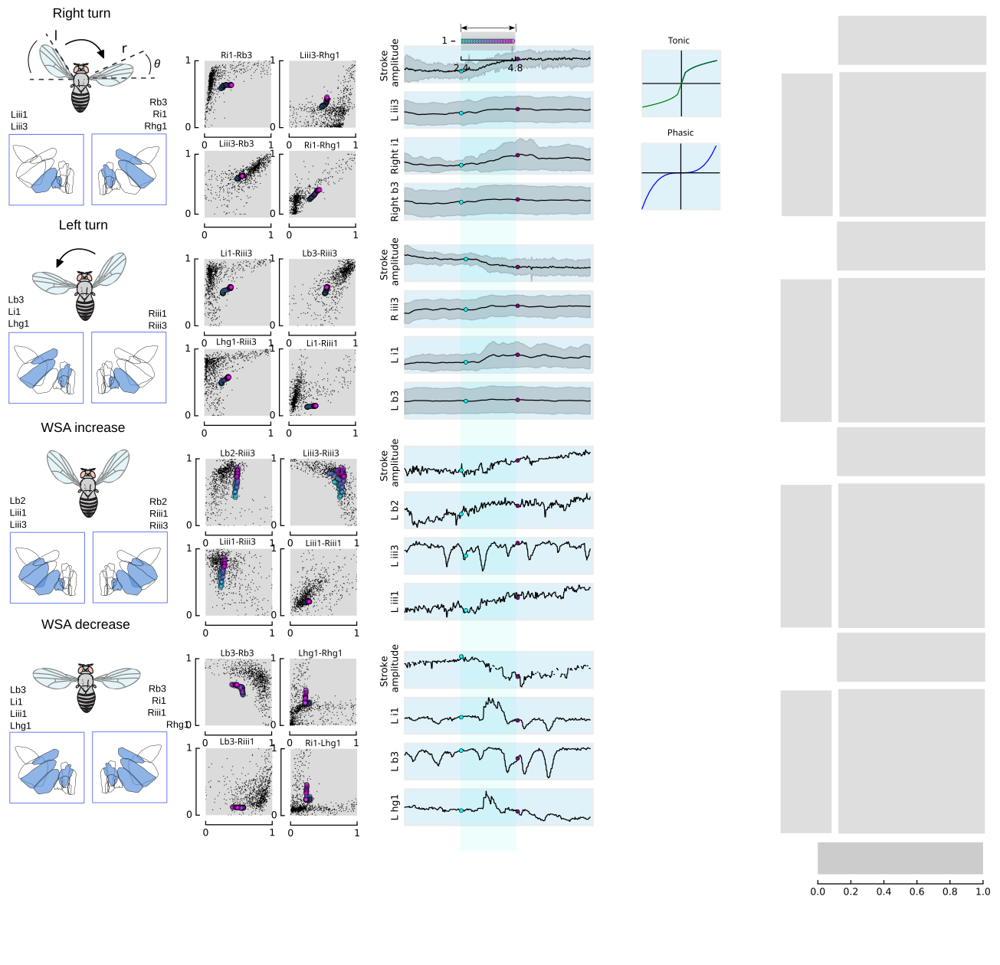

In [63]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi

#layout = fifi.FigureLayout('paper_figure_1_v2.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v6.svg',make_mplfigures = True)

#layout.axes['yaw_left'].plot(time, mean_WBA) #,'o',alpha = 0.2)
#layout.axes['yaw_left'].fill_between(time, (mean_WBA-error), (mean_WBA + error),alpha = 0.1)

#layout.axes['yaw_right'].plot(time, mean_WBA_turn_right) #,'o',alpha = 0.2)
#layout.axes['yaw_right'].fill_between(time, (mean_WBA_turn_right-error_turn_right), (mean_WBA_turn_right + error_turn_right),alpha = 0.1)

import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd



x = np.arange(-10,10)
layout.axes['phasic'].plot(x, x**3)
layout.axes['tonic'].plot(x, x** (1. / 3))
layout.axes['phasic'].set_xbound(-10, 10)
layout.axes['tonic'].set_xbound(-10, 10)
layout.axes['tonic'].axhline(y=0, color='k')
layout.axes['tonic'].axvline(x=0, color='k')
layout.axes['phasic'].axhline(y=0, color='k')
layout.axes['phasic'].axvline(x=0, color='k')
#layout.axes['phasic'].set_ybound(-10, 10)
layout.axes['tonic'].set_ybound([-3, 3])
layout.axes['tonic'].plot(x, np.cbrt(x))




fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]

times = np.arange(len(x))*0.02
colors = times[120:240]


x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

'''
layout.axes['l_wsa'].plot(times,l_deg,clip_on = False,color = 'k')
layout.axes['l_wsa'].set_xbound(0,times[-1])
layout.axes['l_wsa'].set_ylabel('left \n amplitude')
layout.axes['l_wsa'].patch.set_alpha(0.0)
layout.axes['l_wsa'].set_ybound(20,40)
layout.axes['l_wsa'].set_yticks([20, 30, 40])
#layout.axes['l_wsa'].set_ybound(-15,15)
#layout.axes['l_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

layout.axes['r_wsa'].plot(times,r_deg,clip_on = False,color = 'k')
layout.axes['r_wsa'].set_xbound(0,times[-1])
layout.axes['r_wsa'].set_ylabel('right \n amplitude')
layout.axes['r_wsa'].patch.set_alpha(0.0)
layout.axes['r_wsa'].set_ybound(20,40)
layout.axes['r_wsa'].set_yticks([20, 30, 40])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

'''

layout.axes['lmr_rt'].plot(times,yaw_right_dlmr,clip_on = False,color = 'k')
layout.axes['lmr_rt'].fill_between(times, (yaw_right_dlmr - yaw_right_dlmr_er),  (yaw_right_dlmr + yaw_right_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_rt'].set_xbound(0,times[-1])
layout.axes['lmr_rt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_rt'].patch.set_alpha(0.0)
layout.axes['lmr_rt'].set_ybound(-20,20)
layout.axes['lmr_rt'].set_yticks([-15, 0, 15])
layout.axes['lmr_rt'].plot(times[120],yaw_right_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_rt'].plot(times[240],yaw_right_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 
#ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
layout.axes['lmr_rt'].set_xticks([times[120],times[240]])


layout.axes['liii1_rt'].plot(times,yaw_right_diii3l,clip_on = False,color = 'k')
layout.axes['liii1_rt'].fill_between(times, (yaw_right_diii3l - yaw_right_diii3l_er),  (yaw_right_diii3l + yaw_right_diii3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['liii1_rt'].set_xbound(0,times[-1])
layout.axes['liii1_rt'].set_ylabel('L iii3')
layout.axes['liii1_rt'].plot(times[120],yaw_right_diii3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
#layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].plot(times[240],yaw_right_diii3l[240],'purple', marker='o', markersize=4)#, 'o') 

#x = list(pitch_down_new_df['muscles'])
c_r = times[120:240]
Min = times[119]
Max = times[241]             
x = yaw_right_di1r[120:240]
y = yaw_right_db3r[120:240]
df= pd.DataFrame({"x":x,"y":y,"c":c_r})
cmap = plt.cm.cool
norm = matplotlib.colors.Normalize(vmin=Min, vmax=Max)

ax1 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Ri1'),('Rb3'), ax1)
c = ax1.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
#plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
########layout.axes['Liii1_Rb3'].plot(df.x, df.y, color=cmap(norm(df.c.values)), marker = 'o', markersize=2)
#plot_sector(flylist,('left','iii1'),('right','b3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
layout.axes['Liii1_Rb3'].set_xbound(0,1),layout.axes['Liii1_Rb3'].set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
layout.axes['Liii1_Rb3'].set_xticks([0,1])
layout.axes['Liii1_Rb3'].set_yticks([0,1])                

x = yaw_right_diii3l[120:240]
y = yaw_right_dhg1r[120:240]
ax2 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax2)
c = ax2.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])                
                
x = yaw_right_diii3l[120:240]
y = yaw_right_db3r[120:240]
ax3 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax3)
c = ax3.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax3.set_xbound(0,1),ax2.set_ybound(0,1)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])  


x = yaw_right_dhg1r[120:240]
y = yaw_right_di1r[120:240]
ax4 = layout.axes['Ri1_Rhg1']
scatter(flylist[6], ('Ri1'),('Rhg1'), ax4)
c = ax4.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax4.set_xbound(0,1),ax2.set_ybound(0,1)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])  



            

layout.axes['ri1_rt'].plot(times,yaw_right_di1r,clip_on = False,color = 'k')
layout.axes['ri1_rt'].fill_between(times, (yaw_right_di1r - yaw_right_di1r_er),  (yaw_right_di1r+ yaw_right_di1r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['ri1_rt'].set_xbound(0,times[-1])
layout.axes['ri1_rt'].set_ylabel('Right i1')
layout.axes['ri1_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['ri1_rt'].plot(times[120],yaw_right_di1r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['ri1_rt'].plot(times[240],yaw_right_di1r[240],'purple', marker='o', markersize=4)#, 'o') 



layout.axes['rb3_rt'].plot(times,yaw_right_db3r,clip_on = False,color = 'k')
layout.axes['rb3_rt'].fill_between(times, (yaw_right_db3r - yaw_right_db3r_er),  (yaw_right_db3r+ yaw_right_db3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['rb3_rt'].set_xbound(0,times[-1])
layout.axes['rb3_rt'].set_ylabel('Right b3')
layout.axes['rb3_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['rb3_rt'].plot(times[120],yaw_right_db3r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].plot(times[240],yaw_right_db3r[240],'purple', marker='o', markersize=4)#, 'o') 



#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


##write the clips out here and use the derivative to get the signals 



## plot each segment

#----------------------------------------------------------------------


fly = flylist[6]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]



layout.axes['lmr_lt'].plot(times,yaw_left_dlmr,clip_on = False,color = 'k')
layout.axes['lmr_lt'].fill_between(times, (yaw_left_dlmr - yaw_left_dlmr_er),  (yaw_left_dlmr+ yaw_left_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_lt'].set_xbound(0,times[-1])
layout.axes['lmr_lt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_lt'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].set_ybound(-20,20)
layout.axes['lmr_lt'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].plot(times[130],yaw_left_dlmr[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_lt'].plot(times[240],yaw_left_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 


x = yaw_left_di1l[120:240]
y = yaw_left_diii3r[120:240]
ax5 = layout.axes['Li1_Riii3']
scatter(flylist[6], ('Li1'),('Riii3'), ax5)
c = ax5.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax5.set_xbound(0,1),ax5.set_ybound(0,1)
ax5.set_xticks([0,1])
ax5.set_yticks([0,1])                
                


x = yaw_left_db3l[120:240]
y = yaw_left_diii3r[120:240]
ax6 = layout.axes['Lb3_Riii3']
scatter(flylist[6], ('Lb3'),('Riii3'), ax6)
c = ax6.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax6.set_xbound(0,1),ax6.set_ybound(0,1)
ax6.set_xticks([0,1])
ax6.set_yticks([0,1])                
                               
                
x = yaw_left_dhg1l[120:240]
y = yaw_left_diii3r[120:240]
ax7 = layout.axes['Lhg1_Riii3']
scatter(flylist[6], ('Lhg1'),('Riii3'), ax7)
c = ax7.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax7.set_xbound(0,1),ax7.set_ybound(0,1)
ax7.set_xticks([0,1])
ax7.set_yticks([0,1])  


x = yaw_left_di1l[120:240]
y = yaw_left_diii1r[120:240]
ax8 = layout.axes['Li1_Riii1']
scatter(flylist[6], ('Li1'),('Riii1'), ax8)
c = ax8.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax8.set_xbound(0,1),ax8.set_ybound(0,1)
ax8.set_xticks([0,1])
ax8.set_yticks([0,1])  



layout.axes['riii3_lt'].plot(times,yaw_left_diii3r,clip_on = False,color = 'k')
layout.axes['riii3_lt'].fill_between(times, (yaw_left_diii3r - yaw_left_diii3r_er),  (yaw_left_diii3r+ yaw_left_diii3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['riii3_lt'].set_xbound(0,times[-1])
layout.axes['riii3_lt'].set_ylabel('R iii3')
layout.axes['riii3_lt'].patch.set_alpha(0.0)
layout.axes['riii3_lt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['riii3_lt'].plot(times[130],yaw_left_diii3r[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['riii3_lt'].plot(times[240],yaw_left_diii3r[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['li1_lt'].plot(times,yaw_left_di1l,clip_on = False,color = 'k')
layout.axes['li1_lt'].fill_between(times, (yaw_left_di1l - yaw_left_di1l_er),  (yaw_left_di1l+ yaw_left_di1l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['li1_lt'].set_xbound(0,times[-1])
layout.axes['li1_lt'].set_ylabel('L i1')
layout.axes['li1_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['li1_lt'].plot(times[130],yaw_left_di1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].plot(times[240],yaw_left_di1l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['lb3_lt'].plot(times,yaw_left_db3l,clip_on = False,color = 'k')
layout.axes['lb3_lt'].fill_between(times, (yaw_left_db3l - yaw_left_db3l_er),  (yaw_left_db3l+ yaw_left_db3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lb3_lt'].set_xbound(0,times[-1])
layout.axes['lb3_lt'].set_ylabel('L b3')
layout.axes['lb3_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_lt'].plot(times[130],yaw_left_db3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].plot(times[240],yaw_left_db3l[240],'purple', marker='o', markersize=4)#, 'o') 





#____________________________________________________________________





fly = flylist[3]
snum = 1  #5


l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

layout.axes['lpr_WSAi'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAi'].set_xbound(0,times[-1])
layout.axes['lpr_WSAi'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAi'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAi'].set_ybound(-20,20)
#layout.axes['lpr_WSAi'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAi'].plot(times[120],lpr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAi'].plot(times[240],lpr[240],'purple', marker='o', markersize=4)#, 'o') 




x = b2l[120:240]
y = iii3r[120:240]
ax9 = layout.axes['Lb2_Riii3']
scatter(flylist[6], ('Lb2'),('Riii3'), ax9)
c = ax9.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax9.set_xbound(0,1),ax9.set_ybound(0,1)
ax9.set_xticks([0,1])
ax9.set_yticks([0,1])                
                


x = iii3l[120:240]
y = iii3r[120:240]
ax10 = layout.axes['Liii3_Riii3']
scatter(flylist[6], ('Liii3'),('Riii3'), ax10)
c = ax10.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax10.set_xbound(0,1),ax10.set_ybound(0,1)
ax10.set_xticks([0,1])
ax10.set_yticks([0,1])                
                               
                
x = iii1l[120:240]
y = iii3r[120:240]
ax11 = layout.axes['Liii1_Riii3']
scatter(flylist[6], ('Liii1'),('Riii3'), ax11)
c = ax11.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax11.set_xbound(0,1),ax11.set_ybound(0,1)
ax11.set_xticks([0,1])
ax11.set_yticks([0,1])  


x = iii1l[120:240]
y = iii1r[120:240]
ax12 = layout.axes['Liii1_Riii1']
scatter(flylist[6], ('Liii1'),('Riii1'), ax12)
c = ax12.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax12.set_xbound(0,1),ax12.set_ybound(0,1)
ax12.set_xticks([0,1])
ax12.set_yticks([0,1])  



layout.axes['lb2_WSAi'].plot(times,b2l,clip_on = False,color = 'k')
layout.axes['lb2_WSAi'].set_xbound(0,times[-1])
layout.axes['lb2_WSAi'].set_ylabel('L b2')
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['lb2_WSAi'].plot(times[120],b2l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb2_WSAi'].plot(times[240],b2l[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['liii3_WSAi'].plot(times,iii3l,clip_on = False,color = 'k')
layout.axes['liii3_WSAi'].set_xbound(0,times[-1])
layout.axes['liii3_WSAi'].set_ylabel('L iii3')
layout.axes['liii3_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii3_WSAi'].plot(times[130],iii3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii3_WSAi'].plot(times[240],iii3l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['liii1_WSAi'].plot(times,iii1l,clip_on = False,color = 'k')
layout.axes['liii1_WSAi'].set_xbound(0,times[-1])
layout.axes['liii1_WSAi'].set_ylabel('L iii1')
layout.axes['liii1_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii1_WSAi'].plot(times[130],iii1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_WSAi'].plot(times[240],iii1l[240],'purple', marker='o', markersize=4)#, 'o') 









#____________________________________________________________________________

fly = flylist[1]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]


layout.axes['lpr_WSAd'].plot(times,lpr,clip_on = False,color = 'k')
layout.axes['lpr_WSAd'].set_xbound(0,times[-1])
layout.axes['lpr_WSAd'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAd'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAd'].set_ybound(-20,20)
#layout.axes['lpr_WSAd'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAd'].plot(times[120],lpr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAd'].plot(times[240],lpr[240],'purple', marker='o', markersize=4)#, 'o') 




x = b3l[120:240]
y = b3r[120:240]
ax13 = layout.axes['Lb3_Rb3']
scatter(flylist[6], ('Lb3'),('Rb3'), ax13)
c = ax13.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax13.set_xbound(0,1),ax13.set_ybound(0,1)
ax13.set_xticks([0,1])
ax13.set_yticks([0,1])                
                


x = hg1l[120:240]
y = hg1r[120:240]
ax14 = layout.axes['Lhg1_Rhg1']
scatter(flylist[6], ('Lhg1'),('Rhg1'), ax14)
c = ax14.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax14.set_xbound(0,1),ax14.set_ybound(0,1)
ax14.set_xticks([0,1])
ax14.set_yticks([0,1])                
                               
                
x = b3l[120:240]
y = iii1r[120:240]
ax15 = layout.axes['Lb3_Riii1']
scatter(flylist[6], ('Lb3'),('Riii1'), ax15)
c = ax15.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax15.set_xbound(0,1),ax15.set_ybound(0,1)
ax15.set_xticks([0,1])
ax15.set_yticks([0,1])  


x = hg1l[120:240]
y = i1r[120:240]
ax16 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax16)
c = ax16.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax16.set_xbound(0,1),ax16.set_ybound(0,1)
ax16.set_xticks([0,1])
ax16.set_yticks([0,1])  


x = times[120:240]
y = np.ones(20)
ax17 = layout.axes['cmap_legend']
x_prime = x[::6]
colors = x_prime
c = ax17.scatter(x_prime, y, c=colors, cmap='cool', alpha=0.45)
ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
ax17.set_xticks([times[120],times[240]])
ax17.set_yticks([1])  



layout.axes['li1_WSAd'].plot(times,i1l,clip_on = False,color = 'k')
layout.axes['li1_WSAd'].set_xbound(0,times[-1])
layout.axes['li1_WSAd'].set_ylabel('L i1')
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['li1_WSAd'].plot(times[120],i1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_WSAd'].plot(times[240],i1l[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['lb3_WSAd'].plot(times,b3l,clip_on = False,color = 'k')
layout.axes['lb3_WSAd'].set_xbound(0,times[-1])
layout.axes['lb3_WSAd'].set_ylabel('L b3')
layout.axes['lb3_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_WSAd'].plot(times[120],b3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_WSAd'].plot(times[240],b3l[240],'purple', marker='o', markersize=4)#, 'o') 

layout.axes['lhg1_WSAd'].plot(times,hg1l,clip_on = False,color = 'k')
layout.axes['lhg1_WSAd'].set_xbound(0,times[-1])
layout.axes['lhg1_WSAd'].set_ylabel('L hg1')
layout.axes['lhg1_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lhg1_WSAd'].plot(times[120],hg1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lhg1_WSAd'].plot(times[240],hg1l[240],'purple', marker='o', markersize=4)#, 'o') 









fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v7_p.svg')
plt.close('all')
display(SVG('figure_05_v7_p.svg'))




/home/imager/.local/lib/python2.7/site-packages/ipykernel/__main__.py:28: RuntimeWarning: invalid value encountered in power


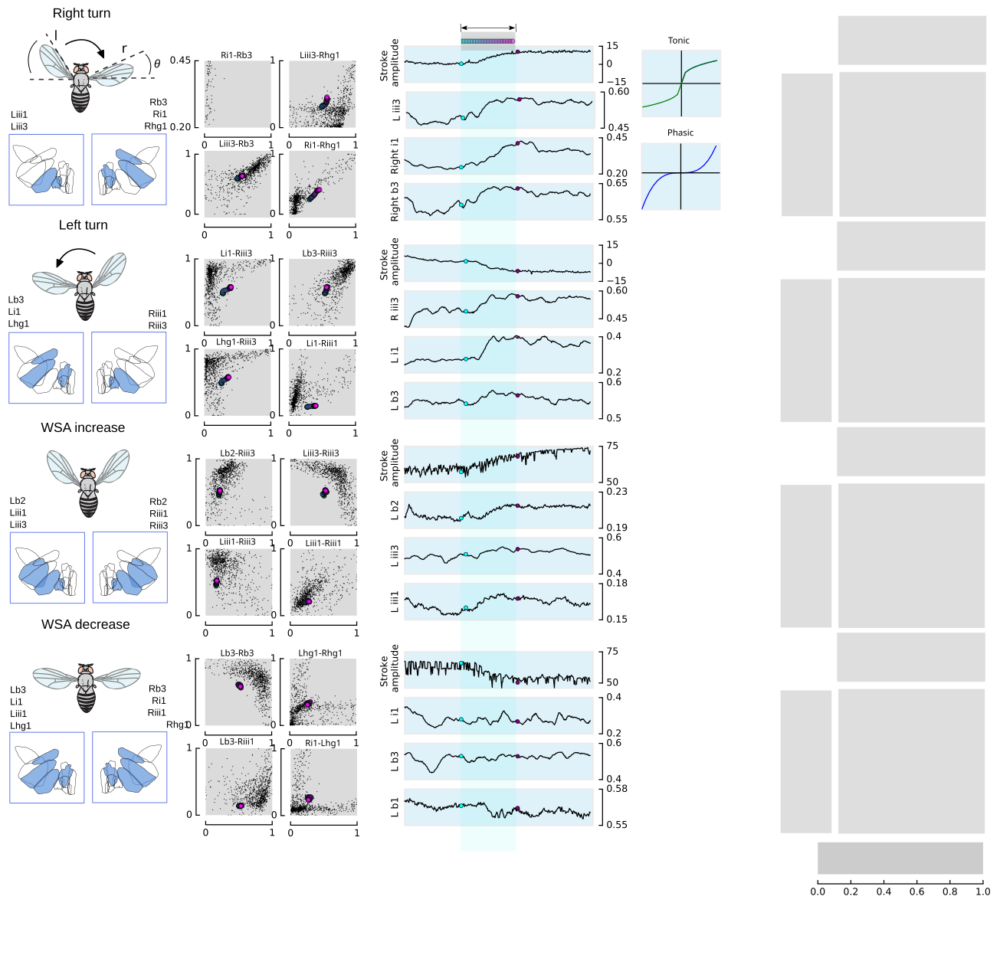

In [140]:
### now do saccade portion to be incorporated in later




from matplotlib.animation import FuncAnimation

import figurefirst as fifi

#layout = fifi.FigureLayout('paper_figure_1_v2.svg',make_mplfigures = True)
layout = fifi.FigureLayout('layouts/paper_figure_4_v7.svg',make_mplfigures = True)

#layout.axes['yaw_left'].plot(time, mean_WBA) #,'o',alpha = 0.2)
#layout.axes['yaw_left'].fill_between(time, (mean_WBA-error), (mean_WBA + error),alpha = 0.1)

#layout.axes['yaw_right'].plot(time, mean_WBA_turn_right) #,'o',alpha = 0.2)
#layout.axes['yaw_right'].fill_between(time, (mean_WBA_turn_right-error_turn_right), (mean_WBA_turn_right + error_turn_right),alpha = 0.1)

import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd



x = np.arange(-10,10)
layout.axes['phasic'].plot(x, x**3)
layout.axes['tonic'].plot(x, x** (1. / 3))
layout.axes['phasic'].set_xbound(-10, 10)
layout.axes['tonic'].set_xbound(-10, 10)
layout.axes['tonic'].axhline(y=0, color='k')
layout.axes['tonic'].axvline(x=0, color='k')
layout.axes['phasic'].axhline(y=0, color='k')
layout.axes['phasic'].axvline(x=0, color='k')
#layout.axes['phasic'].set_ybound(-10, 10)
layout.axes['tonic'].set_ybound([-3, 3])
layout.axes['tonic'].plot(x, np.cbrt(x))




fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]

times = np.arange(len(x))*0.02
colors = times[120:240]


x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


###check normed signals method 


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

'''
layout.axes['l_wsa'].plot(times,l_deg,clip_on = False,color = 'k')
layout.axes['l_wsa'].set_xbound(0,times[-1])
layout.axes['l_wsa'].set_ylabel('left \n amplitude')
layout.axes['l_wsa'].patch.set_alpha(0.0)
layout.axes['l_wsa'].set_ybound(20,40)
layout.axes['l_wsa'].set_yticks([20, 30, 40])
#layout.axes['l_wsa'].set_ybound(-15,15)
#layout.axes['l_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

layout.axes['r_wsa'].plot(times,r_deg,clip_on = False,color = 'k')
layout.axes['r_wsa'].set_xbound(0,times[-1])
layout.axes['r_wsa'].set_ylabel('right \n amplitude')
layout.axes['r_wsa'].patch.set_alpha(0.0)
layout.axes['r_wsa'].set_ybound(20,40)
layout.axes['r_wsa'].set_yticks([20, 30, 40])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)

'''

layout.axes['lmr_rt'].plot(times,yaw_right_dlmr,clip_on = False,color = 'k')
#layout.axes['lmr_rt'].fill_between(times, (yaw_right_dlmr - yaw_right_dlmr_er),  (yaw_right_dlmr + yaw_right_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_rt'].set_xbound(0,times[-1])
layout.axes['lmr_rt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_rt'].patch.set_alpha(0.0)
layout.axes['lmr_rt'].set_ybound(-20,20)
layout.axes['lmr_rt'].set_yticks([-15, 0, 15])
layout.axes['lmr_rt'].plot(times[120],yaw_right_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_rt'].plot(times[240],yaw_right_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 
#ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
layout.axes['lmr_rt'].set_xticks([times[120],times[240]])


layout.axes['liii1_rt'].plot(times,yaw_right_diii3l,clip_on = False,color = 'k')
#layout.axes['liii1_rt'].fill_between(times, (yaw_right_diii3l - yaw_right_diii3l_er),  (yaw_right_diii3l + yaw_right_diii3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['liii1_rt'].set_xbound(0,times[-1])
layout.axes['liii1_rt'].set_ylabel('L iii3')
layout.axes['liii1_rt'].plot(times[120],yaw_right_diii3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
#layout.axes['liii1_rt'].plot(times[120],iii3l[120],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_rt'].plot(times[240],yaw_right_diii3l[240],'purple', marker='o', markersize=4)#, 'o')
layout.axes['liii1_rt'].set_ybound(0.45,0.60)
layout.axes['liii1_rt'].set_yticks([0.45, 0.6])

#x = list(pitch_down_new_df['muscles'])
c_r = times[120:240]
Min = times[119]
Max = times[241]             
x = yaw_right_di1r[120:240]
y = yaw_right_db3r[120:240]
df= pd.DataFrame({"x":x,"y":y,"c":c_r})
cmap = plt.cm.cool
norm = matplotlib.colors.Normalize(vmin=Min, vmax=Max)

ax1 = layout.axes['Liii1_Rb3']
scatter(flylist[6], ('Ri1'),('Rb3'), ax1)
c = ax1.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
#plot_sector(flylist,('left','iii1'),('right','b3'),'nb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
########layout.axes['Liii1_Rb3'].plot(df.x, df.y, color=cmap(norm(df.c.values)), marker = 'o', markersize=2)
#plot_sector(flylist,('left','iii1'),('right','b3'),'lb-nu',ax3,layout.pathspecs,mode = 'kde',contours = True)
layout.axes['Liii1_Rb3'].set_xbound(0,1),layout.axes['Liii1_Rb3'].set_ybound(0,1)#,ax3.set_xlabel('left b3',color = c_l),ax3.set_ylabel('right b3',color = c_r)
layout.axes['Liii1_Rb3'].set_xticks([0,1])
layout.axes['Liii1_Rb3'].set_yticks([0,1])  
layout.axes['Liii1_Rb3'].set_ybound(0.20,0.45)
layout.axes['Liii1_Rb3'].set_yticks([0.2, 0.45])

x = yaw_right_diii3l[120:240]
y = yaw_right_dhg1r[120:240]
ax2 = layout.axes['Liii3_Rhg1']
scatter(flylist[6], ('Liii3'),('Rhg1'), ax2)
c = ax2.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax2.set_xbound(0,1),ax2.set_ybound(0,1)
ax2.set_xticks([0,1])
ax2.set_yticks([0,1])                
                
x = yaw_right_diii3l[120:240]
y = yaw_right_db3r[120:240]
ax3 = layout.axes['Liii3_Rb3']
scatter(flylist[6], ('Liii3'),('Rb3'), ax3)
c = ax3.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax3.set_xbound(0,1),ax2.set_ybound(0,1)
ax3.set_xticks([0,1])
ax3.set_yticks([0,1])  


x = yaw_right_dhg1r[120:240]
y = yaw_right_di1r[120:240]
ax4 = layout.axes['Ri1_Rhg1']
scatter(flylist[6], ('Ri1'),('Rhg1'), ax4)
c = ax4.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax4.set_xbound(0,1),ax2.set_ybound(0,1)
ax4.set_xticks([0,1])
ax4.set_yticks([0,1])  



            

layout.axes['ri1_rt'].plot(times,yaw_right_di1r,clip_on = False,color = 'k')
#layout.axes['ri1_rt'].fill_between(times, (yaw_right_di1r - yaw_right_di1r_er),  (yaw_right_di1r+ yaw_right_di1r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['ri1_rt'].set_xbound(0,times[-1])
layout.axes['ri1_rt'].set_ylabel('Right i1')
layout.axes['ri1_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['ri1_rt'].plot(times[120],yaw_right_di1r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['ri1_rt'].plot(times[240],yaw_right_di1r[240],'purple', marker='o', markersize=4)#, 'o') 
#layout.axes['ri1_rt'].set_ybound(0.40,0.60)
#layout.axes['ri1_rt'].set_yticks([0.40, 0.6])
layout.axes['ri1_rt'].set_ybound(0.2,0.45)
layout.axes['ri1_rt'].set_yticks([0.2, 0.45])


layout.axes['rb3_rt'].plot(times,yaw_right_db3r,clip_on = False,color = 'k')
#layout.axes['rb3_rt'].fill_between(times, (yaw_right_db3r - yaw_right_db3r_er),  (yaw_right_db3r+ yaw_right_db3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['rb3_rt'].set_xbound(0,times[-1])
layout.axes['rb3_rt'].set_ylabel('Right b3')
layout.axes['rb3_rt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['rb3_rt'].plot(times[120],yaw_right_db3r[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].plot(times[240],yaw_right_db3r[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['rb3_rt'].set_ybound(0.55,0.65)
layout.axes['rb3_rt'].set_yticks([0.55, 0.65])



#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)


##write the clips out here and use the derivative to get the signals 



## plot each segment

#----------------------------------------------------------------------


fly = flylist[6]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=-8, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]



layout.axes['lmr_lt'].plot(times,yaw_left_dlmr,clip_on = False,color = 'k')
#layout.axes['lmr_lt'].fill_between(times, (yaw_left_dlmr - yaw_left_dlmr_er),  (yaw_left_dlmr+ yaw_left_dlmr_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lmr_lt'].set_xbound(0,times[-1])
layout.axes['lmr_lt'].set_ylabel('Stroke \n amplitude')
layout.axes['lmr_lt'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].set_ybound(-20,20)
layout.axes['lmr_lt'].set_yticks([-15, 0, 15])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lmr_lt'].plot(times[130],yaw_left_dlmr[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lmr_lt'].plot(times[240],yaw_left_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 


x = yaw_left_di1l[120:240]
y = yaw_left_diii3r[120:240]
ax5 = layout.axes['Li1_Riii3']
scatter(flylist[6], ('Li1'),('Riii3'), ax5)
c = ax5.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax5.set_xbound(0,1),ax5.set_ybound(0,1)
ax5.set_xticks([0,1])
ax5.set_yticks([0,1])                
                


x = yaw_left_db3l[120:240]
y = yaw_left_diii3r[120:240]
ax6 = layout.axes['Lb3_Riii3']
scatter(flylist[6], ('Lb3'),('Riii3'), ax6)
c = ax6.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax6.set_xbound(0,1),ax6.set_ybound(0,1)
ax6.set_xticks([0,1])
ax6.set_yticks([0,1])                
                               
                
x = yaw_left_dhg1l[120:240]
y = yaw_left_diii3r[120:240]
ax7 = layout.axes['Lhg1_Riii3']
scatter(flylist[6], ('Lhg1'),('Riii3'), ax7)
c = ax7.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax7.set_xbound(0,1),ax7.set_ybound(0,1)
ax7.set_xticks([0,1])
ax7.set_yticks([0,1])  


x = yaw_left_di1l[120:240]
y = yaw_left_diii1r[120:240]
ax8 = layout.axes['Li1_Riii1']
scatter(flylist[6], ('Li1'),('Riii1'), ax8)
c = ax8.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax8.set_xbound(0,1),ax8.set_ybound(0,1)
ax8.set_xticks([0,1])
ax8.set_yticks([0,1])  



layout.axes['riii3_lt'].plot(times,yaw_left_diii3r,clip_on = False,color = 'k')
#layout.axes['riii3_lt'].fill_between(times, (yaw_left_diii3r - yaw_left_diii3r_er),  (yaw_left_diii3r+ yaw_left_diii3r_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['riii3_lt'].set_xbound(0,times[-1])
layout.axes['riii3_lt'].set_ylabel('R iii3')
layout.axes['riii3_lt'].set_ybound(0.45,0.60)
layout.axes['riii3_lt'].set_yticks([0.45, 0.6])
layout.axes['riii3_lt'].patch.set_alpha(0.0)
layout.axes['riii3_lt'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['riii3_lt'].plot(times[130],yaw_left_diii3r[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['riii3_lt'].plot(times[240],yaw_left_diii3r[240],'purple', marker='o', markersize=4)#, 'o') 


layout.axes['li1_lt'].plot(times,yaw_left_di1l,clip_on = False,color = 'k')
#layout.axes['li1_lt'].fill_between(times, (yaw_left_di1l - yaw_left_di1l_er),  (yaw_left_di1l+ yaw_left_di1l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['li1_lt'].set_xbound(0,times[-1])
layout.axes['li1_lt'].set_ylabel('L i1')
layout.axes['li1_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['li1_lt'].plot(times[130],yaw_left_di1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].plot(times[240],yaw_left_di1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['li1_lt'].set_ybound(0.20,0.40)
layout.axes['li1_lt'].set_yticks([0.20, 0.4])

layout.axes['lb3_lt'].plot(times,yaw_left_db3l,clip_on = False,color = 'k')
#layout.axes['lb3_lt'].fill_between(times, (yaw_left_db3l - yaw_left_db3l_er),  (yaw_left_db3l+ yaw_left_db3l_er) ,clip_on = False, color = 'k', alpha = 0.15)
layout.axes['lb3_lt'].set_xbound(0,times[-1])
layout.axes['lb3_lt'].set_ylabel('L b3')
layout.axes['lb3_lt'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_lt'].plot(times[130],yaw_left_db3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].plot(times[240],yaw_left_db3l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_lt'].set_ybound(0.50,0.60)
layout.axes['lb3_lt'].set_yticks([0.50, 0.60])




#____________________________________________________________________





fly = flylist[3]
snum = 1  #5


l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=-4 b_x=0, b_y=0'][snum]


b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]

times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

layout.axes['lpr_WSAi'].plot(times,WSAi_dlmr,clip_on = False,color = 'k')
layout.axes['lpr_WSAi'].set_xbound(0,times[-1])
layout.axes['lpr_WSAi'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAi'].patch.set_alpha(0.0)
#layout.axes['lpr_WSAi'].set_ybound(-20,20)
layout.axes['lpr_WSAi'].set_yticks([50, 75])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAi'].plot(times[120],WSAi_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAi'].plot(times[240],WSAi_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 




x = WSAi_db2l[120:240]
y = WSAi_diii3r[120:240]
ax9 = layout.axes['Lb2_Riii3']
scatter(flylist[6], ('Lb2'),('Riii3'), ax9)
c = ax9.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax9.set_xbound(0,1),ax9.set_ybound(0,1)
ax9.set_xticks([0,1])
ax9.set_yticks([0,1])                
                


x = WSAi_diii3l[120:240]
y = WSAi_diii3r[120:240]
ax10 = layout.axes['Liii3_Riii3']
scatter(flylist[6], ('Liii3'),('Riii3'), ax10)
c = ax10.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax10.set_xbound(0,1),ax10.set_ybound(0,1)
ax10.set_xticks([0,1])
ax10.set_yticks([0,1])                
                               
                
x = WSAi_diii1l[120:240]
y = WSAi_diii3r[120:240]
ax11 = layout.axes['Liii1_Riii3']
scatter(flylist[6], ('Liii1'),('Riii3'), ax11)
c = ax11.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax11.set_xbound(0,1),ax11.set_ybound(0,1)
ax11.set_xticks([0,1])
ax11.set_yticks([0,1])  


x = iii1l[120:240]
y = iii1r[120:240]
ax12 = layout.axes['Liii1_Riii1']
scatter(flylist[6], ('Liii1'),('Riii1'), ax12)
c = ax12.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax12.set_xbound(0,1),ax12.set_ybound(0,1)
ax12.set_xticks([0,1])
ax12.set_yticks([0,1])  



layout.axes['lb2_WSAi'].plot(times,WSAi_db2l,clip_on = False,color = 'k')
layout.axes['lb2_WSAi'].set_xbound(0,times[-1])
layout.axes['lb2_WSAi'].set_ylabel('L b2')
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
layout.axes['lb2_WSAi'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['lb2_WSAi'].plot(times[120],WSAi_db2l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb2_WSAi'].plot(times[240],WSAi_db2l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lb2_WSAi'].set_ybound(0.19,0.23)
layout.axes['lb2_WSAi'].set_yticks([0.19, 0.23])


layout.axes['liii3_WSAi'].plot(times,WSAi_diii3l,clip_on = False,color = 'k')
layout.axes['liii3_WSAi'].set_xbound(0,times[-1])
layout.axes['liii3_WSAi'].set_ylabel('L iii3')
layout.axes['liii3_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii3_WSAi'].plot(times[130],WSAi_diii3l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii3_WSAi'].plot(times[240],WSAi_diii3l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii3_WSAi'].set_ybound(0.45,0.60)
layout.axes['liii3_WSAi'].set_yticks([0.40, 0.6])

layout.axes['liii1_WSAi'].plot(times,WSAi_diii1l,clip_on = False,color = 'k')
layout.axes['liii1_WSAi'].set_xbound(0,times[-1])
layout.axes['liii1_WSAi'].set_ylabel('L iii1')
layout.axes['liii1_WSAi'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['liii1_WSAi'].plot(times[130],WSAi_diii1l[130],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_WSAi'].plot(times[240],WSAi_diii1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['liii1_WSAi'].set_ybound(0.150,0.18)
layout.axes['liii1_WSAi'].set_yticks([0.150, 0.18])








#____________________________________________________________________________

fly = flylist[1]
snum = 1  #5

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=4 b_x=0, b_y=0'][snum]
times = np.arange(len(x))*0.02

x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)
lpr = np.rad2deg((l+r)/10 *2*np.pi)

b1l = normd(fly.normed_signals['left', 'b1'])[idxs]
b1r = normd(fly.normed_signals['right', 'b1'])[idxs]

b2l = normd(fly.normed_signals['left', 'b2'])[idxs]
b2r = normd(fly.normed_signals['right', 'b2'])[idxs]

b3l = normd(fly.normed_signals['left', 'b3'])[idxs]
b3r = normd(fly.normed_signals['right', 'b3'])[idxs]

i1l = normd(fly.normed_signals['left', 'i1'])[idxs]
i1r = normd(fly.normed_signals['right', 'i1'])[idxs]

i2l = normd(fly.normed_signals['left', 'i2'])[idxs]
i2r = normd(fly.normed_signals['right', 'i2'])[idxs]

iii1l = normd(fly.normed_signals['left', 'iii1'])[idxs]
iii1r = normd(fly.normed_signals['right', 'iii1'])[idxs]

iii3l = normd(fly.normed_signals['left', 'iii3'])[idxs]
iii3r = normd(fly.normed_signals['right', 'iii3'])[idxs]

hg1l = normd(fly.normed_signals['left', 'hg1'])[idxs]
hg1r = normd(fly.normed_signals['right', 'hg1'])[idxs]

hg2l = normd(fly.normed_signals['left', 'hg2'])[idxs]
hg2r = normd(fly.normed_signals['right', 'hg2'])[idxs]

hg3l = normd(fly.normed_signals['left', 'hg3'])[idxs]
hg3r = normd(fly.normed_signals['right', 'hg3'])[idxs]

hg4l = normd(fly.normed_signals['left', 'hg4'])[idxs]
hg4r = normd(fly.normed_signals['right', 'hg4'])[idxs]


layout.axes['lpr_WSAd'].plot(times,WSAd_dlmr,clip_on = False,color = 'k')
layout.axes['lpr_WSAd'].set_xbound(0,times[-1])
layout.axes['lpr_WSAd'].set_ylabel('Stroke \n amplitude')
layout.axes['lpr_WSAd'].patch.set_alpha(0.0)
layout.axes['lpr_WSAd'].set_ybound(50,75)
layout.axes['lpr_WSAd'].set_yticks([50, 75])
#layout.axes['r_wsa'].set_ybound(-15,15)
#layout.axes['r_wsa'].set_yticks([-15,0,15])
#layout.axes['arena_position'].patch.set_alpha(0.0)
layout.axes['lpr_WSAd'].plot(times[120],WSAd_dlmr[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lpr_WSAd'].plot(times[240],WSAd_dlmr[240],'purple', marker='o', markersize=4)#, 'o') 




x = WSAd_db3l[120:240]
y = WSAd_db3r[120:240]
ax13 = layout.axes['Lb3_Rb3']
scatter(flylist[6], ('Lb3'),('Rb3'), ax13)
c = ax13.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax13.set_xbound(0,1),ax13.set_ybound(0,1)
ax13.set_xticks([0,1])
ax13.set_yticks([0,1])                
                


x = WSAd_dhg1l[120:240]
y = WSAd_dhg1r[120:240]
ax14 = layout.axes['Lhg1_Rhg1']
scatter(flylist[6], ('Lhg1'),('Rhg1'), ax14)
c = ax14.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax14.set_xbound(0,1),ax14.set_ybound(0,1)
ax14.set_xticks([0,1])
ax14.set_yticks([0,1])                
                               
                
x = WSAd_db3l[120:240]
y = WSAd_diii1r[120:240]
ax15 = layout.axes['Lb3_Riii1']
scatter(flylist[6], ('Lb3'),('Riii1'), ax15)
c = ax15.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax15.set_xbound(0,1),ax15.set_ybound(0,1)
ax15.set_xticks([0,1])
ax15.set_yticks([0,1])  


x = WSAd_dhg1l[120:240]
y = WSAd_di1r[120:240]
ax16 = layout.axes['Lhg1_Ri1']
scatter(flylist[6], ('Lhg1'),('Ri1'), ax16)
c = ax16.scatter(x, y, c=colors, cmap='cool', alpha=0.25)
ax16.set_xbound(0,1),ax16.set_ybound(0,1)
ax16.set_xticks([0,1])
ax16.set_yticks([0,1])  


x = times[120:240]
y = np.ones(20)
ax17 = layout.axes['cmap_legend']
x_prime = x[::6]
colors = x_prime
c = ax17.scatter(x_prime, y, c=colors, cmap='cool', alpha=0.45)
ax17.set_xbound(times[120],times[240]),ax17.set_ybound(0.8,1.2)
ax17.set_xticks([times[120],times[240]])
ax17.set_yticks([1])  



layout.axes['li1_WSAd'].plot(times,WSAd_di1l,clip_on = False,color = 'k')
layout.axes['li1_WSAd'].set_xbound(0,times[-1])
layout.axes['li1_WSAd'].set_ylabel('L i1')
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
layout.axes['li1_WSAd'].patch.set_alpha(0.0)
#layout.axes['liii1_rt'].set_ybound(-20,20)
#layout.axes['liii1_rt'].set_yticks([-15, 0, 15])#
layout.axes['li1_WSAd'].plot(times[120],WSAd_di1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['li1_WSAd'].plot(times[240],WSAd_di1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['li1_WSAd'].set_ybound(0.20,0.4)
layout.axes['li1_WSAd'].set_yticks([0.20, 0.40])

layout.axes['lb3_WSAd'].plot(times,WSAd_db3l,clip_on = False,color = 'k')
layout.axes['lb3_WSAd'].set_xbound(0,times[-1])
layout.axes['lb3_WSAd'].set_ylabel('L b3')
layout.axes['lb3_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lb3_WSAd'].plot(times[120],WSAd_db3l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_WSAd'].plot(times[240],WSAd_db3l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lb3_WSAd'].set_ybound(0.40,0.60)
layout.axes['lb3_WSAd'].set_yticks([0.40, 0.6])

layout.axes['lhg1_WSAd'].plot(times,WSAd_db1l,clip_on = False,color = 'k')
layout.axes['lhg1_WSAd'].set_xbound(0,times[-1])
layout.axes['lhg1_WSAd'].set_ylabel('L b1')
layout.axes['lhg1_WSAd'].patch.set_alpha(0.0)
#layout.axes['ri1_rt'].set_ybound(-20,20)
#layout.axes['ri1_rt'].set_yticks([-15, 0, 15])
layout.axes['lhg1_WSAd'].plot(times[120],WSAd_db1l[120],'cyan', marker='o', markersize=4)#, 'o') 
layout.axes['lhg1_WSAd'].plot(times[240],WSAd_db1l[240],'purple', marker='o', markersize=4)#, 'o') 
layout.axes['lhg1_WSAd'].set_ybound(0.55,0.58)
layout.axes['lhg1_WSAd'].set_yticks([0.55, 0.58])







fifi.mpl_functions.set_spines(layout)
layout.save('figure_05_v7.svg')
plt.close('all')
display(SVG('figure_05_v7.svg'))

In [22]:
###mean_angular_velocity 

import matplotlib.pyplot as plt
import matplotlib.colors
import numpy as np; np.random.seed(0)
import pandas as pd






fly = flylist[6]
snum = 1  #5

#l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]
#idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=0, b_y=0'][snum]

l = fly.block_data['left', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
r = fly.block_data['right', 'amp', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]
x = fly.block_data['common', 'x_pos', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]

idxs = fly.block_data['common','idx', 'cl_blocks, g_x=-1, g_y=0 b_x=8, b_y=0'][snum]


times = np.arange(len(x))*0.02
colors = times[120:240]


x = np.rad2deg(x/10.0 *2*np.pi)
x -= np.mean(x[:100])
x += 180
lmr = np.rad2deg((l-r)/10 *2*np.pi)
l_deg = np.rad2deg((l)/10 *2*np.pi)
r_deg = np.rad2deg((r)/10 *2*np.pi)


import sympy as sym  # sym.diff()

l_diff = np.gradient(l_deg)
r_diff = np.gradient(r_deg)
lmr_diff = np.gradient(lmr)


In [39]:
inds = np.arange(395)
time = inds/50.

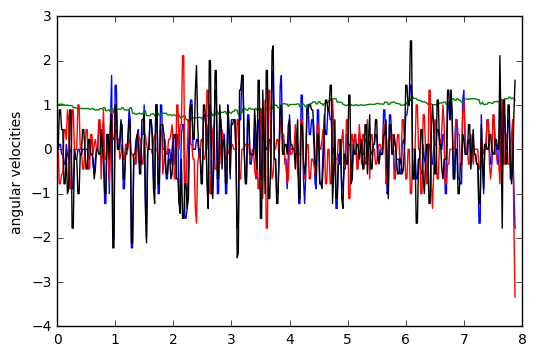

In [42]:
import matplotlib.pyplot as plt
plt.plot(time, l_diff, color = 'b')
plt.plot(time, l, color = 'green')
plt.plot(time, r_diff, color = 'r')
plt.plot(time, lmr_diff, color = 'k')
plt.ylabel('angular velocities')
plt.show()

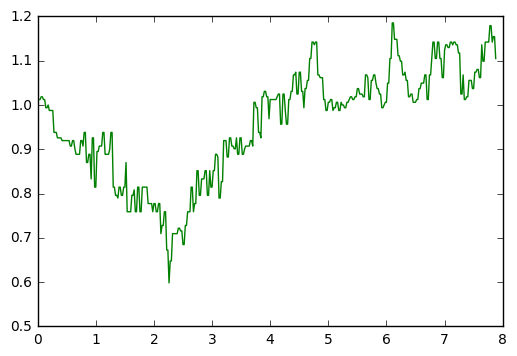

In [43]:
plt.plot(time, l, color = 'green')

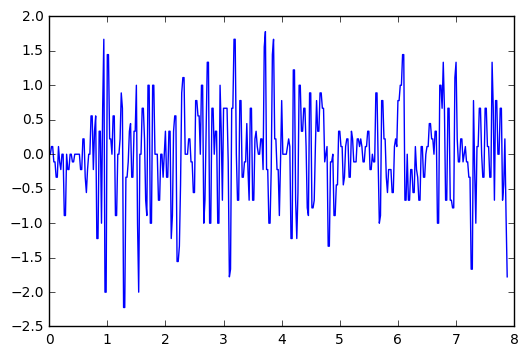

In [44]:
plt.plot(time, l_diff, color = 'b')

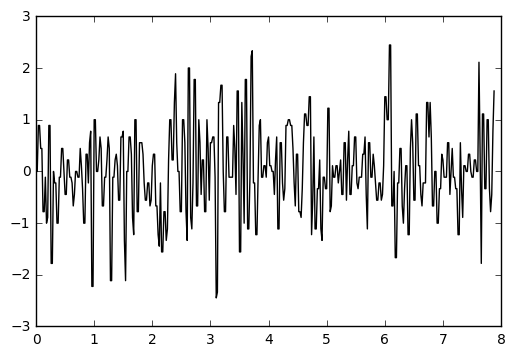

In [45]:
plt.plot(time, lmr_diff, color = 'k')

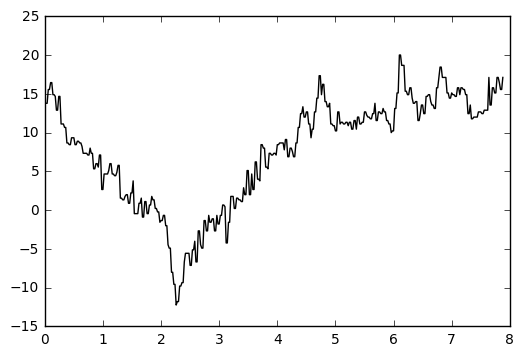

In [46]:
plt.plot(time, lmr, color = 'k')

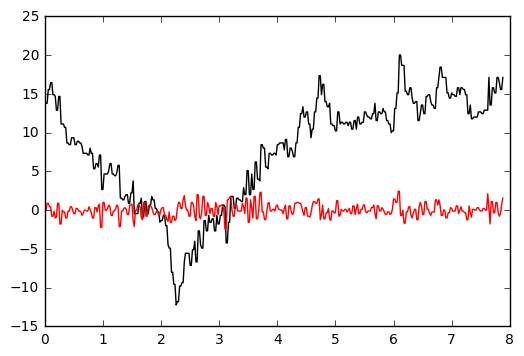

In [47]:
plt.plot(time, lmr, color = 'k')
plt.plot(time, lmr_diff, color = 'r')

In [48]:
def findSacs(WAfilt, wsv,  *args):
    """
    Finds events, or saccades, defined as local min-/maxima of trace velocity (wsv) within threshold/ceiling bounds 
    
    USAGE EXAMPLE:
    $ import numpy as np
    $ import Sac_ID_wsv as sid
    $ WAfilt                 = AF - np.nanmean(AF) # mean deduct the angle trace
    $ SAx, SAn, SVx, SVn  = sid.findSacs(WAfilt, wsv, fVec, fs, 20., 180., 6., 90.)
    # Or, if you want to use default values:
    $ SAx, SAn, SVx, SVn  = sid.findSacs(traceToID, wsv)
    
    IN:
    WAfilt:    The wing angle vector, for instance the LmR wing angle differential, kalman-filtered (filtering method does not matter)
    wsv:    Time-derivative of WAfilt, can be derived manually, or obtained from the kalman filter
    fVec:   A np.zeros vector with NaN entries where the fly was not flying
    fs:     The sampling frequency
    wsvThresh, wsvCeil, magThresh: saccade identifier parameters: velocity threshold, ceiling, and magnitude threshold (latter only used to exclude rebounds)
    
    OUT:
    SAmx, SAmn, SVmx, SVmn: np.nan vectors with Saccade Angles or Saccade Velocities in positive and negative directions, respectively
    
    QUESTIONS?
    ivo.ros@gmail.com

    """
    ## Local functions (inside this function, so they don't need to be separately defined)
    import numpy as np

    def calcMag(idx, wsv, WAfilt): # calculate difference in L-R WSA between nearest local extremes (of opposite sign)
            k=0
            chkMore=True
            refSign=np.sign(wsv[idx])
            while chkMore:
                k += 1
                compSign=np.sign(wsv[idx-k])
                if refSign != compSign: # if not equal
                    onIdx=idx-k+1
                    chkMore=False
            k=0
            chkMore=True
            while chkMore and k < 44:
                k += 1
#                print k
                compSign=np.sign(wsv[idx+k])
                if refSign != compSign:
                    offIdx=idx+k
                    chkMore=False
            if k == 44:  # dirty fail save
                offIdx=idx+k
            return WAfilt[offIdx] - WAfilt[onIdx], onIdx, offIdx # 'integral': BR (behavioral response) = dWSA(offIdx)-dWSA(onIdx)
            
    def sacOnly(inVec, fVec):
        fVecSqz = np.squeeze(fVec)
        outVec = np.array( np.sum([inVec, fVecSqz], axis=0) ).transpose()
        outVec[outVec == 0] = np.nan
        return outVec
            
    ### end of local functions
            
    ## check for arguments
    # Hardcoded default values (used when not included in function call varargs)
                                                            #flight vector,        recFreq wsvThr, Ceil,    magThr
    deffVec, deffs, defwsvThresh, defwsvCeil, defmagThresh = np.zeros_like(WAfilt),   64.,    20,     140.,    6.      # default values
    varargin = args
    nargin = 1 + len(varargin)
    if nargin == 1:
        fVec, fs, wsvThresh, wsvCeil, magThresh = deffVec, deffs, defwsvThresh, defwsvCeil, defmagThresh
    elif nargin == 2:
        fs, wsvThresh, wsvCeil, magThresh = deffs, defwsvThresh, defwsvCeil, defmagThresh
        fVec = varargin[0]
    elif nargin == 3:
        wsvThresh, wsvCeil, magThresh = defwsvThresh, defwsvCeil, defmagThresh
        fVec, fs = varargin[0], varargin[1]
    elif nargin == 4:
        wsvCeil, magThresh = defwsvCeil, defmagThresh
        fVec, fs, wsvThresh = varargin[0], varargin[1], varargin[2]
    elif nargin == 5:
        magThresh = defmagThresh
        fVec, fs, wsvThresh, wsvCeil = varargin[0], varargin[1], varargin[2], varargin[3]
    elif nargin == 6:
        fVec, fs, wsvThresh, wsvCeil, magThresh = varargin[0], varargin[1], varargin[2], varargin[3], varargin[4]
    else:
        print 'could not assign all parameters'

    # In words: find local extremes that exceed wsv threshold during flight
    # subsequently, integrate the unidirectional wsv sections surrounding local extremes, 
    # and retain only those which amplitudes surpasses a threshold amplitude.        
    
    ## Place holders
    wsvMxThr,       wsvMnThr    = np.zeros_like(wsv), np.zeros_like(wsv) 
    SwsvMx,         SwsvMn      = np.zeros_like(wsv), np.zeros_like(wsv)
    lcMxMagTemp,    lcMnMagTemp = np.zeros_like(wsv), np.zeros_like(wsv)
    lcMxMag,        lcMnMag     = np.zeros_like(wsv), np.zeros_like(wsv) 
    sacMx,          sacMn       = np.zeros_like(wsv), np.zeros_like(wsv)
    lcMnonIdx,      lcMnoffIdx  = np.zeros_like(wsv), np.zeros_like(wsv)
    lcMxonIdx,      lcMxoffIdx  = np.zeros_like(wsv), np.zeros_like(wsv)
    lcMxdeltaIdx,   lcMndeltaIdx= np.zeros_like(wsv), np.zeros_like(wsv)
    SacAngMx,       SacAngMn    = np.zeros_like(wsv), np.zeros_like(wsv)
    SacIdxMx,       SacIdxMn    = np.zeros_like(wsv), np.zeros_like(wsv)
        
    ## Find local extremes in the rate, that exceed the saccade velocity threshold
    reboundIds = int(.5*fs)
    for idx in range (reboundIds,len(wsv)-reboundIds):
        if wsv[idx]>=wsv[idx-1] and wsv[idx]>=wsv[idx+1] and wsv[idx]>wsvThresh and wsv[idx]<wsvCeil:
            wsvMxThr[idx] = wsv[idx]
        elif wsv[idx]<=wsv[idx-1] and wsv[idx]<=wsv[idx+1] and wsv[idx]<-wsvThresh and wsv[idx]>-wsvCeil:
            wsvMnThr[idx] = wsv[idx]
    
    ## Calculate a steering magnitude
    # Integrate unidirectional wsv sections surrounding local extremes to obtain saccade magnitude
    for idx in range (int(1.1*reboundIds),len(wsv)-int(1.1*reboundIds)):
        if abs(wsvMxThr[idx])>0: # for every local max
            lcSteerMag, onIdx, offIdx = calcMag(idx, wsv, WAfilt)
            if lcSteerMag > magThresh:
                lcMxMagTemp[idx] = lcSteerMag 
                lcMxonIdx[idx] = onIdx
                lcMxoffIdx[idx] = offIdx
                lcMxdeltaIdx[idx] = offIdx-idx
        if abs(wsvMnThr[idx])>0: # for every local minimum
            lcSteerMag, onIdx, offIdx = calcMag(idx, wsv, WAfilt)
            if lcSteerMag < -magThresh:
                lcMnMagTemp[idx] = lcSteerMag
                lcMnonIdx[idx] = onIdx
                lcMnoffIdx[idx] = offIdx
                lcMndeltaIdx[idx] = offIdx-idx
    
    ## Obtain saccades, retained extremes that are not 'rebounds' (stable pre-onset activity for .5s).
    # Note that steering magnitude is only used to detect rebounds, not to identify saccades
    for idx in range (reboundIds,len(wsv)-reboundIds):
        if lcMxMagTemp[idx]>0: # for every local maximum that exceeds the magnitude threshold
            if abs(np.sum(lcMnMagTemp[idx-reboundIds:idx]))<magThresh and ~np.isnan(fVec[idx-reboundIds:idx+reboundIds]).any(axis=0): 
                SwsvMx[idx] = wsv[idx]
                lcMxMag[idx] = lcMxMagTemp[idx]
                sacMx[int(lcMxonIdx[idx]):int(lcMxoffIdx[idx])] = WAfilt[int(lcMxonIdx[idx]):int(lcMxoffIdx[idx])]
                sacPeakIdx = int(idx+lcMxdeltaIdx[idx])
                SacAngMx[sacPeakIdx] = WAfilt[sacPeakIdx]                       # such that saccades can be indicated at peaks 
                SacIdxMx[idx] = sacPeakIdx                                      # indices of saccades, to allow cropping of saccades
        elif lcMnMagTemp[idx]<0: # for every local minimum that exceeds the magnitude threshold
            if abs(np.sum(lcMxMagTemp[idx-reboundIds:idx]))<magThresh and ~np.isnan(fVec[idx-reboundIds:idx+reboundIds]).any(axis=0): 
                SwsvMn[idx] = wsv[idx]
                lcMnMag[idx] = lcMnMagTemp[idx]
                sacMn[int(lcMnonIdx[idx]):int(lcMnoffIdx[idx])] = WAfilt[int(lcMnonIdx[idx]):int(lcMnoffIdx[idx])]
                sacPeakIdx = int(idx+lcMndeltaIdx[idx])
                SacAngMn[sacPeakIdx] = WAfilt[sacPeakIdx]
                SacIdxMn[idx] = sacPeakIdx                                      # indices of saccades, to allow cropping of saccades
      
    ## only when fly is flying, set all other instances to nan    
    SAmx,    SAmn    = sacOnly(SacAngMx, fVec), sacOnly(SacAngMn, fVec)
    SVmx,    SVmn    = sacOnly(SwsvMx,   fVec), sacOnly(SwsvMn,   fVec)
    #SMagMx,  SMagMn  = sacOnly(lcMxMag,  fVec), sacOnly(lcMnMag,  fVec)
    #SIdxmx,  SIdxmn  = sacOnly(SacIdxMx, fVec), sacOnly(SacIdxMn, fVec)    
    #you can also return the following: SMagMx, SMagMn, SIdxmx,  SIdxmn
    return SAmx,   SAmn,   SVmx, SVmn,  # [traceAngle, at saccade max peak;; peakAngVelo, at its Idx;; saccadePeakAngleIndex at peak angVelo index;  turnAngle]


In [54]:
#from pykalman import KalmanFilter
import numpy as np

from scipy.stats import norm
